In [96]:
import sklearn
sklearn.set_config(transform_output="pandas")
import warnings
warnings.filterwarnings('ignore')

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.base import BaseEstimator, TransformerMixin


from sklearn.linear_model import LinearRegression


# Preprocessing
from sklearn.impute import SimpleImputer
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler,OrdinalEncoder
from sklearn.model_selection import GridSearchCV, KFold

# for model learning
from sklearn.model_selection import train_test_split, RandomizedSearchCV, cross_val_score

from sklearn.ensemble import RandomForestClassifier, StackingClassifier

from catboost import CatBoostClassifier

# Metrics
from sklearn.metrics import accuracy_score, f1_score


# tunning hyperparamters model
import optuna
import shap


# from tqdm import tqdm
from sklearn.compose import make_column_selector
from category_encoders.cat_boost import CatBoostEncoder

In [69]:
filetrain = 'titanic/train.csv'
train = pd.read_csv(filetrain)

In [70]:
testfile = 'titanic/test.csv'
test =  pd.read_csv(testfile)

## Начало

In [71]:
class family_maker(BaseEstimator, TransformerMixin): 
    
    def fit(self, X, y=None):
        return self
        
    def transform(self, X, y=None):

        def fam(x):
            if x == 0:
                return 'NO'
            return 'YES'
        X_copy = X.copy()
        X_copy['family_size'] = X_copy['SibSp']+X_copy['Parch']
        X_copy['family'] =  X_copy['family_size'].map(fam)
        
        return X_copy[['family','family_size']]


class Age_Imputer(BaseEstimator, TransformerMixin): 
    
    def fit(self, X, y=None):
        return self
        
    def transform(self, X, y=None):
        X_copy = X.copy()
        meta = train.groupby(['Sex','Pclass','SibSp']).agg({'Age':['median']}).reset_index()

        for i, sex, pc, sib, age in X_copy[['Sex','Pclass','SibSp','Age']].itertuples(index=True):
            if np.isnan(age):
                mask = ((meta.Sex == sex) & (meta.Pclass == pc) & (meta.SibSp == sib))
                
                agen = np.array(meta.loc[mask][('Age','median')])
                
                if np.isnan(agen):
                    if sib >= 4:
                        X_copy.loc[i,'Age'] = 1
                    else:
                        X_copy.loc[i,'Age'] = X_copy.loc[X_copy.Pclass == pc].median()
                else:
                    X_copy.loc[i,'Age'] = agen
        return X_copy[['Sex','Age']]


class Name(BaseEstimator, TransformerMixin): 
    
    def fit(self, X, y=None):
        return self
        
    def transform(self, X, y=None):
        
        X_copy = X.copy()

        def name(x):
            return x.split(',')[0]

        X_copy['Name'] = X_copy['Name'].map(name)
        X_copy['Name'] = X_copy['Name'] + '_' + X_copy['Pclass'].astype(str)# + '_' + (X_copy['SibSp']+X_copy['Parch']).astype(str)
        return X_copy[['Name','Pclass']]
        

        return X
first_step = ColumnTransformer(
    transformers=[
        ('drop garbage','drop',['PassengerId','Ticket','Cabin']),
        ('family maker',family_maker(),['SibSp','Parch']),
        ('age_imputer', Age_Imputer(), ['Sex','Pclass','SibSp','Age']),
        ('embarked_imputer', SimpleImputer(strategy='most_frequent'), ['Embarked']),
        ('name_transformer', Name(), ['Name','Pclass','SibSp','Parch'])
    ],
     verbose_feature_names_out = False,
     remainder = 'passthrough')

scale = ['Age','Fare']

ord = ['family','Sex','Embarked']
cat = ['Name']

second_step = ColumnTransformer(
    transformers=[
        ('encoder',CatBoostEncoder(),cat),
        ('ordinal',OrdinalEncoder(),ord),
        ('scaler',StandardScaler(),scale)
    ],
     verbose_feature_names_out = False,
     remainder = 'passthrough')


preprocessor = Pipeline(
    [
        ('NaN_features_transform', first_step),
        ('Encoding_and_scaling',second_step),
    ]
)

In [72]:
X, y = train.drop('Survived', axis=1), train['Survived']
X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=0.2, random_state=42)

In [55]:
t = pd.DataFrame(data={'NaN_count': X.isna().sum(), 'data_type':X.dtypes})
t.loc[t['NaN_count'] > 0]

,NaN_count,data_type


In [56]:
num = train.select_dtypes(exclude=  ['object'])
num

,SibSp,Parch,family_size,Pclass,Age,Survived,Fare
0,1,0,1,3,22.0,0,7.2500
1,1,0,1,1,38.0,1,71.2833
2,0,0,0,3,26.0,1,7.9250
3,1,0,1,1,35.0,1,53.1000
4,0,0,0,3,35.0,0,8.0500
...,...,...,...,...,...,...,...
886,0,0,0,2,27.0,0,13.0000
887,0,0,0,1,19.0,1,30.0000
888,1,2,3,3,28.5,0,23.4500
889,0,0,0,1,26.0,1,30.0000


In [59]:
train['Embarked'].fillna(train['Embarked'].mode, inplace=True)

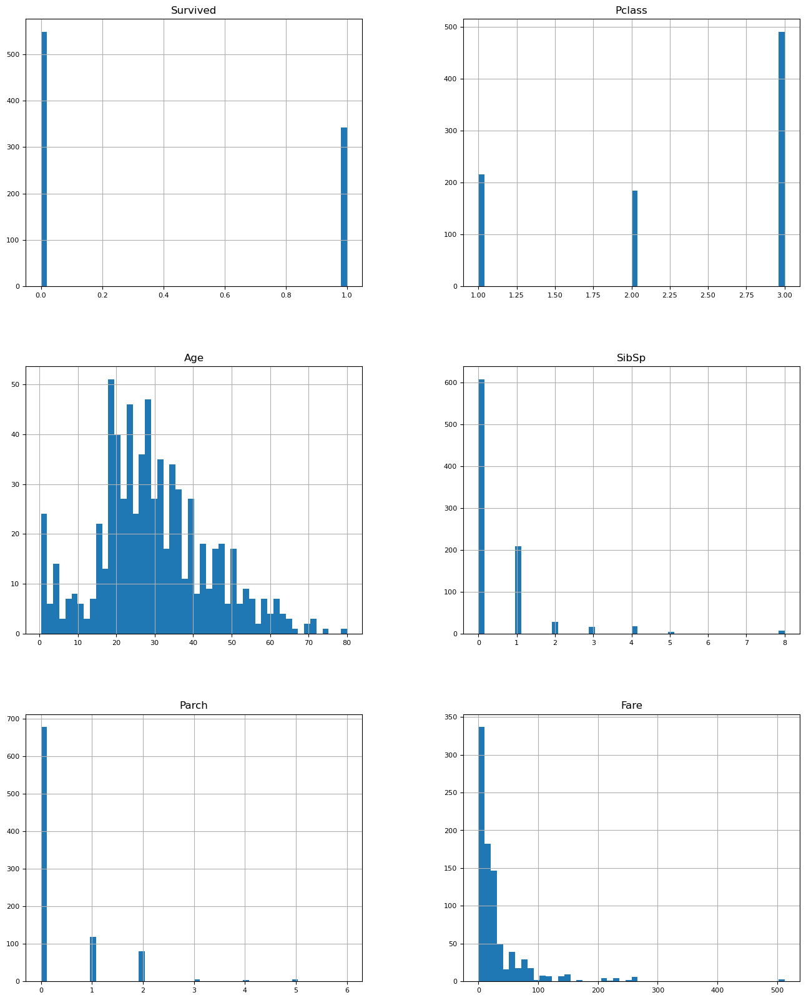

In [15]:
num.hist(figsize=(16, 20), bins=50, xlabelsize=8, ylabelsize=8);

<Axes: xlabel='Fare', ylabel='Age'>

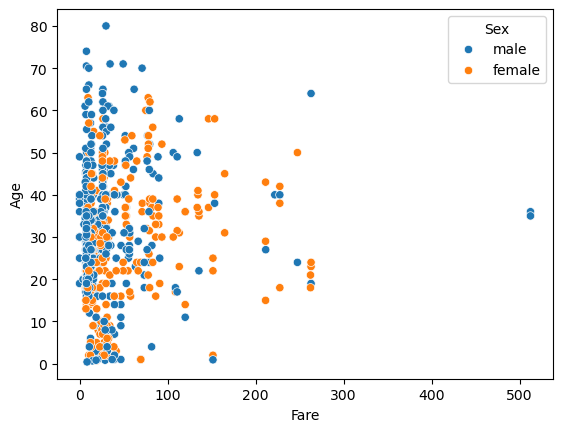

In [73]:
sns.scatterplot(x = train['Fare'] , y = train['Age'], hue=train['Sex'])

In [57]:
X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=0.2, random_state=42)

X = preprocessor.fit_transform(X,y)
X.head()

,Name,family,Sex,Embarked,Age,Fare,family_size,Pclass
0,0.383838,1.0,1.0,2.0,-0.526292,-0.502445,1,3
1,0.383838,1.0,0.0,0.0,0.655315,0.786845,1,1
2,0.383838,0.0,0.0,2.0,-0.230890,-0.488854,0,3
3,0.383838,1.0,0.0,2.0,0.433764,0.420730,1,1
4,0.383838,0.0,1.0,2.0,0.433764,-0.486337,0,3


### SHAP

In [34]:
shap.initjs()
X_copy = X.copy()
X_copy = preprocessor.fit_transform(X,y)


model = CatBoostClassifier(iterations=300, learning_rate=0.1, random_seed=42)
model.fit(X_copy, y, verbose=False, plot=False)

In [35]:
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X_copy)

# visualize the first prediction's explanation
shap.force_plot(explainer.expected_value, shap_values[0,:], X_copy.iloc[0,:])

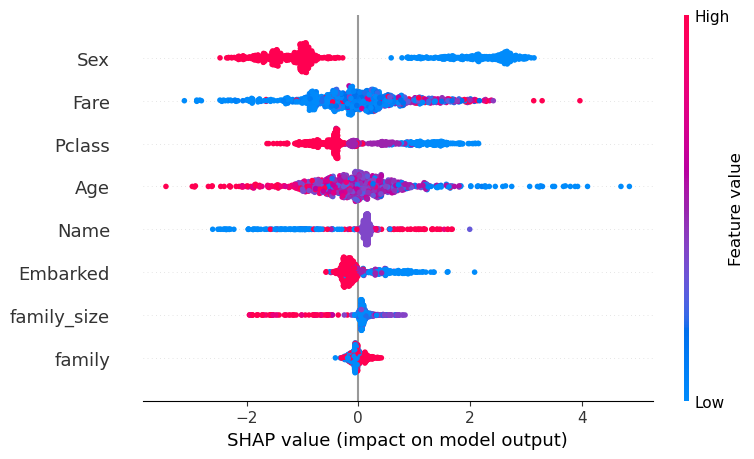

In [36]:
shap.summary_plot(shap_values, X_copy)

### Random

In [42]:
X_copy = X.copy()

X_copy['random'] = np.random.normal(0,0.5, size=X_copy.shape[0])
rf = RandomForestClassifier(max_depth=3, n_estimators=500, random_state=2)

X_RF = preprocessor.fit_transform(X_copy,y)

rf.fit(X_RF, y)

result = pd.Series(dict(zip(X_RF.columns, rf.feature_importances_))).sort_values(key=lambda x: abs(x), ascending=False).to_frame().round(6)

result.loc[result[0] < 0.0005].index.to_list()
pd.set_option('display.max_rows', 80)

result.index.to_list().index('random')
OK = result.index.to_list()[:result.index.to_list().index('random')]

In [43]:
result

,0
Sex,0.464544
Fare,0.158387
Pclass,0.150655
family_size,0.062351
Name,0.055315
Age,0.053802
family,0.020108
Embarked,0.018938
random,0.015900


### OPTUNA

#### RFC

In [67]:
ml_pipeline = Pipeline(
    [
        ('preprocessor', preprocessor),
        ('model', RandomForestClassifier())
    ]
)


def objective(trial):

    model_params = {
            'n_estimators': trial.suggest_int('n_estimators', 50, 1000,25),
            'max_depth': trial.suggest_int('max_depth', 2, 5),
            'min_samples_split': trial.suggest_int('min_samples_split', 2, 15),
            'min_samples_leaf': trial.suggest_int('min_samples_leaf', 1, 15),
        'random_state': trial.suggest_int('random_state', 42, 42, 1)
    }
    
    ml_pipeline.named_steps['model'].set_params(**model_params)

    # Создание сплитов для кросс-валидации
    cv = KFold(n_splits=5, random_state=42, shuffle=True)

    # Вычисление метрик точности с использованием кросс-валидации
    scores = cross_val_score(ml_pipeline, X, y, cv=cv)
    
    accuracy = scores.mean()
    
    return accuracy


# Создание объекта для проведения оптимизации
study = optuna.create_study(direction='maximize')


# Запуск оптимизации
study.optimize(objective, n_trials=500)


# Вывод результатов
best_params = study.best_params
best_value = study.best_value


print(f"Лучшие параметры: {best_params}")
print(f"Лучшее значение: {best_value}")

[I 2024-02-10 01:10:15,137] A new study created in memory with name: no-name-464c9c58-50dd-4cf0-b238-bf91610bee8e
[I 2024-02-10 01:10:18,337] Trial 0 finished with value: 0.8226727763480006 and parameters: {'n_estimators': 825, 'max_depth': 3, 'min_samples_split': 2, 'min_samples_leaf': 3, 'random_state': 42}. Best is trial 0 with value: 0.8226727763480006.
[I 2024-02-10 01:10:21,880] Trial 1 finished with value: 0.8249199673592369 and parameters: {'n_estimators': 925, 'max_depth': 4, 'min_samples_split': 4, 'min_samples_leaf': 6, 'random_state': 42}. Best is trial 1 with value: 0.8249199673592369.
[I 2024-02-10 01:10:22,941] Trial 2 finished with value: 0.7980038917833155 and parameters: {'n_estimators': 75, 'max_depth': 2, 'min_samples_split': 11, 'min_samples_leaf': 6, 'random_state': 42}. Best is trial 1 with value: 0.8249199673592369.
[I 2024-02-10 01:10:25,837] Trial 3 finished with value: 0.8025045508756513 and parameters: {'n_estimators': 750, 'max_depth': 2, 'min_samples_split

Лучшие параметры: {'n_estimators': 50, 'max_depth': 5, 'min_samples_split': 12, 'min_samples_leaf': 8, 'random_state': 42}
Лучшее значение: 0.8406503044378884


#### CatBoostClassifier

In [58]:
ml_pipeline = Pipeline(
    [
        ('preprocessor', preprocessor),
        ('model', CatBoostClassifier())
    ]
)
def objective(trial):
    
    model_params = {
        'iterations' : trial.suggest_int("iterations", 100, 1000),
        'learning_rate': trial.suggest_float("learning_rate", 1e-3, 1e-1, log=True),
        'depth': trial.suggest_int("depth", 2, 6),
        'l2_leaf_reg': trial.suggest_float("l2_leaf_reg", 1e-8, 100.0, log=True),
        'bootstrap_type': trial.suggest_categorical("bootstrap_type", ["Bayesian"]),
        'random_strength': trial.suggest_float("random_strength", 1e-8, 10.0, log=True),
        'bagging_temperature': trial.suggest_float("bagging_temperature", 0.0, 10.0),
        'od_type': trial.suggest_categorical("od_type", ["IncToDec", "Iter"]),
        'od_wait': trial.suggest_int("od_wait", 10, 50),
        'random_state': trial.suggest_int('random_state', 42, 42, 1)
}
    
    
    ml_pipeline.named_steps['model'].set_params(**model_params)

    # Создание сплитов для кросс-валидации
    cv = KFold(n_splits=5, random_state=42, shuffle=True)

    # Вычисление метрик точности с использованием кросс-валидации
    scores = cross_val_score(ml_pipeline, X, y, cv=cv)
    
    accuracy = scores.mean()
    
    return accuracy


# Создание объекта для проведения оптимизации
study = optuna.create_study(direction='maximize')


# Запуск оптимизации
study.optimize(objective, n_trials=200)


# Вывод результатов
best_params = study.best_params
best_value = study.best_value


print(f"Лучшие параметры: {best_params}")
print(f"Лучшее значение: {best_value}")

[I 2024-02-10 00:34:53,645] A new study created in memory with name: no-name-3724be4b-77f1-4cd1-a190-147ffc38c183


0:	learn: 0.6567177	total: 594us	remaining: 203ms
1:	learn: 0.6261994	total: 985us	remaining: 168ms
2:	learn: 0.5989166	total: 1.23ms	remaining: 140ms
3:	learn: 0.5747164	total: 1.47ms	remaining: 124ms
4:	learn: 0.5541401	total: 1.69ms	remaining: 114ms
5:	learn: 0.5359588	total: 1.91ms	remaining: 107ms
6:	learn: 0.5201582	total: 2.13ms	remaining: 102ms
7:	learn: 0.5065582	total: 2.35ms	remaining: 98.4ms
8:	learn: 0.4944302	total: 2.56ms	remaining: 95.1ms
9:	learn: 0.4853310	total: 2.76ms	remaining: 91.8ms
10:	learn: 0.4733016	total: 2.98ms	remaining: 90ms
11:	learn: 0.4632766	total: 3.21ms	remaining: 88.4ms
12:	learn: 0.4549875	total: 3.42ms	remaining: 87ms
13:	learn: 0.4482508	total: 3.61ms	remaining: 84.8ms
14:	learn: 0.4411635	total: 3.81ms	remaining: 83.2ms
15:	learn: 0.4360999	total: 4.01ms	remaining: 82.1ms
16:	learn: 0.4312144	total: 4.22ms	remaining: 80.9ms
17:	learn: 0.4259088	total: 4.44ms	remaining: 80.2ms
18:	learn: 0.4218735	total: 4.64ms	remaining: 79.1ms
19:	learn: 0.417

[I 2024-02-10 00:34:54,971] Trial 0 finished with value: 0.8282970309459545 and parameters: {'iterations': 343, 'learning_rate': 0.054842108940637437, 'depth': 3, 'l2_leaf_reg': 0.025417298948392796, 'bootstrap_type': 'Bayesian', 'random_strength': 0.016276145119851714, 'bagging_temperature': 0.4130952114417563, 'od_type': 'Iter', 'od_wait': 16, 'random_state': 42}. Best is trial 0 with value: 0.8282970309459545.


0:	learn: 0.6602049	total: 417us	remaining: 143ms
1:	learn: 0.6314348	total: 827us	remaining: 141ms
2:	learn: 0.6060998	total: 1.06ms	remaining: 120ms
3:	learn: 0.5844823	total: 1.29ms	remaining: 109ms
4:	learn: 0.5670855	total: 1.5ms	remaining: 101ms
5:	learn: 0.5510773	total: 1.73ms	remaining: 97ms
6:	learn: 0.5344495	total: 1.95ms	remaining: 93.7ms
7:	learn: 0.5229932	total: 2.18ms	remaining: 91.3ms
8:	learn: 0.5091425	total: 2.41ms	remaining: 89.3ms
9:	learn: 0.4993324	total: 2.63ms	remaining: 87.5ms
10:	learn: 0.4888833	total: 2.83ms	remaining: 85.4ms
11:	learn: 0.4795629	total: 3.06ms	remaining: 84.4ms
12:	learn: 0.4704245	total: 3.28ms	remaining: 83.3ms
13:	learn: 0.4634831	total: 3.48ms	remaining: 81.8ms
14:	learn: 0.4578768	total: 3.68ms	remaining: 80.5ms
15:	learn: 0.4510962	total: 3.9ms	remaining: 79.6ms
16:	learn: 0.4450339	total: 4.12ms	remaining: 78.9ms
17:	learn: 0.4393856	total: 4.34ms	remaining: 78.3ms
18:	learn: 0.4344557	total: 4.55ms	remaining: 77.6ms
19:	learn: 0.4

[I 2024-02-10 00:34:56,241] Trial 1 finished with value: 0.8148264390182662 and parameters: {'iterations': 364, 'learning_rate': 0.004932923641521366, 'depth': 2, 'l2_leaf_reg': 8.13293498274399e-06, 'bootstrap_type': 'Bayesian', 'random_strength': 0.00037763626637187745, 'bagging_temperature': 3.8875272121343984, 'od_type': 'Iter', 'od_wait': 19, 'random_state': 42}. Best is trial 0 with value: 0.8282970309459545.


0:	learn: 0.6913122	total: 658us	remaining: 239ms
1:	learn: 0.6905584	total: 1.14ms	remaining: 206ms
2:	learn: 0.6901875	total: 1.39ms	remaining: 167ms
3:	learn: 0.6890522	total: 1.62ms	remaining: 145ms
4:	learn: 0.6869087	total: 1.83ms	remaining: 131ms
5:	learn: 0.6843871	total: 2.03ms	remaining: 121ms
6:	learn: 0.6823752	total: 2.22ms	remaining: 113ms
7:	learn: 0.6803655	total: 2.42ms	remaining: 108ms
8:	learn: 0.6796157	total: 2.61ms	remaining: 103ms
9:	learn: 0.6776451	total: 2.79ms	remaining: 98.9ms
10:	learn: 0.6769459	total: 2.98ms	remaining: 95.6ms
11:	learn: 0.6749281	total: 3.16ms	remaining: 92.7ms
12:	learn: 0.6729110	total: 3.34ms	remaining: 90.1ms
13:	learn: 0.6709170	total: 3.51ms	remaining: 87.8ms
14:	learn: 0.6684834	total: 3.69ms	remaining: 86ms
15:	learn: 0.6660939	total: 3.86ms	remaining: 83.9ms
16:	learn: 0.6642528	total: 4.03ms	remaining: 82.3ms
17:	learn: 0.6636113	total: 4.2ms	remaining: 80.8ms
18:	learn: 0.6617231	total: 4.39ms	remaining: 79.7ms
19:	learn: 0.659

[I 2024-02-10 00:34:57,407] Trial 2 finished with value: 0.8327976900382901 and parameters: {'iterations': 196, 'learning_rate': 0.02483277067841722, 'depth': 6, 'l2_leaf_reg': 5.96798457558855e-08, 'bootstrap_type': 'Bayesian', 'random_strength': 0.918571744032691, 'bagging_temperature': 5.003779883088893, 'od_type': 'Iter', 'od_wait': 14, 'random_state': 42}. Best is trial 2 with value: 0.8327976900382901.


0:	learn: 0.6825030	total: 350us	remaining: 68.3ms
1:	learn: 0.6711722	total: 835us	remaining: 81ms
2:	learn: 0.6609520	total: 1.11ms	remaining: 71.4ms
3:	learn: 0.6514426	total: 1.35ms	remaining: 64.8ms
4:	learn: 0.6432533	total: 1.59ms	remaining: 60.7ms
5:	learn: 0.6336155	total: 1.84ms	remaining: 58.2ms
6:	learn: 0.6259183	total: 2.06ms	remaining: 55.8ms
7:	learn: 0.6210410	total: 2.3ms	remaining: 54.1ms
8:	learn: 0.6122889	total: 2.53ms	remaining: 52.7ms
9:	learn: 0.6042913	total: 2.79ms	remaining: 52ms
10:	learn: 0.5975295	total: 3.04ms	remaining: 51.1ms
11:	learn: 0.5902191	total: 3.28ms	remaining: 50.3ms
12:	learn: 0.5866029	total: 3.53ms	remaining: 49.7ms
13:	learn: 0.5790655	total: 3.77ms	remaining: 49ms
14:	learn: 0.5727809	total: 3.99ms	remaining: 48.2ms
15:	learn: 0.5691329	total: 4.22ms	remaining: 47.5ms
16:	learn: 0.5630559	total: 4.46ms	remaining: 46.9ms
17:	learn: 0.5573437	total: 4.68ms	remaining: 46.3ms
18:	learn: 0.5516379	total: 4.91ms	remaining: 45.8ms
19:	learn: 0

[I 2024-02-10 00:34:58,826] Trial 3 finished with value: 0.8114493754315486 and parameters: {'iterations': 471, 'learning_rate': 0.005171040064836562, 'depth': 2, 'l2_leaf_reg': 0.8082163488534997, 'bootstrap_type': 'Bayesian', 'random_strength': 0.07362015843051486, 'bagging_temperature': 8.707872935619745, 'od_type': 'Iter', 'od_wait': 25, 'random_state': 42}. Best is trial 2 with value: 0.8327976900382901.


0:	learn: 0.6927794	total: 330us	remaining: 155ms
1:	learn: 0.6904274	total: 733us	remaining: 172ms
2:	learn: 0.6883263	total: 927us	remaining: 145ms
3:	learn: 0.6873117	total: 1.12ms	remaining: 130ms
4:	learn: 0.6866447	total: 1.3ms	remaining: 122ms
5:	learn: 0.6856901	total: 1.49ms	remaining: 115ms
6:	learn: 0.6849757	total: 1.68ms	remaining: 111ms
7:	learn: 0.6828085	total: 1.88ms	remaining: 109ms
8:	learn: 0.6806411	total: 2.06ms	remaining: 106ms
9:	learn: 0.6799489	total: 2.24ms	remaining: 103ms
10:	learn: 0.6781231	total: 2.43ms	remaining: 102ms
11:	learn: 0.6755817	total: 2.61ms	remaining: 99.9ms
12:	learn: 0.6746664	total: 2.81ms	remaining: 99ms
13:	learn: 0.6725522	total: 3ms	remaining: 97.8ms
14:	learn: 0.6708114	total: 3.19ms	remaining: 96.9ms
15:	learn: 0.6690686	total: 3.36ms	remaining: 95.6ms
16:	learn: 0.6683646	total: 3.54ms	remaining: 94.5ms
17:	learn: 0.6658413	total: 3.72ms	remaining: 93.6ms
18:	learn: 0.6641146	total: 3.89ms	remaining: 92.5ms
19:	learn: 0.6635672	to

[I 2024-02-10 00:34:59,913] Trial 4 finished with value: 0.8305316678174627 and parameters: {'iterations': 101, 'learning_rate': 0.07889638606283982, 'depth': 6, 'l2_leaf_reg': 7.440419044237833e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 7.545904326198464e-05, 'bagging_temperature': 3.2586559296202697, 'od_type': 'IncToDec', 'od_wait': 17, 'random_state': 42}. Best is trial 2 with value: 0.8327976900382901.


0:	learn: 0.6603072	total: 581us	remaining: 58.1ms
1:	learn: 0.6295574	total: 1.17ms	remaining: 57.9ms
2:	learn: 0.6000763	total: 1.49ms	remaining: 48.6ms
3:	learn: 0.5766736	total: 1.78ms	remaining: 43.1ms
4:	learn: 0.5550349	total: 2.05ms	remaining: 39.3ms
5:	learn: 0.5336510	total: 2.33ms	remaining: 36.9ms
6:	learn: 0.5200404	total: 2.62ms	remaining: 35.1ms
7:	learn: 0.5053981	total: 2.88ms	remaining: 33.5ms
8:	learn: 0.4905260	total: 3.14ms	remaining: 32.1ms
9:	learn: 0.4780294	total: 3.41ms	remaining: 31.1ms
10:	learn: 0.4701423	total: 3.67ms	remaining: 30ms
11:	learn: 0.4608737	total: 3.92ms	remaining: 29.1ms
12:	learn: 0.4528462	total: 4.16ms	remaining: 28.2ms
13:	learn: 0.4442618	total: 4.41ms	remaining: 27.4ms
14:	learn: 0.4389503	total: 4.65ms	remaining: 26.6ms
15:	learn: 0.4324433	total: 4.92ms	remaining: 26.1ms
16:	learn: 0.4265402	total: 5.18ms	remaining: 25.6ms
17:	learn: 0.4197805	total: 5.42ms	remaining: 25ms
18:	learn: 0.4128342	total: 5.67ms	remaining: 24.5ms
19:	lear

[I 2024-02-10 00:35:02,394] Trial 5 finished with value: 0.8372669637813068 and parameters: {'iterations': 938, 'learning_rate': 0.0012739310565797282, 'depth': 5, 'l2_leaf_reg': 2.650204504063509e-07, 'bootstrap_type': 'Bayesian', 'random_strength': 0.021093493743150636, 'bagging_temperature': 0.9498806564766127, 'od_type': 'Iter', 'od_wait': 29, 'random_state': 42}. Best is trial 5 with value: 0.8372669637813068.


640:	learn: 0.3793378	total: 186ms	remaining: 86.3ms
641:	learn: 0.3792180	total: 187ms	remaining: 86.1ms
642:	learn: 0.3790646	total: 187ms	remaining: 85.8ms
643:	learn: 0.3789145	total: 187ms	remaining: 85.5ms
644:	learn: 0.3787014	total: 188ms	remaining: 85.2ms
645:	learn: 0.3785496	total: 188ms	remaining: 84.9ms
646:	learn: 0.3783986	total: 188ms	remaining: 84.6ms
647:	learn: 0.3782305	total: 188ms	remaining: 84.3ms
648:	learn: 0.3780033	total: 189ms	remaining: 84.1ms
649:	learn: 0.3778444	total: 189ms	remaining: 83.8ms
650:	learn: 0.3776706	total: 189ms	remaining: 83.5ms
651:	learn: 0.3775009	total: 190ms	remaining: 83.2ms
652:	learn: 0.3772956	total: 190ms	remaining: 82.9ms
653:	learn: 0.3771261	total: 190ms	remaining: 82.6ms
654:	learn: 0.3769576	total: 191ms	remaining: 82.3ms
655:	learn: 0.3768259	total: 191ms	remaining: 82ms
656:	learn: 0.3766510	total: 191ms	remaining: 81.7ms
657:	learn: 0.3764799	total: 191ms	remaining: 81.4ms
658:	learn: 0.3764012	total: 192ms	remaining: 81

[I 2024-02-10 00:35:03,743] Trial 6 finished with value: 0.8316678174628084 and parameters: {'iterations': 217, 'learning_rate': 0.020277207397338598, 'depth': 6, 'l2_leaf_reg': 1.738365345504654e-08, 'bootstrap_type': 'Bayesian', 'random_strength': 0.00015347222783673948, 'bagging_temperature': 7.235124172281169, 'od_type': 'Iter', 'od_wait': 10, 'random_state': 42}. Best is trial 5 with value: 0.8372669637813068.


0:	learn: 0.6865676	total: 616us	remaining: 133ms
1:	learn: 0.6658393	total: 1.23ms	remaining: 132ms
2:	learn: 0.6508474	total: 1.6ms	remaining: 114ms
3:	learn: 0.6434042	total: 1.98ms	remaining: 105ms
4:	learn: 0.6361740	total: 2.34ms	remaining: 99.1ms
5:	learn: 0.6192298	total: 2.7ms	remaining: 95ms
6:	learn: 0.6043937	total: 3.05ms	remaining: 91.6ms
7:	learn: 0.5930895	total: 3.42ms	remaining: 89.4ms
8:	learn: 0.5881316	total: 3.78ms	remaining: 87.3ms
9:	learn: 0.5763701	total: 4.13ms	remaining: 85.6ms
10:	learn: 0.5690341	total: 4.49ms	remaining: 84.1ms
11:	learn: 0.5567343	total: 4.83ms	remaining: 82.4ms
12:	learn: 0.5442343	total: 5.18ms	remaining: 81.3ms
13:	learn: 0.5391611	total: 5.53ms	remaining: 80.1ms
14:	learn: 0.5254303	total: 5.87ms	remaining: 79.1ms
15:	learn: 0.5230259	total: 6.21ms	remaining: 78ms
16:	learn: 0.5131036	total: 6.56ms	remaining: 77.2ms
17:	learn: 0.5026511	total: 6.89ms	remaining: 76.2ms
18:	learn: 0.4944866	total: 7.23ms	remaining: 75.4ms
19:	learn: 0.4

[I 2024-02-10 00:35:06,508] Trial 7 finished with value: 0.8237775406440274 and parameters: {'iterations': 905, 'learning_rate': 0.025803332156080713, 'depth': 6, 'l2_leaf_reg': 2.5402487619311542, 'bootstrap_type': 'Bayesian', 'random_strength': 2.2181088463483802, 'bagging_temperature': 9.340554425843434, 'od_type': 'IncToDec', 'od_wait': 42, 'random_state': 42}. Best is trial 5 with value: 0.8372669637813068.


0:	learn: 0.6863961	total: 434us	remaining: 311ms
1:	learn: 0.6788823	total: 815us	remaining: 292ms
2:	learn: 0.6778008	total: 1.02ms	remaining: 245ms
3:	learn: 0.6718180	total: 1.22ms	remaining: 218ms
4:	learn: 0.6633638	total: 1.42ms	remaining: 202ms
5:	learn: 0.6580024	total: 1.61ms	remaining: 191ms
6:	learn: 0.6522665	total: 1.79ms	remaining: 182ms
7:	learn: 0.6497000	total: 1.97ms	remaining: 175ms
8:	learn: 0.6447064	total: 2.17ms	remaining: 171ms
9:	learn: 0.6423928	total: 2.35ms	remaining: 166ms
10:	learn: 0.6368955	total: 2.55ms	remaining: 164ms
11:	learn: 0.6358493	total: 2.74ms	remaining: 161ms
12:	learn: 0.6341402	total: 2.94ms	remaining: 159ms
13:	learn: 0.6324085	total: 3.12ms	remaining: 157ms
14:	learn: 0.6253373	total: 3.31ms	remaining: 155ms
15:	learn: 0.6185459	total: 3.49ms	remaining: 153ms
16:	learn: 0.6165996	total: 3.69ms	remaining: 152ms
17:	learn: 0.6119890	total: 3.87ms	remaining: 150ms
18:	learn: 0.6078076	total: 4.05ms	remaining: 149ms
19:	learn: 0.6033813	tot

[I 2024-02-10 00:35:08,203] Trial 8 finished with value: 0.8249262444291006 and parameters: {'iterations': 718, 'learning_rate': 0.01559919430795381, 'depth': 2, 'l2_leaf_reg': 3.0819759858216105, 'bootstrap_type': 'Bayesian', 'random_strength': 1.5035935292816756, 'bagging_temperature': 5.668573095979575, 'od_type': 'Iter', 'od_wait': 33, 'random_state': 42}. Best is trial 5 with value: 0.8372669637813068.


0:	learn: 0.6829233	total: 302us	remaining: 236ms
1:	learn: 0.6731316	total: 658us	remaining: 257ms
2:	learn: 0.6637497	total: 872us	remaining: 227ms
3:	learn: 0.6547713	total: 1.07ms	remaining: 208ms
4:	learn: 0.6461795	total: 1.26ms	remaining: 196ms
5:	learn: 0.6379607	total: 1.46ms	remaining: 189ms
6:	learn: 0.6301035	total: 1.65ms	remaining: 182ms
7:	learn: 0.6244240	total: 1.84ms	remaining: 178ms
8:	learn: 0.6171186	total: 2.03ms	remaining: 174ms
9:	learn: 0.6101307	total: 2.23ms	remaining: 172ms
10:	learn: 0.6048613	total: 2.44ms	remaining: 171ms
11:	learn: 0.5998074	total: 2.64ms	remaining: 170ms
12:	learn: 0.5949117	total: 2.85ms	remaining: 168ms
13:	learn: 0.5887989	total: 3.04ms	remaining: 167ms
14:	learn: 0.5829471	total: 3.23ms	remaining: 165ms
15:	learn: 0.5773418	total: 3.42ms	remaining: 164ms
16:	learn: 0.5719922	total: 3.6ms	remaining: 162ms
17:	learn: 0.5681273	total: 3.79ms	remaining: 161ms
18:	learn: 0.5631524	total: 3.98ms	remaining: 160ms
19:	learn: 0.5594283	total

[I 2024-02-10 00:35:10,059] Trial 9 finished with value: 0.8327914129684263 and parameters: {'iterations': 782, 'learning_rate': 0.017352066237571247, 'depth': 2, 'l2_leaf_reg': 1.8433812853351124, 'bootstrap_type': 'Bayesian', 'random_strength': 2.370574303860243e-07, 'bagging_temperature': 1.2852507517069411, 'od_type': 'Iter', 'od_wait': 34, 'random_state': 42}. Best is trial 5 with value: 0.8372669637813068.


0:	learn: 0.6921482	total: 671us	remaining: 660ms
1:	learn: 0.6911879	total: 1.26ms	remaining: 618ms
2:	learn: 0.6906988	total: 1.56ms	remaining: 510ms
3:	learn: 0.6898373	total: 1.86ms	remaining: 457ms
4:	learn: 0.6891918	total: 2.18ms	remaining: 427ms
5:	learn: 0.6884210	total: 2.49ms	remaining: 405ms
6:	learn: 0.6875478	total: 2.79ms	remaining: 389ms
7:	learn: 0.6866476	total: 3.04ms	remaining: 371ms
8:	learn: 0.6859785	total: 3.31ms	remaining: 359ms
9:	learn: 0.6850378	total: 3.57ms	remaining: 348ms
10:	learn: 0.6841032	total: 3.83ms	remaining: 339ms
11:	learn: 0.6831962	total: 4.08ms	remaining: 330ms
12:	learn: 0.6822946	total: 4.36ms	remaining: 326ms
13:	learn: 0.6813452	total: 4.62ms	remaining: 320ms
14:	learn: 0.6807343	total: 4.87ms	remaining: 315ms
15:	learn: 0.6800246	total: 5.11ms	remaining: 309ms
16:	learn: 0.6792187	total: 5.36ms	remaining: 305ms
17:	learn: 0.6783789	total: 5.62ms	remaining: 302ms
18:	learn: 0.6774756	total: 5.87ms	remaining: 298ms
19:	learn: 0.6767870	to

[I 2024-02-10 00:35:12,516] Trial 10 finished with value: 0.8327851358985626 and parameters: {'iterations': 984, 'learning_rate': 0.0011521703907685116, 'depth': 4, 'l2_leaf_reg': 1.752329306188861e-06, 'bootstrap_type': 'Bayesian', 'random_strength': 6.180826840899175e-08, 'bagging_temperature': 2.449151583505882, 'od_type': 'IncToDec', 'od_wait': 45, 'random_state': 42}. Best is trial 5 with value: 0.8372669637813068.


734:	learn: 0.4359626	total: 185ms	remaining: 62.6ms
735:	learn: 0.4358369	total: 185ms	remaining: 62.4ms
736:	learn: 0.4357261	total: 185ms	remaining: 62.1ms
737:	learn: 0.4356439	total: 186ms	remaining: 61.9ms
738:	learn: 0.4355377	total: 186ms	remaining: 61.6ms
739:	learn: 0.4354636	total: 186ms	remaining: 61.3ms
740:	learn: 0.4353280	total: 186ms	remaining: 61.1ms
741:	learn: 0.4351385	total: 187ms	remaining: 60.9ms
742:	learn: 0.4350283	total: 187ms	remaining: 60.6ms
743:	learn: 0.4348889	total: 187ms	remaining: 60.4ms
744:	learn: 0.4347510	total: 187ms	remaining: 60.1ms
745:	learn: 0.4346604	total: 188ms	remaining: 59.9ms
746:	learn: 0.4345612	total: 188ms	remaining: 59.6ms
747:	learn: 0.4344770	total: 188ms	remaining: 59.3ms
748:	learn: 0.4343109	total: 188ms	remaining: 59.1ms
749:	learn: 0.4341591	total: 189ms	remaining: 58.8ms
750:	learn: 0.4340437	total: 189ms	remaining: 58.6ms
751:	learn: 0.4339671	total: 189ms	remaining: 58.3ms
752:	learn: 0.4339195	total: 189ms	remaining: 

[I 2024-02-10 00:35:14,522] Trial 11 finished with value: 0.8327788588286988 and parameters: {'iterations': 658, 'learning_rate': 0.0010832601128389885, 'depth': 5, 'l2_leaf_reg': 1.3303810802282667e-08, 'bootstrap_type': 'Bayesian', 'random_strength': 0.018250336716331222, 'bagging_temperature': 5.570648613919276, 'od_type': 'Iter', 'od_wait': 27, 'random_state': 42}. Best is trial 5 with value: 0.8372669637813068.


639:	learn: 0.4446617	total: 188ms	remaining: 5.29ms
640:	learn: 0.4443613	total: 189ms	remaining: 5ms
641:	learn: 0.4442887	total: 189ms	remaining: 4.71ms
642:	learn: 0.4441469	total: 189ms	remaining: 4.41ms
643:	learn: 0.4439298	total: 190ms	remaining: 4.12ms
644:	learn: 0.4437351	total: 190ms	remaining: 3.83ms
645:	learn: 0.4435121	total: 190ms	remaining: 3.53ms
646:	learn: 0.4433555	total: 190ms	remaining: 3.24ms
647:	learn: 0.4430647	total: 191ms	remaining: 2.94ms
648:	learn: 0.4428237	total: 191ms	remaining: 2.65ms
649:	learn: 0.4425724	total: 191ms	remaining: 2.35ms
650:	learn: 0.4424681	total: 192ms	remaining: 2.06ms
651:	learn: 0.4421862	total: 192ms	remaining: 1.76ms
652:	learn: 0.4420909	total: 192ms	remaining: 1.47ms
653:	learn: 0.4419423	total: 192ms	remaining: 1.18ms
654:	learn: 0.4418787	total: 193ms	remaining: 882us
655:	learn: 0.4417288	total: 193ms	remaining: 588us
656:	learn: 0.4415024	total: 193ms	remaining: 294us
657:	learn: 0.4413097	total: 194ms	remaining: 0us
0:

[I 2024-02-10 00:35:16,337] Trial 12 finished with value: 0.8327788588286987 and parameters: {'iterations': 541, 'learning_rate': 0.0030067220909468792, 'depth': 5, 'l2_leaf_reg': 3.6039949340187186e-07, 'bootstrap_type': 'Bayesian', 'random_strength': 8.259718994185086, 'bagging_temperature': 4.5080600489762555, 'od_type': 'Iter', 'od_wait': 50, 'random_state': 42}. Best is trial 5 with value: 0.8372669637813068.


0:	learn: 0.6693246	total: 675us	remaining: 565ms
1:	learn: 0.6375005	total: 1.33ms	remaining: 557ms
2:	learn: 0.6139470	total: 1.67ms	remaining: 465ms
3:	learn: 0.5914079	total: 2ms	remaining: 416ms
4:	learn: 0.5749124	total: 2.33ms	remaining: 388ms
5:	learn: 0.5604737	total: 2.65ms	remaining: 367ms
6:	learn: 0.5421314	total: 2.98ms	remaining: 353ms
7:	learn: 0.5250542	total: 3.3ms	remaining: 342ms
8:	learn: 0.5122289	total: 3.89ms	remaining: 358ms
9:	learn: 0.4987509	total: 4.21ms	remaining: 349ms
10:	learn: 0.4833647	total: 4.54ms	remaining: 341ms
11:	learn: 0.4744966	total: 4.86ms	remaining: 334ms
12:	learn: 0.4659242	total: 5.18ms	remaining: 328ms
13:	learn: 0.4616411	total: 5.5ms	remaining: 324ms
14:	learn: 0.4574429	total: 5.96ms	remaining: 326ms
15:	learn: 0.4499644	total: 6.29ms	remaining: 323ms
16:	learn: 0.4423949	total: 6.86ms	remaining: 331ms
17:	learn: 0.4369431	total: 7.21ms	remaining: 328ms
18:	learn: 0.4323994	total: 7.52ms	remaining: 324ms
19:	learn: 0.4266999	total: 

[I 2024-02-10 00:35:18,610] Trial 13 finished with value: 0.8237900947837551 and parameters: {'iterations': 837, 'learning_rate': 0.04119669113511707, 'depth': 5, 'l2_leaf_reg': 0.0008086894883969644, 'bootstrap_type': 'Bayesian', 'random_strength': 0.11209281264238413, 'bagging_temperature': 6.949900002189332, 'od_type': 'Iter', 'od_wait': 10, 'random_state': 42}. Best is trial 5 with value: 0.8372669637813068.


643:	learn: 0.1283904	total: 187ms	remaining: 56ms
644:	learn: 0.1280146	total: 187ms	remaining: 55.7ms
645:	learn: 0.1277064	total: 188ms	remaining: 55.5ms
646:	learn: 0.1276307	total: 188ms	remaining: 55.2ms
647:	learn: 0.1274611	total: 188ms	remaining: 54.9ms
648:	learn: 0.1273766	total: 188ms	remaining: 54.6ms
649:	learn: 0.1271806	total: 189ms	remaining: 54.3ms
650:	learn: 0.1271074	total: 189ms	remaining: 54ms
651:	learn: 0.1270387	total: 189ms	remaining: 53.7ms
652:	learn: 0.1265766	total: 190ms	remaining: 53.4ms
653:	learn: 0.1265585	total: 190ms	remaining: 53.1ms
654:	learn: 0.1263767	total: 190ms	remaining: 52.8ms
655:	learn: 0.1263465	total: 190ms	remaining: 52.6ms
656:	learn: 0.1261685	total: 191ms	remaining: 52.3ms
657:	learn: 0.1260591	total: 191ms	remaining: 52ms
658:	learn: 0.1257151	total: 191ms	remaining: 51.7ms
659:	learn: 0.1256446	total: 192ms	remaining: 51.4ms
660:	learn: 0.1255786	total: 192ms	remaining: 51.1ms
661:	learn: 0.1255627	total: 192ms	remaining: 50.8ms

[I 2024-02-10 00:35:19,616] Trial 14 finished with value: 0.8260561170045821 and parameters: {'iterations': 105, 'learning_rate': 0.007808623145182094, 'depth': 4, 'l2_leaf_reg': 2.2585593005605377e-07, 'bootstrap_type': 'Bayesian', 'random_strength': 0.001405533454003201, 'bagging_temperature': 2.0822177463346536, 'od_type': 'Iter', 'od_wait': 23, 'random_state': 42}. Best is trial 5 with value: 0.8372669637813068.


82:	learn: 0.5166274	total: 11.3ms	remaining: 2.98ms
83:	learn: 0.5154815	total: 11.5ms	remaining: 2.87ms
84:	learn: 0.5143858	total: 11.6ms	remaining: 2.73ms
85:	learn: 0.5129845	total: 11.8ms	remaining: 2.6ms
86:	learn: 0.5114754	total: 11.9ms	remaining: 2.46ms
87:	learn: 0.5103545	total: 12.1ms	remaining: 2.33ms
88:	learn: 0.5091509	total: 12.2ms	remaining: 2.19ms
89:	learn: 0.5078961	total: 12.3ms	remaining: 2.05ms
90:	learn: 0.5066571	total: 12.4ms	remaining: 1.91ms
91:	learn: 0.5054629	total: 12.6ms	remaining: 1.77ms
92:	learn: 0.5043150	total: 12.7ms	remaining: 1.64ms
93:	learn: 0.5032308	total: 12.8ms	remaining: 1.5ms
94:	learn: 0.5023048	total: 13ms	remaining: 1.36ms
95:	learn: 0.5009139	total: 13.1ms	remaining: 1.23ms
96:	learn: 0.4998170	total: 13.2ms	remaining: 1.09ms
97:	learn: 0.4988107	total: 13.3ms	remaining: 952us
98:	learn: 0.4981792	total: 13.5ms	remaining: 815us
99:	learn: 0.4972344	total: 13.6ms	remaining: 679us
100:	learn: 0.4961032	total: 13.7ms	remaining: 543us


[I 2024-02-10 00:35:21,545] Trial 15 finished with value: 0.8383842822170612 and parameters: {'iterations': 624, 'learning_rate': 0.0020461605557967524, 'depth': 5, 'l2_leaf_reg': 4.649637250619478e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 4.764097976263228e-06, 'bagging_temperature': 0.2372189696715885, 'od_type': 'IncToDec', 'od_wait': 37, 'random_state': 42}. Best is trial 15 with value: 0.8383842822170612.


0:	learn: 0.6907800	total: 523us	remaining: 320ms
1:	learn: 0.6885224	total: 1.15ms	remaining: 351ms
2:	learn: 0.6861707	total: 1.49ms	remaining: 303ms
3:	learn: 0.6838307	total: 1.85ms	remaining: 281ms
4:	learn: 0.6815741	total: 2.15ms	remaining: 262ms
5:	learn: 0.6793389	total: 2.46ms	remaining: 248ms
6:	learn: 0.6770532	total: 2.75ms	remaining: 238ms
7:	learn: 0.6747928	total: 3.05ms	remaining: 231ms
8:	learn: 0.6725637	total: 3.35ms	remaining: 225ms
9:	learn: 0.6705343	total: 3.63ms	remaining: 219ms
10:	learn: 0.6683299	total: 3.92ms	remaining: 215ms
11:	learn: 0.6661413	total: 4.22ms	remaining: 212ms
12:	learn: 0.6640310	total: 4.5ms	remaining: 208ms
13:	learn: 0.6618871	total: 4.78ms	remaining: 205ms
14:	learn: 0.6597589	total: 5.07ms	remaining: 202ms
15:	learn: 0.6576564	total: 5.37ms	remaining: 200ms
16:	learn: 0.6555749	total: 5.65ms	remaining: 198ms
17:	learn: 0.6535574	total: 5.94ms	remaining: 196ms
18:	learn: 0.6514973	total: 6.23ms	remaining: 195ms
19:	learn: 0.6494579	tot

[I 2024-02-10 00:35:23,480] Trial 16 finished with value: 0.8372606867114432 and parameters: {'iterations': 613, 'learning_rate': 0.0021866619003912185, 'depth': 5, 'l2_leaf_reg': 4.91746175449538e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 6.107304097739653e-06, 'bagging_temperature': 0.21376157665056053, 'od_type': 'IncToDec', 'od_wait': 39, 'random_state': 42}. Best is trial 15 with value: 0.8383842822170612.


0:	learn: 0.6916560	total: 746us	remaining: 681ms
1:	learn: 0.6902254	total: 1.19ms	remaining: 542ms
2:	learn: 0.6888175	total: 1.49ms	remaining: 453ms
3:	learn: 0.6873076	total: 1.76ms	remaining: 400ms
4:	learn: 0.6859603	total: 2.02ms	remaining: 366ms
5:	learn: 0.6846145	total: 2.27ms	remaining: 344ms
6:	learn: 0.6831484	total: 2.52ms	remaining: 327ms
7:	learn: 0.6817404	total: 2.78ms	remaining: 314ms
8:	learn: 0.6803574	total: 3.09ms	remaining: 311ms
9:	learn: 0.6789789	total: 3.35ms	remaining: 302ms
10:	learn: 0.6776116	total: 3.6ms	remaining: 296ms
11:	learn: 0.6762534	total: 3.87ms	remaining: 291ms
12:	learn: 0.6748324	total: 4.13ms	remaining: 286ms
13:	learn: 0.6734828	total: 4.39ms	remaining: 282ms
14:	learn: 0.6722995	total: 4.64ms	remaining: 278ms
15:	learn: 0.6710847	total: 4.89ms	remaining: 274ms
16:	learn: 0.6696909	total: 5.13ms	remaining: 270ms
17:	learn: 0.6684228	total: 5.38ms	remaining: 267ms
18:	learn: 0.6670570	total: 5.63ms	remaining: 265ms
19:	learn: 0.6658419	tot

[I 2024-02-10 00:35:25,760] Trial 17 finished with value: 0.8339087314041805 and parameters: {'iterations': 913, 'learning_rate': 0.0018025706068890836, 'depth': 4, 'l2_leaf_reg': 0.0039564344869587225, 'bootstrap_type': 'Bayesian', 'random_strength': 1.4667085660546307e-06, 'bagging_temperature': 1.394600505357042, 'od_type': 'IncToDec', 'od_wait': 36, 'random_state': 42}. Best is trial 15 with value: 0.8383842822170612.


737:	learn: 0.3881341	total: 185ms	remaining: 43.8ms
738:	learn: 0.3880765	total: 185ms	remaining: 43.6ms
739:	learn: 0.3880040	total: 185ms	remaining: 43.3ms
740:	learn: 0.3878998	total: 186ms	remaining: 43.1ms
741:	learn: 0.3878267	total: 186ms	remaining: 42.8ms
742:	learn: 0.3877212	total: 186ms	remaining: 42.7ms
743:	learn: 0.3875890	total: 187ms	remaining: 42.4ms
744:	learn: 0.3874595	total: 187ms	remaining: 42.2ms
745:	learn: 0.3874067	total: 187ms	remaining: 41.9ms
746:	learn: 0.3873284	total: 188ms	remaining: 41.7ms
747:	learn: 0.3872388	total: 188ms	remaining: 41.4ms
748:	learn: 0.3871780	total: 188ms	remaining: 41.2ms
749:	learn: 0.3870816	total: 188ms	remaining: 40.9ms
750:	learn: 0.3870019	total: 189ms	remaining: 40.7ms
751:	learn: 0.3868971	total: 189ms	remaining: 40.4ms
752:	learn: 0.3867167	total: 189ms	remaining: 40.2ms
753:	learn: 0.3866105	total: 189ms	remaining: 39.9ms
754:	learn: 0.3864432	total: 190ms	remaining: 39.7ms
755:	learn: 0.3863648	total: 190ms	remaining: 

[I 2024-02-10 00:35:27,295] Trial 18 finished with value: 0.8137028435126483 and parameters: {'iterations': 462, 'learning_rate': 0.0034976960504873645, 'depth': 3, 'l2_leaf_reg': 51.16003597803012, 'bootstrap_type': 'Bayesian', 'random_strength': 9.004508241043292e-06, 'bagging_temperature': 2.9183090931014544, 'od_type': 'IncToDec', 'od_wait': 31, 'random_state': 42}. Best is trial 15 with value: 0.8383842822170612.


0:	learn: 0.6916773	total: 707us	remaining: 326ms
1:	learn: 0.6901698	total: 1.32ms	remaining: 305ms
2:	learn: 0.6885514	total: 1.61ms	remaining: 247ms
3:	learn: 0.6868011	total: 1.88ms	remaining: 215ms
4:	learn: 0.6855213	total: 2.13ms	remaining: 194ms
5:	learn: 0.6838023	total: 2.37ms	remaining: 180ms
6:	learn: 0.6823967	total: 2.64ms	remaining: 171ms
7:	learn: 0.6817678	total: 2.88ms	remaining: 164ms
8:	learn: 0.6803367	total: 3.24ms	remaining: 163ms
9:	learn: 0.6788404	total: 3.48ms	remaining: 157ms
10:	learn: 0.6772740	total: 3.73ms	remaining: 153ms
11:	learn: 0.6758553	total: 3.96ms	remaining: 148ms
12:	learn: 0.6743261	total: 4.2ms	remaining: 145ms
13:	learn: 0.6726037	total: 4.43ms	remaining: 142ms
14:	learn: 0.6709021	total: 4.69ms	remaining: 140ms
15:	learn: 0.6696697	total: 5.02ms	remaining: 140ms
16:	learn: 0.6682493	total: 5.32ms	remaining: 139ms
17:	learn: 0.6668171	total: 5.56ms	remaining: 137ms
18:	learn: 0.6652930	total: 5.78ms	remaining: 135ms
19:	learn: 0.6640676	tot

[I 2024-02-10 00:35:29,353] Trial 19 finished with value: 0.8327851358985626 and parameters: {'iterations': 781, 'learning_rate': 0.001652779639377367, 'depth': 4, 'l2_leaf_reg': 1.279215719239759e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 2.1752108190503844e-08, 'bagging_temperature': 1.1714796821666498, 'od_type': 'IncToDec', 'od_wait': 28, 'random_state': 42}. Best is trial 15 with value: 0.8383842822170612.


687:	learn: 0.3888053	total: 184ms	remaining: 24.9ms
688:	learn: 0.3886783	total: 184ms	remaining: 24.6ms
689:	learn: 0.3885868	total: 185ms	remaining: 24.4ms
690:	learn: 0.3884526	total: 185ms	remaining: 24.1ms
691:	learn: 0.3882860	total: 185ms	remaining: 23.8ms
692:	learn: 0.3881930	total: 186ms	remaining: 23.6ms
693:	learn: 0.3880504	total: 186ms	remaining: 23.3ms
694:	learn: 0.3879081	total: 186ms	remaining: 23ms
695:	learn: 0.3878330	total: 186ms	remaining: 22.8ms
696:	learn: 0.3877029	total: 187ms	remaining: 22.5ms
697:	learn: 0.3875754	total: 187ms	remaining: 22.2ms
698:	learn: 0.3874509	total: 187ms	remaining: 22ms
699:	learn: 0.3873688	total: 187ms	remaining: 21.7ms
700:	learn: 0.3872673	total: 188ms	remaining: 21.4ms
701:	learn: 0.3871961	total: 188ms	remaining: 21.1ms
702:	learn: 0.3870467	total: 188ms	remaining: 20.9ms
703:	learn: 0.3869596	total: 188ms	remaining: 20.6ms
704:	learn: 0.3868686	total: 189ms	remaining: 20.3ms
705:	learn: 0.3867338	total: 189ms	remaining: 20.1

[I 2024-02-10 00:35:32,160] Trial 20 finished with value: 0.8182035026049841 and parameters: {'iterations': 980, 'learning_rate': 0.009449093912703379, 'depth': 5, 'l2_leaf_reg': 0.00014942557215436367, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0030749615926969104, 'bagging_temperature': 0.013048731627740895, 'od_type': 'IncToDec', 'od_wait': 38, 'random_state': 42}. Best is trial 15 with value: 0.8383842822170612.


575:	learn: 0.1875584	total: 186ms	remaining: 131ms
576:	learn: 0.1874614	total: 187ms	remaining: 130ms
577:	learn: 0.1873391	total: 187ms	remaining: 130ms
578:	learn: 0.1870575	total: 187ms	remaining: 130ms
579:	learn: 0.1868353	total: 188ms	remaining: 130ms
580:	learn: 0.1865481	total: 188ms	remaining: 129ms
581:	learn: 0.1860687	total: 189ms	remaining: 129ms
582:	learn: 0.1859696	total: 189ms	remaining: 129ms
583:	learn: 0.1855491	total: 189ms	remaining: 128ms
584:	learn: 0.1853008	total: 189ms	remaining: 128ms
585:	learn: 0.1852071	total: 190ms	remaining: 128ms
586:	learn: 0.1851054	total: 190ms	remaining: 127ms
587:	learn: 0.1848183	total: 190ms	remaining: 127ms
588:	learn: 0.1846876	total: 191ms	remaining: 127ms
589:	learn: 0.1845640	total: 191ms	remaining: 126ms
590:	learn: 0.1844189	total: 191ms	remaining: 126ms
591:	learn: 0.1843283	total: 192ms	remaining: 126ms
592:	learn: 0.1841781	total: 192ms	remaining: 125ms
593:	learn: 0.1838653	total: 192ms	remaining: 125ms
594:	learn: 

[I 2024-02-10 00:35:34,161] Trial 21 finished with value: 0.8361433682756889 and parameters: {'iterations': 599, 'learning_rate': 0.002037912343129174, 'depth': 5, 'l2_leaf_reg': 2.6864439971352246e-06, 'bootstrap_type': 'Bayesian', 'random_strength': 1.8500404207980027e-05, 'bagging_temperature': 0.037784557976363126, 'od_type': 'IncToDec', 'od_wait': 41, 'random_state': 42}. Best is trial 15 with value: 0.8383842822170612.


0:	learn: 0.6899687	total: 495us	remaining: 312ms
1:	learn: 0.6869676	total: 1.05ms	remaining: 329ms
2:	learn: 0.6838329	total: 1.38ms	remaining: 289ms
3:	learn: 0.6807652	total: 1.72ms	remaining: 270ms
4:	learn: 0.6776547	total: 2.04ms	remaining: 255ms
5:	learn: 0.6751630	total: 2.35ms	remaining: 244ms
6:	learn: 0.6721492	total: 2.65ms	remaining: 237ms
7:	learn: 0.6693139	total: 2.95ms	remaining: 230ms
8:	learn: 0.6663740	total: 3.25ms	remaining: 224ms
9:	learn: 0.6638514	total: 3.54ms	remaining: 220ms
10:	learn: 0.6612373	total: 3.84ms	remaining: 216ms
11:	learn: 0.6583861	total: 4.12ms	remaining: 213ms
12:	learn: 0.6555651	total: 4.41ms	remaining: 210ms
13:	learn: 0.6530892	total: 4.7ms	remaining: 207ms
14:	learn: 0.6509017	total: 4.97ms	remaining: 204ms
15:	learn: 0.6482012	total: 5.27ms	remaining: 202ms
16:	learn: 0.6454801	total: 5.55ms	remaining: 201ms
17:	learn: 0.6427985	total: 5.84ms	remaining: 199ms
18:	learn: 0.6404533	total: 6.13ms	remaining: 197ms
19:	learn: 0.6379362	tot

[I 2024-02-10 00:35:36,211] Trial 22 finished with value: 0.8372732408511707 and parameters: {'iterations': 631, 'learning_rate': 0.002949312927598809, 'depth': 5, 'l2_leaf_reg': 0.00011014566447471394, 'bootstrap_type': 'Bayesian', 'random_strength': 1.5574716501981267e-06, 'bagging_temperature': 0.9212217876560509, 'od_type': 'IncToDec', 'od_wait': 38, 'random_state': 42}. Best is trial 15 with value: 0.8383842822170612.


588:	learn: 0.3122791	total: 187ms	remaining: 13.3ms
589:	learn: 0.3121022	total: 188ms	remaining: 13ms
590:	learn: 0.3119540	total: 188ms	remaining: 12.7ms
591:	learn: 0.3118508	total: 188ms	remaining: 12.4ms
592:	learn: 0.3117046	total: 189ms	remaining: 12.1ms
593:	learn: 0.3115266	total: 189ms	remaining: 11.8ms
594:	learn: 0.3113468	total: 189ms	remaining: 11.4ms
595:	learn: 0.3111984	total: 189ms	remaining: 11.1ms
596:	learn: 0.3109606	total: 190ms	remaining: 10.8ms
597:	learn: 0.3108155	total: 190ms	remaining: 10.5ms
598:	learn: 0.3106825	total: 190ms	remaining: 10.2ms
599:	learn: 0.3105019	total: 191ms	remaining: 9.86ms
600:	learn: 0.3103460	total: 191ms	remaining: 9.54ms
601:	learn: 0.3102256	total: 191ms	remaining: 9.22ms
602:	learn: 0.3100017	total: 192ms	remaining: 8.91ms
603:	learn: 0.3098204	total: 192ms	remaining: 8.59ms
604:	learn: 0.3095430	total: 193ms	remaining: 8.28ms
605:	learn: 0.3093821	total: 193ms	remaining: 7.96ms
606:	learn: 0.3093143	total: 193ms	remaining: 7.

[I 2024-02-10 00:35:38,374] Trial 23 finished with value: 0.8406440273680247 and parameters: {'iterations': 707, 'learning_rate': 0.003197940073690276, 'depth': 5, 'l2_leaf_reg': 0.0012138365537815675, 'bootstrap_type': 'Bayesian', 'random_strength': 9.275657776027469e-07, 'bagging_temperature': 1.6265284419499044, 'od_type': 'IncToDec', 'od_wait': 31, 'random_state': 42}. Best is trial 23 with value: 0.8406440273680247.


625:	learn: 0.3263560	total: 187ms	remaining: 24.1ms
626:	learn: 0.3261604	total: 187ms	remaining: 23.9ms
627:	learn: 0.3260527	total: 187ms	remaining: 23.6ms
628:	learn: 0.3259991	total: 188ms	remaining: 23.3ms
629:	learn: 0.3258135	total: 188ms	remaining: 23ms
630:	learn: 0.3254474	total: 188ms	remaining: 22.7ms
631:	learn: 0.3253784	total: 189ms	remaining: 22.4ms
632:	learn: 0.3251854	total: 189ms	remaining: 22.1ms
633:	learn: 0.3250190	total: 189ms	remaining: 21.8ms
634:	learn: 0.3248941	total: 190ms	remaining: 21.5ms
635:	learn: 0.3247782	total: 190ms	remaining: 21.2ms
636:	learn: 0.3246822	total: 191ms	remaining: 20.9ms
637:	learn: 0.3245379	total: 191ms	remaining: 20.6ms
638:	learn: 0.3244763	total: 191ms	remaining: 20.4ms
639:	learn: 0.3244113	total: 192ms	remaining: 20.1ms
640:	learn: 0.3242726	total: 192ms	remaining: 19.8ms
641:	learn: 0.3241320	total: 192ms	remaining: 19.5ms
642:	learn: 0.3240565	total: 193ms	remaining: 19.2ms
643:	learn: 0.3239988	total: 193ms	remaining: 18

[I 2024-02-10 00:35:40,383] Trial 24 finished with value: 0.8339087314041805 and parameters: {'iterations': 724, 'learning_rate': 0.0033619940602869166, 'depth': 4, 'l2_leaf_reg': 0.024953515850156142, 'bootstrap_type': 'Bayesian', 'random_strength': 9.474545342446055e-07, 'bagging_temperature': 1.9648159046568952, 'od_type': 'IncToDec', 'od_wait': 49, 'random_state': 42}. Best is trial 23 with value: 0.8406440273680247.


0:	learn: 0.6875415	total: 804us	remaining: 405ms
1:	learn: 0.6818301	total: 1.61ms	remaining: 403ms
2:	learn: 0.6767394	total: 2.06ms	remaining: 345ms
3:	learn: 0.6710200	total: 2.49ms	remaining: 311ms
4:	learn: 0.6676323	total: 2.91ms	remaining: 290ms
5:	learn: 0.6623268	total: 3.31ms	remaining: 275ms
6:	learn: 0.6557792	total: 3.72ms	remaining: 264ms
7:	learn: 0.6497274	total: 4.09ms	remaining: 254ms
8:	learn: 0.6459213	total: 4.46ms	remaining: 246ms
9:	learn: 0.6417022	total: 4.85ms	remaining: 240ms
10:	learn: 0.6381158	total: 5.24ms	remaining: 235ms
11:	learn: 0.6347033	total: 5.61ms	remaining: 230ms
12:	learn: 0.6295256	total: 5.98ms	remaining: 226ms
13:	learn: 0.6264019	total: 6.34ms	remaining: 222ms
14:	learn: 0.6220441	total: 6.71ms	remaining: 219ms
15:	learn: 0.6194257	total: 7.05ms	remaining: 215ms
16:	learn: 0.6163274	total: 7.4ms	remaining: 212ms
17:	learn: 0.6113836	total: 7.77ms	remaining: 210ms
18:	learn: 0.6071603	total: 8.12ms	remaining: 207ms
19:	learn: 0.6038343	tot

[I 2024-02-10 00:35:42,367] Trial 25 finished with value: 0.838390559286925 and parameters: {'iterations': 504, 'learning_rate': 0.005848916271855658, 'depth': 6, 'l2_leaf_reg': 0.0035961218290185707, 'bootstrap_type': 'Bayesian', 'random_strength': 4.04756873346096e-07, 'bagging_temperature': 3.176369140165205, 'od_type': 'IncToDec', 'od_wait': 45, 'random_state': 42}. Best is trial 23 with value: 0.8406440273680247.


0:	learn: 0.6873063	total: 769us	remaining: 389ms
1:	learn: 0.6813703	total: 1.43ms	remaining: 362ms
2:	learn: 0.6766324	total: 1.85ms	remaining: 311ms
3:	learn: 0.6711051	total: 2.26ms	remaining: 284ms
4:	learn: 0.6674603	total: 2.69ms	remaining: 270ms
5:	learn: 0.6603053	total: 3.08ms	remaining: 258ms
6:	learn: 0.6532904	total: 3.48ms	remaining: 249ms
7:	learn: 0.6491574	total: 3.87ms	remaining: 241ms
8:	learn: 0.6451069	total: 4.23ms	remaining: 234ms
9:	learn: 0.6404710	total: 4.59ms	remaining: 228ms
10:	learn: 0.6384439	total: 4.96ms	remaining: 224ms
11:	learn: 0.6348203	total: 5.32ms	remaining: 220ms
12:	learn: 0.6292386	total: 5.69ms	remaining: 216ms
13:	learn: 0.6256430	total: 6.05ms	remaining: 213ms
14:	learn: 0.6204806	total: 6.41ms	remaining: 210ms
15:	learn: 0.6177480	total: 6.76ms	remaining: 207ms
16:	learn: 0.6145425	total: 7.11ms	remaining: 205ms
17:	learn: 0.6092252	total: 7.46ms	remaining: 203ms
18:	learn: 0.6043336	total: 7.81ms	remaining: 201ms
19:	learn: 0.6008080	to

[I 2024-02-10 00:35:44,386] Trial 26 finished with value: 0.8395078777226791 and parameters: {'iterations': 507, 'learning_rate': 0.0060624236014383175, 'depth': 6, 'l2_leaf_reg': 0.0012966112570098724, 'bootstrap_type': 'Bayesian', 'random_strength': 1.782309633401781e-07, 'bagging_temperature': 3.7612457295003177, 'od_type': 'IncToDec', 'od_wait': 45, 'random_state': 42}. Best is trial 23 with value: 0.8406440273680247.


502:	learn: 0.2698893	total: 189ms	remaining: 1.5ms
503:	learn: 0.2697024	total: 189ms	remaining: 1.13ms
504:	learn: 0.2694720	total: 190ms	remaining: 750us
505:	learn: 0.2691592	total: 190ms	remaining: 375us
506:	learn: 0.2690137	total: 190ms	remaining: 0us
0:	learn: 0.6870225	total: 504us	remaining: 249ms
1:	learn: 0.6808200	total: 1.17ms	remaining: 288ms
2:	learn: 0.6751735	total: 1.56ms	remaining: 256ms
3:	learn: 0.6693981	total: 1.93ms	remaining: 237ms
4:	learn: 0.6655662	total: 2.31ms	remaining: 226ms
5:	learn: 0.6581892	total: 2.67ms	remaining: 217ms
6:	learn: 0.6509448	total: 3.03ms	remaining: 211ms
7:	learn: 0.6466466	total: 3.4ms	remaining: 206ms
8:	learn: 0.6424554	total: 3.79ms	remaining: 204ms
9:	learn: 0.6376352	total: 4.16ms	remaining: 201ms
10:	learn: 0.6355550	total: 4.52ms	remaining: 198ms
11:	learn: 0.6317906	total: 4.88ms	remaining: 196ms
12:	learn: 0.6260233	total: 5.25ms	remaining: 194ms
13:	learn: 0.6222935	total: 5.61ms	remaining: 193ms
14:	learn: 0.6169801	tota

[I 2024-02-10 00:35:46,423] Trial 27 finished with value: 0.8406377502981608 and parameters: {'iterations': 494, 'learning_rate': 0.0064457809947177855, 'depth': 6, 'l2_leaf_reg': 0.002306214104514073, 'bootstrap_type': 'Bayesian', 'random_strength': 1.130228042747941e-08, 'bagging_temperature': 3.6627712825704037, 'od_type': 'IncToDec', 'od_wait': 46, 'random_state': 42}. Best is trial 23 with value: 0.8406440273680247.


0:	learn: 0.6835898	total: 559us	remaining: 184ms
1:	learn: 0.6740229	total: 1.11ms	remaining: 182ms
2:	learn: 0.6659281	total: 1.5ms	remaining: 164ms
3:	learn: 0.6570955	total: 1.88ms	remaining: 153ms
4:	learn: 0.6508892	total: 2.26ms	remaining: 147ms
5:	learn: 0.6409235	total: 2.65ms	remaining: 143ms
6:	learn: 0.6312262	total: 3.03ms	remaining: 140ms
7:	learn: 0.6249024	total: 3.4ms	remaining: 137ms
8:	learn: 0.6190579	total: 3.77ms	remaining: 134ms
9:	learn: 0.6121020	total: 4.14ms	remaining: 132ms
10:	learn: 0.6092704	total: 4.51ms	remaining: 131ms
11:	learn: 0.6037800	total: 4.88ms	remaining: 129ms
12:	learn: 0.5959490	total: 5.24ms	remaining: 128ms
13:	learn: 0.5907122	total: 5.6ms	remaining: 126ms
14:	learn: 0.5837036	total: 5.96ms	remaining: 125ms
15:	learn: 0.5795757	total: 6.32ms	remaining: 124ms
16:	learn: 0.5751385	total: 6.68ms	remaining: 123ms
17:	learn: 0.5680958	total: 7.04ms	remaining: 122ms
18:	learn: 0.5622094	total: 7.4ms	remaining: 121ms
19:	learn: 0.5575466	total:

[I 2024-02-10 00:35:48,080] Trial 28 finished with value: 0.8350323269097985 and parameters: {'iterations': 330, 'learning_rate': 0.011500918671601667, 'depth': 6, 'l2_leaf_reg': 0.10085386124971579, 'bootstrap_type': 'Bayesian', 'random_strength': 1.1322079879807248e-08, 'bagging_temperature': 3.8372676631543943, 'od_type': 'IncToDec', 'od_wait': 46, 'random_state': 42}. Best is trial 23 with value: 0.8406440273680247.


0:	learn: 0.6853267	total: 733us	remaining: 241ms
1:	learn: 0.6762659	total: 1.42ms	remaining: 232ms
2:	learn: 0.6655903	total: 1.81ms	remaining: 197ms
3:	learn: 0.6573428	total: 2.21ms	remaining: 180ms
4:	learn: 0.6495884	total: 2.57ms	remaining: 167ms
5:	learn: 0.6412960	total: 2.93ms	remaining: 158ms
6:	learn: 0.6350312	total: 3.28ms	remaining: 152ms
7:	learn: 0.6291877	total: 3.64ms	remaining: 147ms
8:	learn: 0.6241490	total: 3.99ms	remaining: 142ms
9:	learn: 0.6167334	total: 4.35ms	remaining: 139ms
10:	learn: 0.6117896	total: 4.7ms	remaining: 136ms
11:	learn: 0.6051468	total: 5.07ms	remaining: 134ms
12:	learn: 0.5982710	total: 5.43ms	remaining: 132ms
13:	learn: 0.5918305	total: 5.79ms	remaining: 131ms
14:	learn: 0.5857006	total: 6.15ms	remaining: 129ms
15:	learn: 0.5801470	total: 6.5ms	remaining: 128ms
16:	learn: 0.5737610	total: 6.86ms	remaining: 126ms
17:	learn: 0.5683313	total: 7.25ms	remaining: 126ms
18:	learn: 0.5626919	total: 7.6ms	remaining: 124ms
19:	learn: 0.5583130	total

[I 2024-02-10 00:35:49,900] Trial 29 finished with value: 0.837266963781307 and parameters: {'iterations': 396, 'learning_rate': 0.0065677322017884095, 'depth': 6, 'l2_leaf_reg': 0.0007726258303174881, 'bootstrap_type': 'Bayesian', 'random_strength': 8.621895152854988e-08, 'bagging_temperature': 4.1845452828438825, 'od_type': 'IncToDec', 'od_wait': 48, 'random_state': 42}. Best is trial 23 with value: 0.8406440273680247.


0:	learn: 0.6848717	total: 761us	remaining: 420ms
1:	learn: 0.6777159	total: 1.3ms	remaining: 359ms
2:	learn: 0.6680381	total: 1.67ms	remaining: 307ms
3:	learn: 0.6585157	total: 2.04ms	remaining: 280ms
4:	learn: 0.6526957	total: 2.4ms	remaining: 263ms
5:	learn: 0.6443316	total: 2.76ms	remaining: 252ms
6:	learn: 0.6360527	total: 3.13ms	remaining: 244ms
7:	learn: 0.6292633	total: 3.49ms	remaining: 238ms
8:	learn: 0.6230047	total: 3.84ms	remaining: 232ms
9:	learn: 0.6171195	total: 4.21ms	remaining: 228ms
10:	learn: 0.6146187	total: 4.55ms	remaining: 224ms
11:	learn: 0.6086429	total: 4.88ms	remaining: 220ms
12:	learn: 0.6007730	total: 5.22ms	remaining: 217ms
13:	learn: 0.5952865	total: 5.57ms	remaining: 215ms
14:	learn: 0.5890642	total: 5.97ms	remaining: 214ms
15:	learn: 0.5845411	total: 6.33ms	remaining: 213ms
16:	learn: 0.5798672	total: 6.69ms	remaining: 211ms
17:	learn: 0.5727896	total: 7.05ms	remaining: 210ms
18:	learn: 0.5666838	total: 7.41ms	remaining: 208ms
19:	learn: 0.5624706	tota

[I 2024-02-10 00:35:52,041] Trial 30 finished with value: 0.840631473228297 and parameters: {'iterations': 553, 'learning_rate': 0.012006284488771958, 'depth': 6, 'l2_leaf_reg': 0.05231132440634935, 'bootstrap_type': 'Bayesian', 'random_strength': 8.61880404212676e-08, 'bagging_temperature': 6.104748211285061, 'od_type': 'IncToDec', 'od_wait': 44, 'random_state': 42}. Best is trial 23 with value: 0.8406440273680247.


498:	learn: 0.2426523	total: 189ms	remaining: 20.4ms
499:	learn: 0.2425740	total: 189ms	remaining: 20.1ms
500:	learn: 0.2423666	total: 190ms	remaining: 19.7ms
501:	learn: 0.2419792	total: 190ms	remaining: 19.3ms
502:	learn: 0.2418495	total: 190ms	remaining: 18.9ms
503:	learn: 0.2417485	total: 191ms	remaining: 18.5ms
504:	learn: 0.2416092	total: 191ms	remaining: 18.2ms
505:	learn: 0.2414529	total: 191ms	remaining: 17.8ms
506:	learn: 0.2413092	total: 192ms	remaining: 17.4ms
507:	learn: 0.2412232	total: 192ms	remaining: 17ms
508:	learn: 0.2410854	total: 193ms	remaining: 16.6ms
509:	learn: 0.2408765	total: 193ms	remaining: 16.3ms
510:	learn: 0.2406759	total: 193ms	remaining: 15.9ms
511:	learn: 0.2405483	total: 194ms	remaining: 15.5ms
512:	learn: 0.2403978	total: 194ms	remaining: 15.1ms
513:	learn: 0.2400428	total: 195ms	remaining: 14.8ms
514:	learn: 0.2399649	total: 195ms	remaining: 14.4ms
515:	learn: 0.2397174	total: 195ms	remaining: 14ms
516:	learn: 0.2394967	total: 196ms	remaining: 13.6

[I 2024-02-10 00:35:53,863] Trial 31 finished with value: 0.8372732408511705 and parameters: {'iterations': 423, 'learning_rate': 0.012035255612721958, 'depth': 6, 'l2_leaf_reg': 0.03274625155289179, 'bootstrap_type': 'Bayesian', 'random_strength': 5.471229675700976e-08, 'bagging_temperature': 6.408647028023152, 'od_type': 'IncToDec', 'od_wait': 42, 'random_state': 42}. Best is trial 23 with value: 0.8406440273680247.


0:	learn: 0.6855837	total: 508us	remaining: 282ms
1:	learn: 0.6778083	total: 1.08ms	remaining: 298ms
2:	learn: 0.6704625	total: 1.5ms	remaining: 276ms
3:	learn: 0.6633045	total: 2.07ms	remaining: 285ms
4:	learn: 0.6590375	total: 2.49ms	remaining: 274ms
5:	learn: 0.6515981	total: 2.89ms	remaining: 264ms
6:	learn: 0.6428951	total: 3.29ms	remaining: 258ms
7:	learn: 0.6376485	total: 3.69ms	remaining: 252ms
8:	learn: 0.6326108	total: 4.07ms	remaining: 247ms
9:	learn: 0.6281276	total: 4.47ms	remaining: 244ms
10:	learn: 0.6256240	total: 4.88ms	remaining: 241ms
11:	learn: 0.6203118	total: 5.38ms	remaining: 244ms
12:	learn: 0.6156262	total: 5.89ms	remaining: 246ms
13:	learn: 0.6112203	total: 6.28ms	remaining: 243ms
14:	learn: 0.6062651	total: 6.68ms	remaining: 240ms
15:	learn: 0.6028086	total: 7.05ms	remaining: 237ms
16:	learn: 0.5988911	total: 7.45ms	remaining: 236ms
17:	learn: 0.5920219	total: 7.83ms	remaining: 234ms
18:	learn: 0.5863601	total: 8.21ms	remaining: 232ms
19:	learn: 0.5823852	tot

[I 2024-02-10 00:35:56,010] Trial 32 finished with value: 0.8372606867114432 and parameters: {'iterations': 555, 'learning_rate': 0.00829611909057633, 'depth': 6, 'l2_leaf_reg': 0.005215205556210862, 'bootstrap_type': 'Bayesian', 'random_strength': 1.711359028369331e-07, 'bagging_temperature': 4.9118445815054015, 'od_type': 'IncToDec', 'od_wait': 44, 'random_state': 42}. Best is trial 23 with value: 0.8406440273680247.


506:	learn: 0.2518466	total: 189ms	remaining: 17.9ms
507:	learn: 0.2516864	total: 189ms	remaining: 17.5ms
508:	learn: 0.2515102	total: 190ms	remaining: 17.2ms
509:	learn: 0.2514078	total: 190ms	remaining: 16.8ms
510:	learn: 0.2512615	total: 191ms	remaining: 16.4ms
511:	learn: 0.2510661	total: 191ms	remaining: 16ms
512:	learn: 0.2510064	total: 191ms	remaining: 15.7ms
513:	learn: 0.2509045	total: 192ms	remaining: 15.3ms
514:	learn: 0.2507049	total: 192ms	remaining: 14.9ms
515:	learn: 0.2504645	total: 192ms	remaining: 14.5ms
516:	learn: 0.2503414	total: 193ms	remaining: 14.2ms
517:	learn: 0.2501385	total: 193ms	remaining: 13.8ms
518:	learn: 0.2499747	total: 194ms	remaining: 13.4ms
519:	learn: 0.2497334	total: 194ms	remaining: 13.1ms
520:	learn: 0.2495694	total: 194ms	remaining: 12.7ms
521:	learn: 0.2494099	total: 195ms	remaining: 12.3ms
522:	learn: 0.2492972	total: 195ms	remaining: 11.9ms
523:	learn: 0.2491973	total: 195ms	remaining: 11.6ms
524:	learn: 0.2490845	total: 196ms	remaining: 11

[I 2024-02-10 00:35:57,534] Trial 33 finished with value: 0.8327914129684265 and parameters: {'iterations': 289, 'learning_rate': 0.004208499179810651, 'depth': 6, 'l2_leaf_reg': 0.2291812890050593, 'bootstrap_type': 'Bayesian', 'random_strength': 1.0658574702678498e-08, 'bagging_temperature': 3.6310747583035616, 'od_type': 'IncToDec', 'od_wait': 47, 'random_state': 42}. Best is trial 23 with value: 0.8406440273680247.


0:	learn: 0.6903728	total: 740us	remaining: 213ms
1:	learn: 0.6871523	total: 1.48ms	remaining: 213ms
2:	learn: 0.6833105	total: 1.91ms	remaining: 182ms
3:	learn: 0.6801671	total: 2.33ms	remaining: 166ms
4:	learn: 0.6771582	total: 2.74ms	remaining: 156ms
5:	learn: 0.6739600	total: 3.18ms	remaining: 150ms
6:	learn: 0.6714592	total: 3.62ms	remaining: 146ms
7:	learn: 0.6690457	total: 4.05ms	remaining: 142ms
8:	learn: 0.6669015	total: 4.46ms	remaining: 139ms
9:	learn: 0.6634806	total: 4.83ms	remaining: 135ms
10:	learn: 0.6605793	total: 5.21ms	remaining: 132ms
11:	learn: 0.6577624	total: 5.58ms	remaining: 129ms
12:	learn: 0.6548792	total: 5.94ms	remaining: 126ms
13:	learn: 0.6519622	total: 6.3ms	remaining: 124ms
14:	learn: 0.6493469	total: 6.66ms	remaining: 122ms
15:	learn: 0.6465895	total: 7.03ms	remaining: 120ms
16:	learn: 0.6436301	total: 7.39ms	remaining: 118ms
17:	learn: 0.6411192	total: 7.75ms	remaining: 117ms
18:	learn: 0.6384306	total: 8.09ms	remaining: 115ms
19:	learn: 0.6369239	tot

[I 2024-02-10 00:35:59,536] Trial 34 finished with value: 0.8316552633230808 and parameters: {'iterations': 548, 'learning_rate': 0.004701567169150715, 'depth': 6, 'l2_leaf_reg': 0.00036106833347174043, 'bootstrap_type': 'Bayesian', 'random_strength': 3.8014713758627525e-07, 'bagging_temperature': 8.055401585682837, 'od_type': 'IncToDec', 'od_wait': 21, 'random_state': 42}. Best is trial 23 with value: 0.8406440273680247.


518:	learn: 0.2908382	total: 189ms	remaining: 10.6ms
519:	learn: 0.2906825	total: 190ms	remaining: 10.2ms
520:	learn: 0.2905416	total: 190ms	remaining: 9.84ms
521:	learn: 0.2903206	total: 190ms	remaining: 9.48ms
522:	learn: 0.2901685	total: 191ms	remaining: 9.11ms
523:	learn: 0.2900366	total: 191ms	remaining: 8.75ms
524:	learn: 0.2899677	total: 191ms	remaining: 8.38ms
525:	learn: 0.2897721	total: 192ms	remaining: 8.02ms
526:	learn: 0.2896026	total: 192ms	remaining: 7.66ms
527:	learn: 0.2894304	total: 193ms	remaining: 7.29ms
528:	learn: 0.2892450	total: 193ms	remaining: 6.93ms
529:	learn: 0.2890812	total: 193ms	remaining: 6.56ms
530:	learn: 0.2889649	total: 194ms	remaining: 6.2ms
531:	learn: 0.2887170	total: 194ms	remaining: 5.83ms
532:	learn: 0.2886021	total: 194ms	remaining: 5.47ms
533:	learn: 0.2884308	total: 195ms	remaining: 5.1ms
534:	learn: 0.2882579	total: 195ms	remaining: 4.74ms
535:	learn: 0.2880757	total: 195ms	remaining: 4.38ms
536:	learn: 0.2878976	total: 196ms	remaining: 4.

[I 2024-02-10 00:36:01,872] Trial 35 finished with value: 0.8383842822170611 and parameters: {'iterations': 694, 'learning_rate': 0.00752833432711065, 'depth': 6, 'l2_leaf_reg': 0.013455303499511368, 'bootstrap_type': 'Bayesian', 'random_strength': 3.8031291629846535e-08, 'bagging_temperature': 5.651431024038063, 'od_type': 'IncToDec', 'od_wait': 43, 'random_state': 42}. Best is trial 23 with value: 0.8406440273680247.


511:	learn: 0.2661173	total: 188ms	remaining: 66.9ms
512:	learn: 0.2660181	total: 189ms	remaining: 66.6ms
513:	learn: 0.2658298	total: 189ms	remaining: 66.2ms
514:	learn: 0.2657382	total: 190ms	remaining: 65.9ms
515:	learn: 0.2656031	total: 190ms	remaining: 65.5ms
516:	learn: 0.2655002	total: 190ms	remaining: 65.1ms
517:	learn: 0.2653211	total: 191ms	remaining: 64.8ms
518:	learn: 0.2652053	total: 191ms	remaining: 64.4ms
519:	learn: 0.2650158	total: 191ms	remaining: 64.1ms
520:	learn: 0.2649342	total: 192ms	remaining: 63.7ms
521:	learn: 0.2647966	total: 192ms	remaining: 63.3ms
522:	learn: 0.2646410	total: 193ms	remaining: 63ms
523:	learn: 0.2644778	total: 193ms	remaining: 62.6ms
524:	learn: 0.2643914	total: 193ms	remaining: 62.2ms
525:	learn: 0.2643632	total: 194ms	remaining: 61.9ms
526:	learn: 0.2641396	total: 194ms	remaining: 61.5ms
527:	learn: 0.2639935	total: 194ms	remaining: 61.1ms
528:	learn: 0.2638860	total: 195ms	remaining: 60.8ms
529:	learn: 0.2637657	total: 195ms	remaining: 60

[I 2024-02-10 00:36:03,367] Trial 36 finished with value: 0.8327851358985626 and parameters: {'iterations': 448, 'learning_rate': 0.006012628598289796, 'depth': 3, 'l2_leaf_reg': 0.14681665481286926, 'bootstrap_type': 'Bayesian', 'random_strength': 2.8312144056587506e-05, 'bagging_temperature': 2.6459785829210505, 'od_type': 'IncToDec', 'od_wait': 41, 'random_state': 42}. Best is trial 23 with value: 0.8406440273680247.


0:	learn: 0.6904196	total: 376us	remaining: 168ms
1:	learn: 0.6873860	total: 772us	remaining: 172ms
2:	learn: 0.6838966	total: 1.02ms	remaining: 151ms
3:	learn: 0.6806313	total: 1.27ms	remaining: 141ms
4:	learn: 0.6770735	total: 1.5ms	remaining: 133ms
5:	learn: 0.6735302	total: 1.72ms	remaining: 127ms
6:	learn: 0.6710844	total: 1.93ms	remaining: 122ms
7:	learn: 0.6679937	total: 2.14ms	remaining: 118ms
8:	learn: 0.6668357	total: 2.35ms	remaining: 115ms
9:	learn: 0.6639717	total: 2.54ms	remaining: 111ms
10:	learn: 0.6606907	total: 2.74ms	remaining: 109ms
11:	learn: 0.6588547	total: 2.96ms	remaining: 108ms
12:	learn: 0.6556395	total: 3.18ms	remaining: 106ms
13:	learn: 0.6532513	total: 3.39ms	remaining: 105ms
14:	learn: 0.6501226	total: 3.59ms	remaining: 104ms
15:	learn: 0.6478092	total: 3.78ms	remaining: 102ms
16:	learn: 0.6454136	total: 4ms	remaining: 101ms
17:	learn: 0.6426715	total: 4.21ms	remaining: 101ms
18:	learn: 0.6398255	total: 4.43ms	remaining: 100ms
19:	learn: 0.6377802	total: 

[I 2024-02-10 00:36:05,310] Trial 37 finished with value: 0.8327663046889713 and parameters: {'iterations': 510, 'learning_rate': 0.012806112414077668, 'depth': 6, 'l2_leaf_reg': 0.0019019664439458449, 'bootstrap_type': 'Bayesian', 'random_strength': 1.279694115482784e-07, 'bagging_temperature': 6.240429434586485, 'od_type': 'IncToDec', 'od_wait': 50, 'random_state': 42}. Best is trial 23 with value: 0.8406440273680247.


0:	learn: 0.6893113	total: 560us	remaining: 195ms
1:	learn: 0.6867768	total: 1.06ms	remaining: 183ms
2:	learn: 0.6837883	total: 1.38ms	remaining: 159ms
3:	learn: 0.6798602	total: 1.7ms	remaining: 146ms
4:	learn: 0.6770056	total: 2ms	remaining: 137ms
5:	learn: 0.6730439	total: 2.3ms	remaining: 131ms
6:	learn: 0.6693791	total: 2.6ms	remaining: 127ms
7:	learn: 0.6660842	total: 2.91ms	remaining: 124ms
8:	learn: 0.6630808	total: 3.21ms	remaining: 121ms
9:	learn: 0.6598777	total: 3.52ms	remaining: 119ms
10:	learn: 0.6575586	total: 3.82ms	remaining: 117ms
11:	learn: 0.6549235	total: 4.11ms	remaining: 115ms
12:	learn: 0.6511236	total: 4.4ms	remaining: 113ms
13:	learn: 0.6488167	total: 4.7ms	remaining: 112ms
14:	learn: 0.6456380	total: 4.98ms	remaining: 111ms
15:	learn: 0.6436442	total: 5.28ms	remaining: 109ms
16:	learn: 0.6409623	total: 5.55ms	remaining: 108ms
17:	learn: 0.6383876	total: 5.84ms	remaining: 107ms
18:	learn: 0.6355563	total: 6.12ms	remaining: 106ms
19:	learn: 0.6325103	total: 6.4

[I 2024-02-10 00:36:06,871] Trial 38 finished with value: 0.8350386039796623 and parameters: {'iterations': 348, 'learning_rate': 0.004503153617624742, 'depth': 5, 'l2_leaf_reg': 0.007502153428069781, 'bootstrap_type': 'Bayesian', 'random_strength': 7.68602013487003e-07, 'bagging_temperature': 4.573379374217002, 'od_type': 'IncToDec', 'od_wait': 35, 'random_state': 42}. Best is trial 23 with value: 0.8406440273680247.


0:	learn: 0.6902092	total: 638us	remaining: 222ms
1:	learn: 0.6864672	total: 1.08ms	remaining: 188ms
2:	learn: 0.6820302	total: 1.39ms	remaining: 160ms
3:	learn: 0.6789322	total: 1.69ms	remaining: 145ms
4:	learn: 0.6756337	total: 1.99ms	remaining: 136ms
5:	learn: 0.6726721	total: 2.28ms	remaining: 130ms
6:	learn: 0.6689163	total: 2.58ms	remaining: 125ms
7:	learn: 0.6654890	total: 2.87ms	remaining: 122ms
8:	learn: 0.6626064	total: 3.15ms	remaining: 119ms
9:	learn: 0.6586446	total: 3.44ms	remaining: 116ms
10:	learn: 0.6562218	total: 3.73ms	remaining: 114ms
11:	learn: 0.6535781	total: 4.02ms	remaining: 113ms
12:	learn: 0.6495033	total: 4.31ms	remaining: 111ms
13:	learn: 0.6474680	total: 4.6ms	remaining: 110ms
14:	learn: 0.6433032	total: 4.89ms	remaining: 109ms
15:	learn: 0.6425764	total: 5.17ms	remaining: 107ms
16:	learn: 0.6395168	total: 5.45ms	remaining: 106ms
17:	learn: 0.6369321	total: 5.74ms	remaining: 105ms
18:	learn: 0.6340490	total: 6.03ms	remaining: 104ms
19:	learn: 0.6313799	tot

[I 2024-02-10 00:36:08,960] Trial 39 finished with value: 0.8361559224154165 and parameters: {'iterations': 573, 'learning_rate': 0.0025152375224154633, 'depth': 6, 'l2_leaf_reg': 0.05968057851364413, 'bootstrap_type': 'Bayesian', 'random_strength': 3.837879947604723e-06, 'bagging_temperature': 3.5412586455548745, 'od_type': 'IncToDec', 'od_wait': 31, 'random_state': 42}. Best is trial 23 with value: 0.8406440273680247.


514:	learn: 0.3641593	total: 189ms	remaining: 21.2ms
515:	learn: 0.3640502	total: 189ms	remaining: 20.9ms
516:	learn: 0.3638856	total: 189ms	remaining: 20.5ms
517:	learn: 0.3637029	total: 190ms	remaining: 20.1ms
518:	learn: 0.3634482	total: 190ms	remaining: 19.8ms
519:	learn: 0.3632583	total: 190ms	remaining: 19.4ms
520:	learn: 0.3630945	total: 191ms	remaining: 19ms
521:	learn: 0.3629820	total: 191ms	remaining: 18.7ms
522:	learn: 0.3627566	total: 192ms	remaining: 18.3ms
523:	learn: 0.3625870	total: 192ms	remaining: 17.9ms
524:	learn: 0.3624531	total: 192ms	remaining: 17.6ms
525:	learn: 0.3622534	total: 193ms	remaining: 17.2ms
526:	learn: 0.3621320	total: 193ms	remaining: 16.9ms
527:	learn: 0.3619397	total: 193ms	remaining: 16.5ms
528:	learn: 0.3618365	total: 194ms	remaining: 16.1ms
529:	learn: 0.3617317	total: 194ms	remaining: 15.8ms
530:	learn: 0.3615527	total: 195ms	remaining: 15.4ms
531:	learn: 0.3613758	total: 195ms	remaining: 15ms
532:	learn: 0.3612175	total: 195ms	remaining: 14.7

[I 2024-02-10 00:36:10,892] Trial 40 finished with value: 0.8316301550436258 and parameters: {'iterations': 498, 'learning_rate': 0.02929115719301402, 'depth': 6, 'l2_leaf_reg': 0.4231425523944346, 'bootstrap_type': 'Bayesian', 'random_strength': 2.3980968468900937e-08, 'bagging_temperature': 5.205464708123218, 'od_type': 'IncToDec', 'od_wait': 46, 'random_state': 42}. Best is trial 23 with value: 0.8406440273680247.


0:	learn: 0.6876753	total: 869us	remaining: 344ms
1:	learn: 0.6819764	total: 1.41ms	remaining: 279ms
2:	learn: 0.6769017	total: 1.78ms	remaining: 235ms
3:	learn: 0.6711962	total: 2.14ms	remaining: 211ms
4:	learn: 0.6678651	total: 2.5ms	remaining: 196ms
5:	learn: 0.6626685	total: 2.86ms	remaining: 187ms
6:	learn: 0.6569447	total: 3.23ms	remaining: 180ms
7:	learn: 0.6508210	total: 3.59ms	remaining: 175ms
8:	learn: 0.6469339	total: 3.96ms	remaining: 171ms
9:	learn: 0.6427143	total: 4.31ms	remaining: 167ms
10:	learn: 0.6391836	total: 4.66ms	remaining: 164ms
11:	learn: 0.6357837	total: 5.02ms	remaining: 161ms
12:	learn: 0.6305698	total: 5.37ms	remaining: 159ms
13:	learn: 0.6274465	total: 5.72ms	remaining: 156ms
14:	learn: 0.6231006	total: 6.06ms	remaining: 154ms
15:	learn: 0.6205066	total: 6.41ms	remaining: 153ms
16:	learn: 0.6174058	total: 6.76ms	remaining: 151ms
17:	learn: 0.6124159	total: 7.11ms	remaining: 150ms
18:	learn: 0.6078303	total: 7.45ms	remaining: 148ms
19:	learn: 0.6045591	tot

[I 2024-02-10 00:36:12,619] Trial 41 finished with value: 0.8372795179210344 and parameters: {'iterations': 397, 'learning_rate': 0.005732713194433299, 'depth': 6, 'l2_leaf_reg': 0.0020022211785228616, 'bootstrap_type': 'Bayesian', 'random_strength': 4.071841384509944e-07, 'bagging_temperature': 3.1168262907810034, 'od_type': 'IncToDec', 'od_wait': 40, 'random_state': 42}. Best is trial 23 with value: 0.8406440273680247.


0:	learn: 0.6842360	total: 713us	remaining: 360ms
1:	learn: 0.6750903	total: 1.36ms	remaining: 343ms
2:	learn: 0.6661160	total: 1.75ms	remaining: 294ms
3:	learn: 0.6577610	total: 2.12ms	remaining: 267ms
4:	learn: 0.6521193	total: 2.49ms	remaining: 250ms
5:	learn: 0.6437826	total: 2.85ms	remaining: 238ms
6:	learn: 0.6338738	total: 3.22ms	remaining: 230ms
7:	learn: 0.6278442	total: 3.58ms	remaining: 223ms
8:	learn: 0.6221203	total: 3.94ms	remaining: 218ms
9:	learn: 0.6154667	total: 4.29ms	remaining: 213ms
10:	learn: 0.6126361	total: 4.65ms	remaining: 209ms
11:	learn: 0.6074473	total: 5ms	remaining: 206ms
12:	learn: 0.5996755	total: 5.33ms	remaining: 202ms
13:	learn: 0.5946994	total: 5.67ms	remaining: 199ms
14:	learn: 0.5892101	total: 6.02ms	remaining: 197ms
15:	learn: 0.5853684	total: 6.38ms	remaining: 195ms
16:	learn: 0.5810229	total: 6.74ms	remaining: 194ms
17:	learn: 0.5736459	total: 7.09ms	remaining: 192ms
18:	learn: 0.5673675	total: 7.45ms	remaining: 191ms
19:	learn: 0.5630212	total

[I 2024-02-10 00:36:14,552] Trial 42 finished with value: 0.8372732408511707 and parameters: {'iterations': 506, 'learning_rate': 0.010029364011626712, 'depth': 6, 'l2_leaf_reg': 0.009998814025899503, 'bootstrap_type': 'Bayesian', 'random_strength': 2.2742916698609478e-07, 'bagging_temperature': 4.255542690650294, 'od_type': 'IncToDec', 'od_wait': 44, 'random_state': 42}. Best is trial 23 with value: 0.8406440273680247.


0:	learn: 0.6888197	total: 829us	remaining: 568ms
1:	learn: 0.6843937	total: 1.38ms	remaining: 470ms
2:	learn: 0.6804507	total: 1.75ms	remaining: 400ms
3:	learn: 0.6765181	total: 2.13ms	remaining: 362ms
4:	learn: 0.6740000	total: 2.49ms	remaining: 339ms
5:	learn: 0.6697828	total: 2.85ms	remaining: 323ms
6:	learn: 0.6645116	total: 3.25ms	remaining: 315ms
7:	learn: 0.6611026	total: 3.6ms	remaining: 305ms
8:	learn: 0.6580463	total: 3.94ms	remaining: 297ms
9:	learn: 0.6543685	total: 4.29ms	remaining: 290ms
10:	learn: 0.6511873	total: 4.65ms	remaining: 285ms
11:	learn: 0.6484777	total: 5ms	remaining: 281ms
12:	learn: 0.6442280	total: 5.36ms	remaining: 277ms
13:	learn: 0.6416361	total: 5.71ms	remaining: 274ms
14:	learn: 0.6380082	total: 6.06ms	remaining: 271ms
15:	learn: 0.6359325	total: 6.39ms	remaining: 268ms
16:	learn: 0.6334256	total: 6.75ms	remaining: 266ms
17:	learn: 0.6292927	total: 7.1ms	remaining: 263ms
18:	learn: 0.6254446	total: 7.44ms	remaining: 261ms
19:	learn: 0.6226862	total: 

[I 2024-02-10 00:36:16,836] Trial 43 finished with value: 0.8417550687339151 and parameters: {'iterations': 686, 'learning_rate': 0.004240189948501658, 'depth': 6, 'l2_leaf_reg': 0.0003373515522556783, 'bootstrap_type': 'Bayesian', 'random_strength': 8.945690600222367e-08, 'bagging_temperature': 3.3557937450985293, 'od_type': 'IncToDec', 'od_wait': 47, 'random_state': 42}. Best is trial 43 with value: 0.8417550687339151.


521:	learn: 0.2896536	total: 189ms	remaining: 59.2ms
522:	learn: 0.2895531	total: 189ms	remaining: 58.9ms
523:	learn: 0.2894220	total: 189ms	remaining: 58.6ms
524:	learn: 0.2892093	total: 190ms	remaining: 58.2ms
525:	learn: 0.2891330	total: 190ms	remaining: 57.9ms
526:	learn: 0.2890424	total: 191ms	remaining: 57.5ms
527:	learn: 0.2889780	total: 191ms	remaining: 57.1ms
528:	learn: 0.2887351	total: 191ms	remaining: 56.8ms
529:	learn: 0.2886329	total: 192ms	remaining: 56.4ms
530:	learn: 0.2885673	total: 192ms	remaining: 56ms
531:	learn: 0.2884673	total: 192ms	remaining: 55.7ms
532:	learn: 0.2882425	total: 193ms	remaining: 55.3ms
533:	learn: 0.2879484	total: 193ms	remaining: 55ms
534:	learn: 0.2877816	total: 193ms	remaining: 54.6ms
535:	learn: 0.2876839	total: 194ms	remaining: 54.2ms
536:	learn: 0.2875048	total: 194ms	remaining: 53.9ms
537:	learn: 0.2873391	total: 194ms	remaining: 53.5ms
538:	learn: 0.2871318	total: 195ms	remaining: 53.1ms
539:	learn: 0.2867960	total: 195ms	remaining: 52.8

[I 2024-02-10 00:36:18,927] Trial 44 finished with value: 0.8417613458037788 and parameters: {'iterations': 676, 'learning_rate': 0.00396679861592896, 'depth': 5, 'l2_leaf_reg': 1.9152044952484168e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 9.62380059929986e-08, 'bagging_temperature': 2.348602716227417, 'od_type': 'IncToDec', 'od_wait': 16, 'random_state': 42}. Best is trial 44 with value: 0.8417613458037788.


613:	learn: 0.3134022	total: 185ms	remaining: 18.7ms
614:	learn: 0.3132876	total: 186ms	remaining: 18.4ms
615:	learn: 0.3132267	total: 186ms	remaining: 18.1ms
616:	learn: 0.3131702	total: 186ms	remaining: 17.8ms
617:	learn: 0.3130690	total: 187ms	remaining: 17.5ms
618:	learn: 0.3129940	total: 187ms	remaining: 17.2ms
619:	learn: 0.3129402	total: 187ms	remaining: 16.9ms
620:	learn: 0.3128470	total: 188ms	remaining: 16.6ms
621:	learn: 0.3127519	total: 188ms	remaining: 16.3ms
622:	learn: 0.3126364	total: 188ms	remaining: 16ms
623:	learn: 0.3125618	total: 188ms	remaining: 15.7ms
624:	learn: 0.3122557	total: 189ms	remaining: 15.4ms
625:	learn: 0.3121566	total: 189ms	remaining: 15.1ms
626:	learn: 0.3120516	total: 189ms	remaining: 14.8ms
627:	learn: 0.3118813	total: 190ms	remaining: 14.5ms
628:	learn: 0.3117753	total: 190ms	remaining: 14.2ms
629:	learn: 0.3116573	total: 190ms	remaining: 13.9ms
630:	learn: 0.3115543	total: 191ms	remaining: 13.6ms
631:	learn: 0.3113178	total: 191ms	remaining: 13

[I 2024-02-10 00:36:21,082] Trial 45 finished with value: 0.8372795179210344 and parameters: {'iterations': 760, 'learning_rate': 0.003751973068603782, 'depth': 5, 'l2_leaf_reg': 1.2742949361332814e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 3.6273468266105016e-08, 'bagging_temperature': 2.380382916799343, 'od_type': 'IncToDec', 'od_wait': 16, 'random_state': 42}. Best is trial 44 with value: 0.8417613458037788.


636:	learn: 0.3163732	total: 186ms	remaining: 36ms
637:	learn: 0.3161977	total: 187ms	remaining: 35.7ms
638:	learn: 0.3160789	total: 187ms	remaining: 35.4ms
639:	learn: 0.3159868	total: 187ms	remaining: 35.1ms
640:	learn: 0.3159181	total: 188ms	remaining: 34.8ms
641:	learn: 0.3158112	total: 188ms	remaining: 34.5ms
642:	learn: 0.3156554	total: 188ms	remaining: 34.2ms
643:	learn: 0.3155741	total: 188ms	remaining: 33.9ms
644:	learn: 0.3154995	total: 189ms	remaining: 33.6ms
645:	learn: 0.3153955	total: 189ms	remaining: 33.4ms
646:	learn: 0.3153297	total: 189ms	remaining: 33.1ms
647:	learn: 0.3150675	total: 190ms	remaining: 32.8ms
648:	learn: 0.3149506	total: 190ms	remaining: 32.5ms
649:	learn: 0.3148709	total: 190ms	remaining: 32.2ms
650:	learn: 0.3147640	total: 190ms	remaining: 31.9ms
651:	learn: 0.3146750	total: 191ms	remaining: 31.6ms
652:	learn: 0.3145534	total: 191ms	remaining: 31.3ms
653:	learn: 0.3144972	total: 191ms	remaining: 31ms
654:	learn: 0.3143692	total: 192ms	remaining: 30.7

[I 2024-02-10 00:36:23,376] Trial 46 finished with value: 0.8080723118448307 and parameters: {'iterations': 831, 'learning_rate': 0.09425831269743233, 'depth': 5, 'l2_leaf_reg': 0.0002690021272452798, 'bootstrap_type': 'Bayesian', 'random_strength': 1.0303018411736808e-08, 'bagging_temperature': 1.5375472915191963, 'od_type': 'IncToDec', 'od_wait': 13, 'random_state': 42}. Best is trial 44 with value: 0.8417613458037788.


644:	learn: 0.0449829	total: 186ms	remaining: 53.7ms
645:	learn: 0.0449779	total: 187ms	remaining: 53.5ms
646:	learn: 0.0449754	total: 187ms	remaining: 53.2ms
647:	learn: 0.0449696	total: 187ms	remaining: 52.9ms
648:	learn: 0.0449068	total: 188ms	remaining: 52.6ms
649:	learn: 0.0448892	total: 188ms	remaining: 52.3ms
650:	learn: 0.0448780	total: 188ms	remaining: 52ms
651:	learn: 0.0447291	total: 188ms	remaining: 51.7ms
652:	learn: 0.0446405	total: 189ms	remaining: 51.5ms
653:	learn: 0.0446405	total: 189ms	remaining: 51.2ms
654:	learn: 0.0446274	total: 189ms	remaining: 50.9ms
655:	learn: 0.0445158	total: 190ms	remaining: 50.6ms
656:	learn: 0.0443100	total: 190ms	remaining: 50.3ms
657:	learn: 0.0442073	total: 190ms	remaining: 50ms
658:	learn: 0.0441285	total: 191ms	remaining: 49.7ms
659:	learn: 0.0441181	total: 191ms	remaining: 49.4ms
660:	learn: 0.0441180	total: 191ms	remaining: 49.1ms
661:	learn: 0.0441080	total: 191ms	remaining: 48.8ms
662:	learn: 0.0440834	total: 192ms	remaining: 48.6

[I 2024-02-10 00:36:25,356] Trial 47 finished with value: 0.8282970309459545 and parameters: {'iterations': 665, 'learning_rate': 0.015847814830396885, 'depth': 5, 'l2_leaf_reg': 5.0699313551693726e-06, 'bootstrap_type': 'Bayesian', 'random_strength': 8.802782034499056e-08, 'bagging_temperature': 1.9570306483587163, 'od_type': 'Iter', 'od_wait': 25, 'random_state': 42}. Best is trial 44 with value: 0.8417613458037788.


639:	learn: 0.1734730	total: 187ms	remaining: 7.29ms
640:	learn: 0.1731587	total: 187ms	remaining: 7ms
641:	learn: 0.1729884	total: 187ms	remaining: 6.71ms
642:	learn: 0.1728694	total: 188ms	remaining: 6.42ms
643:	learn: 0.1727366	total: 188ms	remaining: 6.13ms
644:	learn: 0.1726396	total: 188ms	remaining: 5.84ms
645:	learn: 0.1725911	total: 189ms	remaining: 5.54ms
646:	learn: 0.1723474	total: 189ms	remaining: 5.25ms
647:	learn: 0.1720908	total: 189ms	remaining: 4.96ms
648:	learn: 0.1720205	total: 189ms	remaining: 4.67ms
649:	learn: 0.1717960	total: 190ms	remaining: 4.38ms
650:	learn: 0.1716907	total: 190ms	remaining: 4.09ms
651:	learn: 0.1716297	total: 190ms	remaining: 3.79ms
652:	learn: 0.1714870	total: 191ms	remaining: 3.5ms
653:	learn: 0.1713909	total: 191ms	remaining: 3.21ms
654:	learn: 0.1713504	total: 191ms	remaining: 2.92ms
655:	learn: 0.1710796	total: 191ms	remaining: 2.63ms
656:	learn: 0.1709622	total: 192ms	remaining: 2.33ms
657:	learn: 0.1707910	total: 192ms	remaining: 2.04

[I 2024-02-10 00:36:27,437] Trial 48 finished with value: 0.8406377502981608 and parameters: {'iterations': 683, 'learning_rate': 0.0028662920095509077, 'depth': 5, 'l2_leaf_reg': 2.3051053303441627e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.00045002277616528223, 'bagging_temperature': 0.6875669497292072, 'od_type': 'IncToDec', 'od_wait': 19, 'random_state': 42}. Best is trial 44 with value: 0.8417613458037788.


631:	learn: 0.3023418	total: 187ms	remaining: 15.1ms
632:	learn: 0.3021428	total: 187ms	remaining: 14.8ms
633:	learn: 0.3020065	total: 187ms	remaining: 14.5ms
634:	learn: 0.3018548	total: 188ms	remaining: 14.2ms
635:	learn: 0.3017636	total: 188ms	remaining: 13.9ms
636:	learn: 0.3016330	total: 188ms	remaining: 13.6ms
637:	learn: 0.3014832	total: 188ms	remaining: 13.3ms
638:	learn: 0.3013573	total: 189ms	remaining: 13ms
639:	learn: 0.3012348	total: 189ms	remaining: 12.7ms
640:	learn: 0.3011028	total: 189ms	remaining: 12.4ms
641:	learn: 0.3010115	total: 190ms	remaining: 12.1ms
642:	learn: 0.3009443	total: 190ms	remaining: 11.8ms
643:	learn: 0.3008099	total: 190ms	remaining: 11.5ms
644:	learn: 0.3006717	total: 191ms	remaining: 11.2ms
645:	learn: 0.3005732	total: 191ms	remaining: 10.9ms
646:	learn: 0.3005045	total: 191ms	remaining: 10.6ms
647:	learn: 0.3004204	total: 191ms	remaining: 10.3ms
648:	learn: 0.3001693	total: 192ms	remaining: 10ms
649:	learn: 0.3000383	total: 192ms	remaining: 9.75

[I 2024-02-10 00:36:29,645] Trial 49 finished with value: 0.8339087314041805 and parameters: {'iterations': 855, 'learning_rate': 0.0014159031276140257, 'depth': 4, 'l2_leaf_reg': 3.3305348369640244e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.00039316913676256944, 'bagging_temperature': 0.9423313406604703, 'od_type': 'IncToDec', 'od_wait': 19, 'random_state': 42}. Best is trial 44 with value: 0.8417613458037788.


715:	learn: 0.3961289	total: 184ms	remaining: 35.8ms
716:	learn: 0.3959819	total: 185ms	remaining: 35.6ms
717:	learn: 0.3958873	total: 185ms	remaining: 35.3ms
718:	learn: 0.3957575	total: 185ms	remaining: 35.1ms
719:	learn: 0.3955981	total: 186ms	remaining: 34.8ms
720:	learn: 0.3954400	total: 186ms	remaining: 34.6ms
721:	learn: 0.3953218	total: 186ms	remaining: 34.3ms
722:	learn: 0.3952359	total: 187ms	remaining: 34.1ms
723:	learn: 0.3950761	total: 187ms	remaining: 33.8ms
724:	learn: 0.3949853	total: 187ms	remaining: 33.6ms
725:	learn: 0.3948678	total: 188ms	remaining: 33.3ms
726:	learn: 0.3947390	total: 188ms	remaining: 33.1ms
727:	learn: 0.3946790	total: 188ms	remaining: 32.8ms
728:	learn: 0.3945848	total: 188ms	remaining: 32.6ms
729:	learn: 0.3944468	total: 189ms	remaining: 32.3ms
730:	learn: 0.3943017	total: 189ms	remaining: 32.1ms
731:	learn: 0.3941864	total: 189ms	remaining: 31.8ms
732:	learn: 0.3940108	total: 189ms	remaining: 31.5ms
733:	learn: 0.3938856	total: 190ms	remaining: 

[I 2024-02-10 00:36:31,706] Trial 50 finished with value: 0.838390559286925 and parameters: {'iterations': 731, 'learning_rate': 0.00267986903950055, 'depth': 4, 'l2_leaf_reg': 5.394033060506315e-07, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0001885696295925761, 'bagging_temperature': 0.6618911801555579, 'od_type': 'Iter', 'od_wait': 13, 'random_state': 42}. Best is trial 44 with value: 0.8417613458037788.


721:	learn: 0.3416391	total: 184ms	remaining: 2.3ms
722:	learn: 0.3415338	total: 185ms	remaining: 2.04ms
723:	learn: 0.3414600	total: 185ms	remaining: 1.79ms
724:	learn: 0.3413791	total: 185ms	remaining: 1.53ms
725:	learn: 0.3412530	total: 186ms	remaining: 1.28ms
726:	learn: 0.3411543	total: 186ms	remaining: 1.02ms
727:	learn: 0.3410309	total: 186ms	remaining: 767us
728:	learn: 0.3409343	total: 187ms	remaining: 511us
729:	learn: 0.3408867	total: 187ms	remaining: 255us
730:	learn: 0.3408221	total: 187ms	remaining: 0us
0:	learn: 0.6892555	total: 710us	remaining: 477ms
1:	learn: 0.6851751	total: 1.17ms	remaining: 393ms
2:	learn: 0.6812012	total: 1.48ms	remaining: 330ms
3:	learn: 0.6771655	total: 1.78ms	remaining: 298ms
4:	learn: 0.6737559	total: 2.12ms	remaining: 284ms
5:	learn: 0.6699559	total: 2.45ms	remaining: 273ms
6:	learn: 0.6667446	total: 2.75ms	remaining: 262ms
7:	learn: 0.6635425	total: 3.06ms	remaining: 254ms
8:	learn: 0.6599953	total: 3.34ms	remaining: 246ms
9:	learn: 0.6565030

[I 2024-02-10 00:36:33,807] Trial 51 finished with value: 0.8406503044378884 and parameters: {'iterations': 673, 'learning_rate': 0.00421266865394713, 'depth': 5, 'l2_leaf_reg': 0.0003993338645348315, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0017350088560510693, 'bagging_temperature': 1.730505175664959, 'od_type': 'IncToDec', 'od_wait': 16, 'random_state': 42}. Best is trial 44 with value: 0.8417613458037788.


594:	learn: 0.3065645	total: 187ms	remaining: 24.6ms
595:	learn: 0.3063670	total: 188ms	remaining: 24.3ms
596:	learn: 0.3062502	total: 188ms	remaining: 24ms
597:	learn: 0.3061398	total: 189ms	remaining: 23.6ms
598:	learn: 0.3059850	total: 189ms	remaining: 23.3ms
599:	learn: 0.3058105	total: 189ms	remaining: 23ms
600:	learn: 0.3057453	total: 190ms	remaining: 22.7ms
601:	learn: 0.3055839	total: 190ms	remaining: 22.4ms
602:	learn: 0.3053374	total: 190ms	remaining: 22.1ms
603:	learn: 0.3052210	total: 191ms	remaining: 21.8ms
604:	learn: 0.3050352	total: 191ms	remaining: 21.5ms
605:	learn: 0.3049630	total: 191ms	remaining: 21.1ms
606:	learn: 0.3048358	total: 192ms	remaining: 20.8ms
607:	learn: 0.3047145	total: 192ms	remaining: 20.5ms
608:	learn: 0.3045750	total: 192ms	remaining: 20.2ms
609:	learn: 0.3044385	total: 192ms	remaining: 19.9ms
610:	learn: 0.3042902	total: 193ms	remaining: 19.6ms
611:	learn: 0.3041025	total: 193ms	remaining: 19.2ms
612:	learn: 0.3039920	total: 193ms	remaining: 18.9

[I 2024-02-10 00:36:35,892] Trial 52 finished with value: 0.8428912183792605 and parameters: {'iterations': 680, 'learning_rate': 0.004064298133627458, 'depth': 5, 'l2_leaf_reg': 0.00045605272518263874, 'bootstrap_type': 'Bayesian', 'random_strength': 0.00357443088865684, 'bagging_temperature': 1.4953363376693312, 'od_type': 'IncToDec', 'od_wait': 18, 'random_state': 42}. Best is trial 52 with value: 0.8428912183792605.


618:	learn: 0.3026650	total: 187ms	remaining: 18.4ms
619:	learn: 0.3024900	total: 187ms	remaining: 18.1ms
620:	learn: 0.3023944	total: 187ms	remaining: 17.8ms
621:	learn: 0.3022724	total: 188ms	remaining: 17.5ms
622:	learn: 0.3021728	total: 188ms	remaining: 17.2ms
623:	learn: 0.3020673	total: 188ms	remaining: 16.9ms
624:	learn: 0.3019525	total: 188ms	remaining: 16.6ms
625:	learn: 0.3018576	total: 189ms	remaining: 16.3ms
626:	learn: 0.3017684	total: 189ms	remaining: 16ms
627:	learn: 0.3016544	total: 189ms	remaining: 15.7ms
628:	learn: 0.3014206	total: 190ms	remaining: 15.4ms
629:	learn: 0.3011350	total: 190ms	remaining: 15.1ms
630:	learn: 0.3010321	total: 190ms	remaining: 14.8ms
631:	learn: 0.3009178	total: 191ms	remaining: 14.5ms
632:	learn: 0.3008040	total: 191ms	remaining: 14.2ms
633:	learn: 0.3006270	total: 191ms	remaining: 13.9ms
634:	learn: 0.3005499	total: 192ms	remaining: 13.6ms
635:	learn: 0.3004184	total: 192ms	remaining: 13.3ms
636:	learn: 0.3002826	total: 192ms	remaining: 13

[I 2024-02-10 00:36:38,153] Trial 53 finished with value: 0.8406440273680247 and parameters: {'iterations': 755, 'learning_rate': 0.003884097870865221, 'depth': 5, 'l2_leaf_reg': 0.0003978663653504182, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0056812728355644625, 'bagging_temperature': 1.78898187264372, 'od_type': 'IncToDec', 'od_wait': 17, 'random_state': 42}. Best is trial 52 with value: 0.8428912183792605.


470:	learn: 0.3345906	total: 181ms	remaining: 109ms
471:	learn: 0.3344903	total: 181ms	remaining: 109ms
472:	learn: 0.3343155	total: 182ms	remaining: 108ms
473:	learn: 0.3340604	total: 182ms	remaining: 108ms
474:	learn: 0.3339571	total: 183ms	remaining: 108ms
475:	learn: 0.3336020	total: 183ms	remaining: 107ms
476:	learn: 0.3333920	total: 183ms	remaining: 107ms
477:	learn: 0.3331954	total: 184ms	remaining: 106ms
478:	learn: 0.3331258	total: 184ms	remaining: 106ms
479:	learn: 0.3329626	total: 184ms	remaining: 106ms
480:	learn: 0.3328293	total: 185ms	remaining: 105ms
481:	learn: 0.3327327	total: 185ms	remaining: 105ms
482:	learn: 0.3326213	total: 185ms	remaining: 104ms
483:	learn: 0.3324469	total: 186ms	remaining: 104ms
484:	learn: 0.3321987	total: 186ms	remaining: 103ms
485:	learn: 0.3320452	total: 186ms	remaining: 103ms
486:	learn: 0.3319074	total: 187ms	remaining: 103ms
487:	learn: 0.3316389	total: 187ms	remaining: 102ms
488:	learn: 0.3314983	total: 187ms	remaining: 102ms
489:	learn: 

[I 2024-02-10 00:36:40,390] Trial 54 finished with value: 0.8372795179210344 and parameters: {'iterations': 757, 'learning_rate': 0.003901141416959344, 'depth': 5, 'l2_leaf_reg': 0.00044317920928710184, 'bootstrap_type': 'Bayesian', 'random_strength': 0.00439816426875459, 'bagging_temperature': 1.6436892848379983, 'od_type': 'IncToDec', 'od_wait': 16, 'random_state': 42}. Best is trial 52 with value: 0.8428912183792605.


638:	learn: 0.3062545	total: 187ms	remaining: 34.4ms
639:	learn: 0.3059299	total: 187ms	remaining: 34.2ms
640:	learn: 0.3059015	total: 187ms	remaining: 33.9ms
641:	learn: 0.3057705	total: 187ms	remaining: 33.6ms
642:	learn: 0.3057040	total: 188ms	remaining: 33.3ms
643:	learn: 0.3056091	total: 188ms	remaining: 33ms
644:	learn: 0.3054303	total: 188ms	remaining: 32.7ms
645:	learn: 0.3053206	total: 189ms	remaining: 32.4ms
646:	learn: 0.3051365	total: 189ms	remaining: 32.1ms
647:	learn: 0.3050474	total: 189ms	remaining: 31.8ms
648:	learn: 0.3048735	total: 190ms	remaining: 31.5ms
649:	learn: 0.3047212	total: 190ms	remaining: 31.3ms
650:	learn: 0.3045752	total: 190ms	remaining: 31ms
651:	learn: 0.3044845	total: 190ms	remaining: 30.7ms
652:	learn: 0.3043853	total: 191ms	remaining: 30.4ms
653:	learn: 0.3042817	total: 191ms	remaining: 30.1ms
654:	learn: 0.3041673	total: 191ms	remaining: 29.8ms
655:	learn: 0.3040743	total: 192ms	remaining: 29.5ms
656:	learn: 0.3039275	total: 192ms	remaining: 29.2

[I 2024-02-10 00:36:42,446] Trial 55 finished with value: 0.8361559224154165 and parameters: {'iterations': 802, 'learning_rate': 0.0033988811267732814, 'depth': 4, 'l2_leaf_reg': 0.00016057876776323556, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0482952604933458, 'bagging_temperature': 2.4945536003022504, 'od_type': 'IncToDec', 'od_wait': 21, 'random_state': 42}. Best is trial 52 with value: 0.8428912183792605.


737:	learn: 0.3587033	total: 184ms	remaining: 16ms
738:	learn: 0.3585556	total: 185ms	remaining: 15.7ms
739:	learn: 0.3584769	total: 185ms	remaining: 15.5ms
740:	learn: 0.3584025	total: 185ms	remaining: 15.2ms
741:	learn: 0.3583432	total: 185ms	remaining: 15ms
742:	learn: 0.3583117	total: 186ms	remaining: 14.7ms
743:	learn: 0.3581892	total: 186ms	remaining: 14.5ms
744:	learn: 0.3581338	total: 186ms	remaining: 14.2ms
745:	learn: 0.3580724	total: 186ms	remaining: 14ms
746:	learn: 0.3579324	total: 187ms	remaining: 13.7ms
747:	learn: 0.3578642	total: 187ms	remaining: 13.5ms
748:	learn: 0.3577036	total: 187ms	remaining: 13.2ms
749:	learn: 0.3575339	total: 187ms	remaining: 13ms
750:	learn: 0.3574546	total: 188ms	remaining: 12.7ms
751:	learn: 0.3574298	total: 188ms	remaining: 12.5ms
752:	learn: 0.3573619	total: 188ms	remaining: 12.2ms
753:	learn: 0.3572966	total: 188ms	remaining: 12ms
754:	learn: 0.3572137	total: 189ms	remaining: 11.7ms
755:	learn: 0.3571731	total: 189ms	remaining: 11.5ms
756

[I 2024-02-10 00:36:44,464] Trial 56 finished with value: 0.8406440273680247 and parameters: {'iterations': 642, 'learning_rate': 0.00491276771325795, 'depth': 5, 'l2_leaf_reg': 0.0008088565330724421, 'bootstrap_type': 'Bayesian', 'random_strength': 0.2888401596698099, 'bagging_temperature': 1.8656324699642028, 'od_type': 'IncToDec', 'od_wait': 14, 'random_state': 42}. Best is trial 52 with value: 0.8428912183792605.


631:	learn: 0.2979120	total: 187ms	remaining: 2.95ms
632:	learn: 0.2977417	total: 187ms	remaining: 2.66ms
633:	learn: 0.2975893	total: 187ms	remaining: 2.37ms
634:	learn: 0.2974655	total: 188ms	remaining: 2.07ms
635:	learn: 0.2973904	total: 188ms	remaining: 1.77ms
636:	learn: 0.2972563	total: 188ms	remaining: 1.48ms
637:	learn: 0.2971952	total: 189ms	remaining: 1.18ms
638:	learn: 0.2971213	total: 189ms	remaining: 887us
639:	learn: 0.2970537	total: 189ms	remaining: 591us
640:	learn: 0.2969735	total: 190ms	remaining: 295us
641:	learn: 0.2969334	total: 190ms	remaining: 0us
0:	learn: 0.6910014	total: 763us	remaining: 530ms
1:	learn: 0.6888691	total: 1.25ms	remaining: 433ms
2:	learn: 0.6865684	total: 1.57ms	remaining: 362ms
3:	learn: 0.6838935	total: 1.87ms	remaining: 323ms
4:	learn: 0.6824889	total: 2.16ms	remaining: 299ms
5:	learn: 0.6799918	total: 2.46ms	remaining: 283ms
6:	learn: 0.6777366	total: 2.76ms	remaining: 271ms
7:	learn: 0.6758332	total: 3.05ms	remaining: 262ms
8:	learn: 0.6741

[I 2024-02-10 00:36:46,634] Trial 57 finished with value: 0.835019772770071 and parameters: {'iterations': 695, 'learning_rate': 0.002312655849462467, 'depth': 5, 'l2_leaf_reg': 7.0227192876038e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.00888499260553266, 'bagging_temperature': 2.7666441467684115, 'od_type': 'Iter', 'od_wait': 11, 'random_state': 42}. Best is trial 52 with value: 0.8428912183792605.


635:	learn: 0.3562996	total: 187ms	remaining: 17.3ms
636:	learn: 0.3561456	total: 187ms	remaining: 17.1ms
637:	learn: 0.3559919	total: 188ms	remaining: 16.8ms
638:	learn: 0.3558186	total: 188ms	remaining: 16.5ms
639:	learn: 0.3557113	total: 188ms	remaining: 16.2ms
640:	learn: 0.3555297	total: 188ms	remaining: 15.9ms
641:	learn: 0.3553825	total: 189ms	remaining: 15.6ms
642:	learn: 0.3552685	total: 189ms	remaining: 15.3ms
643:	learn: 0.3551347	total: 189ms	remaining: 15ms
644:	learn: 0.3550895	total: 190ms	remaining: 14.7ms
645:	learn: 0.3549924	total: 190ms	remaining: 14.4ms
646:	learn: 0.3548166	total: 190ms	remaining: 14.1ms
647:	learn: 0.3546680	total: 191ms	remaining: 13.8ms
648:	learn: 0.3545467	total: 191ms	remaining: 13.5ms
649:	learn: 0.3544373	total: 191ms	remaining: 13.2ms
650:	learn: 0.3542879	total: 191ms	remaining: 12.9ms
651:	learn: 0.3542059	total: 192ms	remaining: 12.6ms
652:	learn: 0.3540899	total: 192ms	remaining: 12.4ms
653:	learn: 0.3539604	total: 192ms	remaining: 12

[I 2024-02-10 00:36:48,578] Trial 58 finished with value: 0.8339087314041805 and parameters: {'iterations': 594, 'learning_rate': 0.0016132481508923536, 'depth': 5, 'l2_leaf_reg': 1.1949637478699182e-06, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0007382288836151309, 'bagging_temperature': 2.23570715964094, 'od_type': 'IncToDec', 'od_wait': 18, 'random_state': 42}. Best is trial 52 with value: 0.8428912183792605.


0:	learn: 0.6902221	total: 619us	remaining: 450ms
1:	learn: 0.6872094	total: 1.07ms	remaining: 389ms
2:	learn: 0.6839837	total: 1.39ms	remaining: 336ms
3:	learn: 0.6805397	total: 1.71ms	remaining: 309ms
4:	learn: 0.6770638	total: 2.03ms	remaining: 293ms
5:	learn: 0.6742629	total: 2.33ms	remaining: 280ms
6:	learn: 0.6714131	total: 2.63ms	remaining: 271ms
7:	learn: 0.6683246	total: 2.94ms	remaining: 265ms
8:	learn: 0.6651930	total: 3.37ms	remaining: 269ms
9:	learn: 0.6621326	total: 3.79ms	remaining: 272ms
10:	learn: 0.6590510	total: 4.09ms	remaining: 267ms
11:	learn: 0.6562419	total: 4.41ms	remaining: 263ms
12:	learn: 0.6534239	total: 4.71ms	remaining: 259ms
13:	learn: 0.6504267	total: 5.04ms	remaining: 257ms
14:	learn: 0.6476055	total: 5.36ms	remaining: 255ms
15:	learn: 0.6450995	total: 5.68ms	remaining: 252ms
16:	learn: 0.6424691	total: 5.99ms	remaining: 250ms
17:	learn: 0.6399893	total: 6.28ms	remaining: 248ms
18:	learn: 0.6371207	total: 6.58ms	remaining: 245ms
19:	learn: 0.6344577	to

[I 2024-02-10 00:36:50,782] Trial 59 finished with value: 0.8395267089322704 and parameters: {'iterations': 727, 'learning_rate': 0.0032285873280471535, 'depth': 5, 'l2_leaf_reg': 5.6795933520024795e-06, 'bootstrap_type': 'Bayesian', 'random_strength': 5.77671572549046e-05, 'bagging_temperature': 1.2642448856465416, 'od_type': 'IncToDec', 'od_wait': 23, 'random_state': 42}. Best is trial 52 with value: 0.8428912183792605.


641:	learn: 0.3062952	total: 187ms	remaining: 24.7ms
642:	learn: 0.3062651	total: 187ms	remaining: 24.4ms
643:	learn: 0.3061279	total: 187ms	remaining: 24.1ms
644:	learn: 0.3059313	total: 188ms	remaining: 23.9ms
645:	learn: 0.3058980	total: 188ms	remaining: 23.6ms
646:	learn: 0.3057550	total: 188ms	remaining: 23.3ms
647:	learn: 0.3056996	total: 189ms	remaining: 23ms
648:	learn: 0.3056253	total: 189ms	remaining: 22.7ms
649:	learn: 0.3055144	total: 189ms	remaining: 22.4ms
650:	learn: 0.3054530	total: 189ms	remaining: 22.1ms
651:	learn: 0.3054086	total: 190ms	remaining: 21.8ms
652:	learn: 0.3052921	total: 190ms	remaining: 21.5ms
653:	learn: 0.3052225	total: 190ms	remaining: 21.2ms
654:	learn: 0.3051210	total: 191ms	remaining: 20.9ms
655:	learn: 0.3050776	total: 191ms	remaining: 20.7ms
656:	learn: 0.3049134	total: 191ms	remaining: 20.4ms
657:	learn: 0.3048134	total: 191ms	remaining: 20.1ms
658:	learn: 0.3046693	total: 192ms	remaining: 19.8ms
659:	learn: 0.3046067	total: 192ms	remaining: 19

[I 2024-02-10 00:36:53,093] Trial 60 finished with value: 0.8361559224154165 and parameters: {'iterations': 892, 'learning_rate': 0.00398978850043182, 'depth': 4, 'l2_leaf_reg': 0.00024104666616973672, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0012723885902001689, 'bagging_temperature': 1.5376290595277093, 'od_type': 'IncToDec', 'od_wait': 21, 'random_state': 42}. Best is trial 52 with value: 0.8428912183792605.


736:	learn: 0.3328766	total: 184ms	remaining: 38.7ms
737:	learn: 0.3327938	total: 185ms	remaining: 38.5ms
738:	learn: 0.3327268	total: 185ms	remaining: 38.3ms
739:	learn: 0.3326325	total: 185ms	remaining: 38ms
740:	learn: 0.3325627	total: 185ms	remaining: 37.8ms
741:	learn: 0.3323981	total: 186ms	remaining: 37.5ms
742:	learn: 0.3323418	total: 186ms	remaining: 37.3ms
743:	learn: 0.3322955	total: 186ms	remaining: 37ms
744:	learn: 0.3322313	total: 186ms	remaining: 36.8ms
745:	learn: 0.3321155	total: 187ms	remaining: 36.5ms
746:	learn: 0.3320775	total: 187ms	remaining: 36.3ms
747:	learn: 0.3318717	total: 187ms	remaining: 36ms
748:	learn: 0.3318306	total: 188ms	remaining: 35.8ms
749:	learn: 0.3317710	total: 188ms	remaining: 35.6ms
750:	learn: 0.3316826	total: 188ms	remaining: 35.3ms
751:	learn: 0.3316501	total: 188ms	remaining: 35.1ms
752:	learn: 0.3315868	total: 189ms	remaining: 34.9ms
753:	learn: 0.3315063	total: 189ms	remaining: 34.6ms
754:	learn: 0.3313733	total: 189ms	remaining: 34.4ms

[I 2024-02-10 00:36:55,100] Trial 61 finished with value: 0.8350323269097985 and parameters: {'iterations': 647, 'learning_rate': 0.005009864018447405, 'depth': 5, 'l2_leaf_reg': 0.0008484731511764431, 'bootstrap_type': 'Bayesian', 'random_strength': 0.2726623728026894, 'bagging_temperature': 2.04319090417, 'od_type': 'IncToDec', 'od_wait': 15, 'random_state': 42}. Best is trial 52 with value: 0.8428912183792605.


0:	learn: 0.6885700	total: 707us	remaining: 464ms
1:	learn: 0.6843269	total: 1.17ms	remaining: 383ms
2:	learn: 0.6796667	total: 1.51ms	remaining: 329ms
3:	learn: 0.6748061	total: 1.81ms	remaining: 295ms
4:	learn: 0.6708572	total: 2.1ms	remaining: 274ms
5:	learn: 0.6664083	total: 2.39ms	remaining: 259ms
6:	learn: 0.6620138	total: 2.68ms	remaining: 249ms
7:	learn: 0.6576587	total: 2.98ms	remaining: 242ms
8:	learn: 0.6539710	total: 3.27ms	remaining: 235ms
9:	learn: 0.6501242	total: 3.56ms	remaining: 230ms
10:	learn: 0.6470934	total: 3.84ms	remaining: 226ms
11:	learn: 0.6430793	total: 4.13ms	remaining: 222ms
12:	learn: 0.6384026	total: 4.42ms	remaining: 219ms
13:	learn: 0.6348673	total: 4.71ms	remaining: 216ms
14:	learn: 0.6311049	total: 5.01ms	remaining: 214ms
15:	learn: 0.6279425	total: 5.3ms	remaining: 213ms
16:	learn: 0.6242876	total: 5.59ms	remaining: 211ms
17:	learn: 0.6209028	total: 5.89ms	remaining: 209ms
18:	learn: 0.6179052	total: 6.19ms	remaining: 208ms
19:	learn: 0.6141156	tota

[I 2024-02-10 00:36:57,109] Trial 62 finished with value: 0.8417613458037788 and parameters: {'iterations': 657, 'learning_rate': 0.004965585408715686, 'depth': 5, 'l2_leaf_reg': 0.0004374926037087404, 'bootstrap_type': 'Bayesian', 'random_strength': 0.04145054039289339, 'bagging_temperature': 1.900900413759104, 'od_type': 'IncToDec', 'od_wait': 12, 'random_state': 42}. Best is trial 52 with value: 0.8428912183792605.


636:	learn: 0.2946560	total: 188ms	remaining: 5.91ms
637:	learn: 0.2945766	total: 189ms	remaining: 5.62ms
638:	learn: 0.2944443	total: 189ms	remaining: 5.32ms
639:	learn: 0.2942574	total: 189ms	remaining: 5.03ms
640:	learn: 0.2941741	total: 190ms	remaining: 4.73ms
641:	learn: 0.2940334	total: 190ms	remaining: 4.43ms
642:	learn: 0.2939123	total: 190ms	remaining: 4.14ms
643:	learn: 0.2937467	total: 190ms	remaining: 3.84ms
644:	learn: 0.2936339	total: 191ms	remaining: 3.55ms
645:	learn: 0.2935494	total: 191ms	remaining: 3.25ms
646:	learn: 0.2935001	total: 191ms	remaining: 2.96ms
647:	learn: 0.2933394	total: 192ms	remaining: 2.66ms
648:	learn: 0.2932282	total: 192ms	remaining: 2.37ms
649:	learn: 0.2931297	total: 192ms	remaining: 2.07ms
650:	learn: 0.2930026	total: 192ms	remaining: 1.77ms
651:	learn: 0.2929076	total: 193ms	remaining: 1.48ms
652:	learn: 0.2928491	total: 193ms	remaining: 1.18ms
653:	learn: 0.2927205	total: 193ms	remaining: 886us
654:	learn: 0.2925957	total: 194ms	remaining: 5

[I 2024-02-10 00:36:59,385] Trial 63 finished with value: 0.8395141547925429 and parameters: {'iterations': 805, 'learning_rate': 0.002413306966475566, 'depth': 5, 'l2_leaf_reg': 0.00010555382019845575, 'bootstrap_type': 'Bayesian', 'random_strength': 0.02941254697150615, 'bagging_temperature': 1.7568684774779117, 'od_type': 'IncToDec', 'od_wait': 12, 'random_state': 42}. Best is trial 52 with value: 0.8428912183792605.


630:	learn: 0.3416673	total: 186ms	remaining: 51.4ms
631:	learn: 0.3414971	total: 187ms	remaining: 51.1ms
632:	learn: 0.3413955	total: 187ms	remaining: 50.9ms
633:	learn: 0.3413305	total: 187ms	remaining: 50.6ms
634:	learn: 0.3412937	total: 188ms	remaining: 50.3ms
635:	learn: 0.3411832	total: 188ms	remaining: 50ms
636:	learn: 0.3411262	total: 188ms	remaining: 49.7ms
637:	learn: 0.3410270	total: 189ms	remaining: 49.4ms
638:	learn: 0.3409051	total: 189ms	remaining: 49.1ms
639:	learn: 0.3408147	total: 189ms	remaining: 48.8ms
640:	learn: 0.3406810	total: 190ms	remaining: 48.5ms
641:	learn: 0.3404745	total: 190ms	remaining: 48.2ms
642:	learn: 0.3403773	total: 190ms	remaining: 47.9ms
643:	learn: 0.3402267	total: 190ms	remaining: 47.6ms
644:	learn: 0.3401477	total: 191ms	remaining: 47.3ms
645:	learn: 0.3400515	total: 191ms	remaining: 47ms
646:	learn: 0.3398315	total: 191ms	remaining: 46.7ms
647:	learn: 0.3396421	total: 192ms	remaining: 46.4ms
648:	learn: 0.3395396	total: 192ms	remaining: 46.1

[I 2024-02-10 00:37:01,699] Trial 64 finished with value: 0.8406503044378884 and parameters: {'iterations': 748, 'learning_rate': 0.007249522681579828, 'depth': 5, 'l2_leaf_reg': 0.0005242147895428862, 'bootstrap_type': 'Bayesian', 'random_strength': 0.012467652332305915, 'bagging_temperature': 0.5179882165316437, 'od_type': 'IncToDec', 'od_wait': 10, 'random_state': 42}. Best is trial 52 with value: 0.8428912183792605.


634:	learn: 0.2161283	total: 187ms	remaining: 33.3ms
635:	learn: 0.2158712	total: 187ms	remaining: 33ms
636:	learn: 0.2155789	total: 188ms	remaining: 32.7ms
637:	learn: 0.2153690	total: 188ms	remaining: 32.4ms
638:	learn: 0.2151687	total: 188ms	remaining: 32.1ms
639:	learn: 0.2148647	total: 189ms	remaining: 31.8ms
640:	learn: 0.2146172	total: 189ms	remaining: 31.5ms
641:	learn: 0.2145217	total: 189ms	remaining: 31.2ms
642:	learn: 0.2143994	total: 190ms	remaining: 31ms
643:	learn: 0.2143152	total: 190ms	remaining: 30.7ms
644:	learn: 0.2142432	total: 190ms	remaining: 30.4ms
645:	learn: 0.2141101	total: 190ms	remaining: 30.1ms
646:	learn: 0.2139064	total: 191ms	remaining: 29.8ms
647:	learn: 0.2136935	total: 191ms	remaining: 29.5ms
648:	learn: 0.2135015	total: 191ms	remaining: 29.2ms
649:	learn: 0.2133561	total: 192ms	remaining: 28.9ms
650:	learn: 0.2132303	total: 192ms	remaining: 28.6ms
651:	learn: 0.2129187	total: 192ms	remaining: 28.3ms
652:	learn: 0.2127248	total: 192ms	remaining: 28ms

[I 2024-02-10 00:37:03,755] Trial 65 finished with value: 0.8384031134266525 and parameters: {'iterations': 671, 'learning_rate': 0.007429529144172571, 'depth': 5, 'l2_leaf_reg': 1.7924862265009444e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.013565546572677608, 'bagging_temperature': 0.4812718272327703, 'od_type': 'IncToDec', 'od_wait': 10, 'random_state': 42}. Best is trial 52 with value: 0.8428912183792605.


611:	learn: 0.2075456	total: 185ms	remaining: 17.9ms
612:	learn: 0.2074411	total: 186ms	remaining: 17.6ms
613:	learn: 0.2072413	total: 186ms	remaining: 17.3ms
614:	learn: 0.2071135	total: 186ms	remaining: 17ms
615:	learn: 0.2068651	total: 187ms	remaining: 16.7ms
616:	learn: 0.2068024	total: 187ms	remaining: 16.4ms
617:	learn: 0.2067533	total: 187ms	remaining: 16.1ms
618:	learn: 0.2065912	total: 187ms	remaining: 15.8ms
619:	learn: 0.2064092	total: 188ms	remaining: 15.4ms
620:	learn: 0.2063294	total: 188ms	remaining: 15.1ms
621:	learn: 0.2061156	total: 188ms	remaining: 14.8ms
622:	learn: 0.2060265	total: 189ms	remaining: 14.5ms
623:	learn: 0.2059282	total: 189ms	remaining: 14.2ms
624:	learn: 0.2058655	total: 189ms	remaining: 13.9ms
625:	learn: 0.2058003	total: 190ms	remaining: 13.6ms
626:	learn: 0.2056714	total: 190ms	remaining: 13.3ms
627:	learn: 0.2053239	total: 190ms	remaining: 13ms
628:	learn: 0.2052649	total: 191ms	remaining: 12.7ms
629:	learn: 0.2051321	total: 191ms	remaining: 12.4

[I 2024-02-10 00:37:05,594] Trial 66 finished with value: 0.8339087314041805 and parameters: {'iterations': 707, 'learning_rate': 0.005403720752640395, 'depth': 3, 'l2_leaf_reg': 9.585338105497751e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0023695729076918413, 'bagging_temperature': 1.0988295503708467, 'od_type': 'IncToDec', 'od_wait': 12, 'random_state': 42}. Best is trial 52 with value: 0.8428912183792605.


0:	learn: 0.6870225	total: 606us	remaining: 386ms
1:	learn: 0.6812284	total: 1.22ms	remaining: 387ms
2:	learn: 0.6778479	total: 1.52ms	remaining: 323ms
3:	learn: 0.6739363	total: 1.83ms	remaining: 290ms
4:	learn: 0.6698170	total: 2.13ms	remaining: 269ms
5:	learn: 0.6643577	total: 2.51ms	remaining: 265ms
6:	learn: 0.6601302	total: 2.77ms	remaining: 250ms
7:	learn: 0.6555430	total: 3.04ms	remaining: 240ms
8:	learn: 0.6521672	total: 3.3ms	remaining: 231ms
9:	learn: 0.6484810	total: 3.57ms	remaining: 224ms
10:	learn: 0.6449155	total: 3.85ms	remaining: 219ms
11:	learn: 0.6401563	total: 4.13ms	remaining: 215ms
12:	learn: 0.6357461	total: 4.39ms	remaining: 211ms
13:	learn: 0.6298154	total: 4.64ms	remaining: 207ms
14:	learn: 0.6257866	total: 4.9ms	remaining: 203ms
15:	learn: 0.6222177	total: 5.15ms	remaining: 200ms
16:	learn: 0.6194545	total: 5.42ms	remaining: 198ms
17:	learn: 0.6147864	total: 5.67ms	remaining: 195ms
18:	learn: 0.6108675	total: 5.97ms	remaining: 195ms
19:	learn: 0.6071121	tota

[I 2024-02-10 00:37:07,433] Trial 67 finished with value: 0.8395141547925429 and parameters: {'iterations': 638, 'learning_rate': 0.007122659264636797, 'depth': 4, 'l2_leaf_reg': 6.745441745846188e-08, 'bootstrap_type': 'Bayesian', 'random_strength': 0.1075710854691854, 'bagging_temperature': 2.8756242244083356, 'od_type': 'IncToDec', 'od_wait': 14, 'random_state': 42}. Best is trial 52 with value: 0.8428912183792605.


0:	learn: 0.6885029	total: 563us	remaining: 340ms
1:	learn: 0.6839645	total: 1.03ms	remaining: 310ms
2:	learn: 0.6793166	total: 1.35ms	remaining: 270ms
3:	learn: 0.6747099	total: 1.66ms	remaining: 250ms
4:	learn: 0.6701927	total: 1.97ms	remaining: 236ms
5:	learn: 0.6663681	total: 2.26ms	remaining: 226ms
6:	learn: 0.6619104	total: 2.55ms	remaining: 218ms
7:	learn: 0.6575912	total: 2.85ms	remaining: 213ms
8:	learn: 0.6533899	total: 3.15ms	remaining: 209ms
9:	learn: 0.6493325	total: 3.45ms	remaining: 205ms
10:	learn: 0.6453793	total: 3.74ms	remaining: 202ms
11:	learn: 0.6413834	total: 4.04ms	remaining: 199ms
12:	learn: 0.6374375	total: 4.32ms	remaining: 197ms
13:	learn: 0.6341110	total: 4.62ms	remaining: 195ms
14:	learn: 0.6303133	total: 4.9ms	remaining: 193ms
15:	learn: 0.6266221	total: 5.18ms	remaining: 191ms
16:	learn: 0.6229889	total: 5.48ms	remaining: 189ms
17:	learn: 0.6194557	total: 5.77ms	remaining: 188ms
18:	learn: 0.6159027	total: 6.05ms	remaining: 187ms
19:	learn: 0.6124484	tot

[I 2024-02-10 00:37:09,391] Trial 68 finished with value: 0.8428786642395331 and parameters: {'iterations': 605, 'learning_rate': 0.004461000685117096, 'depth': 5, 'l2_leaf_reg': 3.910299070976303e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0330758299518258, 'bagging_temperature': 0.4079928623314023, 'od_type': 'Iter', 'od_wait': 10, 'random_state': 42}. Best is trial 52 with value: 0.8428912183792605.


604:	learn: 0.2601354	total: 186ms	remaining: 0us
0:	learn: 0.6871614	total: 759us	remaining: 438ms
1:	learn: 0.6791820	total: 1.25ms	remaining: 361ms
2:	learn: 0.6725985	total: 1.62ms	remaining: 310ms
3:	learn: 0.6658215	total: 1.95ms	remaining: 279ms
4:	learn: 0.6607216	total: 2.26ms	remaining: 259ms
5:	learn: 0.6566931	total: 2.56ms	remaining: 244ms
6:	learn: 0.6499654	total: 2.87ms	remaining: 234ms
7:	learn: 0.6463385	total: 3.19ms	remaining: 227ms
8:	learn: 0.6424098	total: 3.49ms	remaining: 221ms
9:	learn: 0.6366934	total: 3.79ms	remaining: 215ms
10:	learn: 0.6325476	total: 4.08ms	remaining: 210ms
11:	learn: 0.6273259	total: 4.36ms	remaining: 206ms
12:	learn: 0.6227322	total: 4.65ms	remaining: 202ms
13:	learn: 0.6176267	total: 5.04ms	remaining: 203ms
14:	learn: 0.6122620	total: 5.34ms	remaining: 201ms
15:	learn: 0.6102591	total: 5.63ms	remaining: 198ms
16:	learn: 0.6064017	total: 5.92ms	remaining: 195ms
17:	learn: 0.6023027	total: 6.2ms	remaining: 193ms
18:	learn: 0.5960885	total

[I 2024-02-10 00:37:11,331] Trial 69 finished with value: 0.8305379448873266 and parameters: {'iterations': 578, 'learning_rate': 0.00906800262601031, 'depth': 5, 'l2_leaf_reg': 3.658947602652152e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.02837623220065229, 'bagging_temperature': 9.816579131369057, 'od_type': 'Iter', 'od_wait': 10, 'random_state': 42}. Best is trial 52 with value: 0.8428912183792605.


0:	learn: 0.6892783	total: 387us	remaining: 235ms
1:	learn: 0.6857040	total: 847us	remaining: 257ms
2:	learn: 0.6821255	total: 1.12ms	remaining: 226ms
3:	learn: 0.6784014	total: 1.39ms	remaining: 210ms
4:	learn: 0.6749091	total: 1.65ms	remaining: 199ms
5:	learn: 0.6712794	total: 1.91ms	remaining: 192ms
6:	learn: 0.6678788	total: 2.17ms	remaining: 186ms
7:	learn: 0.6644182	total: 2.42ms	remaining: 181ms
8:	learn: 0.6609147	total: 2.66ms	remaining: 177ms
9:	learn: 0.6576759	total: 2.92ms	remaining: 174ms
10:	learn: 0.6545098	total: 3.17ms	remaining: 172ms
11:	learn: 0.6513929	total: 3.41ms	remaining: 169ms
12:	learn: 0.6483433	total: 3.65ms	remaining: 167ms
13:	learn: 0.6453370	total: 3.9ms	remaining: 165ms
14:	learn: 0.6421348	total: 4.14ms	remaining: 164ms
15:	learn: 0.6391857	total: 4.38ms	remaining: 162ms
16:	learn: 0.6362791	total: 4.62ms	remaining: 160ms
17:	learn: 0.6332577	total: 4.86ms	remaining: 159ms
18:	learn: 0.6303394	total: 5.09ms	remaining: 158ms
19:	learn: 0.6273727	tota

[I 2024-02-10 00:37:13,112] Trial 70 finished with value: 0.838390559286925 and parameters: {'iterations': 608, 'learning_rate': 0.004433913069754361, 'depth': 4, 'l2_leaf_reg': 8.651505504095886e-06, 'bootstrap_type': 'Bayesian', 'random_strength': 0.011530946382181268, 'bagging_temperature': 0.3843428896711151, 'od_type': 'Iter', 'od_wait': 12, 'random_state': 42}. Best is trial 52 with value: 0.8428912183792605.


0:	learn: 0.6898490	total: 542us	remaining: 362ms
1:	learn: 0.6867538	total: 1.05ms	remaining: 351ms
2:	learn: 0.6835353	total: 1.37ms	remaining: 304ms
3:	learn: 0.6804015	total: 1.68ms	remaining: 279ms
4:	learn: 0.6772028	total: 1.98ms	remaining: 263ms
5:	learn: 0.6743235	total: 2.28ms	remaining: 252ms
6:	learn: 0.6713631	total: 2.57ms	remaining: 243ms
7:	learn: 0.6684689	total: 2.86ms	remaining: 237ms
8:	learn: 0.6654609	total: 3.15ms	remaining: 231ms
9:	learn: 0.6626201	total: 3.44ms	remaining: 227ms
10:	learn: 0.6597803	total: 3.73ms	remaining: 223ms
11:	learn: 0.6569098	total: 4.02ms	remaining: 220ms
12:	learn: 0.6542544	total: 4.31ms	remaining: 217ms
13:	learn: 0.6513915	total: 4.59ms	remaining: 215ms
14:	learn: 0.6486864	total: 4.87ms	remaining: 212ms
15:	learn: 0.6458889	total: 5.15ms	remaining: 210ms
16:	learn: 0.6431118	total: 5.44ms	remaining: 209ms
17:	learn: 0.6403798	total: 5.72ms	remaining: 207ms
18:	learn: 0.6377783	total: 6.01ms	remaining: 206ms
19:	learn: 0.6350964	to

[I 2024-02-10 00:37:15,145] Trial 71 finished with value: 0.8350260498399347 and parameters: {'iterations': 669, 'learning_rate': 0.003120204546050403, 'depth': 5, 'l2_leaf_reg': 0.0005484308258201806, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0018115402366055938, 'bagging_temperature': 0.6909038696154086, 'od_type': 'Iter', 'od_wait': 15, 'random_state': 42}. Best is trial 52 with value: 0.8428912183792605.


626:	learn: 0.3025834	total: 187ms	remaining: 12.5ms
627:	learn: 0.3024276	total: 187ms	remaining: 12.2ms
628:	learn: 0.3022894	total: 187ms	remaining: 11.9ms
629:	learn: 0.3021824	total: 188ms	remaining: 11.6ms
630:	learn: 0.3020732	total: 188ms	remaining: 11.3ms
631:	learn: 0.3018514	total: 188ms	remaining: 11ms
632:	learn: 0.3017359	total: 188ms	remaining: 10.7ms
633:	learn: 0.3016119	total: 189ms	remaining: 10.4ms
634:	learn: 0.3014954	total: 189ms	remaining: 10.1ms
635:	learn: 0.3013861	total: 189ms	remaining: 9.82ms
636:	learn: 0.3012611	total: 190ms	remaining: 9.52ms
637:	learn: 0.3011267	total: 190ms	remaining: 9.23ms
638:	learn: 0.3010249	total: 190ms	remaining: 8.93ms
639:	learn: 0.3009318	total: 190ms	remaining: 8.63ms
640:	learn: 0.3008330	total: 191ms	remaining: 8.33ms
641:	learn: 0.3007294	total: 191ms	remaining: 8.03ms
642:	learn: 0.3005835	total: 191ms	remaining: 7.74ms
643:	learn: 0.3004322	total: 192ms	remaining: 7.44ms
644:	learn: 0.3002582	total: 192ms	remaining: 7.

[I 2024-02-10 00:37:17,285] Trial 72 finished with value: 0.8451321323206328 and parameters: {'iterations': 740, 'learning_rate': 0.005207238771290018, 'depth': 5, 'l2_leaf_reg': 0.0001710705010372807, 'bootstrap_type': 'Bayesian', 'random_strength': 0.04579167056094656, 'bagging_temperature': 1.3050604469516633, 'od_type': 'Iter', 'od_wait': 11, 'random_state': 42}. Best is trial 72 with value: 0.8451321323206328.


632:	learn: 0.2746393	total: 187ms	remaining: 31.5ms
633:	learn: 0.2745807	total: 187ms	remaining: 31.3ms
634:	learn: 0.2744996	total: 187ms	remaining: 31ms
635:	learn: 0.2743789	total: 188ms	remaining: 30.7ms
636:	learn: 0.2743181	total: 188ms	remaining: 30.4ms
637:	learn: 0.2742317	total: 188ms	remaining: 30.1ms
638:	learn: 0.2740012	total: 189ms	remaining: 29.8ms
639:	learn: 0.2738346	total: 189ms	remaining: 29.5ms
640:	learn: 0.2737355	total: 189ms	remaining: 29.2ms
641:	learn: 0.2736228	total: 189ms	remaining: 28.9ms
642:	learn: 0.2734946	total: 190ms	remaining: 28.6ms
643:	learn: 0.2732471	total: 190ms	remaining: 28.3ms
644:	learn: 0.2731453	total: 190ms	remaining: 28ms
645:	learn: 0.2730705	total: 191ms	remaining: 27.7ms
646:	learn: 0.2727768	total: 191ms	remaining: 27.4ms
647:	learn: 0.2727117	total: 191ms	remaining: 27.2ms
648:	learn: 0.2723813	total: 192ms	remaining: 26.9ms
649:	learn: 0.2722156	total: 192ms	remaining: 26.6ms
650:	learn: 0.2720873	total: 192ms	remaining: 26.3

[I 2024-02-10 00:37:19,422] Trial 73 finished with value: 0.8428849413093967 and parameters: {'iterations': 735, 'learning_rate': 0.004993361755803585, 'depth': 5, 'l2_leaf_reg': 5.5414910165973434e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.20434931145397078, 'bagging_temperature': 1.205004476184192, 'od_type': 'Iter', 'od_wait': 11, 'random_state': 42}. Best is trial 72 with value: 0.8451321323206328.


629:	learn: 0.2788040	total: 186ms	remaining: 31ms
630:	learn: 0.2787614	total: 186ms	remaining: 30.7ms
631:	learn: 0.2785532	total: 187ms	remaining: 30.4ms
632:	learn: 0.2785053	total: 187ms	remaining: 30.1ms
633:	learn: 0.2783690	total: 187ms	remaining: 29.8ms
634:	learn: 0.2780713	total: 188ms	remaining: 29.6ms
635:	learn: 0.2779968	total: 188ms	remaining: 29.3ms
636:	learn: 0.2779046	total: 188ms	remaining: 29ms
637:	learn: 0.2777638	total: 189ms	remaining: 28.7ms
638:	learn: 0.2776856	total: 189ms	remaining: 28.4ms
639:	learn: 0.2776442	total: 189ms	remaining: 28.1ms
640:	learn: 0.2774179	total: 190ms	remaining: 27.8ms
641:	learn: 0.2773289	total: 190ms	remaining: 27.5ms
642:	learn: 0.2772637	total: 190ms	remaining: 27.2ms
643:	learn: 0.2771966	total: 191ms	remaining: 26.9ms
644:	learn: 0.2769419	total: 191ms	remaining: 26.6ms
645:	learn: 0.2768750	total: 191ms	remaining: 26.3ms
646:	learn: 0.2767640	total: 191ms	remaining: 26ms
647:	learn: 0.2765809	total: 192ms	remaining: 25.7ms

[I 2024-02-10 00:37:21,582] Trial 74 finished with value: 0.8305442219571905 and parameters: {'iterations': 719, 'learning_rate': 0.005331109280670403, 'depth': 5, 'l2_leaf_reg': 5.099819419621042e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.6610150443400354, 'bagging_temperature': 1.3058838808998696, 'od_type': 'Iter', 'od_wait': 13, 'random_state': 42}. Best is trial 72 with value: 0.8451321323206328.


621:	learn: 0.2866595	total: 186ms	remaining: 29ms
622:	learn: 0.2866116	total: 186ms	remaining: 28.7ms
623:	learn: 0.2865361	total: 186ms	remaining: 28.4ms
624:	learn: 0.2864922	total: 187ms	remaining: 28.1ms
625:	learn: 0.2863267	total: 187ms	remaining: 27.8ms
626:	learn: 0.2862223	total: 187ms	remaining: 27.5ms
627:	learn: 0.2861801	total: 188ms	remaining: 27.2ms
628:	learn: 0.2861302	total: 188ms	remaining: 26.9ms
629:	learn: 0.2859697	total: 188ms	remaining: 26.6ms
630:	learn: 0.2857659	total: 189ms	remaining: 26.3ms
631:	learn: 0.2855591	total: 189ms	remaining: 26ms
632:	learn: 0.2854891	total: 189ms	remaining: 25.7ms
633:	learn: 0.2854047	total: 189ms	remaining: 25.4ms
634:	learn: 0.2852521	total: 190ms	remaining: 25.1ms
635:	learn: 0.2851640	total: 190ms	remaining: 24.8ms
636:	learn: 0.2850289	total: 190ms	remaining: 24.5ms
637:	learn: 0.2847286	total: 191ms	remaining: 24.2ms
638:	learn: 0.2846663	total: 191ms	remaining: 23.9ms
639:	learn: 0.2845108	total: 191ms	remaining: 23.6

[I 2024-02-10 00:37:23,534] Trial 75 finished with value: 0.8417738999435065 and parameters: {'iterations': 633, 'learning_rate': 0.00441873248831887, 'depth': 5, 'l2_leaf_reg': 0.0001655760900142069, 'bootstrap_type': 'Bayesian', 'random_strength': 0.054493578530705515, 'bagging_temperature': 2.2616760716353133, 'od_type': 'Iter', 'od_wait': 11, 'random_state': 42}. Best is trial 72 with value: 0.8451321323206328.


0:	learn: 0.6898621	total: 516us	remaining: 316ms
1:	learn: 0.6866947	total: 1.06ms	remaining: 324ms
2:	learn: 0.6833859	total: 1.38ms	remaining: 281ms
3:	learn: 0.6794363	total: 1.67ms	remaining: 255ms
4:	learn: 0.6759258	total: 1.97ms	remaining: 240ms
5:	learn: 0.6734986	total: 2.26ms	remaining: 229ms
6:	learn: 0.6710805	total: 2.55ms	remaining: 221ms
7:	learn: 0.6691096	total: 2.85ms	remaining: 216ms
8:	learn: 0.6670415	total: 3.14ms	remaining: 211ms
9:	learn: 0.6649756	total: 3.44ms	remaining: 207ms
10:	learn: 0.6625181	total: 3.73ms	remaining: 204ms
11:	learn: 0.6598853	total: 4.02ms	remaining: 202ms
12:	learn: 0.6572163	total: 4.32ms	remaining: 199ms
13:	learn: 0.6547131	total: 4.6ms	remaining: 197ms
14:	learn: 0.6520310	total: 4.88ms	remaining: 195ms
15:	learn: 0.6497273	total: 5.17ms	remaining: 193ms
16:	learn: 0.6469992	total: 5.47ms	remaining: 192ms
17:	learn: 0.6445984	total: 5.75ms	remaining: 190ms
18:	learn: 0.6418547	total: 6.04ms	remaining: 189ms
19:	learn: 0.6398160	tot

[I 2024-02-10 00:37:25,453] Trial 76 finished with value: 0.8384031134266525 and parameters: {'iterations': 613, 'learning_rate': 0.0035664688466996723, 'depth': 5, 'l2_leaf_reg': 0.00017825181508092467, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0645083262511186, 'bagging_temperature': 3.40519222173076, 'od_type': 'Iter', 'od_wait': 12, 'random_state': 42}. Best is trial 72 with value: 0.8451321323206328.


0:	learn: 0.6896060	total: 476us	remaining: 373ms
1:	learn: 0.6856973	total: 965us	remaining: 377ms
2:	learn: 0.6825258	total: 1.27ms	remaining: 332ms
3:	learn: 0.6789588	total: 1.58ms	remaining: 308ms
4:	learn: 0.6772785	total: 1.76ms	remaining: 274ms
5:	learn: 0.6731608	total: 2.06ms	remaining: 267ms
6:	learn: 0.6700247	total: 2.35ms	remaining: 261ms
7:	learn: 0.6669637	total: 2.63ms	remaining: 255ms
8:	learn: 0.6644182	total: 2.92ms	remaining: 252ms
9:	learn: 0.6625758	total: 3.17ms	remaining: 246ms
10:	learn: 0.6596282	total: 3.46ms	remaining: 243ms
11:	learn: 0.6565214	total: 3.74ms	remaining: 241ms
12:	learn: 0.6536341	total: 4.02ms	remaining: 239ms
13:	learn: 0.6513782	total: 4.3ms	remaining: 237ms
14:	learn: 0.6486975	total: 4.59ms	remaining: 236ms
15:	learn: 0.6471300	total: 4.88ms	remaining: 234ms
16:	learn: 0.6456600	total: 5.05ms	remaining: 228ms
17:	learn: 0.6429483	total: 5.34ms	remaining: 227ms
18:	learn: 0.6415110	total: 5.51ms	remaining: 222ms
19:	learn: 0.6410270	tota

[I 2024-02-10 00:37:27,624] Trial 77 finished with value: 0.8260435628648548 and parameters: {'iterations': 784, 'learning_rate': 0.004559884797497645, 'depth': 5, 'l2_leaf_reg': 2.0111140681608383e-06, 'bootstrap_type': 'Bayesian', 'random_strength': 5.657785600648974, 'bagging_temperature': 2.275448384458647, 'od_type': 'Iter', 'od_wait': 11, 'random_state': 42}. Best is trial 72 with value: 0.8451321323206328.


658:	learn: 0.3366285	total: 186ms	remaining: 35.3ms
659:	learn: 0.3366248	total: 186ms	remaining: 35ms
660:	learn: 0.3365087	total: 187ms	remaining: 34.7ms
661:	learn: 0.3364863	total: 187ms	remaining: 34.5ms
662:	learn: 0.3363896	total: 187ms	remaining: 34.2ms
663:	learn: 0.3362109	total: 188ms	remaining: 33.9ms
664:	learn: 0.3360902	total: 188ms	remaining: 33.6ms
665:	learn: 0.3360251	total: 188ms	remaining: 33.3ms
666:	learn: 0.3359805	total: 188ms	remaining: 33ms
667:	learn: 0.3358038	total: 189ms	remaining: 32.8ms
668:	learn: 0.3356992	total: 189ms	remaining: 32.5ms
669:	learn: 0.3355665	total: 189ms	remaining: 32.2ms
670:	learn: 0.3353486	total: 190ms	remaining: 31.9ms
671:	learn: 0.3352656	total: 190ms	remaining: 31.6ms
672:	learn: 0.3352351	total: 190ms	remaining: 31.4ms
673:	learn: 0.3351904	total: 190ms	remaining: 31.1ms
674:	learn: 0.3351233	total: 191ms	remaining: 30.8ms
675:	learn: 0.3350058	total: 191ms	remaining: 30.5ms
676:	learn: 0.3349676	total: 191ms	remaining: 30.2

[I 2024-02-10 00:37:29,632] Trial 78 finished with value: 0.8395329860021341 and parameters: {'iterations': 628, 'learning_rate': 0.006380145416147053, 'depth': 5, 'l2_leaf_reg': 2.470791773397288e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.21402413704755713, 'bagging_temperature': 0.9067172825087194, 'od_type': 'Iter', 'od_wait': 14, 'random_state': 42}. Best is trial 72 with value: 0.8451321323206328.


0:	learn: 0.6910976	total: 624us	remaining: 363ms
1:	learn: 0.6886789	total: 1.13ms	remaining: 327ms
2:	learn: 0.6875127	total: 1.41ms	remaining: 271ms
3:	learn: 0.6854552	total: 1.68ms	remaining: 243ms
4:	learn: 0.6840278	total: 1.95ms	remaining: 225ms
5:	learn: 0.6822394	total: 2.21ms	remaining: 212ms
6:	learn: 0.6803180	total: 2.47ms	remaining: 203ms
7:	learn: 0.6782593	total: 2.73ms	remaining: 196ms
8:	learn: 0.6764857	total: 2.97ms	remaining: 189ms
9:	learn: 0.6746098	total: 3.22ms	remaining: 184ms
10:	learn: 0.6726104	total: 3.47ms	remaining: 180ms
11:	learn: 0.6704974	total: 3.71ms	remaining: 176ms
12:	learn: 0.6685558	total: 3.96ms	remaining: 173ms
13:	learn: 0.6666522	total: 4.2ms	remaining: 170ms
14:	learn: 0.6653957	total: 4.44ms	remaining: 168ms
15:	learn: 0.6636863	total: 4.67ms	remaining: 165ms
16:	learn: 0.6620588	total: 4.92ms	remaining: 163ms
17:	learn: 0.6601373	total: 5.16ms	remaining: 162ms
18:	learn: 0.6585022	total: 5.4ms	remaining: 160ms
19:	learn: 0.6568359	tota

[I 2024-02-10 00:37:31,381] Trial 79 finished with value: 0.8327914129684265 and parameters: {'iterations': 582, 'learning_rate': 0.002728229516768331, 'depth': 4, 'l2_leaf_reg': 3.558176132346833e-06, 'bootstrap_type': 'Bayesian', 'random_strength': 0.6077226259213531, 'bagging_temperature': 2.560667895318368, 'od_type': 'Iter', 'od_wait': 11, 'random_state': 42}. Best is trial 72 with value: 0.8451321323206328.


0:	learn: 0.6882132	total: 454us	remaining: 243ms
1:	learn: 0.6832203	total: 940us	remaining: 251ms
2:	learn: 0.6779211	total: 1.26ms	remaining: 224ms
3:	learn: 0.6719103	total: 1.56ms	remaining: 208ms
4:	learn: 0.6685111	total: 1.85ms	remaining: 197ms
5:	learn: 0.6633232	total: 2.14ms	remaining: 189ms
6:	learn: 0.6583525	total: 2.43ms	remaining: 183ms
7:	learn: 0.6543619	total: 2.71ms	remaining: 179ms
8:	learn: 0.6506583	total: 3ms	remaining: 175ms
9:	learn: 0.6462576	total: 3.29ms	remaining: 173ms
10:	learn: 0.6421408	total: 3.57ms	remaining: 170ms
11:	learn: 0.6383673	total: 3.86ms	remaining: 168ms
12:	learn: 0.6338402	total: 4.15ms	remaining: 167ms
13:	learn: 0.6310415	total: 4.44ms	remaining: 165ms
14:	learn: 0.6271781	total: 4.73ms	remaining: 164ms
15:	learn: 0.6247567	total: 5.01ms	remaining: 163ms
16:	learn: 0.6213340	total: 5.3ms	remaining: 162ms
17:	learn: 0.6183683	total: 5.59ms	remaining: 161ms
18:	learn: 0.6148153	total: 5.87ms	remaining: 159ms
19:	learn: 0.6099977	total: 

[I 2024-02-10 00:37:33,196] Trial 80 finished with value: 0.8417676228736426 and parameters: {'iterations': 535, 'learning_rate': 0.0053493968685546164, 'depth': 5, 'l2_leaf_reg': 6.567242272940034e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.1571785524514365, 'bagging_temperature': 3.0152477444434904, 'od_type': 'Iter', 'od_wait': 15, 'random_state': 42}. Best is trial 72 with value: 0.8451321323206328.


0:	learn: 0.6883474	total: 544us	remaining: 288ms
1:	learn: 0.6834824	total: 1.02ms	remaining: 268ms
2:	learn: 0.6783244	total: 1.32ms	remaining: 233ms
3:	learn: 0.6724700	total: 1.62ms	remaining: 213ms
4:	learn: 0.6691558	total: 1.91ms	remaining: 201ms
5:	learn: 0.6640967	total: 2.2ms	remaining: 192ms
6:	learn: 0.6592498	total: 2.49ms	remaining: 186ms
7:	learn: 0.6553542	total: 2.78ms	remaining: 182ms
8:	learn: 0.6517373	total: 3.08ms	remaining: 178ms
9:	learn: 0.6474388	total: 3.36ms	remaining: 175ms
10:	learn: 0.6434183	total: 3.65ms	remaining: 172ms
11:	learn: 0.6397321	total: 3.93ms	remaining: 170ms
12:	learn: 0.6353072	total: 4.21ms	remaining: 168ms
13:	learn: 0.6325701	total: 4.49ms	remaining: 165ms
14:	learn: 0.6287880	total: 4.76ms	remaining: 164ms
15:	learn: 0.6257635	total: 5.05ms	remaining: 162ms
16:	learn: 0.6217516	total: 5.33ms	remaining: 161ms
17:	learn: 0.6188520	total: 5.62ms	remaining: 160ms
18:	learn: 0.6152211	total: 5.91ms	remaining: 159ms
19:	learn: 0.6105420	tot

[I 2024-02-10 00:37:34,999] Trial 81 finished with value: 0.8372795179210344 and parameters: {'iterations': 530, 'learning_rate': 0.005205611763422712, 'depth': 5, 'l2_leaf_reg': 6.703702580930988e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.1745278971204086, 'bagging_temperature': 2.945699549501552, 'od_type': 'Iter', 'od_wait': 15, 'random_state': 42}. Best is trial 72 with value: 0.8451321323206328.


0:	learn: 0.6873429	total: 427us	remaining: 296ms
1:	learn: 0.6805011	total: 886us	remaining: 307ms
2:	learn: 0.6748096	total: 1.19ms	remaining: 275ms
3:	learn: 0.6683909	total: 1.48ms	remaining: 256ms
4:	learn: 0.6626609	total: 1.78ms	remaining: 246ms
5:	learn: 0.6557333	total: 2.08ms	remaining: 238ms
6:	learn: 0.6496867	total: 2.37ms	remaining: 233ms
7:	learn: 0.6421220	total: 2.66ms	remaining: 228ms
8:	learn: 0.6366169	total: 2.96ms	remaining: 225ms
9:	learn: 0.6308065	total: 3.25ms	remaining: 223ms
10:	learn: 0.6259269	total: 3.54ms	remaining: 220ms
11:	learn: 0.6213693	total: 3.83ms	remaining: 218ms
12:	learn: 0.6156632	total: 4.12ms	remaining: 216ms
13:	learn: 0.6118456	total: 4.41ms	remaining: 214ms
14:	learn: 0.6068930	total: 4.7ms	remaining: 213ms
15:	learn: 0.6028448	total: 4.98ms	remaining: 211ms
16:	learn: 0.5981100	total: 5.27ms	remaining: 210ms
17:	learn: 0.5973400	total: 5.44ms	remaining: 204ms
18:	learn: 0.5921789	total: 5.73ms	remaining: 204ms
19:	learn: 0.5874612	tota

[I 2024-02-10 00:37:37,057] Trial 82 finished with value: 0.8305379448873266 and parameters: {'iterations': 694, 'learning_rate': 0.008375293031997794, 'depth': 5, 'l2_leaf_reg': 1.1979213504604018e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 2.4398954636296626, 'bagging_temperature': 2.1174391868456355, 'od_type': 'Iter', 'od_wait': 17, 'random_state': 42}. Best is trial 72 with value: 0.8451321323206328.


644:	learn: 0.2746015	total: 186ms	remaining: 14.1ms
645:	learn: 0.2744963	total: 187ms	remaining: 13.9ms
646:	learn: 0.2744941	total: 187ms	remaining: 13.6ms
647:	learn: 0.2744531	total: 187ms	remaining: 13.3ms
648:	learn: 0.2743567	total: 187ms	remaining: 13ms
649:	learn: 0.2743150	total: 188ms	remaining: 12.7ms
650:	learn: 0.2742443	total: 188ms	remaining: 12.4ms
651:	learn: 0.2741670	total: 188ms	remaining: 12.1ms
652:	learn: 0.2741596	total: 188ms	remaining: 11.8ms
653:	learn: 0.2738934	total: 189ms	remaining: 11.5ms
654:	learn: 0.2735894	total: 189ms	remaining: 11.3ms
655:	learn: 0.2734677	total: 189ms	remaining: 11ms
656:	learn: 0.2734460	total: 190ms	remaining: 10.7ms
657:	learn: 0.2733954	total: 190ms	remaining: 10.4ms
658:	learn: 0.2732874	total: 190ms	remaining: 10.1ms
659:	learn: 0.2732274	total: 190ms	remaining: 9.81ms
660:	learn: 0.2730182	total: 191ms	remaining: 9.52ms
661:	learn: 0.2728951	total: 191ms	remaining: 9.23ms
662:	learn: 0.2728585	total: 191ms	remaining: 8.95

[I 2024-02-10 00:37:39,051] Trial 83 finished with value: 0.8462557278262507 and parameters: {'iterations': 654, 'learning_rate': 0.006017600632887091, 'depth': 5, 'l2_leaf_reg': 0.00017250668492711083, 'bootstrap_type': 'Bayesian', 'random_strength': 0.03932703379037487, 'bagging_temperature': 1.042718230469459, 'od_type': 'Iter', 'od_wait': 11, 'random_state': 42}. Best is trial 83 with value: 0.8462557278262507.


0:	learn: 0.6862125	total: 709us	remaining: 376ms
1:	learn: 0.6792809	total: 1.18ms	remaining: 310ms
2:	learn: 0.6725534	total: 1.5ms	remaining: 263ms
3:	learn: 0.6660023	total: 1.8ms	remaining: 237ms
4:	learn: 0.6595707	total: 2.1ms	remaining: 220ms
5:	learn: 0.6541613	total: 2.39ms	remaining: 209ms
6:	learn: 0.6479715	total: 2.69ms	remaining: 201ms
7:	learn: 0.6420253	total: 2.99ms	remaining: 195ms
8:	learn: 0.6361964	total: 3.28ms	remaining: 190ms
9:	learn: 0.6306512	total: 3.57ms	remaining: 186ms
10:	learn: 0.6252851	total: 3.86ms	remaining: 182ms
11:	learn: 0.6199284	total: 4.15ms	remaining: 179ms
12:	learn: 0.6147093	total: 4.43ms	remaining: 176ms
13:	learn: 0.6100431	total: 4.72ms	remaining: 174ms
14:	learn: 0.6051250	total: 5ms	remaining: 172ms
15:	learn: 0.6003258	total: 5.28ms	remaining: 170ms
16:	learn: 0.5952937	total: 5.57ms	remaining: 168ms
17:	learn: 0.5906954	total: 5.86ms	remaining: 167ms
18:	learn: 0.5861030	total: 6.14ms	remaining: 165ms
19:	learn: 0.5816906	total: 6

[I 2024-02-10 00:37:40,850] Trial 84 finished with value: 0.8406440273680247 and parameters: {'iterations': 530, 'learning_rate': 0.006631368045213152, 'depth': 5, 'l2_leaf_reg': 0.00013191451747046444, 'bootstrap_type': 'Bayesian', 'random_strength': 0.03841527898255978, 'bagging_temperature': 0.21537658801872728, 'od_type': 'Iter', 'od_wait': 11, 'random_state': 42}. Best is trial 83 with value: 0.8462557278262507.


0:	learn: 0.6617973	total: 464us	remaining: 300ms
1:	learn: 0.6366403	total: 931us	remaining: 300ms
2:	learn: 0.6121306	total: 1.26ms	remaining: 270ms
3:	learn: 0.5934966	total: 1.55ms	remaining: 249ms
4:	learn: 0.5733838	total: 1.84ms	remaining: 237ms
5:	learn: 0.5584760	total: 2.14ms	remaining: 229ms
6:	learn: 0.5427244	total: 2.44ms	remaining: 223ms
7:	learn: 0.5292796	total: 2.74ms	remaining: 219ms
8:	learn: 0.5169805	total: 3.02ms	remaining: 214ms
9:	learn: 0.5063179	total: 3.27ms	remaining: 209ms
10:	learn: 0.4975124	total: 3.57ms	remaining: 206ms
11:	learn: 0.4875186	total: 3.85ms	remaining: 204ms
12:	learn: 0.4796120	total: 4.14ms	remaining: 202ms
13:	learn: 0.4722323	total: 4.42ms	remaining: 200ms
14:	learn: 0.4661347	total: 4.71ms	remaining: 198ms
15:	learn: 0.4605607	total: 4.99ms	remaining: 197ms
16:	learn: 0.4551651	total: 5.28ms	remaining: 196ms
17:	learn: 0.4501949	total: 5.58ms	remaining: 195ms
18:	learn: 0.4450518	total: 5.86ms	remaining: 194ms
19:	learn: 0.4401777	tot

[I 2024-02-10 00:37:42,903] Trial 85 finished with value: 0.8395016006528154 and parameters: {'iterations': 647, 'learning_rate': 0.05441449864790459, 'depth': 5, 'l2_leaf_reg': 34.973179254875426, 'bootstrap_type': 'Bayesian', 'random_strength': 0.1117247244569145, 'bagging_temperature': 1.1288959484103742, 'od_type': 'Iter', 'od_wait': 13, 'random_state': 42}. Best is trial 83 with value: 0.8462557278262507.


610:	learn: 0.2389733	total: 186ms	remaining: 11ms
611:	learn: 0.2388123	total: 187ms	remaining: 10.7ms
612:	learn: 0.2386392	total: 187ms	remaining: 10.4ms
613:	learn: 0.2384989	total: 187ms	remaining: 10.1ms
614:	learn: 0.2381767	total: 187ms	remaining: 9.76ms
615:	learn: 0.2381043	total: 188ms	remaining: 9.45ms
616:	learn: 0.2379539	total: 188ms	remaining: 9.14ms
617:	learn: 0.2378550	total: 188ms	remaining: 8.84ms
618:	learn: 0.2377158	total: 189ms	remaining: 8.54ms
619:	learn: 0.2376752	total: 189ms	remaining: 8.23ms
620:	learn: 0.2375349	total: 189ms	remaining: 7.92ms
621:	learn: 0.2373986	total: 190ms	remaining: 7.62ms
622:	learn: 0.2372379	total: 190ms	remaining: 7.32ms
623:	learn: 0.2371138	total: 190ms	remaining: 7.01ms
624:	learn: 0.2370933	total: 191ms	remaining: 6.71ms
625:	learn: 0.2369595	total: 191ms	remaining: 6.4ms
626:	learn: 0.2367989	total: 191ms	remaining: 6.09ms
627:	learn: 0.2366953	total: 191ms	remaining: 5.79ms
628:	learn: 0.2364981	total: 192ms	remaining: 5.4

[I 2024-02-10 00:37:44,818] Trial 86 finished with value: 0.8428912183792606 and parameters: {'iterations': 601, 'learning_rate': 0.0056576459643599255, 'depth': 5, 'l2_leaf_reg': 4.417618800192624e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.02212036348869594, 'bagging_temperature': 1.31673451778182, 'od_type': 'Iter', 'od_wait': 14, 'random_state': 42}. Best is trial 83 with value: 0.8462557278262507.


0:	learn: 0.6820833	total: 596us	remaining: 337ms
1:	learn: 0.6718017	total: 1.06ms	remaining: 299ms
2:	learn: 0.6615819	total: 1.36ms	remaining: 256ms
3:	learn: 0.6517245	total: 1.66ms	remaining: 234ms
4:	learn: 0.6418308	total: 1.97ms	remaining: 221ms
5:	learn: 0.6341530	total: 2.25ms	remaining: 210ms
6:	learn: 0.6261916	total: 2.54ms	remaining: 203ms
7:	learn: 0.6181494	total: 2.83ms	remaining: 197ms
8:	learn: 0.6101022	total: 3.11ms	remaining: 193ms
9:	learn: 0.6021068	total: 3.4ms	remaining: 189ms
10:	learn: 0.5948348	total: 3.68ms	remaining: 186ms
11:	learn: 0.5876141	total: 3.98ms	remaining: 184ms
12:	learn: 0.5809633	total: 4.26ms	remaining: 181ms
13:	learn: 0.5740649	total: 4.54ms	remaining: 179ms
14:	learn: 0.5678822	total: 4.82ms	remaining: 177ms
15:	learn: 0.5614149	total: 5.1ms	remaining: 175ms
16:	learn: 0.5570083	total: 5.39ms	remaining: 174ms
17:	learn: 0.5511506	total: 5.67ms	remaining: 173ms
18:	learn: 0.5455281	total: 5.96ms	remaining: 171ms
19:	learn: 0.5399722	tota

[I 2024-02-10 00:37:46,665] Trial 87 finished with value: 0.8428723871696692 and parameters: {'iterations': 566, 'learning_rate': 0.010365244381645213, 'depth': 5, 'l2_leaf_reg': 4.261188271396964e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.023625953428762222, 'bagging_temperature': 0.8118710226280789, 'od_type': 'Iter', 'od_wait': 15, 'random_state': 42}. Best is trial 83 with value: 0.8462557278262507.


0:	learn: 0.6821322	total: 684us	remaining: 330ms
1:	learn: 0.6718957	total: 1.15ms	remaining: 276ms
2:	learn: 0.6617178	total: 1.61ms	remaining: 257ms
3:	learn: 0.6518989	total: 2.23ms	remaining: 267ms
4:	learn: 0.6420451	total: 3.52ms	remaining: 337ms
5:	learn: 0.6343930	total: 3.81ms	remaining: 303ms
6:	learn: 0.6264001	total: 4.1ms	remaining: 279ms
7:	learn: 0.6181989	total: 4.39ms	remaining: 261ms
8:	learn: 0.6101732	total: 4.68ms	remaining: 247ms
9:	learn: 0.6022157	total: 4.97ms	remaining: 235ms
10:	learn: 0.5949583	total: 5.26ms	remaining: 226ms
11:	learn: 0.5877560	total: 5.55ms	remaining: 218ms
12:	learn: 0.5811519	total: 5.84ms	remaining: 211ms
13:	learn: 0.5740764	total: 6.11ms	remaining: 205ms
14:	learn: 0.5678052	total: 6.4ms	remaining: 200ms
15:	learn: 0.5620036	total: 6.68ms	remaining: 195ms
16:	learn: 0.5563621	total: 6.96ms	remaining: 191ms
17:	learn: 0.5508005	total: 7.25ms	remaining: 187ms
18:	learn: 0.5451980	total: 7.54ms	remaining: 184ms
19:	learn: 0.5396701	tota

[I 2024-02-10 00:37:48,384] Trial 88 finished with value: 0.8462620048961146 and parameters: {'iterations': 483, 'learning_rate': 0.010320165493275085, 'depth': 5, 'l2_leaf_reg': 4.38866053179642e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.02213513908832848, 'bagging_temperature': 0.8435589063199906, 'od_type': 'Iter', 'od_wait': 18, 'random_state': 42}. Best is trial 88 with value: 0.8462620048961146.


0:	learn: 0.6822468	total: 426us	remaining: 198ms
1:	learn: 0.6721183	total: 959us	remaining: 223ms
2:	learn: 0.6620435	total: 1.3ms	remaining: 200ms
3:	learn: 0.6523177	total: 1.65ms	remaining: 190ms
4:	learn: 0.6425527	total: 1.98ms	remaining: 183ms
5:	learn: 0.6349780	total: 2.28ms	remaining: 175ms
6:	learn: 0.6270627	total: 2.63ms	remaining: 172ms
7:	learn: 0.6191096	total: 2.94ms	remaining: 168ms
8:	learn: 0.6111423	total: 3.24ms	remaining: 165ms
9:	learn: 0.6032398	total: 3.54ms	remaining: 161ms
10:	learn: 0.5960314	total: 3.86ms	remaining: 160ms
11:	learn: 0.5888652	total: 4.15ms	remaining: 157ms
12:	learn: 0.5823057	total: 4.44ms	remaining: 155ms
13:	learn: 0.5754523	total: 4.74ms	remaining: 153ms
14:	learn: 0.5692013	total: 5.02ms	remaining: 151ms
15:	learn: 0.5627387	total: 5.3ms	remaining: 149ms
16:	learn: 0.5571303	total: 5.6ms	remaining: 148ms
17:	learn: 0.5515920	total: 5.9ms	remaining: 147ms
18:	learn: 0.5460113	total: 6.19ms	remaining: 146ms
19:	learn: 0.5405120	total: 

[I 2024-02-10 00:37:50,071] Trial 89 finished with value: 0.8451321323206326 and parameters: {'iterations': 466, 'learning_rate': 0.010185346207140468, 'depth': 5, 'l2_leaf_reg': 3.2460230037263534e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.023344009627116347, 'bagging_temperature': 0.8352400109084135, 'od_type': 'Iter', 'od_wait': 18, 'random_state': 42}. Best is trial 88 with value: 0.8462620048961146.


0:	learn: 0.6842300	total: 458us	remaining: 213ms
1:	learn: 0.6730011	total: 957us	remaining: 222ms
2:	learn: 0.6626678	total: 1.28ms	remaining: 198ms
3:	learn: 0.6512764	total: 1.59ms	remaining: 184ms
4:	learn: 0.6440866	total: 1.89ms	remaining: 175ms
5:	learn: 0.6349325	total: 2.19ms	remaining: 168ms
6:	learn: 0.6279520	total: 2.49ms	remaining: 163ms
7:	learn: 0.6207293	total: 2.78ms	remaining: 159ms
8:	learn: 0.6136827	total: 3.09ms	remaining: 157ms
9:	learn: 0.6056433	total: 3.38ms	remaining: 154ms
10:	learn: 0.5986390	total: 3.67ms	remaining: 152ms
11:	learn: 0.5905889	total: 3.96ms	remaining: 150ms
12:	learn: 0.5843097	total: 4.25ms	remaining: 148ms
13:	learn: 0.5790590	total: 4.54ms	remaining: 147ms
14:	learn: 0.5708918	total: 4.83ms	remaining: 145ms
15:	learn: 0.5637502	total: 5.12ms	remaining: 144ms
16:	learn: 0.5572681	total: 5.41ms	remaining: 143ms
17:	learn: 0.5518208	total: 5.7ms	remaining: 142ms
18:	learn: 0.5462500	total: 5.99ms	remaining: 141ms
19:	learn: 0.5419417	tota

[I 2024-02-10 00:37:51,837] Trial 90 finished with value: 0.8327914129684263 and parameters: {'iterations': 453, 'learning_rate': 0.010644717066810533, 'depth': 5, 'l2_leaf_reg': 3.908842564212872e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.02224544859796273, 'bagging_temperature': 0.05410774829336962, 'od_type': 'Iter', 'od_wait': 18, 'random_state': 42}. Best is trial 88 with value: 0.8462620048961146.


0:	learn: 0.6818777	total: 507us	remaining: 230ms
1:	learn: 0.6717241	total: 988us	remaining: 223ms
2:	learn: 0.6613412	total: 1.29ms	remaining: 194ms
3:	learn: 0.6522772	total: 1.59ms	remaining: 179ms
4:	learn: 0.6423403	total: 1.9ms	remaining: 170ms
5:	learn: 0.6332627	total: 2.19ms	remaining: 163ms
6:	learn: 0.6245730	total: 2.48ms	remaining: 158ms
7:	learn: 0.6156443	total: 2.77ms	remaining: 154ms
8:	learn: 0.6071612	total: 3.1ms	remaining: 153ms
9:	learn: 0.5990438	total: 3.37ms	remaining: 149ms
10:	learn: 0.5912307	total: 3.65ms	remaining: 147ms
11:	learn: 0.5830393	total: 3.94ms	remaining: 145ms
12:	learn: 0.5760379	total: 4.22ms	remaining: 143ms
13:	learn: 0.5692999	total: 4.5ms	remaining: 141ms
14:	learn: 0.5628227	total: 4.78ms	remaining: 139ms
15:	learn: 0.5568326	total: 5.06ms	remaining: 138ms
16:	learn: 0.5499401	total: 5.34ms	remaining: 137ms
17:	learn: 0.5440238	total: 5.63ms	remaining: 136ms
18:	learn: 0.5383262	total: 5.92ms	remaining: 135ms
19:	learn: 0.5322749	total:

[I 2024-02-10 00:37:53,556] Trial 91 finished with value: 0.8383968363567886 and parameters: {'iterations': 484, 'learning_rate': 0.014533711456388723, 'depth': 5, 'l2_leaf_reg': 0.00022155616235696753, 'bootstrap_type': 'Bayesian', 'random_strength': 0.006575995237741315, 'bagging_temperature': 1.4742105218821413, 'od_type': 'Iter', 'od_wait': 20, 'random_state': 42}. Best is trial 88 with value: 0.8462620048961146.


0:	learn: 0.6807594	total: 713us	remaining: 345ms
1:	learn: 0.6697634	total: 1.2ms	remaining: 290ms
2:	learn: 0.6564221	total: 1.53ms	remaining: 245ms
3:	learn: 0.6445811	total: 1.83ms	remaining: 220ms
4:	learn: 0.6347474	total: 2.13ms	remaining: 204ms
5:	learn: 0.6232148	total: 2.46ms	remaining: 196ms
6:	learn: 0.6138221	total: 2.76ms	remaining: 188ms
7:	learn: 0.6016061	total: 3.04ms	remaining: 181ms
8:	learn: 0.5935805	total: 3.35ms	remaining: 177ms
9:	learn: 0.5838796	total: 3.64ms	remaining: 173ms
10:	learn: 0.5764153	total: 3.93ms	remaining: 169ms
11:	learn: 0.5669387	total: 4.22ms	remaining: 166ms
12:	learn: 0.5592067	total: 4.5ms	remaining: 163ms
13:	learn: 0.5526299	total: 4.78ms	remaining: 161ms
14:	learn: 0.5439728	total: 5.06ms	remaining: 158ms
15:	learn: 0.5367467	total: 5.35ms	remaining: 156ms
16:	learn: 0.5287619	total: 5.63ms	remaining: 155ms
17:	learn: 0.5204081	total: 5.91ms	remaining: 153ms
18:	learn: 0.5144911	total: 6.2ms	remaining: 152ms
19:	learn: 0.5091946	total

[I 2024-02-10 00:37:55,405] Trial 92 finished with value: 0.8339087314041805 and parameters: {'iterations': 569, 'learning_rate': 0.008916423564835737, 'depth': 5, 'l2_leaf_reg': 7.53116023072243e-06, 'bootstrap_type': 'Bayesian', 'random_strength': 0.07209067252856732, 'bagging_temperature': 0.9103461786163429, 'od_type': 'Iter', 'od_wait': 18, 'random_state': 42}. Best is trial 88 with value: 0.8462620048961146.


0:	learn: 0.6790381	total: 727us	remaining: 307ms
1:	learn: 0.6660334	total: 1.19ms	remaining: 250ms
2:	learn: 0.6532733	total: 1.51ms	remaining: 212ms
3:	learn: 0.6411484	total: 1.81ms	remaining: 190ms
4:	learn: 0.6291348	total: 2.12ms	remaining: 177ms
5:	learn: 0.6199406	total: 2.4ms	remaining: 167ms
6:	learn: 0.6091638	total: 2.71ms	remaining: 161ms
7:	learn: 0.6016051	total: 3ms	remaining: 156ms
8:	learn: 0.5927401	total: 3.29ms	remaining: 152ms
9:	learn: 0.5844103	total: 3.58ms	remaining: 148ms
10:	learn: 0.5748445	total: 3.86ms	remaining: 145ms
11:	learn: 0.5662247	total: 4.14ms	remaining: 142ms
12:	learn: 0.5583398	total: 4.43ms	remaining: 140ms
13:	learn: 0.5511442	total: 4.72ms	remaining: 138ms
14:	learn: 0.5435782	total: 5.01ms	remaining: 136ms
15:	learn: 0.5371126	total: 5.28ms	remaining: 134ms
16:	learn: 0.5307417	total: 5.56ms	remaining: 133ms
17:	learn: 0.5246526	total: 5.84ms	remaining: 131ms
18:	learn: 0.5183640	total: 6.13ms	remaining: 130ms
19:	learn: 0.5120717	total:

[I 2024-02-10 00:37:57,024] Trial 93 finished with value: 0.8395204318624065 and parameters: {'iterations': 423, 'learning_rate': 0.0133966516428682, 'depth': 5, 'l2_leaf_reg': 9.548741832136244e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.018633077944414194, 'bagging_temperature': 1.0595293328110678, 'od_type': 'Iter', 'od_wait': 11, 'random_state': 42}. Best is trial 88 with value: 0.8462620048961146.


0:	learn: 0.6826936	total: 670us	remaining: 283ms
1:	learn: 0.6712598	total: 1.35ms	remaining: 284ms
2:	learn: 0.6578118	total: 1.82ms	remaining: 255ms
3:	learn: 0.6431689	total: 2.18ms	remaining: 228ms
4:	learn: 0.6341491	total: 2.51ms	remaining: 210ms
5:	learn: 0.6233546	total: 2.85ms	remaining: 198ms
6:	learn: 0.6148170	total: 3.18ms	remaining: 189ms
7:	learn: 0.6045723	total: 3.48ms	remaining: 181ms
8:	learn: 0.5959231	total: 3.79ms	remaining: 175ms
9:	learn: 0.5881862	total: 4.09ms	remaining: 169ms
10:	learn: 0.5807421	total: 4.4ms	remaining: 165ms
11:	learn: 0.5713312	total: 4.71ms	remaining: 161ms
12:	learn: 0.5626126	total: 5.01ms	remaining: 158ms
13:	learn: 0.5548986	total: 5.29ms	remaining: 155ms
14:	learn: 0.5474562	total: 5.58ms	remaining: 152ms
15:	learn: 0.5386589	total: 5.87ms	remaining: 149ms
16:	learn: 0.5330071	total: 6.16ms	remaining: 147ms
17:	learn: 0.5269264	total: 6.45ms	remaining: 145ms
18:	learn: 0.5215345	total: 6.75ms	remaining: 144ms
19:	learn: 0.5151036	tot

[I 2024-02-10 00:37:58,944] Trial 94 finished with value: 0.838390559286925 and parameters: {'iterations': 601, 'learning_rate': 0.018600816319714848, 'depth': 5, 'l2_leaf_reg': 2.6998001154545987e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.07436538757186685, 'bagging_temperature': 0.780648880882408, 'od_type': 'Iter', 'od_wait': 14, 'random_state': 42}. Best is trial 88 with value: 0.8462620048961146.


0:	learn: 0.6868276	total: 321us	remaining: 151ms
1:	learn: 0.6806701	total: 660us	remaining: 155ms
2:	learn: 0.6746701	total: 872us	remaining: 136ms
3:	learn: 0.6688295	total: 1.06ms	remaining: 124ms
4:	learn: 0.6631398	total: 1.25ms	remaining: 116ms
5:	learn: 0.6576034	total: 1.44ms	remaining: 111ms
6:	learn: 0.6522152	total: 1.63ms	remaining: 108ms
7:	learn: 0.6469687	total: 1.81ms	remaining: 105ms
8:	learn: 0.6418646	total: 1.99ms	remaining: 102ms
9:	learn: 0.6368949	total: 2.17ms	remaining: 100ms
10:	learn: 0.6320608	total: 2.35ms	remaining: 98.2ms
11:	learn: 0.6273565	total: 2.55ms	remaining: 97.2ms
12:	learn: 0.6227804	total: 2.72ms	remaining: 95.8ms
13:	learn: 0.6183269	total: 2.9ms	remaining: 94.6ms
14:	learn: 0.6139922	total: 3.08ms	remaining: 93.5ms
15:	learn: 0.6097740	total: 3.25ms	remaining: 92.3ms
16:	learn: 0.6056692	total: 3.43ms	remaining: 91.4ms
17:	learn: 0.6016737	total: 3.6ms	remaining: 90.5ms
18:	learn: 0.5977835	total: 3.78ms	remaining: 89.6ms
19:	learn: 0.59399

[I 2024-02-10 00:38:00,460] Trial 95 finished with value: 0.8327788588286987 and parameters: {'iterations': 470, 'learning_rate': 0.010677667426615687, 'depth': 2, 'l2_leaf_reg': 1.6230426659690182e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.003838005592328197, 'bagging_temperature': 0.2376529250195767, 'od_type': 'Iter', 'od_wait': 10, 'random_state': 42}. Best is trial 88 with value: 0.8462620048961146.


0:	learn: 0.6874002	total: 467us	remaining: 219ms
1:	learn: 0.6817967	total: 844us	remaining: 198ms
2:	learn: 0.6763313	total: 1.05ms	remaining: 163ms
3:	learn: 0.6710086	total: 1.23ms	remaining: 143ms
4:	learn: 0.6658162	total: 1.43ms	remaining: 133ms
5:	learn: 0.6607560	total: 1.61ms	remaining: 125ms
6:	learn: 0.6558254	total: 1.8ms	remaining: 119ms
7:	learn: 0.6510229	total: 1.99ms	remaining: 115ms
8:	learn: 0.6463469	total: 2.18ms	remaining: 112ms
9:	learn: 0.6417874	total: 2.35ms	remaining: 108ms
10:	learn: 0.6380555	total: 2.53ms	remaining: 106ms
11:	learn: 0.6336990	total: 2.71ms	remaining: 103ms
12:	learn: 0.6294542	total: 2.9ms	remaining: 102ms
13:	learn: 0.6253186	total: 3.08ms	remaining: 100ms
14:	learn: 0.6219227	total: 3.26ms	remaining: 99ms
15:	learn: 0.6179685	total: 3.44ms	remaining: 97.6ms
16:	learn: 0.6147233	total: 3.61ms	remaining: 96.2ms
17:	learn: 0.6109438	total: 3.79ms	remaining: 95.2ms
18:	learn: 0.6072637	total: 3.97ms	remaining: 94.3ms
19:	learn: 0.6042377	to

[I 2024-02-10 00:38:02,354] Trial 96 finished with value: 0.8282844768062269 and parameters: {'iterations': 572, 'learning_rate': 0.02320484304655429, 'depth': 5, 'l2_leaf_reg': 5.070248866891726e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.45076147135852973, 'bagging_temperature': 1.3551975904970197, 'od_type': 'Iter', 'od_wait': 23, 'random_state': 42}. Best is trial 88 with value: 0.8462620048961146.


0:	learn: 0.6844173	total: 612us	remaining: 380ms
1:	learn: 0.6763730	total: 1.09ms	remaining: 338ms
2:	learn: 0.6683024	total: 1.41ms	remaining: 290ms
3:	learn: 0.6604475	total: 1.71ms	remaining: 264ms
4:	learn: 0.6525338	total: 2.01ms	remaining: 248ms
5:	learn: 0.6455622	total: 2.3ms	remaining: 236ms
6:	learn: 0.6382506	total: 2.6ms	remaining: 228ms
7:	learn: 0.6315556	total: 2.89ms	remaining: 221ms
8:	learn: 0.6249180	total: 3.18ms	remaining: 216ms
9:	learn: 0.6184312	total: 3.46ms	remaining: 212ms
10:	learn: 0.6121791	total: 3.75ms	remaining: 208ms
11:	learn: 0.6060632	total: 4.03ms	remaining: 205ms
12:	learn: 0.6003368	total: 4.31ms	remaining: 202ms
13:	learn: 0.5943317	total: 4.6ms	remaining: 199ms
14:	learn: 0.5887795	total: 4.89ms	remaining: 197ms
15:	learn: 0.5831757	total: 5.16ms	remaining: 195ms
16:	learn: 0.5774416	total: 5.44ms	remaining: 193ms
17:	learn: 0.5721328	total: 5.73ms	remaining: 192ms
18:	learn: 0.5673578	total: 6.01ms	remaining: 190ms
19:	learn: 0.5621002	total

[I 2024-02-10 00:38:04,316] Trial 97 finished with value: 0.8361559224154165 and parameters: {'iterations': 621, 'learning_rate': 0.008124055671532387, 'depth': 5, 'l2_leaf_reg': 0.00015522755226406, 'bootstrap_type': 'Bayesian', 'random_strength': 0.008398139443521229, 'bagging_temperature': 0.6388842842324438, 'od_type': 'Iter', 'od_wait': 13, 'random_state': 42}. Best is trial 88 with value: 0.8462620048961146.


0:	learn: 0.6900996	total: 506us	remaining: 81.6ms
1:	learn: 0.6870277	total: 852us	remaining: 68.2ms
2:	learn: 0.6840073	total: 1.05ms	remaining: 55.7ms
3:	learn: 0.6810752	total: 1.24ms	remaining: 48.9ms
4:	learn: 0.6781271	total: 1.42ms	remaining: 44.5ms
5:	learn: 0.6752235	total: 1.59ms	remaining: 41.3ms
6:	learn: 0.6723841	total: 1.78ms	remaining: 39.4ms
7:	learn: 0.6695275	total: 1.95ms	remaining: 37.5ms
8:	learn: 0.6666824	total: 2.12ms	remaining: 36.1ms
9:	learn: 0.6639054	total: 2.3ms	remaining: 35ms
10:	learn: 0.6612023	total: 2.5ms	remaining: 34.3ms
11:	learn: 0.6585110	total: 2.66ms	remaining: 33.3ms
12:	learn: 0.6558099	total: 2.83ms	remaining: 32.5ms
13:	learn: 0.6531721	total: 3.01ms	remaining: 31.8ms
14:	learn: 0.6505699	total: 3.2ms	remaining: 31.3ms
15:	learn: 0.6479711	total: 3.47ms	remaining: 31.6ms
16:	learn: 0.6454121	total: 3.64ms	remaining: 31.1ms
17:	learn: 0.6428640	total: 3.81ms	remaining: 30.5ms
18:	learn: 0.6403591	total: 3.98ms	remaining: 30ms
19:	learn: 0

[I 2024-02-10 00:38:05,477] Trial 98 finished with value: 0.8327851358985626 and parameters: {'iterations': 162, 'learning_rate': 0.005728418746910479, 'depth': 5, 'l2_leaf_reg': 0.0015654661495991388, 'bootstrap_type': 'Bayesian', 'random_strength': 0.024844469417127483, 'bagging_temperature': 0.4471717564964153, 'od_type': 'Iter', 'od_wait': 17, 'random_state': 42}. Best is trial 88 with value: 0.8462620048961146.


0:	learn: 0.6901645	total: 371us	remaining: 59.8ms
1:	learn: 0.6872084	total: 804us	remaining: 64.3ms
2:	learn: 0.6842537	total: 1.02ms	remaining: 54.3ms
3:	learn: 0.6813333	total: 1.2ms	remaining: 47.5ms
4:	learn: 0.6784768	total: 1.38ms	remaining: 43.5ms
5:	learn: 0.6756044	total: 1.56ms	remaining: 40.7ms
6:	learn: 0.6727839	total: 1.74ms	remaining: 38.6ms
7:	learn: 0.6699767	total: 1.92ms	remaining: 37ms
8:	learn: 0.6671958	total: 2.1ms	remaining: 35.7ms
9:	learn: 0.6645067	total: 2.27ms	remaining: 34.5ms
10:	learn: 0.6618265	total: 2.45ms	remaining: 33.6ms
11:	learn: 0.6591757	total: 2.63ms	remaining: 32.8ms
12:	learn: 0.6565333	total: 2.81ms	remaining: 32.2ms
13:	learn: 0.6539219	total: 2.98ms	remaining: 31.5ms
14:	learn: 0.6513199	total: 3.16ms	remaining: 31ms
15:	learn: 0.6488103	total: 3.33ms	remaining: 30.4ms
16:	learn: 0.6462844	total: 3.5ms	remaining: 29.9ms
17:	learn: 0.6438509	total: 3.67ms	remaining: 29.4ms
18:	learn: 0.6413763	total: 3.84ms	remaining: 28.9ms
19:	learn: 0

[I 2024-02-10 00:38:07,738] Trial 99 finished with value: 0.8417738999435065 and parameters: {'iterations': 736, 'learning_rate': 0.006139746336765285, 'depth': 5, 'l2_leaf_reg': 0.00296793952077504, 'bootstrap_type': 'Bayesian', 'random_strength': 0.05268849779033294, 'bagging_temperature': 1.2212568395697831, 'od_type': 'Iter', 'od_wait': 14, 'random_state': 42}. Best is trial 88 with value: 0.8462620048961146.


437:	learn: 0.2991913	total: 182ms	remaining: 124ms
438:	learn: 0.2990967	total: 182ms	remaining: 123ms
439:	learn: 0.2989416	total: 182ms	remaining: 123ms
440:	learn: 0.2988502	total: 183ms	remaining: 122ms
441:	learn: 0.2987371	total: 183ms	remaining: 122ms
442:	learn: 0.2985901	total: 183ms	remaining: 121ms
443:	learn: 0.2983729	total: 184ms	remaining: 121ms
444:	learn: 0.2981866	total: 184ms	remaining: 120ms
445:	learn: 0.2980465	total: 185ms	remaining: 120ms
446:	learn: 0.2978789	total: 185ms	remaining: 120ms
447:	learn: 0.2977702	total: 185ms	remaining: 119ms
448:	learn: 0.2976108	total: 186ms	remaining: 119ms
449:	learn: 0.2974537	total: 186ms	remaining: 118ms
450:	learn: 0.2972211	total: 186ms	remaining: 118ms
451:	learn: 0.2968859	total: 187ms	remaining: 117ms
452:	learn: 0.2967923	total: 187ms	remaining: 117ms
453:	learn: 0.2965744	total: 187ms	remaining: 116ms
454:	learn: 0.2964483	total: 188ms	remaining: 116ms
455:	learn: 0.2963250	total: 188ms	remaining: 115ms
456:	learn: 

[I 2024-02-10 00:38:09,572] Trial 100 finished with value: 0.8237963718536188 and parameters: {'iterations': 551, 'learning_rate': 0.009766448720631449, 'depth': 5, 'l2_leaf_reg': 1.003729196519695e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 1.4155252205162716, 'bagging_temperature': 1.4342287885393008, 'od_type': 'Iter', 'od_wait': 26, 'random_state': 42}. Best is trial 88 with value: 0.8462620048961146.


0:	learn: 0.6868023	total: 851us	remaining: 629ms
1:	learn: 0.6807465	total: 1.58ms	remaining: 583ms
2:	learn: 0.6746383	total: 1.97ms	remaining: 484ms
3:	learn: 0.6696438	total: 2.32ms	remaining: 427ms
4:	learn: 0.6636608	total: 2.67ms	remaining: 391ms
5:	learn: 0.6586382	total: 3ms	remaining: 367ms
6:	learn: 0.6529656	total: 3.32ms	remaining: 348ms
7:	learn: 0.6474737	total: 3.66ms	remaining: 334ms
8:	learn: 0.6420657	total: 3.97ms	remaining: 322ms
9:	learn: 0.6368809	total: 4.27ms	remaining: 312ms
10:	learn: 0.6318409	total: 4.58ms	remaining: 303ms
11:	learn: 0.6275032	total: 4.91ms	remaining: 297ms
12:	learn: 0.6230477	total: 5.19ms	remaining: 290ms
13:	learn: 0.6182446	total: 5.48ms	remaining: 284ms
14:	learn: 0.6138052	total: 5.77ms	remaining: 279ms
15:	learn: 0.6090475	total: 6.08ms	remaining: 275ms
16:	learn: 0.6044249	total: 6.37ms	remaining: 270ms
17:	learn: 0.6004885	total: 6.67ms	remaining: 267ms
18:	learn: 0.5962826	total: 6.97ms	remaining: 264ms
19:	learn: 0.5921224	total

[I 2024-02-10 00:38:11,788] Trial 101 finished with value: 0.8406440273680247 and parameters: {'iterations': 739, 'learning_rate': 0.006085818440445949, 'depth': 5, 'l2_leaf_reg': 0.0002592481167716639, 'bootstrap_type': 'Bayesian', 'random_strength': 0.05347801880563308, 'bagging_temperature': 0.8605413897406018, 'od_type': 'Iter', 'od_wait': 14, 'random_state': 42}. Best is trial 88 with value: 0.8462620048961146.


607:	learn: 0.2494220	total: 187ms	remaining: 40.2ms
608:	learn: 0.2491471	total: 187ms	remaining: 39.9ms
609:	learn: 0.2489414	total: 187ms	remaining: 39.6ms
610:	learn: 0.2488741	total: 188ms	remaining: 39.3ms
611:	learn: 0.2487684	total: 188ms	remaining: 39ms
612:	learn: 0.2486553	total: 188ms	remaining: 38.7ms
613:	learn: 0.2485111	total: 189ms	remaining: 38.4ms
614:	learn: 0.2484127	total: 189ms	remaining: 38.1ms
615:	learn: 0.2481070	total: 189ms	remaining: 37.8ms
616:	learn: 0.2477157	total: 190ms	remaining: 37.5ms
617:	learn: 0.2476276	total: 190ms	remaining: 37.2ms
618:	learn: 0.2475319	total: 190ms	remaining: 36.9ms
619:	learn: 0.2473371	total: 190ms	remaining: 36.5ms
620:	learn: 0.2472261	total: 191ms	remaining: 36.2ms
621:	learn: 0.2470287	total: 191ms	remaining: 35.9ms
622:	learn: 0.2468321	total: 191ms	remaining: 35.6ms
623:	learn: 0.2467045	total: 192ms	remaining: 35.3ms
624:	learn: 0.2465501	total: 192ms	remaining: 35ms
625:	learn: 0.2463276	total: 192ms	remaining: 34.7

[I 2024-02-10 00:38:14,061] Trial 102 finished with value: 0.8406440273680245 and parameters: {'iterations': 773, 'learning_rate': 0.006880341795988127, 'depth': 5, 'l2_leaf_reg': 0.003972386130927472, 'bootstrap_type': 'Bayesian', 'random_strength': 0.09981295343427102, 'bagging_temperature': 1.2223758317309, 'od_type': 'Iter', 'od_wait': 12, 'random_state': 42}. Best is trial 88 with value: 0.8462620048961146.


619:	learn: 0.2619714	total: 186ms	remaining: 46ms
620:	learn: 0.2618278	total: 187ms	remaining: 45.7ms
621:	learn: 0.2616901	total: 187ms	remaining: 45.4ms
622:	learn: 0.2615711	total: 187ms	remaining: 45.1ms
623:	learn: 0.2614509	total: 188ms	remaining: 44.8ms
624:	learn: 0.2613137	total: 188ms	remaining: 44.5ms
625:	learn: 0.2612382	total: 188ms	remaining: 44.2ms
626:	learn: 0.2610887	total: 189ms	remaining: 43.9ms
627:	learn: 0.2609715	total: 189ms	remaining: 43.6ms
628:	learn: 0.2606813	total: 189ms	remaining: 43.4ms
629:	learn: 0.2605269	total: 190ms	remaining: 43ms
630:	learn: 0.2602939	total: 190ms	remaining: 42.8ms
631:	learn: 0.2601727	total: 190ms	remaining: 42.5ms
632:	learn: 0.2600353	total: 191ms	remaining: 42.2ms
633:	learn: 0.2598851	total: 191ms	remaining: 41.9ms
634:	learn: 0.2598047	total: 191ms	remaining: 41.6ms
635:	learn: 0.2596442	total: 191ms	remaining: 41.3ms
636:	learn: 0.2595454	total: 192ms	remaining: 40.9ms
637:	learn: 0.2594370	total: 192ms	remaining: 40.6

[I 2024-02-10 00:38:15,864] Trial 103 finished with value: 0.8384031134266525 and parameters: {'iterations': 520, 'learning_rate': 0.004681039282317547, 'depth': 5, 'l2_leaf_reg': 8.410030773532798e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.020211174448724195, 'bagging_temperature': 1.0142513153570532, 'od_type': 'Iter', 'od_wait': 15, 'random_state': 42}. Best is trial 88 with value: 0.8462620048961146.


0:	learn: 0.6828512	total: 440us	remaining: 309ms
1:	learn: 0.6725473	total: 916us	remaining: 322ms
2:	learn: 0.6626939	total: 1.24ms	remaining: 289ms
3:	learn: 0.6531762	total: 1.53ms	remaining: 269ms
4:	learn: 0.6439381	total: 1.84ms	remaining: 258ms
5:	learn: 0.6360488	total: 2.14ms	remaining: 249ms
6:	learn: 0.6273379	total: 2.44ms	remaining: 243ms
7:	learn: 0.6190730	total: 2.73ms	remaining: 238ms
8:	learn: 0.6113203	total: 3.02ms	remaining: 233ms
9:	learn: 0.6037906	total: 3.33ms	remaining: 231ms
10:	learn: 0.5965958	total: 3.63ms	remaining: 229ms
11:	learn: 0.5894192	total: 3.9ms	remaining: 225ms
12:	learn: 0.5825175	total: 4.22ms	remaining: 224ms
13:	learn: 0.5764294	total: 4.52ms	remaining: 223ms
14:	learn: 0.5701849	total: 4.8ms	remaining: 220ms
15:	learn: 0.5638663	total: 5.08ms	remaining: 218ms
16:	learn: 0.5572533	total: 5.36ms	remaining: 217ms
17:	learn: 0.5514715	total: 5.66ms	remaining: 216ms
18:	learn: 0.5461389	total: 5.95ms	remaining: 214ms
19:	learn: 0.5406600	total

[I 2024-02-10 00:38:17,983] Trial 104 finished with value: 0.8316678174628084 and parameters: {'iterations': 704, 'learning_rate': 0.01067616233554141, 'depth': 5, 'l2_leaf_reg': 0.002566849925098116, 'bootstrap_type': 'Bayesian', 'random_strength': 0.035510246452952046, 'bagging_temperature': 0.32209520596685004, 'od_type': 'Iter', 'od_wait': 19, 'random_state': 42}. Best is trial 88 with value: 0.8462620048961146.


621:	learn: 0.1802645	total: 186ms	remaining: 24.5ms
622:	learn: 0.1800795	total: 187ms	remaining: 24.3ms
623:	learn: 0.1797110	total: 187ms	remaining: 24ms
624:	learn: 0.1794430	total: 187ms	remaining: 23.7ms
625:	learn: 0.1791990	total: 188ms	remaining: 23.4ms
626:	learn: 0.1790752	total: 188ms	remaining: 23.1ms
627:	learn: 0.1787697	total: 188ms	remaining: 22.8ms
628:	learn: 0.1786219	total: 189ms	remaining: 22.5ms
629:	learn: 0.1783334	total: 189ms	remaining: 22.2ms
630:	learn: 0.1781813	total: 190ms	remaining: 21.9ms
631:	learn: 0.1780358	total: 190ms	remaining: 21.6ms
632:	learn: 0.1779515	total: 190ms	remaining: 21.3ms
633:	learn: 0.1778929	total: 190ms	remaining: 21ms
634:	learn: 0.1777987	total: 191ms	remaining: 20.7ms
635:	learn: 0.1775666	total: 191ms	remaining: 20.4ms
636:	learn: 0.1772632	total: 191ms	remaining: 20.1ms
637:	learn: 0.1771317	total: 192ms	remaining: 19.8ms
638:	learn: 0.1769466	total: 192ms	remaining: 19.5ms
639:	learn: 0.1767951	total: 192ms	remaining: 19.2

[I 2024-02-10 00:38:19,622] Trial 105 finished with value: 0.8428849413093967 and parameters: {'iterations': 415, 'learning_rate': 0.008727481269225052, 'depth': 5, 'l2_leaf_reg': 2.8341432202221524e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.01454296434379139, 'bagging_temperature': 1.6297273632312965, 'od_type': 'Iter', 'od_wait': 11, 'random_state': 42}. Best is trial 88 with value: 0.8462620048961146.


0:	learn: 0.6862172	total: 630us	remaining: 261ms
1:	learn: 0.6794471	total: 1.11ms	remaining: 230ms
2:	learn: 0.6719242	total: 1.43ms	remaining: 196ms
3:	learn: 0.6642549	total: 1.75ms	remaining: 180ms
4:	learn: 0.6578080	total: 2.06ms	remaining: 169ms
5:	learn: 0.6500565	total: 2.35ms	remaining: 160ms
6:	learn: 0.6436941	total: 2.64ms	remaining: 154ms
7:	learn: 0.6352010	total: 2.96ms	remaining: 150ms
8:	learn: 0.6296600	total: 3.26ms	remaining: 147ms
9:	learn: 0.6228659	total: 3.54ms	remaining: 144ms
10:	learn: 0.6174803	total: 3.85ms	remaining: 141ms
11:	learn: 0.6093032	total: 4.14ms	remaining: 139ms
12:	learn: 0.6035619	total: 4.44ms	remaining: 137ms
13:	learn: 0.5985979	total: 4.73ms	remaining: 135ms
14:	learn: 0.5922445	total: 5.02ms	remaining: 134ms
15:	learn: 0.5867457	total: 5.3ms	remaining: 132ms
16:	learn: 0.5806319	total: 5.6ms	remaining: 131ms
17:	learn: 0.5767182	total: 5.89ms	remaining: 130ms
18:	learn: 0.5721079	total: 6.17ms	remaining: 129ms
19:	learn: 0.5678957	tota

[I 2024-02-10 00:38:21,291] Trial 106 finished with value: 0.8406503044378884 and parameters: {'iterations': 429, 'learning_rate': 0.013312138736338673, 'depth': 5, 'l2_leaf_reg': 3.5417455094764855e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.005794103738854048, 'bagging_temperature': 1.6278547864707105, 'od_type': 'Iter', 'od_wait': 11, 'random_state': 42}. Best is trial 88 with value: 0.8462620048961146.


0:	learn: 0.6825147	total: 432us	remaining: 185ms
1:	learn: 0.6724833	total: 1.09ms	remaining: 232ms
2:	learn: 0.6616831	total: 1.44ms	remaining: 204ms
3:	learn: 0.6513789	total: 1.86ms	remaining: 198ms
4:	learn: 0.6384115	total: 2.17ms	remaining: 184ms
5:	learn: 0.6306057	total: 2.47ms	remaining: 174ms
6:	learn: 0.6211074	total: 2.77ms	remaining: 167ms
7:	learn: 0.6124664	total: 3.07ms	remaining: 162ms
8:	learn: 0.6047828	total: 3.39ms	remaining: 158ms
9:	learn: 0.5955111	total: 3.69ms	remaining: 155ms
10:	learn: 0.5867433	total: 4ms	remaining: 152ms
11:	learn: 0.5788866	total: 4.32ms	remaining: 150ms
12:	learn: 0.5706714	total: 4.63ms	remaining: 148ms
13:	learn: 0.5632924	total: 4.92ms	remaining: 146ms
14:	learn: 0.5568703	total: 5.27ms	remaining: 146ms
15:	learn: 0.5465278	total: 5.62ms	remaining: 145ms
16:	learn: 0.5399332	total: 5.96ms	remaining: 145ms
17:	learn: 0.5335797	total: 6.29ms	remaining: 144ms
18:	learn: 0.5286565	total: 6.6ms	remaining: 142ms
19:	learn: 0.5222733	total:

[I 2024-02-10 00:38:22,816] Trial 107 finished with value: 0.8372795179210344 and parameters: {'iterations': 354, 'learning_rate': 0.009050079959632236, 'depth': 5, 'l2_leaf_reg': 3.3783355779614913e-06, 'bootstrap_type': 'Bayesian', 'random_strength': 0.014702723579444632, 'bagging_temperature': 0.5669991724373576, 'od_type': 'Iter', 'od_wait': 10, 'random_state': 42}. Best is trial 88 with value: 0.8462620048961146.


0:	learn: 0.6841452	total: 832us	remaining: 294ms
1:	learn: 0.6741160	total: 1.38ms	remaining: 242ms
2:	learn: 0.6652191	total: 1.68ms	remaining: 197ms
3:	learn: 0.6573652	total: 1.98ms	remaining: 174ms
4:	learn: 0.6486829	total: 2.28ms	remaining: 159ms
5:	learn: 0.6407374	total: 2.58ms	remaining: 150ms
6:	learn: 0.6338217	total: 2.87ms	remaining: 142ms
7:	learn: 0.6267496	total: 3.16ms	remaining: 137ms
8:	learn: 0.6189866	total: 3.47ms	remaining: 133ms
9:	learn: 0.6116824	total: 3.76ms	remaining: 129ms
10:	learn: 0.6054428	total: 4.05ms	remaining: 126ms
11:	learn: 0.5983744	total: 4.34ms	remaining: 124ms
12:	learn: 0.5918188	total: 4.65ms	remaining: 122ms
13:	learn: 0.5868417	total: 4.93ms	remaining: 120ms
14:	learn: 0.5803260	total: 5.25ms	remaining: 119ms
15:	learn: 0.5743776	total: 5.53ms	remaining: 117ms
16:	learn: 0.5685082	total: 5.82ms	remaining: 115ms
17:	learn: 0.5632804	total: 6.11ms	remaining: 114ms
18:	learn: 0.5582804	total: 6.38ms	remaining: 113ms
19:	learn: 0.5530381	to

[I 2024-02-10 00:38:24,367] Trial 108 finished with value: 0.8327914129684263 and parameters: {'iterations': 379, 'learning_rate': 0.008071267650437055, 'depth': 5, 'l2_leaf_reg': 1.8911539074162858e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.3630100834961292, 'bagging_temperature': 0.04235140093852818, 'od_type': 'Iter', 'od_wait': 13, 'random_state': 42}. Best is trial 88 with value: 0.8462620048961146.


0:	learn: 0.6860373	total: 472us	remaining: 179ms
1:	learn: 0.6792721	total: 969us	remaining: 183ms
2:	learn: 0.6721423	total: 1.29ms	remaining: 162ms
3:	learn: 0.6668202	total: 1.6ms	remaining: 150ms
4:	learn: 0.6600102	total: 1.9ms	remaining: 142ms
5:	learn: 0.6540632	total: 2.2ms	remaining: 137ms
6:	learn: 0.6478415	total: 2.5ms	remaining: 133ms
7:	learn: 0.6402313	total: 2.78ms	remaining: 129ms
8:	learn: 0.6339165	total: 3.08ms	remaining: 127ms
9:	learn: 0.6284665	total: 3.36ms	remaining: 124ms
10:	learn: 0.6204837	total: 3.65ms	remaining: 122ms
11:	learn: 0.6145581	total: 3.94ms	remaining: 120ms
12:	learn: 0.6102992	total: 4.23ms	remaining: 119ms
13:	learn: 0.6057909	total: 4.54ms	remaining: 118ms
14:	learn: 0.6004320	total: 4.85ms	remaining: 118ms
15:	learn: 0.5951766	total: 5.14ms	remaining: 117ms
16:	learn: 0.5901500	total: 5.46ms	remaining: 116ms
17:	learn: 0.5851446	total: 5.76ms	remaining: 116ms
18:	learn: 0.5819540	total: 6.01ms	remaining: 114ms
19:	learn: 0.5789031	total: 

[I 2024-02-10 00:38:25,715] Trial 109 finished with value: 0.8361370912058252 and parameters: {'iterations': 304, 'learning_rate': 0.00762021379343212, 'depth': 4, 'l2_leaf_reg': 0.00012308922946770268, 'bootstrap_type': 'Bayesian', 'random_strength': 0.010771019416629708, 'bagging_temperature': 8.066235890811829, 'od_type': 'Iter', 'od_wait': 29, 'random_state': 42}. Best is trial 88 with value: 0.8462620048961146.


0:	learn: 0.6917322	total: 426us	remaining: 129ms
1:	learn: 0.6891369	total: 991us	remaining: 150ms
2:	learn: 0.6857518	total: 1.27ms	remaining: 128ms
3:	learn: 0.6810808	total: 1.54ms	remaining: 116ms
4:	learn: 0.6769790	total: 1.79ms	remaining: 107ms
5:	learn: 0.6755860	total: 2.04ms	remaining: 101ms
6:	learn: 0.6702301	total: 2.3ms	remaining: 97.4ms
7:	learn: 0.6681850	total: 2.55ms	remaining: 94.3ms
8:	learn: 0.6647834	total: 2.8ms	remaining: 91.8ms
9:	learn: 0.6607533	total: 3.05ms	remaining: 89.7ms
10:	learn: 0.6565634	total: 3.3ms	remaining: 87.9ms
11:	learn: 0.6526206	total: 3.54ms	remaining: 86.3ms
12:	learn: 0.6496373	total: 3.78ms	remaining: 84.6ms
13:	learn: 0.6483647	total: 4.01ms	remaining: 83.1ms
14:	learn: 0.6454225	total: 4.25ms	remaining: 81.9ms
15:	learn: 0.6440805	total: 4.5ms	remaining: 81ms
16:	learn: 0.6412797	total: 4.73ms	remaining: 79.9ms
17:	learn: 0.6378439	total: 4.98ms	remaining: 79.1ms
18:	learn: 0.6368065	total: 5.21ms	remaining: 78.1ms
19:	learn: 0.6330

[I 2024-02-10 00:38:27,427] Trial 110 finished with value: 0.8384219446362439 and parameters: {'iterations': 480, 'learning_rate': 0.011682912402211906, 'depth': 5, 'l2_leaf_reg': 4.766262820034776e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0032844369528351896, 'bagging_temperature': 0.7597019892058406, 'od_type': 'Iter', 'od_wait': 16, 'random_state': 42}. Best is trial 88 with value: 0.8462620048961146.


0:	learn: 0.6783581	total: 562us	remaining: 269ms
1:	learn: 0.6660051	total: 1.13ms	remaining: 270ms
2:	learn: 0.6553198	total: 1.46ms	remaining: 232ms
3:	learn: 0.6427762	total: 1.76ms	remaining: 210ms
4:	learn: 0.6347523	total: 2.07ms	remaining: 196ms
5:	learn: 0.6247147	total: 2.36ms	remaining: 186ms
6:	learn: 0.6167261	total: 2.65ms	remaining: 179ms
7:	learn: 0.6087891	total: 2.94ms	remaining: 173ms
8:	learn: 0.6010386	total: 3.22ms	remaining: 169ms
9:	learn: 0.5918924	total: 3.51ms	remaining: 165ms
10:	learn: 0.5829130	total: 3.79ms	remaining: 162ms
11:	learn: 0.5744508	total: 4.07ms	remaining: 159ms
12:	learn: 0.5677748	total: 4.36ms	remaining: 157ms
13:	learn: 0.5622204	total: 4.66ms	remaining: 155ms
14:	learn: 0.5537993	total: 4.94ms	remaining: 153ms
15:	learn: 0.5464037	total: 5.23ms	remaining: 152ms
16:	learn: 0.5396212	total: 5.52ms	remaining: 150ms
17:	learn: 0.5343371	total: 5.8ms	remaining: 149ms
18:	learn: 0.5285014	total: 6.08ms	remaining: 148ms
19:	learn: 0.5225347	tot

[I 2024-02-10 00:38:29,342] Trial 111 finished with value: 0.8383968363567886 and parameters: {'iterations': 592, 'learning_rate': 0.0057226486133487115, 'depth': 5, 'l2_leaf_reg': 0.0006994654378237981, 'bootstrap_type': 'Bayesian', 'random_strength': 0.05193845861586879, 'bagging_temperature': 1.301471610461568, 'od_type': 'Iter', 'od_wait': 12, 'random_state': 42}. Best is trial 88 with value: 0.8462620048961146.


0:	learn: 0.6898386	total: 741us	remaining: 283ms
1:	learn: 0.6864981	total: 1.37ms	remaining: 261ms
2:	learn: 0.6826804	total: 1.72ms	remaining: 217ms
3:	learn: 0.6796063	total: 2.06ms	remaining: 195ms
4:	learn: 0.6758063	total: 2.36ms	remaining: 179ms
5:	learn: 0.6727907	total: 2.66ms	remaining: 167ms
6:	learn: 0.6697107	total: 2.99ms	remaining: 161ms
7:	learn: 0.6662610	total: 3.31ms	remaining: 155ms
8:	learn: 0.6628136	total: 3.69ms	remaining: 153ms
9:	learn: 0.6596765	total: 3.99ms	remaining: 149ms
10:	learn: 0.6562864	total: 4.28ms	remaining: 145ms
11:	learn: 0.6528944	total: 4.69ms	remaining: 145ms
12:	learn: 0.6498452	total: 4.98ms	remaining: 142ms
13:	learn: 0.6465716	total: 5.28ms	remaining: 139ms
14:	learn: 0.6435328	total: 5.57ms	remaining: 137ms
15:	learn: 0.6407626	total: 5.86ms	remaining: 134ms
16:	learn: 0.6378974	total: 6.15ms	remaining: 132ms
17:	learn: 0.6351930	total: 6.46ms	remaining: 131ms
18:	learn: 0.6321538	total: 6.74ms	remaining: 129ms
19:	learn: 0.6292942	to

[I 2024-02-10 00:38:30,923] Trial 112 finished with value: 0.8384031134266523 and parameters: {'iterations': 383, 'learning_rate': 0.0035798599606838527, 'depth': 5, 'l2_leaf_reg': 5.988586864476175e-06, 'bootstrap_type': 'Bayesian', 'random_strength': 0.03518919454169456, 'bagging_temperature': 1.1660329545652548, 'od_type': 'Iter', 'od_wait': 11, 'random_state': 42}. Best is trial 88 with value: 0.8462620048961146.


0:	learn: 0.6894890	total: 583us	remaining: 223ms
1:	learn: 0.6866552	total: 1.1ms	remaining: 210ms
2:	learn: 0.6827784	total: 1.41ms	remaining: 179ms
3:	learn: 0.6794183	total: 1.72ms	remaining: 163ms
4:	learn: 0.6766518	total: 2.01ms	remaining: 152ms
5:	learn: 0.6732393	total: 2.31ms	remaining: 145ms
6:	learn: 0.6704138	total: 2.6ms	remaining: 140ms
7:	learn: 0.6666092	total: 2.9ms	remaining: 136ms
8:	learn: 0.6637637	total: 3.19ms	remaining: 133ms
9:	learn: 0.6604861	total: 3.47ms	remaining: 130ms
10:	learn: 0.6574964	total: 3.76ms	remaining: 127ms
11:	learn: 0.6539674	total: 4.05ms	remaining: 125ms
12:	learn: 0.6511813	total: 4.34ms	remaining: 124ms
13:	learn: 0.6486839	total: 4.62ms	remaining: 122ms
14:	learn: 0.6452788	total: 4.9ms	remaining: 120ms
15:	learn: 0.6416160	total: 5.18ms	remaining: 119ms
16:	learn: 0.6383727	total: 5.47ms	remaining: 118ms
17:	learn: 0.6356124	total: 5.75ms	remaining: 117ms
18:	learn: 0.6330392	total: 6.03ms	remaining: 116ms
19:	learn: 0.6299903	total:

[I 2024-02-10 00:38:32,623] Trial 113 finished with value: 0.8395329860021341 and parameters: {'iterations': 444, 'learning_rate': 0.006433894063225122, 'depth': 5, 'l2_leaf_reg': 0.0011751294170511497, 'bootstrap_type': 'Bayesian', 'random_strength': 0.1487709004029331, 'bagging_temperature': 1.5059068487107874, 'od_type': 'Iter', 'od_wait': 13, 'random_state': 42}. Best is trial 88 with value: 0.8462620048961146.


0:	learn: 0.6878815	total: 466us	remaining: 207ms
1:	learn: 0.6831808	total: 1.03ms	remaining: 227ms
2:	learn: 0.6774237	total: 1.35ms	remaining: 198ms
3:	learn: 0.6717570	total: 1.65ms	remaining: 182ms
4:	learn: 0.6673767	total: 1.95ms	remaining: 171ms
5:	learn: 0.6625671	total: 2.25ms	remaining: 164ms
6:	learn: 0.6578244	total: 2.54ms	remaining: 159ms
7:	learn: 0.6518887	total: 2.84ms	remaining: 155ms
8:	learn: 0.6476950	total: 3.13ms	remaining: 151ms
9:	learn: 0.6436328	total: 3.41ms	remaining: 148ms
10:	learn: 0.6390642	total: 3.7ms	remaining: 146ms
11:	learn: 0.6343126	total: 3.98ms	remaining: 143ms
12:	learn: 0.6297834	total: 4.27ms	remaining: 142ms
13:	learn: 0.6258195	total: 4.56ms	remaining: 140ms
14:	learn: 0.6216779	total: 4.84ms	remaining: 139ms
15:	learn: 0.6177391	total: 5.13ms	remaining: 137ms
16:	learn: 0.6136518	total: 5.42ms	remaining: 136ms
17:	learn: 0.6095785	total: 5.7ms	remaining: 135ms
18:	learn: 0.6053316	total: 5.98ms	remaining: 134ms
19:	learn: 0.6004701	tota

[I 2024-02-10 00:38:34,639] Trial 114 finished with value: 0.8428849413093967 and parameters: {'iterations': 653, 'learning_rate': 0.004353466802323497, 'depth': 5, 'l2_leaf_reg': 0.00019489940199061205, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0736817374771228, 'bagging_temperature': 1.808444143830576, 'od_type': 'Iter', 'od_wait': 10, 'random_state': 42}. Best is trial 88 with value: 0.8462620048961146.


628:	learn: 0.3018218	total: 187ms	remaining: 7.14ms
629:	learn: 0.3017102	total: 188ms	remaining: 6.85ms
630:	learn: 0.3015583	total: 188ms	remaining: 6.55ms
631:	learn: 0.3013632	total: 188ms	remaining: 6.26ms
632:	learn: 0.3011384	total: 189ms	remaining: 5.96ms
633:	learn: 0.3010790	total: 189ms	remaining: 5.66ms
634:	learn: 0.3010340	total: 189ms	remaining: 5.37ms
635:	learn: 0.3009803	total: 190ms	remaining: 5.07ms
636:	learn: 0.3008848	total: 190ms	remaining: 4.77ms
637:	learn: 0.3008407	total: 190ms	remaining: 4.47ms
638:	learn: 0.3006822	total: 191ms	remaining: 4.17ms
639:	learn: 0.3006480	total: 191ms	remaining: 3.88ms
640:	learn: 0.3005517	total: 191ms	remaining: 3.58ms
641:	learn: 0.3003432	total: 191ms	remaining: 3.28ms
642:	learn: 0.3002357	total: 192ms	remaining: 2.98ms
643:	learn: 0.3000682	total: 192ms	remaining: 2.68ms
644:	learn: 0.3000062	total: 192ms	remaining: 2.38ms
645:	learn: 0.2999219	total: 193ms	remaining: 2.09ms
646:	learn: 0.2998837	total: 193ms	remaining: 

[I 2024-02-10 00:38:36,654] Trial 115 finished with value: 0.8395267089322702 and parameters: {'iterations': 652, 'learning_rate': 0.004300653557688358, 'depth': 5, 'l2_leaf_reg': 0.00018831506728388795, 'bootstrap_type': 'Bayesian', 'random_strength': 0.08157103654935076, 'bagging_temperature': 1.7730096750406852, 'od_type': 'Iter', 'od_wait': 10, 'random_state': 42}. Best is trial 88 with value: 0.8462620048961146.


634:	learn: 0.3009942	total: 190ms	remaining: 5.07ms
635:	learn: 0.3009169	total: 190ms	remaining: 4.78ms
636:	learn: 0.3008470	total: 190ms	remaining: 4.48ms
637:	learn: 0.3007844	total: 191ms	remaining: 4.18ms
638:	learn: 0.3007225	total: 191ms	remaining: 3.88ms
639:	learn: 0.3005718	total: 191ms	remaining: 3.58ms
640:	learn: 0.3004913	total: 191ms	remaining: 3.28ms
641:	learn: 0.3004157	total: 192ms	remaining: 2.98ms
642:	learn: 0.3002699	total: 192ms	remaining: 2.69ms
643:	learn: 0.3001686	total: 192ms	remaining: 2.39ms
644:	learn: 0.2999443	total: 193ms	remaining: 2.09ms
645:	learn: 0.2998517	total: 193ms	remaining: 1.79ms
646:	learn: 0.2997535	total: 193ms	remaining: 1.49ms
647:	learn: 0.2996445	total: 193ms	remaining: 1.19ms
648:	learn: 0.2994366	total: 194ms	remaining: 895us
649:	learn: 0.2993149	total: 194ms	remaining: 597us
650:	learn: 0.2992600	total: 194ms	remaining: 298us
651:	learn: 0.2991906	total: 195ms	remaining: 0us
0:	learn: 0.6883203	total: 586us	remaining: 366ms
1:

[I 2024-02-10 00:38:38,721] Trial 116 finished with value: 0.8417613458037788 and parameters: {'iterations': 625, 'learning_rate': 0.004863592462908683, 'depth': 5, 'l2_leaf_reg': 6.953373772272442e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.027501000898388077, 'bagging_temperature': 2.1149699350652167, 'od_type': 'Iter', 'od_wait': 10, 'random_state': 42}. Best is trial 88 with value: 0.8462620048961146.


0:	learn: 0.6887744	total: 462us	remaining: 261ms
1:	learn: 0.6846672	total: 970us	remaining: 273ms
2:	learn: 0.6804714	total: 1.28ms	remaining: 240ms
3:	learn: 0.6763308	total: 1.59ms	remaining: 222ms
4:	learn: 0.6721214	total: 1.89ms	remaining: 212ms
5:	learn: 0.6687122	total: 2.18ms	remaining: 203ms
6:	learn: 0.6650808	total: 2.47ms	remaining: 197ms
7:	learn: 0.6614057	total: 2.76ms	remaining: 192ms
8:	learn: 0.6576424	total: 3.04ms	remaining: 188ms
9:	learn: 0.6542055	total: 3.33ms	remaining: 185ms
10:	learn: 0.6505484	total: 3.62ms	remaining: 182ms
11:	learn: 0.6469156	total: 3.9ms	remaining: 179ms
12:	learn: 0.6435645	total: 4.19ms	remaining: 178ms
13:	learn: 0.6398896	total: 4.47ms	remaining: 176ms
14:	learn: 0.6364470	total: 4.75ms	remaining: 174ms
15:	learn: 0.6330176	total: 5.04ms	remaining: 173ms
16:	learn: 0.6296424	total: 5.32ms	remaining: 171ms
17:	learn: 0.6262726	total: 5.59ms	remaining: 170ms
18:	learn: 0.6230743	total: 5.87ms	remaining: 168ms
19:	learn: 0.6199959	tota

[I 2024-02-10 00:38:40,572] Trial 117 finished with value: 0.8428912183792606 and parameters: {'iterations': 564, 'learning_rate': 0.004003229074277788, 'depth': 5, 'l2_leaf_reg': 2.8240678719098004e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.007697690064967917, 'bagging_temperature': 0.8600262801494559, 'od_type': 'Iter', 'od_wait': 20, 'random_state': 42}. Best is trial 88 with value: 0.8462620048961146.


0:	learn: 0.6889978	total: 561us	remaining: 226ms
1:	learn: 0.6850971	total: 1.17ms	remaining: 236ms
2:	learn: 0.6811096	total: 1.52ms	remaining: 203ms
3:	learn: 0.6771712	total: 1.84ms	remaining: 185ms
4:	learn: 0.6731642	total: 2.17ms	remaining: 173ms
5:	learn: 0.6699222	total: 2.48ms	remaining: 165ms
6:	learn: 0.6666550	total: 2.79ms	remaining: 158ms
7:	learn: 0.6631477	total: 3.1ms	remaining: 153ms
8:	learn: 0.6595542	total: 3.4ms	remaining: 149ms
9:	learn: 0.6560443	total: 3.71ms	remaining: 146ms
10:	learn: 0.6525465	total: 4ms	remaining: 143ms
11:	learn: 0.6490464	total: 4.29ms	remaining: 140ms
12:	learn: 0.6458351	total: 4.58ms	remaining: 138ms
13:	learn: 0.6424587	total: 4.88ms	remaining: 136ms
14:	learn: 0.6391577	total: 5.17ms	remaining: 134ms
15:	learn: 0.6358561	total: 5.46ms	remaining: 132ms
16:	learn: 0.6325218	total: 5.75ms	remaining: 131ms
17:	learn: 0.6296996	total: 6.04ms	remaining: 130ms
18:	learn: 0.6266284	total: 6.32ms	remaining: 128ms
19:	learn: 0.6236655	total: 

[I 2024-02-10 00:38:42,162] Trial 118 finished with value: 0.8395141547925429 and parameters: {'iterations': 404, 'learning_rate': 0.00379479726437029, 'depth': 5, 'l2_leaf_reg': 2.497644532339693e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.00787831386718794, 'bagging_temperature': 0.9921706119683751, 'od_type': 'Iter', 'od_wait': 20, 'random_state': 42}. Best is trial 88 with value: 0.8462620048961146.


0:	learn: 0.6901901	total: 1.36ms	remaining: 550ms
1:	learn: 0.6869180	total: 1.83ms	remaining: 369ms
2:	learn: 0.6835203	total: 2.16ms	remaining: 288ms
3:	learn: 0.6795846	total: 2.45ms	remaining: 245ms
4:	learn: 0.6762395	total: 2.76ms	remaining: 220ms
5:	learn: 0.6724572	total: 3.05ms	remaining: 202ms
6:	learn: 0.6694268	total: 3.35ms	remaining: 190ms
7:	learn: 0.6654904	total: 3.64ms	remaining: 180ms
8:	learn: 0.6620753	total: 3.92ms	remaining: 172ms
9:	learn: 0.6592747	total: 4.21ms	remaining: 166ms
10:	learn: 0.6562873	total: 4.49ms	remaining: 160ms
11:	learn: 0.6525581	total: 4.78ms	remaining: 156ms
12:	learn: 0.6489979	total: 5.08ms	remaining: 153ms
13:	learn: 0.6457294	total: 5.37ms	remaining: 150ms
14:	learn: 0.6425450	total: 5.66ms	remaining: 147ms
15:	learn: 0.6384498	total: 5.95ms	remaining: 144ms
16:	learn: 0.6347513	total: 6.23ms	remaining: 142ms
17:	learn: 0.6312903	total: 6.51ms	remaining: 140ms
18:	learn: 0.6278968	total: 6.8ms	remaining: 138ms
19:	learn: 0.6246807	to

[I 2024-02-10 00:38:44,015] Trial 119 finished with value: 0.8294269035214363 and parameters: {'iterations': 556, 'learning_rate': 0.015116061729381292, 'depth': 5, 'l2_leaf_reg': 0.0002919444153202955, 'bootstrap_type': 'Bayesian', 'random_strength': 0.014360881884017341, 'bagging_temperature': 0.5396421619035981, 'od_type': 'Iter', 'od_wait': 19, 'random_state': 42}. Best is trial 88 with value: 0.8462620048961146.


0:	learn: 0.6898433	total: 833us	remaining: 413ms
1:	learn: 0.6867330	total: 1.55ms	remaining: 384ms
2:	learn: 0.6834822	total: 1.92ms	remaining: 316ms
3:	learn: 0.6803214	total: 2.25ms	remaining: 277ms
4:	learn: 0.6771008	total: 2.57ms	remaining: 253ms
5:	learn: 0.6744909	total: 2.88ms	remaining: 236ms
6:	learn: 0.6714717	total: 3.18ms	remaining: 222ms
7:	learn: 0.6686181	total: 3.47ms	remaining: 212ms
8:	learn: 0.6657071	total: 3.77ms	remaining: 204ms
9:	learn: 0.6628604	total: 4.08ms	remaining: 198ms
10:	learn: 0.6600088	total: 4.37ms	remaining: 192ms
11:	learn: 0.6571448	total: 4.66ms	remaining: 188ms
12:	learn: 0.6545155	total: 4.97ms	remaining: 185ms
13:	learn: 0.6516246	total: 5.25ms	remaining: 181ms
14:	learn: 0.6489035	total: 5.54ms	remaining: 178ms
15:	learn: 0.6460942	total: 5.81ms	remaining: 174ms
16:	learn: 0.6433374	total: 6.09ms	remaining: 172ms
17:	learn: 0.6406623	total: 6.39ms	remaining: 170ms
18:	learn: 0.6380544	total: 6.68ms	remaining: 168ms
19:	learn: 0.6355993	to

[I 2024-02-10 00:38:45,758] Trial 120 finished with value: 0.8383905592869247 and parameters: {'iterations': 496, 'learning_rate': 0.0030083249443856185, 'depth': 5, 'l2_leaf_reg': 1.4653481754225545e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.005141479381128714, 'bagging_temperature': 0.8029238917277561, 'od_type': 'Iter', 'od_wait': 22, 'random_state': 42}. Best is trial 88 with value: 0.8462620048961146.


0:	learn: 0.6884953	total: 436us	remaining: 298ms
1:	learn: 0.6846204	total: 881us	remaining: 300ms
2:	learn: 0.6806284	total: 1.19ms	remaining: 269ms
3:	learn: 0.6761513	total: 1.47ms	remaining: 251ms
4:	learn: 0.6719698	total: 1.76ms	remaining: 239ms
5:	learn: 0.6683593	total: 2.04ms	remaining: 231ms
6:	learn: 0.6650138	total: 2.33ms	remaining: 225ms
7:	learn: 0.6613188	total: 2.62ms	remaining: 222ms
8:	learn: 0.6561976	total: 2.9ms	remaining: 218ms
9:	learn: 0.6529647	total: 3.19ms	remaining: 215ms
10:	learn: 0.6489088	total: 3.48ms	remaining: 213ms
11:	learn: 0.6448791	total: 3.77ms	remaining: 211ms
12:	learn: 0.6419808	total: 4.06ms	remaining: 210ms
13:	learn: 0.6378172	total: 4.34ms	remaining: 208ms
14:	learn: 0.6339685	total: 4.63ms	remaining: 207ms
15:	learn: 0.6301774	total: 4.92ms	remaining: 205ms
16:	learn: 0.6269147	total: 5.2ms	remaining: 204ms
17:	learn: 0.6236331	total: 5.49ms	remaining: 203ms
18:	learn: 0.6200166	total: 5.77ms	remaining: 202ms
19:	learn: 0.6171261	total

[I 2024-02-10 00:38:47,893] Trial 121 finished with value: 0.8406503044378884 and parameters: {'iterations': 684, 'learning_rate': 0.004373873281721046, 'depth': 5, 'l2_leaf_reg': 0.00011961178444702584, 'bootstrap_type': 'Bayesian', 'random_strength': 0.017254836939593652, 'bagging_temperature': 1.6333470168440432, 'od_type': 'Iter', 'od_wait': 17, 'random_state': 42}. Best is trial 88 with value: 0.8462620048961146.


543:	learn: 0.3058174	total: 184ms	remaining: 47.4ms
544:	learn: 0.3056614	total: 185ms	remaining: 47.2ms
545:	learn: 0.3055760	total: 185ms	remaining: 46.8ms
546:	learn: 0.3054003	total: 186ms	remaining: 46.5ms
547:	learn: 0.3053234	total: 186ms	remaining: 46.1ms
548:	learn: 0.3052039	total: 186ms	remaining: 45.8ms
549:	learn: 0.3051126	total: 187ms	remaining: 45.4ms
550:	learn: 0.3049694	total: 187ms	remaining: 45.1ms
551:	learn: 0.3048365	total: 187ms	remaining: 44.7ms
552:	learn: 0.3047556	total: 187ms	remaining: 44.4ms
553:	learn: 0.3046301	total: 188ms	remaining: 44.1ms
554:	learn: 0.3044368	total: 188ms	remaining: 43.7ms
555:	learn: 0.3043441	total: 188ms	remaining: 43.4ms
556:	learn: 0.3042506	total: 189ms	remaining: 43ms
557:	learn: 0.3040834	total: 189ms	remaining: 42.7ms
558:	learn: 0.3039598	total: 189ms	remaining: 42.4ms
559:	learn: 0.3036356	total: 190ms	remaining: 42ms
560:	learn: 0.3035600	total: 190ms	remaining: 41.7ms
561:	learn: 0.3034913	total: 190ms	remaining: 41.3

[I 2024-02-10 00:38:49,833] Trial 122 finished with value: 0.8395267089322704 and parameters: {'iterations': 615, 'learning_rate': 0.0034574744104404966, 'depth': 5, 'l2_leaf_reg': 2.821125597902072e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.1136965512166186, 'bagging_temperature': 1.403273311809746, 'od_type': 'Iter', 'od_wait': 11, 'random_state': 42}. Best is trial 88 with value: 0.8462620048961146.


0:	learn: 0.6880187	total: 842us	remaining: 500ms
1:	learn: 0.6830723	total: 1.28ms	remaining: 380ms
2:	learn: 0.6788375	total: 1.59ms	remaining: 313ms
3:	learn: 0.6744303	total: 1.88ms	remaining: 278ms
4:	learn: 0.6708151	total: 2.19ms	remaining: 258ms
5:	learn: 0.6667339	total: 2.47ms	remaining: 242ms
6:	learn: 0.6623469	total: 2.76ms	remaining: 232ms
7:	learn: 0.6581232	total: 3.05ms	remaining: 223ms
8:	learn: 0.6530652	total: 3.33ms	remaining: 216ms
9:	learn: 0.6480708	total: 3.61ms	remaining: 211ms
10:	learn: 0.6440077	total: 3.88ms	remaining: 206ms
11:	learn: 0.6402198	total: 4.16ms	remaining: 202ms
12:	learn: 0.6370623	total: 4.45ms	remaining: 199ms
13:	learn: 0.6318892	total: 4.72ms	remaining: 196ms
14:	learn: 0.6280988	total: 5.01ms	remaining: 193ms
15:	learn: 0.6239879	total: 5.29ms	remaining: 191ms
16:	learn: 0.6207116	total: 5.57ms	remaining: 189ms
17:	learn: 0.6174868	total: 5.85ms	remaining: 187ms
18:	learn: 0.6132656	total: 6.13ms	remaining: 185ms
19:	learn: 0.6097939	to

[I 2024-02-10 00:38:51,855] Trial 123 finished with value: 0.8417613458037788 and parameters: {'iterations': 594, 'learning_rate': 0.005368647309261762, 'depth': 5, 'l2_leaf_reg': 5.969040714582803e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.2462950417526329, 'bagging_temperature': 1.9300359590658052, 'od_type': 'Iter', 'od_wait': 12, 'random_state': 42}. Best is trial 88 with value: 0.8462620048961146.


574:	learn: 0.2931965	total: 185ms	remaining: 6.13ms
575:	learn: 0.2929338	total: 186ms	remaining: 5.81ms
576:	learn: 0.2929058	total: 186ms	remaining: 5.48ms
577:	learn: 0.2927714	total: 186ms	remaining: 5.16ms
578:	learn: 0.2923561	total: 187ms	remaining: 4.84ms
579:	learn: 0.2922283	total: 187ms	remaining: 4.51ms
580:	learn: 0.2920674	total: 187ms	remaining: 4.19ms
581:	learn: 0.2918999	total: 188ms	remaining: 3.87ms
582:	learn: 0.2918157	total: 188ms	remaining: 3.55ms
583:	learn: 0.2917553	total: 188ms	remaining: 3.22ms
584:	learn: 0.2916297	total: 189ms	remaining: 2.9ms
585:	learn: 0.2914114	total: 189ms	remaining: 2.58ms
586:	learn: 0.2911022	total: 189ms	remaining: 2.25ms
587:	learn: 0.2908908	total: 189ms	remaining: 1.93ms
588:	learn: 0.2907846	total: 190ms	remaining: 1.61ms
589:	learn: 0.2907145	total: 190ms	remaining: 1.29ms
590:	learn: 0.2906303	total: 190ms	remaining: 966us
591:	learn: 0.2904678	total: 191ms	remaining: 644us
592:	learn: 0.2903148	total: 191ms	remaining: 322

[I 2024-02-10 00:38:53,818] Trial 124 finished with value: 0.8417738999435065 and parameters: {'iterations': 639, 'learning_rate': 0.003993440848183655, 'depth': 5, 'l2_leaf_reg': 3.6045005405313246e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0009276446274313219, 'bagging_temperature': 1.0670808757232493, 'od_type': 'Iter', 'od_wait': 18, 'random_state': 42}. Best is trial 88 with value: 0.8462620048961146.


0:	learn: 0.6881573	total: 760us	remaining: 539ms
1:	learn: 0.6835892	total: 1.44ms	remaining: 508ms
2:	learn: 0.6785448	total: 1.8ms	remaining: 425ms
3:	learn: 0.6736031	total: 2.14ms	remaining: 378ms
4:	learn: 0.6686593	total: 2.48ms	remaining: 350ms
5:	learn: 0.6640324	total: 2.8ms	remaining: 328ms
6:	learn: 0.6593408	total: 3.11ms	remaining: 312ms
7:	learn: 0.6547518	total: 3.42ms	remaining: 300ms
8:	learn: 0.6504312	total: 3.72ms	remaining: 290ms
9:	learn: 0.6461915	total: 4.02ms	remaining: 282ms
10:	learn: 0.6419911	total: 4.33ms	remaining: 275ms
11:	learn: 0.6378793	total: 4.65ms	remaining: 270ms
12:	learn: 0.6340004	total: 4.95ms	remaining: 265ms
13:	learn: 0.6298359	total: 5.25ms	remaining: 261ms
14:	learn: 0.6259322	total: 5.54ms	remaining: 257ms
15:	learn: 0.6219425	total: 5.84ms	remaining: 253ms
16:	learn: 0.6179951	total: 6.13ms	remaining: 250ms
17:	learn: 0.6141365	total: 6.43ms	remaining: 247ms
18:	learn: 0.6103916	total: 6.71ms	remaining: 244ms
19:	learn: 0.6066600	tota

[I 2024-02-10 00:38:55,934] Trial 125 finished with value: 0.8428723871696693 and parameters: {'iterations': 710, 'learning_rate': 0.0048392839940304576, 'depth': 5, 'l2_leaf_reg': 0.00018428414554269844, 'bootstrap_type': 'Bayesian', 'random_strength': 0.002547349076798096, 'bagging_temperature': 0.39776674956926794, 'od_type': 'Iter', 'od_wait': 15, 'random_state': 42}. Best is trial 88 with value: 0.8462620048961146.


623:	learn: 0.2512622	total: 187ms	remaining: 25.7ms
624:	learn: 0.2510496	total: 187ms	remaining: 25.5ms
625:	learn: 0.2509182	total: 188ms	remaining: 25.2ms
626:	learn: 0.2507867	total: 188ms	remaining: 24.9ms
627:	learn: 0.2506353	total: 188ms	remaining: 24.6ms
628:	learn: 0.2505531	total: 189ms	remaining: 24.3ms
629:	learn: 0.2504310	total: 189ms	remaining: 24ms
630:	learn: 0.2503002	total: 189ms	remaining: 23.7ms
631:	learn: 0.2500898	total: 190ms	remaining: 23.4ms
632:	learn: 0.2499890	total: 190ms	remaining: 23.1ms
633:	learn: 0.2498448	total: 190ms	remaining: 22.8ms
634:	learn: 0.2497074	total: 191ms	remaining: 22.5ms
635:	learn: 0.2495043	total: 191ms	remaining: 22.2ms
636:	learn: 0.2492646	total: 191ms	remaining: 21.9ms
637:	learn: 0.2490891	total: 191ms	remaining: 21.6ms
638:	learn: 0.2489427	total: 192ms	remaining: 21.3ms
639:	learn: 0.2487892	total: 192ms	remaining: 21ms
640:	learn: 0.2485892	total: 192ms	remaining: 20.7ms
641:	learn: 0.2484248	total: 193ms	remaining: 20.4

[I 2024-02-10 00:38:58,094] Trial 126 finished with value: 0.8294269035214363 and parameters: {'iterations': 703, 'learning_rate': 0.009548596228254536, 'depth': 5, 'l2_leaf_reg': 0.0001091045060672519, 'bootstrap_type': 'Bayesian', 'random_strength': 0.01000115487410325, 'bagging_temperature': 0.3502210797060356, 'od_type': 'Iter', 'od_wait': 20, 'random_state': 42}. Best is trial 88 with value: 0.8462620048961146.


605:	learn: 0.1782836	total: 187ms	remaining: 29.9ms
606:	learn: 0.1780637	total: 187ms	remaining: 29.6ms
607:	learn: 0.1778246	total: 188ms	remaining: 29.3ms
608:	learn: 0.1777026	total: 188ms	remaining: 29ms
609:	learn: 0.1775876	total: 188ms	remaining: 28.7ms
610:	learn: 0.1773638	total: 189ms	remaining: 28.4ms
611:	learn: 0.1772349	total: 189ms	remaining: 28.1ms
612:	learn: 0.1771366	total: 189ms	remaining: 27.8ms
613:	learn: 0.1770026	total: 190ms	remaining: 27.5ms
614:	learn: 0.1768642	total: 190ms	remaining: 27.2ms
615:	learn: 0.1766621	total: 190ms	remaining: 26.9ms
616:	learn: 0.1764565	total: 191ms	remaining: 26.6ms
617:	learn: 0.1761093	total: 191ms	remaining: 26.3ms
618:	learn: 0.1759569	total: 191ms	remaining: 26ms
619:	learn: 0.1758148	total: 192ms	remaining: 25.7ms
620:	learn: 0.1756886	total: 192ms	remaining: 25.4ms
621:	learn: 0.1755392	total: 193ms	remaining: 25.1ms
622:	learn: 0.1754408	total: 193ms	remaining: 24.8ms
623:	learn: 0.1752818	total: 193ms	remaining: 24.5

[I 2024-02-10 00:39:00,241] Trial 127 finished with value: 0.8372795179210344 and parameters: {'iterations': 666, 'learning_rate': 0.007070932097621662, 'depth': 5, 'l2_leaf_reg': 1.2341870027191515e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.002154572351399006, 'bagging_temperature': 0.16860403476751484, 'od_type': 'Iter', 'od_wait': 17, 'random_state': 42}. Best is trial 88 with value: 0.8462620048961146.


620:	learn: 0.2014024	total: 187ms	remaining: 13.5ms
621:	learn: 0.2010925	total: 187ms	remaining: 13.2ms
622:	learn: 0.2009254	total: 187ms	remaining: 12.9ms
623:	learn: 0.2006605	total: 188ms	remaining: 12.6ms
624:	learn: 0.2004254	total: 188ms	remaining: 12.3ms
625:	learn: 0.2002256	total: 188ms	remaining: 12ms
626:	learn: 0.2000656	total: 189ms	remaining: 11.7ms
627:	learn: 0.1999032	total: 189ms	remaining: 11.4ms
628:	learn: 0.1996946	total: 189ms	remaining: 11.1ms
629:	learn: 0.1993475	total: 190ms	remaining: 10.8ms
630:	learn: 0.1990691	total: 190ms	remaining: 10.5ms
631:	learn: 0.1988978	total: 190ms	remaining: 10.2ms
632:	learn: 0.1987157	total: 191ms	remaining: 9.94ms
633:	learn: 0.1984027	total: 191ms	remaining: 9.64ms
634:	learn: 0.1979767	total: 191ms	remaining: 9.34ms
635:	learn: 0.1976179	total: 192ms	remaining: 9.04ms
636:	learn: 0.1974988	total: 192ms	remaining: 8.73ms
637:	learn: 0.1973935	total: 192ms	remaining: 8.43ms
638:	learn: 0.1972851	total: 192ms	remaining: 8.

[I 2024-02-10 00:39:02,169] Trial 128 finished with value: 0.8339024543343168 and parameters: {'iterations': 717, 'learning_rate': 0.004860287672601913, 'depth': 3, 'l2_leaf_reg': 0.0002880033869413914, 'bootstrap_type': 'Bayesian', 'random_strength': 0.003077277588024334, 'bagging_temperature': 0.6399549610601328, 'od_type': 'Iter', 'od_wait': 15, 'random_state': 42}. Best is trial 88 with value: 0.8462620048961146.


0:	learn: 0.6874197	total: 785us	remaining: 622ms
1:	learn: 0.6821627	total: 1.25ms	remaining: 496ms
2:	learn: 0.6764421	total: 1.56ms	remaining: 412ms
3:	learn: 0.6708242	total: 1.87ms	remaining: 369ms
4:	learn: 0.6651572	total: 2.19ms	remaining: 345ms
5:	learn: 0.6604880	total: 2.48ms	remaining: 326ms
6:	learn: 0.6551219	total: 2.78ms	remaining: 312ms
7:	learn: 0.6499092	total: 3.06ms	remaining: 301ms
8:	learn: 0.6448073	total: 3.35ms	remaining: 292ms
9:	learn: 0.6398948	total: 3.64ms	remaining: 285ms
10:	learn: 0.6351682	total: 3.93ms	remaining: 279ms
11:	learn: 0.6304178	total: 4.22ms	remaining: 275ms
12:	learn: 0.6259922	total: 4.5ms	remaining: 270ms
13:	learn: 0.6215335	total: 4.81ms	remaining: 267ms
14:	learn: 0.6170045	total: 5.1ms	remaining: 264ms
15:	learn: 0.6125925	total: 5.39ms	remaining: 262ms
16:	learn: 0.6083477	total: 5.68ms	remaining: 259ms
17:	learn: 0.6040873	total: 5.97ms	remaining: 257ms
18:	learn: 0.6003169	total: 6.59ms	remaining: 269ms
19:	learn: 0.5964747	tota

[I 2024-02-10 00:39:04,454] Trial 129 finished with value: 0.8428974954491244 and parameters: {'iterations': 793, 'learning_rate': 0.0055351106061953875, 'depth': 5, 'l2_leaf_reg': 6.747867327202372e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.019479576282256886, 'bagging_temperature': 0.3937772151064929, 'od_type': 'Iter', 'od_wait': 16, 'random_state': 42}. Best is trial 88 with value: 0.8462620048961146.


629:	learn: 0.2338607	total: 186ms	remaining: 48.1ms
630:	learn: 0.2336357	total: 186ms	remaining: 47.8ms
631:	learn: 0.2334263	total: 186ms	remaining: 47.5ms
632:	learn: 0.2332924	total: 187ms	remaining: 47.2ms
633:	learn: 0.2331251	total: 187ms	remaining: 46.9ms
634:	learn: 0.2330171	total: 187ms	remaining: 46.6ms
635:	learn: 0.2328407	total: 188ms	remaining: 46.3ms
636:	learn: 0.2326937	total: 188ms	remaining: 46ms
637:	learn: 0.2324939	total: 188ms	remaining: 45.7ms
638:	learn: 0.2323626	total: 189ms	remaining: 45.4ms
639:	learn: 0.2321752	total: 189ms	remaining: 45.1ms
640:	learn: 0.2320300	total: 189ms	remaining: 44.8ms
641:	learn: 0.2319050	total: 189ms	remaining: 44.5ms
642:	learn: 0.2317197	total: 190ms	remaining: 44.2ms
643:	learn: 0.2314979	total: 190ms	remaining: 43.9ms
644:	learn: 0.2312909	total: 190ms	remaining: 43.7ms
645:	learn: 0.2311780	total: 191ms	remaining: 43.4ms
646:	learn: 0.2309195	total: 191ms	remaining: 43.1ms
647:	learn: 0.2308604	total: 191ms	remaining: 42

[I 2024-02-10 00:39:06,730] Trial 130 finished with value: 0.838390559286925 and parameters: {'iterations': 773, 'learning_rate': 0.004132342551881588, 'depth': 5, 'l2_leaf_reg': 0.0005747665963833341, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0002280980179807914, 'bagging_temperature': 0.42433206981715393, 'od_type': 'Iter', 'od_wait': 33, 'random_state': 42}. Best is trial 88 with value: 0.8462620048961146.


619:	learn: 0.2715325	total: 187ms	remaining: 46.1ms
620:	learn: 0.2714444	total: 187ms	remaining: 45.9ms
621:	learn: 0.2713732	total: 188ms	remaining: 45.6ms
622:	learn: 0.2712653	total: 188ms	remaining: 45.3ms
623:	learn: 0.2711292	total: 188ms	remaining: 45ms
624:	learn: 0.2709765	total: 189ms	remaining: 44.7ms
625:	learn: 0.2708557	total: 189ms	remaining: 44.4ms
626:	learn: 0.2707320	total: 189ms	remaining: 44.1ms
627:	learn: 0.2705834	total: 190ms	remaining: 43.8ms
628:	learn: 0.2704015	total: 190ms	remaining: 43.5ms
629:	learn: 0.2702758	total: 190ms	remaining: 43.2ms
630:	learn: 0.2701820	total: 191ms	remaining: 42.9ms
631:	learn: 0.2699367	total: 191ms	remaining: 42.6ms
632:	learn: 0.2698039	total: 191ms	remaining: 42.3ms
633:	learn: 0.2696414	total: 192ms	remaining: 42ms
634:	learn: 0.2695853	total: 192ms	remaining: 41.7ms
635:	learn: 0.2693464	total: 192ms	remaining: 41.4ms
636:	learn: 0.2692599	total: 193ms	remaining: 41.1ms
637:	learn: 0.2691456	total: 193ms	remaining: 40.8

[I 2024-02-10 00:39:09,046] Trial 131 finished with value: 0.8395267089322704 and parameters: {'iterations': 831, 'learning_rate': 0.0056710730673621415, 'depth': 5, 'l2_leaf_reg': 6.920023861611103e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.026916545775915537, 'bagging_temperature': 0.7797157672395421, 'od_type': 'Iter', 'od_wait': 16, 'random_state': 42}. Best is trial 88 with value: 0.8462620048961146.


631:	learn: 0.2475477	total: 187ms	remaining: 58.8ms
632:	learn: 0.2474431	total: 187ms	remaining: 58.5ms
633:	learn: 0.2473314	total: 187ms	remaining: 58.2ms
634:	learn: 0.2472731	total: 188ms	remaining: 57.9ms
635:	learn: 0.2471052	total: 188ms	remaining: 57.7ms
636:	learn: 0.2469459	total: 188ms	remaining: 57.4ms
637:	learn: 0.2466855	total: 189ms	remaining: 57.1ms
638:	learn: 0.2464277	total: 189ms	remaining: 56.8ms
639:	learn: 0.2461715	total: 189ms	remaining: 56.5ms
640:	learn: 0.2457798	total: 190ms	remaining: 56.2ms
641:	learn: 0.2455974	total: 190ms	remaining: 55.9ms
642:	learn: 0.2454365	total: 190ms	remaining: 55.6ms
643:	learn: 0.2451873	total: 190ms	remaining: 55.3ms
644:	learn: 0.2450699	total: 191ms	remaining: 55ms
645:	learn: 0.2449384	total: 191ms	remaining: 54.7ms
646:	learn: 0.2447147	total: 191ms	remaining: 54.4ms
647:	learn: 0.2444129	total: 192ms	remaining: 54.1ms
648:	learn: 0.2442595	total: 192ms	remaining: 53.8ms
649:	learn: 0.2442099	total: 192ms	remaining: 53

[I 2024-02-10 00:39:10,989] Trial 132 finished with value: 0.8473918774715962 and parameters: {'iterations': 565, 'learning_rate': 0.00504100195117443, 'depth': 5, 'l2_leaf_reg': 4.429939896561758e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.018524716590719966, 'bagging_temperature': 0.9164386257010911, 'od_type': 'Iter', 'od_wait': 18, 'random_state': 42}. Best is trial 132 with value: 0.8473918774715962.


0:	learn: 0.6876096	total: 470us	remaining: 354ms
1:	learn: 0.6824324	total: 1.05ms	remaining: 395ms
2:	learn: 0.6771634	total: 1.38ms	remaining: 346ms
3:	learn: 0.6719885	total: 1.7ms	remaining: 319ms
4:	learn: 0.6667330	total: 2.01ms	remaining: 301ms
5:	learn: 0.6624953	total: 2.31ms	remaining: 288ms
6:	learn: 0.6582454	total: 2.74ms	remaining: 293ms
7:	learn: 0.6537084	total: 3.06ms	remaining: 286ms
8:	learn: 0.6490731	total: 3.36ms	remaining: 279ms
9:	learn: 0.6445519	total: 3.66ms	remaining: 273ms
10:	learn: 0.6400931	total: 3.98ms	remaining: 270ms
11:	learn: 0.6360973	total: 4.41ms	remaining: 273ms
12:	learn: 0.6320062	total: 4.73ms	remaining: 270ms
13:	learn: 0.6277256	total: 5.02ms	remaining: 266ms
14:	learn: 0.6236707	total: 5.31ms	remaining: 262ms
15:	learn: 0.6196336	total: 5.61ms	remaining: 259ms
16:	learn: 0.6159263	total: 5.92ms	remaining: 257ms
17:	learn: 0.6124093	total: 6.23ms	remaining: 255ms
18:	learn: 0.6085734	total: 6.55ms	remaining: 254ms
19:	learn: 0.6049027	tot

[I 2024-02-10 00:39:13,187] Trial 133 finished with value: 0.8417738999435063 and parameters: {'iterations': 755, 'learning_rate': 0.005068564729221333, 'depth': 5, 'l2_leaf_reg': 2.1499003328922508e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.008542815365207335, 'bagging_temperature': 1.0144641015656501, 'od_type': 'Iter', 'od_wait': 18, 'random_state': 42}. Best is trial 132 with value: 0.8473918774715962.


635:	learn: 0.2644884	total: 187ms	remaining: 35ms
636:	learn: 0.2643956	total: 187ms	remaining: 34.7ms
637:	learn: 0.2643263	total: 188ms	remaining: 34.4ms
638:	learn: 0.2641843	total: 188ms	remaining: 34.1ms
639:	learn: 0.2640531	total: 188ms	remaining: 33.8ms
640:	learn: 0.2639112	total: 189ms	remaining: 33.5ms
641:	learn: 0.2637245	total: 189ms	remaining: 33.2ms
642:	learn: 0.2636814	total: 189ms	remaining: 32.9ms
643:	learn: 0.2634691	total: 189ms	remaining: 32.6ms
644:	learn: 0.2632877	total: 190ms	remaining: 32.4ms
645:	learn: 0.2630634	total: 190ms	remaining: 32.1ms
646:	learn: 0.2629766	total: 191ms	remaining: 31.9ms
647:	learn: 0.2627170	total: 192ms	remaining: 31.7ms
648:	learn: 0.2625199	total: 192ms	remaining: 31.4ms
649:	learn: 0.2624240	total: 193ms	remaining: 31.1ms
650:	learn: 0.2623476	total: 193ms	remaining: 30.8ms
651:	learn: 0.2622195	total: 193ms	remaining: 30.5ms
652:	learn: 0.2619824	total: 194ms	remaining: 30.2ms
653:	learn: 0.2617573	total: 194ms	remaining: 29

[I 2024-02-10 00:39:15,435] Trial 134 finished with value: 0.8451133011110414 and parameters: {'iterations': 801, 'learning_rate': 0.004781001555288764, 'depth': 5, 'l2_leaf_reg': 9.573941351836426e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.016719206137779784, 'bagging_temperature': 0.22067129368243954, 'od_type': 'Iter', 'od_wait': 16, 'random_state': 42}. Best is trial 132 with value: 0.8473918774715962.


640:	learn: 0.2448083	total: 187ms	remaining: 46.7ms
641:	learn: 0.2445886	total: 187ms	remaining: 46.4ms
642:	learn: 0.2444434	total: 188ms	remaining: 46.1ms
643:	learn: 0.2442728	total: 188ms	remaining: 45.9ms
644:	learn: 0.2441678	total: 188ms	remaining: 45.6ms
645:	learn: 0.2440705	total: 189ms	remaining: 45.3ms
646:	learn: 0.2439298	total: 189ms	remaining: 45ms
647:	learn: 0.2437822	total: 189ms	remaining: 44.7ms
648:	learn: 0.2436143	total: 190ms	remaining: 44.4ms
649:	learn: 0.2434639	total: 190ms	remaining: 44.1ms
650:	learn: 0.2432478	total: 190ms	remaining: 43.8ms
651:	learn: 0.2431471	total: 191ms	remaining: 43.5ms
652:	learn: 0.2430726	total: 191ms	remaining: 43.3ms
653:	learn: 0.2428140	total: 191ms	remaining: 43ms
654:	learn: 0.2426230	total: 191ms	remaining: 42.7ms
655:	learn: 0.2425127	total: 192ms	remaining: 42.4ms
656:	learn: 0.2424307	total: 192ms	remaining: 42.1ms
657:	learn: 0.2422156	total: 192ms	remaining: 41.8ms
658:	learn: 0.2420749	total: 193ms	remaining: 41.5

[I 2024-02-10 00:39:17,762] Trial 135 finished with value: 0.8406251961584333 and parameters: {'iterations': 810, 'learning_rate': 0.003266647673601377, 'depth': 5, 'l2_leaf_reg': 8.877144413927131e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.01644110941450178, 'bagging_temperature': 0.13950446422317692, 'od_type': 'Iter', 'od_wait': 19, 'random_state': 42}. Best is trial 132 with value: 0.8473918774715962.


578:	learn: 0.2980411	total: 185ms	remaining: 73.9ms
579:	learn: 0.2979048	total: 186ms	remaining: 73.7ms
580:	learn: 0.2976385	total: 186ms	remaining: 73.3ms
581:	learn: 0.2975196	total: 186ms	remaining: 73ms
582:	learn: 0.2973225	total: 187ms	remaining: 72.7ms
583:	learn: 0.2971911	total: 187ms	remaining: 72.4ms
584:	learn: 0.2970612	total: 187ms	remaining: 72.1ms
585:	learn: 0.2969258	total: 188ms	remaining: 71.7ms
586:	learn: 0.2967354	total: 188ms	remaining: 71.4ms
587:	learn: 0.2966048	total: 188ms	remaining: 71.1ms
588:	learn: 0.2963229	total: 189ms	remaining: 70.8ms
589:	learn: 0.2961040	total: 189ms	remaining: 70.5ms
590:	learn: 0.2959962	total: 189ms	remaining: 70.1ms
591:	learn: 0.2957633	total: 190ms	remaining: 69.8ms
592:	learn: 0.2955943	total: 190ms	remaining: 69.5ms
593:	learn: 0.2954429	total: 190ms	remaining: 69.2ms
594:	learn: 0.2952090	total: 190ms	remaining: 68.8ms
595:	learn: 0.2950467	total: 191ms	remaining: 68.5ms
596:	learn: 0.2948948	total: 191ms	remaining: 68

[I 2024-02-10 00:39:20,177] Trial 136 finished with value: 0.8406440273680247 and parameters: {'iterations': 853, 'learning_rate': 0.006011880832520296, 'depth': 5, 'l2_leaf_reg': 8.32024127658272e-06, 'bootstrap_type': 'Bayesian', 'random_strength': 0.03521422640715092, 'bagging_temperature': 1.2575675069548216, 'od_type': 'Iter', 'od_wait': 21, 'random_state': 42}. Best is trial 132 with value: 0.8473918774715962.


623:	learn: 0.2589673	total: 187ms	remaining: 68.5ms
624:	learn: 0.2587542	total: 187ms	remaining: 68.3ms
625:	learn: 0.2585475	total: 187ms	remaining: 68ms
626:	learn: 0.2584344	total: 188ms	remaining: 67.7ms
627:	learn: 0.2583157	total: 188ms	remaining: 67.4ms
628:	learn: 0.2581304	total: 188ms	remaining: 67.1ms
629:	learn: 0.2579975	total: 189ms	remaining: 66.8ms
630:	learn: 0.2579092	total: 189ms	remaining: 66.5ms
631:	learn: 0.2578397	total: 189ms	remaining: 66.2ms
632:	learn: 0.2577756	total: 190ms	remaining: 65.9ms
633:	learn: 0.2574864	total: 190ms	remaining: 65.6ms
634:	learn: 0.2572557	total: 190ms	remaining: 65.4ms
635:	learn: 0.2569041	total: 191ms	remaining: 65.1ms
636:	learn: 0.2568288	total: 191ms	remaining: 64.8ms
637:	learn: 0.2566741	total: 191ms	remaining: 64.5ms
638:	learn: 0.2565525	total: 192ms	remaining: 64.2ms
639:	learn: 0.2563690	total: 192ms	remaining: 63.9ms
640:	learn: 0.2562614	total: 192ms	remaining: 63.6ms
641:	learn: 0.2562045	total: 192ms	remaining: 63

[I 2024-02-10 00:39:22,476] Trial 137 finished with value: 0.8361559224154164 and parameters: {'iterations': 785, 'learning_rate': 0.0068637795670123975, 'depth': 5, 'l2_leaf_reg': 4.9967905587791256e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.005021053203340939, 'bagging_temperature': 1.4932813619528673, 'od_type': 'Iter', 'od_wait': 16, 'random_state': 42}. Best is trial 132 with value: 0.8473918774715962.


624:	learn: 0.2523161	total: 187ms	remaining: 47.9ms
625:	learn: 0.2522755	total: 188ms	remaining: 47.6ms
626:	learn: 0.2522034	total: 188ms	remaining: 47.3ms
627:	learn: 0.2520336	total: 188ms	remaining: 47ms
628:	learn: 0.2517948	total: 188ms	remaining: 46.7ms
629:	learn: 0.2516781	total: 189ms	remaining: 46.4ms
630:	learn: 0.2516163	total: 189ms	remaining: 46.1ms
631:	learn: 0.2514843	total: 189ms	remaining: 45.8ms
632:	learn: 0.2514346	total: 190ms	remaining: 45.5ms
633:	learn: 0.2513266	total: 190ms	remaining: 45.3ms
634:	learn: 0.2511798	total: 190ms	remaining: 45ms
635:	learn: 0.2510724	total: 191ms	remaining: 44.7ms
636:	learn: 0.2509369	total: 191ms	remaining: 44.4ms
637:	learn: 0.2508186	total: 191ms	remaining: 44.1ms
638:	learn: 0.2507477	total: 192ms	remaining: 43.8ms
639:	learn: 0.2506302	total: 192ms	remaining: 43.5ms
640:	learn: 0.2504772	total: 192ms	remaining: 43.2ms
641:	learn: 0.2501183	total: 192ms	remaining: 42.9ms
642:	learn: 0.2500444	total: 193ms	remaining: 42.6

[I 2024-02-10 00:39:24,900] Trial 138 finished with value: 0.8372732408511707 and parameters: {'iterations': 883, 'learning_rate': 0.0037905220893768975, 'depth': 5, 'l2_leaf_reg': 2.705834564077642e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.07264925948121483, 'bagging_temperature': 0.61769343387575, 'od_type': 'Iter', 'od_wait': 20, 'random_state': 42}. Best is trial 132 with value: 0.8473918774715962.


632:	learn: 0.2790018	total: 187ms	remaining: 73.7ms
633:	learn: 0.2788221	total: 187ms	remaining: 73.5ms
634:	learn: 0.2785368	total: 187ms	remaining: 73.2ms
635:	learn: 0.2784278	total: 188ms	remaining: 72.9ms
636:	learn: 0.2782279	total: 188ms	remaining: 72.6ms
637:	learn: 0.2780678	total: 188ms	remaining: 72.3ms
638:	learn: 0.2779907	total: 189ms	remaining: 72ms
639:	learn: 0.2778553	total: 189ms	remaining: 71.7ms
640:	learn: 0.2776928	total: 189ms	remaining: 71.4ms
641:	learn: 0.2775230	total: 190ms	remaining: 71.1ms
642:	learn: 0.2774218	total: 190ms	remaining: 70.9ms
643:	learn: 0.2772865	total: 190ms	remaining: 70.6ms
644:	learn: 0.2772247	total: 190ms	remaining: 70.3ms
645:	learn: 0.2770081	total: 191ms	remaining: 70ms
646:	learn: 0.2769047	total: 191ms	remaining: 69.7ms
647:	learn: 0.2768031	total: 191ms	remaining: 69.4ms
648:	learn: 0.2766497	total: 192ms	remaining: 69.1ms
649:	learn: 0.2765054	total: 192ms	remaining: 68.8ms
650:	learn: 0.2762929	total: 192ms	remaining: 68.5

[I 2024-02-10 00:39:27,183] Trial 139 finished with value: 0.8473856004017325 and parameters: {'iterations': 804, 'learning_rate': 0.004602669868315013, 'depth': 5, 'l2_leaf_reg': 4.91626198432021e-06, 'bootstrap_type': 'Bayesian', 'random_strength': 0.03957151539024133, 'bagging_temperature': 0.9376498958119535, 'od_type': 'Iter', 'od_wait': 13, 'random_state': 42}. Best is trial 132 with value: 0.8473918774715962.


632:	learn: 0.2690124	total: 186ms	remaining: 50.3ms
633:	learn: 0.2689241	total: 187ms	remaining: 50.1ms
634:	learn: 0.2688539	total: 187ms	remaining: 49.8ms
635:	learn: 0.2686291	total: 187ms	remaining: 49.5ms
636:	learn: 0.2685560	total: 188ms	remaining: 49.2ms
637:	learn: 0.2684687	total: 188ms	remaining: 48.9ms
638:	learn: 0.2684140	total: 188ms	remaining: 48.6ms
639:	learn: 0.2682721	total: 189ms	remaining: 48.3ms
640:	learn: 0.2680542	total: 189ms	remaining: 48ms
641:	learn: 0.2677619	total: 189ms	remaining: 47.8ms
642:	learn: 0.2676486	total: 190ms	remaining: 47.5ms
643:	learn: 0.2674066	total: 190ms	remaining: 47.2ms
644:	learn: 0.2673476	total: 190ms	remaining: 46.9ms
645:	learn: 0.2671170	total: 190ms	remaining: 46.6ms
646:	learn: 0.2669887	total: 191ms	remaining: 46.3ms
647:	learn: 0.2668545	total: 191ms	remaining: 46ms
648:	learn: 0.2667519	total: 191ms	remaining: 45.7ms
649:	learn: 0.2665903	total: 192ms	remaining: 45.4ms
650:	learn: 0.2664207	total: 192ms	remaining: 45.1

[I 2024-02-10 00:39:29,545] Trial 140 finished with value: 0.8384031134266525 and parameters: {'iterations': 838, 'learning_rate': 0.0055483928419954014, 'depth': 5, 'l2_leaf_reg': 0.00036609938884514564, 'bootstrap_type': 'Bayesian', 'random_strength': 0.13722833311801896, 'bagging_temperature': 1.1214177180197136, 'od_type': 'Iter', 'od_wait': 17, 'random_state': 42}. Best is trial 132 with value: 0.8473918774715962.


627:	learn: 0.2651181	total: 186ms	remaining: 62.3ms
628:	learn: 0.2648138	total: 187ms	remaining: 62.1ms
629:	learn: 0.2647299	total: 187ms	remaining: 61.8ms
630:	learn: 0.2646210	total: 187ms	remaining: 61.5ms
631:	learn: 0.2644550	total: 188ms	remaining: 61.2ms
632:	learn: 0.2643103	total: 188ms	remaining: 60.9ms
633:	learn: 0.2640301	total: 188ms	remaining: 60.6ms
634:	learn: 0.2639179	total: 189ms	remaining: 60.3ms
635:	learn: 0.2638043	total: 189ms	remaining: 60ms
636:	learn: 0.2636537	total: 189ms	remaining: 59.7ms
637:	learn: 0.2634814	total: 190ms	remaining: 59.4ms
638:	learn: 0.2633815	total: 190ms	remaining: 59.1ms
639:	learn: 0.2632440	total: 190ms	remaining: 58.8ms
640:	learn: 0.2629181	total: 190ms	remaining: 58.5ms
641:	learn: 0.2627940	total: 191ms	remaining: 58.2ms
642:	learn: 0.2626163	total: 191ms	remaining: 58ms
643:	learn: 0.2624671	total: 191ms	remaining: 57.7ms
644:	learn: 0.2624023	total: 192ms	remaining: 57.4ms
645:	learn: 0.2623237	total: 192ms	remaining: 57.1

[I 2024-02-10 00:39:31,846] Trial 141 finished with value: 0.8473918774715962 and parameters: {'iterations': 823, 'learning_rate': 0.004556162056486901, 'depth': 5, 'l2_leaf_reg': 1.8473853931603911e-06, 'bootstrap_type': 'Bayesian', 'random_strength': 0.04663194014616473, 'bagging_temperature': 0.8471752963433022, 'od_type': 'Iter', 'od_wait': 13, 'random_state': 42}. Best is trial 132 with value: 0.8473918774715962.


608:	learn: 0.2720160	total: 186ms	remaining: 65.4ms
609:	learn: 0.2718929	total: 186ms	remaining: 65.1ms
610:	learn: 0.2717210	total: 187ms	remaining: 64.8ms
611:	learn: 0.2716040	total: 187ms	remaining: 64.5ms
612:	learn: 0.2715012	total: 187ms	remaining: 64.2ms
613:	learn: 0.2713943	total: 188ms	remaining: 63.9ms
614:	learn: 0.2712320	total: 188ms	remaining: 63.6ms
615:	learn: 0.2711419	total: 188ms	remaining: 63.3ms
616:	learn: 0.2710679	total: 189ms	remaining: 63ms
617:	learn: 0.2709550	total: 189ms	remaining: 62.6ms
618:	learn: 0.2708553	total: 189ms	remaining: 62.3ms
619:	learn: 0.2707371	total: 189ms	remaining: 62ms
620:	learn: 0.2706454	total: 190ms	remaining: 61.7ms
621:	learn: 0.2705028	total: 190ms	remaining: 61.4ms
622:	learn: 0.2703472	total: 190ms	remaining: 61.1ms
623:	learn: 0.2702561	total: 191ms	remaining: 60.8ms
624:	learn: 0.2701439	total: 191ms	remaining: 60.5ms
625:	learn: 0.2700525	total: 191ms	remaining: 60.2ms
626:	learn: 0.2699391	total: 192ms	remaining: 59.9

[I 2024-02-10 00:39:34,137] Trial 142 finished with value: 0.8395267089322704 and parameters: {'iterations': 808, 'learning_rate': 0.004537166100038761, 'depth': 5, 'l2_leaf_reg': 1.156936648899016e-06, 'bootstrap_type': 'Bayesian', 'random_strength': 0.043076966796545844, 'bagging_temperature': 0.9093830171867533, 'od_type': 'Iter', 'od_wait': 14, 'random_state': 42}. Best is trial 132 with value: 0.8473918774715962.


628:	learn: 0.2693535	total: 187ms	remaining: 53.2ms
629:	learn: 0.2691696	total: 187ms	remaining: 52.9ms
630:	learn: 0.2691281	total: 188ms	remaining: 52.6ms
631:	learn: 0.2690635	total: 188ms	remaining: 52.3ms
632:	learn: 0.2688999	total: 188ms	remaining: 52ms
633:	learn: 0.2687178	total: 189ms	remaining: 51.7ms
634:	learn: 0.2685716	total: 189ms	remaining: 51.5ms
635:	learn: 0.2684128	total: 189ms	remaining: 51.2ms
636:	learn: 0.2683597	total: 189ms	remaining: 50.9ms
637:	learn: 0.2681971	total: 190ms	remaining: 50.6ms
638:	learn: 0.2680509	total: 190ms	remaining: 50.3ms
639:	learn: 0.2679263	total: 190ms	remaining: 50ms
640:	learn: 0.2678233	total: 191ms	remaining: 49.7ms
641:	learn: 0.2675537	total: 191ms	remaining: 49.4ms
642:	learn: 0.2674537	total: 191ms	remaining: 49.1ms
643:	learn: 0.2673292	total: 192ms	remaining: 48.8ms
644:	learn: 0.2672008	total: 192ms	remaining: 48.5ms
645:	learn: 0.2670383	total: 192ms	remaining: 48.2ms
646:	learn: 0.2669165	total: 192ms	remaining: 47.9

[I 2024-02-10 00:39:36,427] Trial 143 finished with value: 0.8372732408511707 and parameters: {'iterations': 795, 'learning_rate': 0.0051872761010212575, 'depth': 5, 'l2_leaf_reg': 7.744441485203905e-07, 'bootstrap_type': 'Bayesian', 'random_strength': 0.018681483446444762, 'bagging_temperature': 1.744826799109732, 'od_type': 'Iter', 'od_wait': 13, 'random_state': 42}. Best is trial 132 with value: 0.8473918774715962.


637:	learn: 0.2794296	total: 187ms	remaining: 46ms
638:	learn: 0.2793055	total: 187ms	remaining: 45.7ms
639:	learn: 0.2791086	total: 188ms	remaining: 45.4ms
640:	learn: 0.2788708	total: 188ms	remaining: 45.1ms
641:	learn: 0.2787221	total: 188ms	remaining: 44.8ms
642:	learn: 0.2786455	total: 188ms	remaining: 44.6ms
643:	learn: 0.2784945	total: 189ms	remaining: 44.3ms
644:	learn: 0.2783833	total: 189ms	remaining: 44ms
645:	learn: 0.2783098	total: 189ms	remaining: 43.7ms
646:	learn: 0.2781747	total: 190ms	remaining: 43.4ms
647:	learn: 0.2779997	total: 190ms	remaining: 43.1ms
648:	learn: 0.2776204	total: 190ms	remaining: 42.8ms
649:	learn: 0.2775249	total: 191ms	remaining: 42.5ms
650:	learn: 0.2774013	total: 191ms	remaining: 42.2ms
651:	learn: 0.2772619	total: 191ms	remaining: 41.9ms
652:	learn: 0.2771706	total: 191ms	remaining: 41.6ms
653:	learn: 0.2770304	total: 192ms	remaining: 41.3ms
654:	learn: 0.2768855	total: 192ms	remaining: 41ms
655:	learn: 0.2766904	total: 192ms	remaining: 40.8ms

[I 2024-02-10 00:39:38,798] Trial 144 finished with value: 0.8395267089322702 and parameters: {'iterations': 821, 'learning_rate': 0.004136526284124219, 'depth': 5, 'l2_leaf_reg': 2.402284523183781e-06, 'bootstrap_type': 'Bayesian', 'random_strength': 0.011831370467280587, 'bagging_temperature': 1.3521017020242687, 'od_type': 'Iter', 'od_wait': 12, 'random_state': 42}. Best is trial 132 with value: 0.8473918774715962.


636:	learn: 0.2886108	total: 187ms	remaining: 54ms
637:	learn: 0.2884865	total: 187ms	remaining: 53.7ms
638:	learn: 0.2884243	total: 188ms	remaining: 53.4ms
639:	learn: 0.2883607	total: 188ms	remaining: 53.1ms
640:	learn: 0.2881999	total: 188ms	remaining: 52.9ms
641:	learn: 0.2881315	total: 189ms	remaining: 52.6ms
642:	learn: 0.2880972	total: 189ms	remaining: 52.3ms
643:	learn: 0.2878745	total: 189ms	remaining: 52ms
644:	learn: 0.2877453	total: 189ms	remaining: 51.7ms
645:	learn: 0.2875325	total: 190ms	remaining: 51.4ms
646:	learn: 0.2874525	total: 190ms	remaining: 51.1ms
647:	learn: 0.2872360	total: 190ms	remaining: 50.8ms
648:	learn: 0.2871841	total: 191ms	remaining: 50.5ms
649:	learn: 0.2870821	total: 191ms	remaining: 50.3ms
650:	learn: 0.2869554	total: 191ms	remaining: 50ms
651:	learn: 0.2867837	total: 192ms	remaining: 49.7ms
652:	learn: 0.2867229	total: 192ms	remaining: 49.4ms
653:	learn: 0.2864581	total: 192ms	remaining: 49.1ms
654:	learn: 0.2863607	total: 193ms	remaining: 48.8ms

[I 2024-02-10 00:39:41,151] Trial 145 finished with value: 0.8417738999435063 and parameters: {'iterations': 873, 'learning_rate': 0.0035954685944548782, 'depth': 5, 'l2_leaf_reg': 1.5313689341196585e-06, 'bootstrap_type': 'Bayesian', 'random_strength': 0.07208099582202418, 'bagging_temperature': 0.8994134958788138, 'od_type': 'Iter', 'od_wait': 18, 'random_state': 42}. Best is trial 132 with value: 0.8473918774715962.


638:	learn: 0.2870810	total: 187ms	remaining: 68.3ms
639:	learn: 0.2870248	total: 187ms	remaining: 68.1ms
640:	learn: 0.2868814	total: 187ms	remaining: 67.8ms
641:	learn: 0.2867674	total: 188ms	remaining: 67.5ms
642:	learn: 0.2866329	total: 188ms	remaining: 67.2ms
643:	learn: 0.2864950	total: 188ms	remaining: 66.9ms
644:	learn: 0.2864207	total: 189ms	remaining: 66.6ms
645:	learn: 0.2862323	total: 189ms	remaining: 66.3ms
646:	learn: 0.2860914	total: 189ms	remaining: 66.1ms
647:	learn: 0.2858843	total: 189ms	remaining: 65.8ms
648:	learn: 0.2858078	total: 190ms	remaining: 65.5ms
649:	learn: 0.2856645	total: 190ms	remaining: 65.2ms
650:	learn: 0.2854135	total: 190ms	remaining: 64.9ms
651:	learn: 0.2851384	total: 191ms	remaining: 64.6ms
652:	learn: 0.2850242	total: 191ms	remaining: 64.3ms
653:	learn: 0.2848599	total: 191ms	remaining: 64ms
654:	learn: 0.2847184	total: 191ms	remaining: 63.7ms
655:	learn: 0.2845720	total: 192ms	remaining: 63.4ms
656:	learn: 0.2845030	total: 192ms	remaining: 63

[I 2024-02-10 00:39:43,332] Trial 146 finished with value: 0.8428849413093967 and parameters: {'iterations': 742, 'learning_rate': 0.004614539053268934, 'depth': 5, 'l2_leaf_reg': 1.8589877210201216e-07, 'bootstrap_type': 'Bayesian', 'random_strength': 0.022669067545772286, 'bagging_temperature': 0.6805536820931948, 'od_type': 'Iter', 'od_wait': 14, 'random_state': 42}. Best is trial 132 with value: 0.8473918774715962.


609:	learn: 0.2625113	total: 186ms	remaining: 40.2ms
610:	learn: 0.2622532	total: 186ms	remaining: 39.9ms
611:	learn: 0.2621260	total: 187ms	remaining: 39.6ms
612:	learn: 0.2618981	total: 187ms	remaining: 39.3ms
613:	learn: 0.2617340	total: 187ms	remaining: 39ms
614:	learn: 0.2615813	total: 187ms	remaining: 38.7ms
615:	learn: 0.2614864	total: 188ms	remaining: 38.4ms
616:	learn: 0.2613756	total: 188ms	remaining: 38.1ms
617:	learn: 0.2611878	total: 188ms	remaining: 37.8ms
618:	learn: 0.2609186	total: 189ms	remaining: 37.5ms
619:	learn: 0.2606827	total: 189ms	remaining: 37.2ms
620:	learn: 0.2605211	total: 189ms	remaining: 36.9ms
621:	learn: 0.2603705	total: 190ms	remaining: 36.6ms
622:	learn: 0.2601972	total: 190ms	remaining: 36.3ms
623:	learn: 0.2599401	total: 190ms	remaining: 35.9ms
624:	learn: 0.2598397	total: 190ms	remaining: 35.6ms
625:	learn: 0.2596710	total: 191ms	remaining: 35.3ms
626:	learn: 0.2594997	total: 191ms	remaining: 35ms
627:	learn: 0.2594150	total: 191ms	remaining: 34.7

[I 2024-02-10 00:39:45,575] Trial 147 finished with value: 0.8417487916640513 and parameters: {'iterations': 768, 'learning_rate': 0.006529173360206143, 'depth': 5, 'l2_leaf_reg': 4.96285491444553e-06, 'bootstrap_type': 'Bayesian', 'random_strength': 0.007277366617890436, 'bagging_temperature': 1.1572673276811636, 'od_type': 'Iter', 'od_wait': 13, 'random_state': 42}. Best is trial 132 with value: 0.8473918774715962.


629:	learn: 0.2437471	total: 187ms	remaining: 40.9ms
630:	learn: 0.2437010	total: 187ms	remaining: 40.6ms
631:	learn: 0.2436262	total: 187ms	remaining: 40.3ms
632:	learn: 0.2435119	total: 188ms	remaining: 40ms
633:	learn: 0.2433954	total: 188ms	remaining: 39.7ms
634:	learn: 0.2432906	total: 188ms	remaining: 39.4ms
635:	learn: 0.2431231	total: 188ms	remaining: 39.1ms
636:	learn: 0.2429262	total: 189ms	remaining: 38.8ms
637:	learn: 0.2428152	total: 189ms	remaining: 38.5ms
638:	learn: 0.2427108	total: 189ms	remaining: 38.2ms
639:	learn: 0.2425731	total: 190ms	remaining: 37.9ms
640:	learn: 0.2424244	total: 190ms	remaining: 37.7ms
641:	learn: 0.2421638	total: 190ms	remaining: 37.4ms
642:	learn: 0.2420185	total: 191ms	remaining: 37.1ms
643:	learn: 0.2418576	total: 191ms	remaining: 36.8ms
644:	learn: 0.2417073	total: 191ms	remaining: 36.5ms
645:	learn: 0.2416567	total: 192ms	remaining: 36.2ms
646:	learn: 0.2415380	total: 192ms	remaining: 35.9ms
647:	learn: 0.2413802	total: 192ms	remaining: 35

[I 2024-02-10 00:39:47,917] Trial 148 finished with value: 0.8462620048961146 and parameters: {'iterations': 845, 'learning_rate': 0.005818354805037007, 'depth': 5, 'l2_leaf_reg': 1.2116763595630791e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.04849416405878606, 'bagging_temperature': 1.4979882554460033, 'od_type': 'Iter', 'od_wait': 16, 'random_state': 42}. Best is trial 132 with value: 0.8473918774715962.


645:	learn: 0.2645326	total: 186ms	remaining: 57.4ms
646:	learn: 0.2644412	total: 187ms	remaining: 57.2ms
647:	learn: 0.2643177	total: 187ms	remaining: 56.9ms
648:	learn: 0.2642204	total: 187ms	remaining: 56.6ms
649:	learn: 0.2640492	total: 188ms	remaining: 56.3ms
650:	learn: 0.2639802	total: 188ms	remaining: 56ms
651:	learn: 0.2638165	total: 188ms	remaining: 55.7ms
652:	learn: 0.2636362	total: 189ms	remaining: 55.4ms
653:	learn: 0.2635966	total: 189ms	remaining: 55.1ms
654:	learn: 0.2633865	total: 189ms	remaining: 54.8ms
655:	learn: 0.2632291	total: 189ms	remaining: 54.6ms
656:	learn: 0.2631297	total: 190ms	remaining: 54.3ms
657:	learn: 0.2629506	total: 190ms	remaining: 54ms
658:	learn: 0.2628475	total: 190ms	remaining: 53.7ms
659:	learn: 0.2627557	total: 191ms	remaining: 53.4ms
660:	learn: 0.2625860	total: 191ms	remaining: 53.1ms
661:	learn: 0.2624984	total: 191ms	remaining: 52.8ms
662:	learn: 0.2623258	total: 191ms	remaining: 52.5ms
663:	learn: 0.2622329	total: 192ms	remaining: 52.3

[I 2024-02-10 00:39:50,563] Trial 149 finished with value: 0.8428849413093967 and parameters: {'iterations': 863, 'learning_rate': 0.005943950840271472, 'depth': 5, 'l2_leaf_reg': 1.5789158612174495e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.043720008281953854, 'bagging_temperature': 1.5103459840541318, 'od_type': 'Iter', 'od_wait': 18, 'random_state': 42}. Best is trial 132 with value: 0.8473918774715962.


638:	learn: 0.2611459	total: 186ms	remaining: 65.4ms
639:	learn: 0.2611063	total: 187ms	remaining: 65.1ms
640:	learn: 0.2608419	total: 187ms	remaining: 64.8ms
641:	learn: 0.2607310	total: 187ms	remaining: 64.5ms
642:	learn: 0.2606836	total: 188ms	remaining: 64.2ms
643:	learn: 0.2606256	total: 188ms	remaining: 63.9ms
644:	learn: 0.2604643	total: 188ms	remaining: 63.7ms
645:	learn: 0.2603169	total: 189ms	remaining: 63.4ms
646:	learn: 0.2602593	total: 189ms	remaining: 63.1ms
647:	learn: 0.2600629	total: 189ms	remaining: 62.8ms
648:	learn: 0.2598033	total: 190ms	remaining: 62.5ms
649:	learn: 0.2596905	total: 190ms	remaining: 62.2ms
650:	learn: 0.2594793	total: 190ms	remaining: 61.9ms
651:	learn: 0.2593101	total: 190ms	remaining: 61.6ms
652:	learn: 0.2592524	total: 191ms	remaining: 61.3ms
653:	learn: 0.2591268	total: 191ms	remaining: 61ms
654:	learn: 0.2589028	total: 191ms	remaining: 60.7ms
655:	learn: 0.2588401	total: 192ms	remaining: 60.5ms
656:	learn: 0.2587878	total: 192ms	remaining: 60

[I 2024-02-10 00:39:53,035] Trial 150 finished with value: 0.8327914129684263 and parameters: {'iterations': 846, 'learning_rate': 0.00825519347902452, 'depth': 5, 'l2_leaf_reg': 6.859789791862722e-06, 'bootstrap_type': 'Bayesian', 'random_strength': 0.013482233176436015, 'bagging_temperature': 0.5235338286634984, 'od_type': 'Iter', 'od_wait': 16, 'random_state': 42}. Best is trial 132 with value: 0.8473918774715962.


593:	learn: 0.1993262	total: 186ms	remaining: 78.8ms
594:	learn: 0.1990943	total: 186ms	remaining: 78.6ms
595:	learn: 0.1989731	total: 187ms	remaining: 78.3ms
596:	learn: 0.1988746	total: 187ms	remaining: 77.9ms
597:	learn: 0.1986474	total: 187ms	remaining: 77.6ms
598:	learn: 0.1983572	total: 188ms	remaining: 77.4ms
599:	learn: 0.1982740	total: 188ms	remaining: 77ms
600:	learn: 0.1979783	total: 188ms	remaining: 76.7ms
601:	learn: 0.1977622	total: 189ms	remaining: 76.4ms
602:	learn: 0.1976840	total: 189ms	remaining: 76.1ms
603:	learn: 0.1975802	total: 189ms	remaining: 75.8ms
604:	learn: 0.1974223	total: 190ms	remaining: 75.5ms
605:	learn: 0.1973664	total: 190ms	remaining: 75.2ms
606:	learn: 0.1971579	total: 190ms	remaining: 74.9ms
607:	learn: 0.1968564	total: 191ms	remaining: 74.6ms
608:	learn: 0.1966647	total: 191ms	remaining: 74.3ms
609:	learn: 0.1964897	total: 191ms	remaining: 74ms
610:	learn: 0.1962138	total: 192ms	remaining: 73.7ms
611:	learn: 0.1961455	total: 192ms	remaining: 73.4

[I 2024-02-10 00:39:55,461] Trial 151 finished with value: 0.8327788588286987 and parameters: {'iterations': 905, 'learning_rate': 0.00525450010308124, 'depth': 5, 'l2_leaf_reg': 3.27875631280709e-06, 'bootstrap_type': 'Bayesian', 'random_strength': 0.051372352341851515, 'bagging_temperature': 6.8208601413792955, 'od_type': 'Iter', 'od_wait': 17, 'random_state': 42}. Best is trial 132 with value: 0.8473918774715962.


643:	learn: 0.3063770	total: 186ms	remaining: 75.5ms
644:	learn: 0.3062075	total: 187ms	remaining: 75.3ms
645:	learn: 0.3060146	total: 187ms	remaining: 75ms
646:	learn: 0.3058970	total: 187ms	remaining: 74.7ms
647:	learn: 0.3057915	total: 188ms	remaining: 74.4ms
648:	learn: 0.3057007	total: 188ms	remaining: 74.1ms
649:	learn: 0.3056110	total: 188ms	remaining: 73.8ms
650:	learn: 0.3053770	total: 188ms	remaining: 73.5ms
651:	learn: 0.3053397	total: 189ms	remaining: 73.3ms
652:	learn: 0.3052829	total: 189ms	remaining: 73ms
653:	learn: 0.3050533	total: 189ms	remaining: 72.7ms
654:	learn: 0.3049992	total: 190ms	remaining: 72.4ms
655:	learn: 0.3048381	total: 190ms	remaining: 72.1ms
656:	learn: 0.3047649	total: 190ms	remaining: 71.8ms
657:	learn: 0.3046808	total: 191ms	remaining: 71.5ms
658:	learn: 0.3046371	total: 191ms	remaining: 71.2ms
659:	learn: 0.3044774	total: 191ms	remaining: 70.9ms
660:	learn: 0.3043864	total: 191ms	remaining: 70.7ms
661:	learn: 0.3042728	total: 192ms	remaining: 70.4

[I 2024-02-10 00:39:57,693] Trial 152 finished with value: 0.835044881049526 and parameters: {'iterations': 791, 'learning_rate': 0.004776309277318172, 'depth': 5, 'l2_leaf_reg': 1.2197937309518794e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.09768164172049117, 'bagging_temperature': 1.2409347929837866, 'od_type': 'Iter', 'od_wait': 12, 'random_state': 42}. Best is trial 132 with value: 0.8473918774715962.


638:	learn: 0.2760246	total: 186ms	remaining: 44.3ms
639:	learn: 0.2758972	total: 186ms	remaining: 44ms
640:	learn: 0.2758270	total: 187ms	remaining: 43.7ms
641:	learn: 0.2756206	total: 187ms	remaining: 43.4ms
642:	learn: 0.2752914	total: 187ms	remaining: 43.1ms
643:	learn: 0.2751891	total: 188ms	remaining: 42.8ms
644:	learn: 0.2750768	total: 188ms	remaining: 42.6ms
645:	learn: 0.2749291	total: 188ms	remaining: 42.3ms
646:	learn: 0.2748375	total: 189ms	remaining: 42ms
647:	learn: 0.2746285	total: 189ms	remaining: 41.7ms
648:	learn: 0.2744830	total: 189ms	remaining: 41.4ms
649:	learn: 0.2743963	total: 190ms	remaining: 41.1ms
650:	learn: 0.2741418	total: 190ms	remaining: 40.8ms
651:	learn: 0.2740287	total: 190ms	remaining: 40.5ms
652:	learn: 0.2739517	total: 190ms	remaining: 40.2ms
653:	learn: 0.2737258	total: 191ms	remaining: 40ms
654:	learn: 0.2735957	total: 191ms	remaining: 39.7ms
655:	learn: 0.2734631	total: 191ms	remaining: 39.4ms
656:	learn: 0.2733718	total: 192ms	remaining: 39.1ms

[I 2024-02-10 00:40:00,064] Trial 153 finished with value: 0.832772581758835 and parameters: {'iterations': 810, 'learning_rate': 0.007644541513524362, 'depth': 5, 'l2_leaf_reg': 8.155899685704596e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.21011135871607717, 'bagging_temperature': 1.6968614619476081, 'od_type': 'Iter', 'od_wait': 16, 'random_state': 42}. Best is trial 132 with value: 0.8473918774715962.


608:	learn: 0.2518538	total: 186ms	remaining: 61.3ms
609:	learn: 0.2515788	total: 186ms	remaining: 61ms
610:	learn: 0.2515221	total: 186ms	remaining: 60.7ms
611:	learn: 0.2513520	total: 187ms	remaining: 60.4ms
612:	learn: 0.2512576	total: 187ms	remaining: 60.1ms
613:	learn: 0.2512041	total: 187ms	remaining: 59.8ms
614:	learn: 0.2511255	total: 188ms	remaining: 59.5ms
615:	learn: 0.2509649	total: 188ms	remaining: 59.2ms
616:	learn: 0.2509426	total: 188ms	remaining: 58.9ms
617:	learn: 0.2508843	total: 189ms	remaining: 58.6ms
618:	learn: 0.2508051	total: 189ms	remaining: 58.3ms
619:	learn: 0.2507223	total: 189ms	remaining: 58ms
620:	learn: 0.2504860	total: 190ms	remaining: 57.7ms
621:	learn: 0.2503854	total: 190ms	remaining: 57.4ms
622:	learn: 0.2502708	total: 190ms	remaining: 57.1ms
623:	learn: 0.2501669	total: 191ms	remaining: 56.8ms
624:	learn: 0.2500501	total: 191ms	remaining: 56.5ms
625:	learn: 0.2499170	total: 191ms	remaining: 56.2ms
626:	learn: 0.2497679	total: 191ms	remaining: 55.9

[I 2024-02-10 00:40:02,402] Trial 154 finished with value: 0.8417613458037788 and parameters: {'iterations': 820, 'learning_rate': 0.005425467450306057, 'depth': 5, 'l2_leaf_reg': 4.321174435709872e-06, 'bootstrap_type': 'Bayesian', 'random_strength': 0.03037568648027327, 'bagging_temperature': 1.0099666897781896, 'od_type': 'Iter', 'od_wait': 14, 'random_state': 42}. Best is trial 132 with value: 0.8473918774715962.


580:	learn: 0.2660764	total: 185ms	remaining: 76.2ms
581:	learn: 0.2658007	total: 186ms	remaining: 75.9ms
582:	learn: 0.2656046	total: 186ms	remaining: 75.6ms
583:	learn: 0.2653762	total: 186ms	remaining: 75.3ms
584:	learn: 0.2652648	total: 187ms	remaining: 75ms
585:	learn: 0.2651512	total: 187ms	remaining: 74.7ms
586:	learn: 0.2650639	total: 187ms	remaining: 74.4ms
587:	learn: 0.2648864	total: 188ms	remaining: 74.1ms
588:	learn: 0.2647217	total: 188ms	remaining: 73.8ms
589:	learn: 0.2644219	total: 188ms	remaining: 73.5ms
590:	learn: 0.2640715	total: 189ms	remaining: 73.2ms
591:	learn: 0.2639562	total: 189ms	remaining: 72.8ms
592:	learn: 0.2637125	total: 190ms	remaining: 72.5ms
593:	learn: 0.2635254	total: 190ms	remaining: 72.3ms
594:	learn: 0.2633929	total: 190ms	remaining: 72ms
595:	learn: 0.2631002	total: 191ms	remaining: 71.7ms
596:	learn: 0.2628572	total: 191ms	remaining: 71.4ms
597:	learn: 0.2627414	total: 192ms	remaining: 71.1ms
598:	learn: 0.2624081	total: 192ms	remaining: 70.8

[I 2024-02-10 00:40:04,100] Trial 155 finished with value: 0.8384031134266523 and parameters: {'iterations': 429, 'learning_rate': 0.004110584330457887, 'depth': 5, 'l2_leaf_reg': 0.00015508379917507953, 'bootstrap_type': 'Bayesian', 'random_strength': 0.020281927031474994, 'bagging_temperature': 0.7700914105203068, 'od_type': 'Iter', 'od_wait': 11, 'random_state': 42}. Best is trial 132 with value: 0.8473918774715962.


0:	learn: 0.6896426	total: 650us	remaining: 279ms
1:	learn: 0.6861940	total: 1.1ms	remaining: 236ms
2:	learn: 0.6819326	total: 1.41ms	remaining: 200ms
3:	learn: 0.6780367	total: 1.7ms	remaining: 181ms
4:	learn: 0.6738151	total: 2ms	remaining: 169ms
5:	learn: 0.6696742	total: 2.29ms	remaining: 161ms
6:	learn: 0.6655827	total: 2.6ms	remaining: 157ms
7:	learn: 0.6616963	total: 2.89ms	remaining: 152ms
8:	learn: 0.6577251	total: 3.19ms	remaining: 149ms
9:	learn: 0.6538630	total: 3.47ms	remaining: 145ms
10:	learn: 0.6498718	total: 3.76ms	remaining: 143ms
11:	learn: 0.6459828	total: 4.06ms	remaining: 141ms
12:	learn: 0.6425189	total: 4.35ms	remaining: 139ms
13:	learn: 0.6398064	total: 4.65ms	remaining: 138ms
14:	learn: 0.6368149	total: 4.96ms	remaining: 137ms
15:	learn: 0.6335455	total: 5.25ms	remaining: 135ms
16:	learn: 0.6303616	total: 5.54ms	remaining: 134ms
17:	learn: 0.6268466	total: 5.82ms	remaining: 133ms
18:	learn: 0.6234498	total: 6.11ms	remaining: 132ms
19:	learn: 0.6201658	total: 6

[I 2024-02-10 00:40:05,821] Trial 156 finished with value: 0.835019772770071 and parameters: {'iterations': 456, 'learning_rate': 0.005836182520174119, 'depth': 5, 'l2_leaf_reg': 4.3910612486057394e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.07354392736839573, 'bagging_temperature': 2.0191918749877855, 'od_type': 'Iter', 'od_wait': 13, 'random_state': 42}. Best is trial 132 with value: 0.8473918774715962.


0:	learn: 0.6886611	total: 570us	remaining: 259ms
1:	learn: 0.6842007	total: 1.03ms	remaining: 235ms
2:	learn: 0.6795921	total: 1.35ms	remaining: 204ms
3:	learn: 0.6735837	total: 1.66ms	remaining: 187ms
4:	learn: 0.6687679	total: 1.95ms	remaining: 176ms
5:	learn: 0.6635808	total: 2.25ms	remaining: 169ms
6:	learn: 0.6594627	total: 2.54ms	remaining: 163ms
7:	learn: 0.6550172	total: 2.82ms	remaining: 158ms
8:	learn: 0.6504834	total: 3.11ms	remaining: 154ms
9:	learn: 0.6450944	total: 3.4ms	remaining: 152ms
10:	learn: 0.6407652	total: 3.69ms	remaining: 149ms
11:	learn: 0.6366145	total: 3.98ms	remaining: 147ms
12:	learn: 0.6321420	total: 4.28ms	remaining: 146ms
13:	learn: 0.6283260	total: 4.57ms	remaining: 144ms
14:	learn: 0.6231513	total: 4.87ms	remaining: 143ms
15:	learn: 0.6190232	total: 5.17ms	remaining: 142ms
16:	learn: 0.6154351	total: 5.45ms	remaining: 141ms
17:	learn: 0.6123205	total: 5.74ms	remaining: 140ms
18:	learn: 0.6099277	total: 6.02ms	remaining: 139ms
19:	learn: 0.6066851	tot

[I 2024-02-10 00:40:07,659] Trial 157 finished with value: 0.8417613458037788 and parameters: {'iterations': 514, 'learning_rate': 0.003714450575817958, 'depth': 5, 'l2_leaf_reg': 2.124873048053225e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.009996248526071245, 'bagging_temperature': 1.3808107126907663, 'od_type': 'Iter', 'od_wait': 15, 'random_state': 42}. Best is trial 132 with value: 0.8473918774715962.


0:	learn: 0.6867519	total: 565us	remaining: 471ms
1:	learn: 0.6808749	total: 1.09ms	remaining: 453ms
2:	learn: 0.6741693	total: 1.41ms	remaining: 392ms
3:	learn: 0.6690781	total: 1.73ms	remaining: 360ms
4:	learn: 0.6645714	total: 2.05ms	remaining: 340ms
5:	learn: 0.6595186	total: 2.35ms	remaining: 325ms
6:	learn: 0.6542228	total: 2.66ms	remaining: 315ms
7:	learn: 0.6492524	total: 2.96ms	remaining: 306ms
8:	learn: 0.6447022	total: 3.27ms	remaining: 300ms
9:	learn: 0.6402324	total: 3.56ms	remaining: 294ms
10:	learn: 0.6353926	total: 3.86ms	remaining: 289ms
11:	learn: 0.6302127	total: 4.16ms	remaining: 286ms
12:	learn: 0.6242060	total: 4.56ms	remaining: 289ms
13:	learn: 0.6197383	total: 4.85ms	remaining: 285ms
14:	learn: 0.6149837	total: 5.15ms	remaining: 282ms
15:	learn: 0.6110255	total: 5.46ms	remaining: 279ms
16:	learn: 0.6064240	total: 5.75ms	remaining: 277ms
17:	learn: 0.6030182	total: 6.04ms	remaining: 274ms
18:	learn: 0.5989124	total: 6.34ms	remaining: 272ms
19:	learn: 0.5951805	to

[I 2024-02-10 00:40:10,289] Trial 158 finished with value: 0.8395204318624065 and parameters: {'iterations': 835, 'learning_rate': 0.006422954350392514, 'depth': 5, 'l2_leaf_reg': 9.621209558502566e-06, 'bootstrap_type': 'Bayesian', 'random_strength': 0.03722199745977974, 'bagging_temperature': 1.836543700093714, 'od_type': 'Iter', 'od_wait': 12, 'random_state': 42}. Best is trial 132 with value: 0.8473918774715962.


588:	learn: 0.2709831	total: 186ms	remaining: 77.5ms
589:	learn: 0.2707561	total: 186ms	remaining: 77.3ms
590:	learn: 0.2705078	total: 186ms	remaining: 77ms
591:	learn: 0.2703080	total: 187ms	remaining: 76.6ms
592:	learn: 0.2700906	total: 187ms	remaining: 76.3ms
593:	learn: 0.2698491	total: 187ms	remaining: 76ms
594:	learn: 0.2697315	total: 188ms	remaining: 75.7ms
595:	learn: 0.2696329	total: 188ms	remaining: 75.4ms
596:	learn: 0.2694355	total: 188ms	remaining: 75.1ms
597:	learn: 0.2693728	total: 189ms	remaining: 74.8ms
598:	learn: 0.2692830	total: 189ms	remaining: 74.5ms
599:	learn: 0.2691782	total: 189ms	remaining: 74.2ms
600:	learn: 0.2690680	total: 190ms	remaining: 73.9ms
601:	learn: 0.2689361	total: 190ms	remaining: 73.6ms
602:	learn: 0.2688375	total: 190ms	remaining: 73.3ms
603:	learn: 0.2686625	total: 191ms	remaining: 73ms
604:	learn: 0.2685886	total: 191ms	remaining: 72.7ms
605:	learn: 0.2684576	total: 192ms	remaining: 72.4ms
606:	learn: 0.2683859	total: 192ms	remaining: 72.1ms

[I 2024-02-10 00:40:12,572] Trial 159 finished with value: 0.840631473228297 and parameters: {'iterations': 763, 'learning_rate': 0.004967032186311886, 'depth': 5, 'l2_leaf_reg': 0.00011695451262805236, 'bootstrap_type': 'Bayesian', 'random_strength': 0.017749479398561804, 'bagging_temperature': 0.020001943810942557, 'od_type': 'Iter', 'od_wait': 19, 'random_state': 42}. Best is trial 132 with value: 0.8473918774715962.


584:	learn: 0.2616517	total: 187ms	remaining: 56.8ms
585:	learn: 0.2615742	total: 187ms	remaining: 56.5ms
586:	learn: 0.2614794	total: 187ms	remaining: 56.2ms
587:	learn: 0.2612943	total: 188ms	remaining: 55.9ms
588:	learn: 0.2611914	total: 188ms	remaining: 55.6ms
589:	learn: 0.2609012	total: 188ms	remaining: 55.2ms
590:	learn: 0.2606794	total: 189ms	remaining: 54.9ms
591:	learn: 0.2604632	total: 189ms	remaining: 54.6ms
592:	learn: 0.2603159	total: 189ms	remaining: 54.3ms
593:	learn: 0.2601053	total: 190ms	remaining: 54ms
594:	learn: 0.2599612	total: 190ms	remaining: 53.6ms
595:	learn: 0.2597981	total: 190ms	remaining: 53.3ms
596:	learn: 0.2596411	total: 191ms	remaining: 53ms
597:	learn: 0.2595284	total: 191ms	remaining: 52.7ms
598:	learn: 0.2593757	total: 191ms	remaining: 52.3ms
599:	learn: 0.2591401	total: 191ms	remaining: 52ms
600:	learn: 0.2589911	total: 192ms	remaining: 51.7ms
601:	learn: 0.2588700	total: 192ms	remaining: 51.4ms
602:	learn: 0.2587256	total: 192ms	remaining: 51ms
6

[I 2024-02-10 00:40:14,878] Trial 160 finished with value: 0.840631473228297 and parameters: {'iterations': 790, 'learning_rate': 0.0044073164371845296, 'depth': 5, 'l2_leaf_reg': 0.00023322832766220204, 'bootstrap_type': 'Bayesian', 'random_strength': 0.13434979729028873, 'bagging_temperature': 0.22863220113222316, 'od_type': 'Iter', 'od_wait': 17, 'random_state': 42}. Best is trial 132 with value: 0.8473918774715962.


621:	learn: 0.2623028	total: 187ms	remaining: 50.4ms
622:	learn: 0.2622127	total: 187ms	remaining: 50.2ms
623:	learn: 0.2621239	total: 187ms	remaining: 49.9ms
624:	learn: 0.2619585	total: 188ms	remaining: 49.6ms
625:	learn: 0.2618038	total: 188ms	remaining: 49.3ms
626:	learn: 0.2616927	total: 188ms	remaining: 49ms
627:	learn: 0.2614757	total: 189ms	remaining: 48.7ms
628:	learn: 0.2613555	total: 189ms	remaining: 48.4ms
629:	learn: 0.2611445	total: 189ms	remaining: 48.1ms
630:	learn: 0.2608844	total: 190ms	remaining: 47.8ms
631:	learn: 0.2607722	total: 190ms	remaining: 47.5ms
632:	learn: 0.2605981	total: 190ms	remaining: 47.2ms
633:	learn: 0.2604194	total: 191ms	remaining: 46.9ms
634:	learn: 0.2602890	total: 191ms	remaining: 46.6ms
635:	learn: 0.2601071	total: 191ms	remaining: 46.3ms
636:	learn: 0.2598661	total: 192ms	remaining: 46ms
637:	learn: 0.2596634	total: 192ms	remaining: 45.7ms
638:	learn: 0.2595135	total: 192ms	remaining: 45.4ms
639:	learn: 0.2593977	total: 193ms	remaining: 45.1

[I 2024-02-10 00:40:17,052] Trial 161 finished with value: 0.8395141547925429 and parameters: {'iterations': 727, 'learning_rate': 0.004600751594268863, 'depth': 5, 'l2_leaf_reg': 3.2340252065976584e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.024839826111348055, 'bagging_temperature': 0.6807174283456721, 'od_type': 'Iter', 'od_wait': 14, 'random_state': 42}. Best is trial 132 with value: 0.8473918774715962.


639:	learn: 0.2598736	total: 186ms	remaining: 25.3ms
640:	learn: 0.2596548	total: 187ms	remaining: 25ms
641:	learn: 0.2595806	total: 187ms	remaining: 24.8ms
642:	learn: 0.2594177	total: 187ms	remaining: 24.5ms
643:	learn: 0.2593073	total: 188ms	remaining: 24.2ms
644:	learn: 0.2592618	total: 188ms	remaining: 23.9ms
645:	learn: 0.2591692	total: 188ms	remaining: 23.6ms
646:	learn: 0.2590825	total: 189ms	remaining: 23.3ms
647:	learn: 0.2587429	total: 189ms	remaining: 23ms
648:	learn: 0.2585609	total: 189ms	remaining: 22.7ms
649:	learn: 0.2584095	total: 189ms	remaining: 22.4ms
650:	learn: 0.2582483	total: 190ms	remaining: 22.2ms
651:	learn: 0.2581833	total: 190ms	remaining: 21.9ms
652:	learn: 0.2580733	total: 190ms	remaining: 21.6ms
653:	learn: 0.2579393	total: 191ms	remaining: 21.3ms
654:	learn: 0.2578195	total: 191ms	remaining: 21ms
655:	learn: 0.2577493	total: 191ms	remaining: 20.7ms
656:	learn: 0.2576686	total: 192ms	remaining: 20.4ms
657:	learn: 0.2575534	total: 192ms	remaining: 20.1ms

[I 2024-02-10 00:40:19,211] Trial 162 finished with value: 0.8440148138848784 and parameters: {'iterations': 743, 'learning_rate': 0.0039642595947703, 'depth': 5, 'l2_leaf_reg': 7.778106999106088e-08, 'bootstrap_type': 'Bayesian', 'random_strength': 0.05620642543584007, 'bagging_temperature': 0.853413639259445, 'od_type': 'Iter', 'od_wait': 11, 'random_state': 42}. Best is trial 132 with value: 0.8473918774715962.


634:	learn: 0.2778011	total: 186ms	remaining: 31.7ms
635:	learn: 0.2777031	total: 187ms	remaining: 31.4ms
636:	learn: 0.2776331	total: 187ms	remaining: 31.1ms
637:	learn: 0.2775522	total: 187ms	remaining: 30.8ms
638:	learn: 0.2774884	total: 188ms	remaining: 30.6ms
639:	learn: 0.2772409	total: 188ms	remaining: 30.3ms
640:	learn: 0.2771054	total: 188ms	remaining: 30ms
641:	learn: 0.2770093	total: 189ms	remaining: 29.7ms
642:	learn: 0.2768651	total: 189ms	remaining: 29.4ms
643:	learn: 0.2767508	total: 189ms	remaining: 29.1ms
644:	learn: 0.2766159	total: 190ms	remaining: 28.8ms
645:	learn: 0.2764945	total: 190ms	remaining: 28.5ms
646:	learn: 0.2764474	total: 190ms	remaining: 28.2ms
647:	learn: 0.2763779	total: 191ms	remaining: 27.9ms
648:	learn: 0.2762096	total: 191ms	remaining: 27.6ms
649:	learn: 0.2761370	total: 191ms	remaining: 27.3ms
650:	learn: 0.2760614	total: 191ms	remaining: 27ms
651:	learn: 0.2758551	total: 192ms	remaining: 26.8ms
652:	learn: 0.2756791	total: 192ms	remaining: 26.5

[I 2024-02-10 00:40:21,449] Trial 163 finished with value: 0.8417738999435063 and parameters: {'iterations': 745, 'learning_rate': 0.003328489696499496, 'depth': 5, 'l2_leaf_reg': 3.550083174093433e-08, 'bootstrap_type': 'Bayesian', 'random_strength': 0.056129162316834985, 'bagging_temperature': 1.0295870244075103, 'od_type': 'Iter', 'od_wait': 11, 'random_state': 42}. Best is trial 132 with value: 0.8473918774715962.


598:	learn: 0.3033685	total: 185ms	remaining: 45.2ms
599:	learn: 0.3032218	total: 186ms	remaining: 44.9ms
600:	learn: 0.3030322	total: 186ms	remaining: 44.6ms
601:	learn: 0.3029053	total: 187ms	remaining: 44.3ms
602:	learn: 0.3027835	total: 187ms	remaining: 44ms
603:	learn: 0.3026695	total: 187ms	remaining: 43.7ms
604:	learn: 0.3024319	total: 187ms	remaining: 43.4ms
605:	learn: 0.3023037	total: 188ms	remaining: 43.1ms
606:	learn: 0.3022168	total: 188ms	remaining: 42.8ms
607:	learn: 0.3020171	total: 188ms	remaining: 42.5ms
608:	learn: 0.3018844	total: 189ms	remaining: 42.1ms
609:	learn: 0.3017536	total: 189ms	remaining: 41.8ms
610:	learn: 0.3016487	total: 189ms	remaining: 41.5ms
611:	learn: 0.3015543	total: 190ms	remaining: 41.2ms
612:	learn: 0.3014736	total: 190ms	remaining: 40.9ms
613:	learn: 0.3013634	total: 190ms	remaining: 40.6ms
614:	learn: 0.3010736	total: 191ms	remaining: 40.3ms
615:	learn: 0.3008872	total: 191ms	remaining: 40ms
616:	learn: 0.3007557	total: 191ms	remaining: 39.7

[I 2024-02-10 00:40:23,094] Trial 164 finished with value: 0.8372669637813068 and parameters: {'iterations': 403, 'learning_rate': 0.003941684344308293, 'depth': 5, 'l2_leaf_reg': 3.036467913578753e-07, 'bootstrap_type': 'Bayesian', 'random_strength': 0.09366370603834279, 'bagging_temperature': 1.5511712482689015, 'od_type': 'Iter', 'od_wait': 10, 'random_state': 42}. Best is trial 132 with value: 0.8473918774715962.


0:	learn: 0.6899750	total: 558us	remaining: 225ms
1:	learn: 0.6868648	total: 1.05ms	remaining: 211ms
2:	learn: 0.6834175	total: 1.37ms	remaining: 183ms
3:	learn: 0.6796953	total: 1.68ms	remaining: 167ms
4:	learn: 0.6769168	total: 1.98ms	remaining: 157ms
5:	learn: 0.6736531	total: 2.27ms	remaining: 150ms
6:	learn: 0.6705392	total: 2.56ms	remaining: 145ms
7:	learn: 0.6664855	total: 2.85ms	remaining: 141ms
8:	learn: 0.6632517	total: 3.16ms	remaining: 138ms
9:	learn: 0.6605594	total: 3.45ms	remaining: 136ms
10:	learn: 0.6572519	total: 3.75ms	remaining: 134ms
11:	learn: 0.6539341	total: 4.04ms	remaining: 132ms
12:	learn: 0.6508419	total: 4.34ms	remaining: 130ms
13:	learn: 0.6481329	total: 4.63ms	remaining: 129ms
14:	learn: 0.6441270	total: 4.92ms	remaining: 127ms
15:	learn: 0.6409299	total: 5.2ms	remaining: 126ms
16:	learn: 0.6381958	total: 5.49ms	remaining: 125ms
17:	learn: 0.6350394	total: 5.78ms	remaining: 124ms
18:	learn: 0.6316315	total: 6.06ms	remaining: 122ms
19:	learn: 0.6292748	tot

[I 2024-02-10 00:40:25,149] Trial 165 finished with value: 0.8395016006528154 and parameters: {'iterations': 684, 'learning_rate': 0.011823459186387901, 'depth': 5, 'l2_leaf_reg': 1.0268602926960682e-07, 'bootstrap_type': 'Bayesian', 'random_strength': 0.00010498009237071373, 'bagging_temperature': 1.2170076038378561, 'od_type': 'Iter', 'od_wait': 13, 'random_state': 42}. Best is trial 132 with value: 0.8473918774715962.


634:	learn: 0.1837260	total: 186ms	remaining: 14.4ms
635:	learn: 0.1836759	total: 186ms	remaining: 14.1ms
636:	learn: 0.1833683	total: 187ms	remaining: 13.8ms
637:	learn: 0.1833076	total: 187ms	remaining: 13.5ms
638:	learn: 0.1830703	total: 187ms	remaining: 13.2ms
639:	learn: 0.1829645	total: 188ms	remaining: 12.9ms
640:	learn: 0.1827269	total: 188ms	remaining: 12.6ms
641:	learn: 0.1824759	total: 188ms	remaining: 12.3ms
642:	learn: 0.1823548	total: 189ms	remaining: 12ms
643:	learn: 0.1820018	total: 189ms	remaining: 11.7ms
644:	learn: 0.1818386	total: 189ms	remaining: 11.4ms
645:	learn: 0.1817558	total: 190ms	remaining: 11.2ms
646:	learn: 0.1816925	total: 190ms	remaining: 10.9ms
647:	learn: 0.1813548	total: 190ms	remaining: 10.6ms
648:	learn: 0.1811121	total: 190ms	remaining: 10.3ms
649:	learn: 0.1809302	total: 191ms	remaining: 9.98ms
650:	learn: 0.1808372	total: 191ms	remaining: 9.69ms
651:	learn: 0.1806423	total: 191ms	remaining: 9.39ms
652:	learn: 0.1805288	total: 192ms	remaining: 9.

[I 2024-02-10 00:40:27,358] Trial 166 finished with value: 0.8406440273680247 and parameters: {'iterations': 769, 'learning_rate': 0.005293026353421534, 'depth': 5, 'l2_leaf_reg': 1.4263503442040714e-08, 'bootstrap_type': 'Bayesian', 'random_strength': 0.03530028426461891, 'bagging_temperature': 0.8936124911784783, 'od_type': 'Iter', 'od_wait': 11, 'random_state': 42}. Best is trial 132 with value: 0.8473918774715962.


616:	learn: 0.2562016	total: 187ms	remaining: 46ms
617:	learn: 0.2560785	total: 187ms	remaining: 45.7ms
618:	learn: 0.2559862	total: 188ms	remaining: 45.4ms
619:	learn: 0.2559054	total: 188ms	remaining: 45.1ms
620:	learn: 0.2558347	total: 188ms	remaining: 44.9ms
621:	learn: 0.2557162	total: 189ms	remaining: 44.6ms
622:	learn: 0.2556239	total: 189ms	remaining: 44.3ms
623:	learn: 0.2555161	total: 189ms	remaining: 44ms
624:	learn: 0.2552216	total: 190ms	remaining: 43.7ms
625:	learn: 0.2551015	total: 190ms	remaining: 43.4ms
626:	learn: 0.2550357	total: 190ms	remaining: 43.1ms
627:	learn: 0.2549182	total: 191ms	remaining: 42.8ms
628:	learn: 0.2548536	total: 191ms	remaining: 42.5ms
629:	learn: 0.2545890	total: 191ms	remaining: 42.2ms
630:	learn: 0.2545205	total: 192ms	remaining: 41.9ms
631:	learn: 0.2544214	total: 192ms	remaining: 41.6ms
632:	learn: 0.2542695	total: 192ms	remaining: 41.3ms
633:	learn: 0.2540255	total: 193ms	remaining: 41ms
634:	learn: 0.2539625	total: 193ms	remaining: 40.7ms

[I 2024-02-10 00:40:29,212] Trial 167 finished with value: 0.8417550687339149 and parameters: {'iterations': 534, 'learning_rate': 0.0028693496838228948, 'depth': 5, 'l2_leaf_reg': 7.380065066361368e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.013633225890850418, 'bagging_temperature': 0.5209255094284809, 'od_type': 'Iter', 'od_wait': 12, 'random_state': 42}. Best is trial 132 with value: 0.8473918774715962.


0:	learn: 0.6865466	total: 604us	remaining: 564ms
1:	learn: 0.6803804	total: 1.07ms	remaining: 498ms
2:	learn: 0.6741383	total: 1.38ms	remaining: 430ms
3:	learn: 0.6680362	total: 1.68ms	remaining: 391ms
4:	learn: 0.6618439	total: 1.99ms	remaining: 371ms
5:	learn: 0.6569614	total: 2.29ms	remaining: 354ms
6:	learn: 0.6511329	total: 2.59ms	remaining: 343ms
7:	learn: 0.6457073	total: 2.88ms	remaining: 334ms
8:	learn: 0.6407002	total: 3.17ms	remaining: 327ms
9:	learn: 0.6364139	total: 3.46ms	remaining: 320ms
10:	learn: 0.6318855	total: 3.74ms	remaining: 315ms
11:	learn: 0.6266448	total: 4.03ms	remaining: 310ms
12:	learn: 0.6214133	total: 4.31ms	remaining: 306ms
13:	learn: 0.6169620	total: 4.59ms	remaining: 302ms
14:	learn: 0.6123092	total: 4.88ms	remaining: 299ms
15:	learn: 0.6071911	total: 5.16ms	remaining: 296ms
16:	learn: 0.6026824	total: 5.45ms	remaining: 294ms
17:	learn: 0.5981606	total: 5.74ms	remaining: 292ms
18:	learn: 0.5938385	total: 6.02ms	remaining: 290ms
19:	learn: 0.5899306	to

[I 2024-02-10 00:40:31,752] Trial 168 finished with value: 0.8451446864603603 and parameters: {'iterations': 935, 'learning_rate': 0.00610497583315919, 'depth': 5, 'l2_leaf_reg': 6.133437900945648e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.006245952559776204, 'bagging_temperature': 1.1135494555340526, 'od_type': 'Iter', 'od_wait': 10, 'random_state': 42}. Best is trial 132 with value: 0.8473918774715962.


633:	learn: 0.2484835	total: 186ms	remaining: 88.5ms
634:	learn: 0.2483389	total: 187ms	remaining: 88.2ms
635:	learn: 0.2482058	total: 187ms	remaining: 87.9ms
636:	learn: 0.2480444	total: 187ms	remaining: 87.6ms
637:	learn: 0.2479238	total: 188ms	remaining: 87.4ms
638:	learn: 0.2478216	total: 188ms	remaining: 87.1ms
639:	learn: 0.2476901	total: 188ms	remaining: 86.8ms
640:	learn: 0.2476325	total: 189ms	remaining: 86.5ms
641:	learn: 0.2475407	total: 189ms	remaining: 86.2ms
642:	learn: 0.2474960	total: 189ms	remaining: 85.9ms
643:	learn: 0.2474316	total: 189ms	remaining: 85.6ms
644:	learn: 0.2473053	total: 190ms	remaining: 85.3ms
645:	learn: 0.2471881	total: 190ms	remaining: 85ms
646:	learn: 0.2470602	total: 190ms	remaining: 84.7ms
647:	learn: 0.2469324	total: 191ms	remaining: 84.4ms
648:	learn: 0.2467595	total: 191ms	remaining: 84.1ms
649:	learn: 0.2465762	total: 191ms	remaining: 83.8ms
650:	learn: 0.2464166	total: 191ms	remaining: 83.5ms
651:	learn: 0.2462142	total: 192ms	remaining: 83

[I 2024-02-10 00:40:34,237] Trial 169 finished with value: 0.8417487916640513 and parameters: {'iterations': 899, 'learning_rate': 0.007131360691912686, 'depth': 5, 'l2_leaf_reg': 5.504534902010376e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.005774989689569998, 'bagging_temperature': 0.8276851607291061, 'od_type': 'Iter', 'od_wait': 17, 'random_state': 42}. Best is trial 132 with value: 0.8473918774715962.


637:	learn: 0.2231998	total: 186ms	remaining: 76.2ms
638:	learn: 0.2230935	total: 187ms	remaining: 76ms
639:	learn: 0.2229979	total: 187ms	remaining: 75.7ms
640:	learn: 0.2228374	total: 187ms	remaining: 75.4ms
641:	learn: 0.2226763	total: 188ms	remaining: 75.1ms
642:	learn: 0.2225977	total: 188ms	remaining: 74.8ms
643:	learn: 0.2223112	total: 188ms	remaining: 74.6ms
644:	learn: 0.2221163	total: 189ms	remaining: 74.3ms
645:	learn: 0.2220008	total: 189ms	remaining: 74ms
646:	learn: 0.2218428	total: 189ms	remaining: 73.7ms
647:	learn: 0.2217399	total: 189ms	remaining: 73.4ms
648:	learn: 0.2215634	total: 190ms	remaining: 73.1ms
649:	learn: 0.2214042	total: 190ms	remaining: 72.8ms
650:	learn: 0.2213405	total: 190ms	remaining: 72.5ms
651:	learn: 0.2212295	total: 191ms	remaining: 72.2ms
652:	learn: 0.2211678	total: 191ms	remaining: 71.9ms
653:	learn: 0.2210737	total: 191ms	remaining: 71.6ms
654:	learn: 0.2207807	total: 192ms	remaining: 71.3ms
655:	learn: 0.2206311	total: 192ms	remaining: 71.1

[I 2024-02-10 00:40:36,656] Trial 170 finished with value: 0.8339087314041805 and parameters: {'iterations': 859, 'learning_rate': 0.006209039552503213, 'depth': 5, 'l2_leaf_reg': 1.7229274612405593e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0036432612974606014, 'bagging_temperature': 0.3137963768753072, 'od_type': 'Iter', 'od_wait': 15, 'random_state': 42}. Best is trial 132 with value: 0.8473918774715962.


619:	learn: 0.2201261	total: 186ms	remaining: 71.8ms
620:	learn: 0.2199090	total: 187ms	remaining: 71.5ms
621:	learn: 0.2196260	total: 187ms	remaining: 71.2ms
622:	learn: 0.2194488	total: 187ms	remaining: 70.9ms
623:	learn: 0.2191236	total: 188ms	remaining: 70.6ms
624:	learn: 0.2189827	total: 188ms	remaining: 70.4ms
625:	learn: 0.2187364	total: 188ms	remaining: 70.1ms
626:	learn: 0.2186002	total: 189ms	remaining: 69.8ms
627:	learn: 0.2183946	total: 189ms	remaining: 69.5ms
628:	learn: 0.2182546	total: 189ms	remaining: 69.2ms
629:	learn: 0.2180839	total: 190ms	remaining: 68.9ms
630:	learn: 0.2179753	total: 190ms	remaining: 68.6ms
631:	learn: 0.2176772	total: 190ms	remaining: 68.3ms
632:	learn: 0.2175072	total: 190ms	remaining: 68ms
633:	learn: 0.2174194	total: 191ms	remaining: 67.7ms
634:	learn: 0.2172102	total: 191ms	remaining: 67.4ms
635:	learn: 0.2170075	total: 191ms	remaining: 67.1ms
636:	learn: 0.2168929	total: 192ms	remaining: 66.8ms
637:	learn: 0.2166221	total: 192ms	remaining: 66

[I 2024-02-10 00:40:39,027] Trial 171 finished with value: 0.8451258552507689 and parameters: {'iterations': 822, 'learning_rate': 0.005581397245755091, 'depth': 5, 'l2_leaf_reg': 2.295371885133687e-08, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0076763202828054175, 'bagging_temperature': 1.1109408256626576, 'od_type': 'Iter', 'od_wait': 10, 'random_state': 42}. Best is trial 132 with value: 0.8473918774715962.


614:	learn: 0.2600158	total: 186ms	remaining: 62.7ms
615:	learn: 0.2599279	total: 187ms	remaining: 62.5ms
616:	learn: 0.2597162	total: 187ms	remaining: 62.2ms
617:	learn: 0.2596685	total: 188ms	remaining: 61.9ms
618:	learn: 0.2595855	total: 188ms	remaining: 61.8ms
619:	learn: 0.2593698	total: 189ms	remaining: 61.6ms
620:	learn: 0.2592431	total: 189ms	remaining: 61.3ms
621:	learn: 0.2590950	total: 190ms	remaining: 61ms
622:	learn: 0.2588435	total: 190ms	remaining: 60.7ms
623:	learn: 0.2587510	total: 191ms	remaining: 60.5ms
624:	learn: 0.2585565	total: 191ms	remaining: 60.2ms
625:	learn: 0.2584911	total: 191ms	remaining: 60ms
626:	learn: 0.2584071	total: 192ms	remaining: 59.7ms
627:	learn: 0.2583116	total: 192ms	remaining: 59.4ms
628:	learn: 0.2581758	total: 193ms	remaining: 59.1ms
629:	learn: 0.2580982	total: 193ms	remaining: 58.8ms
630:	learn: 0.2578044	total: 193ms	remaining: 58.5ms
631:	learn: 0.2577559	total: 194ms	remaining: 58.2ms
632:	learn: 0.2576758	total: 194ms	remaining: 57.9

[I 2024-02-10 00:40:41,649] Trial 172 finished with value: 0.8350134957002071 and parameters: {'iterations': 998, 'learning_rate': 0.008762537815045665, 'depth': 5, 'l2_leaf_reg': 2.698155462606491e-08, 'bootstrap_type': 'Bayesian', 'random_strength': 0.008858375607955745, 'bagging_temperature': 1.0806970376276497, 'od_type': 'Iter', 'od_wait': 10, 'random_state': 42}. Best is trial 132 with value: 0.8473918774715962.


621:	learn: 0.2127539	total: 187ms	remaining: 113ms
622:	learn: 0.2126501	total: 187ms	remaining: 113ms
623:	learn: 0.2124938	total: 187ms	remaining: 112ms
624:	learn: 0.2124183	total: 188ms	remaining: 112ms
625:	learn: 0.2120888	total: 188ms	remaining: 112ms
626:	learn: 0.2118331	total: 188ms	remaining: 111ms
627:	learn: 0.2116257	total: 189ms	remaining: 111ms
628:	learn: 0.2114639	total: 189ms	remaining: 111ms
629:	learn: 0.2112765	total: 189ms	remaining: 111ms
630:	learn: 0.2111217	total: 189ms	remaining: 110ms
631:	learn: 0.2109769	total: 190ms	remaining: 110ms
632:	learn: 0.2109351	total: 190ms	remaining: 110ms
633:	learn: 0.2108272	total: 190ms	remaining: 109ms
634:	learn: 0.2106966	total: 191ms	remaining: 109ms
635:	learn: 0.2106379	total: 191ms	remaining: 109ms
636:	learn: 0.2104878	total: 191ms	remaining: 108ms
637:	learn: 0.2104248	total: 192ms	remaining: 108ms
638:	learn: 0.2101355	total: 192ms	remaining: 108ms
639:	learn: 0.2100308	total: 192ms	remaining: 108ms
640:	learn: 

[I 2024-02-10 00:40:44,200] Trial 173 finished with value: 0.8383968363567886 and parameters: {'iterations': 914, 'learning_rate': 0.00567586190831382, 'depth': 5, 'l2_leaf_reg': 2.074255992232567e-08, 'bootstrap_type': 'Bayesian', 'random_strength': 0.01467368099213972, 'bagging_temperature': 1.3664443301969373, 'od_type': 'Iter', 'od_wait': 11, 'random_state': 42}. Best is trial 132 with value: 0.8473918774715962.


638:	learn: 0.2618727	total: 186ms	remaining: 80.2ms
639:	learn: 0.2617571	total: 187ms	remaining: 80ms
640:	learn: 0.2615637	total: 187ms	remaining: 79.7ms
641:	learn: 0.2613280	total: 187ms	remaining: 79.4ms
642:	learn: 0.2612289	total: 188ms	remaining: 79.1ms
643:	learn: 0.2611457	total: 188ms	remaining: 79ms
644:	learn: 0.2608814	total: 189ms	remaining: 78.7ms
645:	learn: 0.2606366	total: 189ms	remaining: 78.4ms
646:	learn: 0.2605729	total: 189ms	remaining: 78.1ms
647:	learn: 0.2604277	total: 190ms	remaining: 77.8ms
648:	learn: 0.2601824	total: 190ms	remaining: 77.5ms
649:	learn: 0.2599678	total: 190ms	remaining: 77.3ms
650:	learn: 0.2599470	total: 191ms	remaining: 77ms
651:	learn: 0.2598859	total: 191ms	remaining: 76.7ms
652:	learn: 0.2597977	total: 191ms	remaining: 76.4ms
653:	learn: 0.2596529	total: 191ms	remaining: 76.1ms
654:	learn: 0.2594141	total: 192ms	remaining: 75.8ms
655:	learn: 0.2593545	total: 192ms	remaining: 75.5ms
656:	learn: 0.2592654	total: 192ms	remaining: 75.2ms

[I 2024-02-10 00:40:46,717] Trial 174 finished with value: 0.8339087314041805 and parameters: {'iterations': 953, 'learning_rate': 0.006665750921395504, 'depth': 5, 'l2_leaf_reg': 1.0650735962542297e-07, 'bootstrap_type': 'Bayesian', 'random_strength': 0.005936816544435654, 'bagging_temperature': 0.6295666330708576, 'od_type': 'Iter', 'od_wait': 12, 'random_state': 42}. Best is trial 132 with value: 0.8473918774715962.


634:	learn: 0.2178696	total: 186ms	remaining: 93.2ms
635:	learn: 0.2177707	total: 187ms	remaining: 93ms
636:	learn: 0.2176829	total: 187ms	remaining: 92.7ms
637:	learn: 0.2173167	total: 187ms	remaining: 92.5ms
638:	learn: 0.2171809	total: 188ms	remaining: 92.2ms
639:	learn: 0.2169866	total: 188ms	remaining: 91.9ms
640:	learn: 0.2168962	total: 188ms	remaining: 91.6ms
641:	learn: 0.2166294	total: 188ms	remaining: 91.3ms
642:	learn: 0.2163854	total: 189ms	remaining: 91ms
643:	learn: 0.2162912	total: 189ms	remaining: 90.7ms
644:	learn: 0.2160012	total: 189ms	remaining: 90.4ms
645:	learn: 0.2157310	total: 190ms	remaining: 90.1ms
646:	learn: 0.2155327	total: 190ms	remaining: 89.8ms
647:	learn: 0.2152758	total: 190ms	remaining: 89.5ms
648:	learn: 0.2151691	total: 191ms	remaining: 89.2ms
649:	learn: 0.2150185	total: 191ms	remaining: 88.9ms
650:	learn: 0.2149533	total: 191ms	remaining: 88.7ms
651:	learn: 0.2147434	total: 191ms	remaining: 88.4ms
652:	learn: 0.2145428	total: 192ms	remaining: 88.1

[I 2024-02-10 00:40:49,078] Trial 175 finished with value: 0.8406503044378884 and parameters: {'iterations': 816, 'learning_rate': 0.004927042465068682, 'depth': 5, 'l2_leaf_reg': 4.518478630340553e-08, 'bootstrap_type': 'Bayesian', 'random_strength': 0.023878120749673708, 'bagging_temperature': 1.1461136791858797, 'od_type': 'Iter', 'od_wait': 10, 'random_state': 42}. Best is trial 132 with value: 0.8473918774715962.


624:	learn: 0.2691523	total: 186ms	remaining: 57ms
625:	learn: 0.2689703	total: 187ms	remaining: 56.7ms
626:	learn: 0.2688742	total: 187ms	remaining: 56.4ms
627:	learn: 0.2687055	total: 187ms	remaining: 56.1ms
628:	learn: 0.2685528	total: 188ms	remaining: 55.8ms
629:	learn: 0.2684482	total: 188ms	remaining: 55.5ms
630:	learn: 0.2682502	total: 188ms	remaining: 55.2ms
631:	learn: 0.2681513	total: 189ms	remaining: 54.9ms
632:	learn: 0.2679753	total: 189ms	remaining: 54.6ms
633:	learn: 0.2678867	total: 189ms	remaining: 54.4ms
634:	learn: 0.2677672	total: 190ms	remaining: 54.1ms
635:	learn: 0.2676693	total: 190ms	remaining: 53.8ms
636:	learn: 0.2675714	total: 190ms	remaining: 53.5ms
637:	learn: 0.2672720	total: 191ms	remaining: 53.2ms
638:	learn: 0.2672076	total: 191ms	remaining: 52.9ms
639:	learn: 0.2671501	total: 191ms	remaining: 52.6ms
640:	learn: 0.2669330	total: 191ms	remaining: 52.3ms
641:	learn: 0.2667997	total: 192ms	remaining: 52ms
642:	learn: 0.2666501	total: 192ms	remaining: 51.7

[I 2024-02-10 00:40:51,674] Trial 176 finished with value: 0.840631473228297 and parameters: {'iterations': 939, 'learning_rate': 0.0055275702434199065, 'depth': 5, 'l2_leaf_reg': 3.497827259526107e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.004399709217518708, 'bagging_temperature': 0.9113734944866105, 'od_type': 'Iter', 'od_wait': 11, 'random_state': 42}. Best is trial 132 with value: 0.8473918774715962.


594:	learn: 0.2562083	total: 186ms	remaining: 107ms
595:	learn: 0.2560929	total: 186ms	remaining: 107ms
596:	learn: 0.2559484	total: 187ms	remaining: 107ms
597:	learn: 0.2557758	total: 187ms	remaining: 107ms
598:	learn: 0.2555982	total: 187ms	remaining: 106ms
599:	learn: 0.2553721	total: 188ms	remaining: 106ms
600:	learn: 0.2552079	total: 188ms	remaining: 106ms
601:	learn: 0.2549893	total: 188ms	remaining: 105ms
602:	learn: 0.2547210	total: 188ms	remaining: 105ms
603:	learn: 0.2545165	total: 189ms	remaining: 105ms
604:	learn: 0.2543521	total: 189ms	remaining: 104ms
605:	learn: 0.2540167	total: 189ms	remaining: 104ms
606:	learn: 0.2536708	total: 190ms	remaining: 104ms
607:	learn: 0.2536194	total: 190ms	remaining: 103ms
608:	learn: 0.2534252	total: 190ms	remaining: 103ms
609:	learn: 0.2532823	total: 191ms	remaining: 103ms
610:	learn: 0.2531991	total: 191ms	remaining: 103ms
611:	learn: 0.2531060	total: 191ms	remaining: 102ms
612:	learn: 0.2529754	total: 192ms	remaining: 102ms
613:	learn: 

[I 2024-02-10 00:40:54,026] Trial 177 finished with value: 0.8496327914129684 and parameters: {'iterations': 796, 'learning_rate': 0.005096588193126757, 'depth': 5, 'l2_leaf_reg': 9.051021815504516e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0013297745894186603, 'bagging_temperature': 1.3457206601097342, 'od_type': 'Iter', 'od_wait': 16, 'random_state': 42}. Best is trial 177 with value: 0.8496327914129684.


628:	learn: 0.2742063	total: 186ms	remaining: 49.4ms
629:	learn: 0.2741338	total: 187ms	remaining: 49.2ms
630:	learn: 0.2739796	total: 187ms	remaining: 48.9ms
631:	learn: 0.2738494	total: 187ms	remaining: 48.6ms
632:	learn: 0.2736672	total: 187ms	remaining: 48.3ms
633:	learn: 0.2733443	total: 188ms	remaining: 48ms
634:	learn: 0.2732146	total: 188ms	remaining: 47.7ms
635:	learn: 0.2731515	total: 188ms	remaining: 47.4ms
636:	learn: 0.2730683	total: 189ms	remaining: 47.1ms
637:	learn: 0.2729729	total: 189ms	remaining: 46.8ms
638:	learn: 0.2728235	total: 189ms	remaining: 46.5ms
639:	learn: 0.2727811	total: 190ms	remaining: 46.2ms
640:	learn: 0.2725156	total: 190ms	remaining: 45.9ms
641:	learn: 0.2722930	total: 190ms	remaining: 45.6ms
642:	learn: 0.2720873	total: 190ms	remaining: 45.3ms
643:	learn: 0.2719842	total: 191ms	remaining: 45ms
644:	learn: 0.2719031	total: 191ms	remaining: 44.7ms
645:	learn: 0.2718299	total: 191ms	remaining: 44.4ms
646:	learn: 0.2717339	total: 192ms	remaining: 44.1

[I 2024-02-10 00:40:56,305] Trial 178 finished with value: 0.8451384093904964 and parameters: {'iterations': 795, 'learning_rate': 0.005076531773097639, 'depth': 5, 'l2_leaf_reg': 0.00010741178483259916, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0009302114348218692, 'bagging_temperature': 1.381028178865169, 'od_type': 'Iter', 'od_wait': 18, 'random_state': 42}. Best is trial 177 with value: 0.8496327914129684.


597:	learn: 0.2791890	total: 186ms	remaining: 61.4ms
598:	learn: 0.2790730	total: 187ms	remaining: 61.1ms
599:	learn: 0.2789616	total: 187ms	remaining: 60.8ms
600:	learn: 0.2787592	total: 187ms	remaining: 60.5ms
601:	learn: 0.2787007	total: 188ms	remaining: 60.1ms
602:	learn: 0.2785624	total: 188ms	remaining: 59.8ms
603:	learn: 0.2784907	total: 188ms	remaining: 59.5ms
604:	learn: 0.2783838	total: 189ms	remaining: 59.2ms
605:	learn: 0.2782811	total: 189ms	remaining: 58.9ms
606:	learn: 0.2781508	total: 189ms	remaining: 58.6ms
607:	learn: 0.2780823	total: 190ms	remaining: 58.3ms
608:	learn: 0.2778373	total: 190ms	remaining: 58ms
609:	learn: 0.2777781	total: 190ms	remaining: 57.7ms
610:	learn: 0.2776556	total: 191ms	remaining: 57.4ms
611:	learn: 0.2774524	total: 191ms	remaining: 57.1ms
612:	learn: 0.2772833	total: 191ms	remaining: 56.8ms
613:	learn: 0.2771731	total: 191ms	remaining: 56.4ms
614:	learn: 0.2770579	total: 192ms	remaining: 56.1ms
615:	learn: 0.2769432	total: 192ms	remaining: 55

[I 2024-02-10 00:40:58,631] Trial 179 finished with value: 0.8350260498399349 and parameters: {'iterations': 798, 'learning_rate': 0.006057198816822827, 'depth': 5, 'l2_leaf_reg': 0.000132965810222648, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0011147557959182617, 'bagging_temperature': 5.427849812986073, 'od_type': 'Iter', 'od_wait': 18, 'random_state': 42}. Best is trial 177 with value: 0.8496327914129684.


631:	learn: 0.2956128	total: 187ms	remaining: 49ms
632:	learn: 0.2955412	total: 187ms	remaining: 48.8ms
633:	learn: 0.2953316	total: 187ms	remaining: 48.5ms
634:	learn: 0.2952495	total: 188ms	remaining: 48.2ms
635:	learn: 0.2951721	total: 188ms	remaining: 47.9ms
636:	learn: 0.2951512	total: 188ms	remaining: 47.6ms
637:	learn: 0.2951390	total: 189ms	remaining: 47.3ms
638:	learn: 0.2950469	total: 189ms	remaining: 47ms
639:	learn: 0.2949187	total: 189ms	remaining: 46.7ms
640:	learn: 0.2948711	total: 190ms	remaining: 46.4ms
641:	learn: 0.2946124	total: 190ms	remaining: 46.2ms
642:	learn: 0.2944773	total: 190ms	remaining: 45.9ms
643:	learn: 0.2942544	total: 191ms	remaining: 45.6ms
644:	learn: 0.2942179	total: 191ms	remaining: 45.3ms
645:	learn: 0.2941396	total: 191ms	remaining: 45ms
646:	learn: 0.2940592	total: 191ms	remaining: 44.7ms
647:	learn: 0.2938740	total: 192ms	remaining: 44.4ms
648:	learn: 0.2935673	total: 192ms	remaining: 44.1ms
649:	learn: 0.2934706	total: 192ms	remaining: 43.8ms

[I 2024-02-10 00:41:01,082] Trial 180 finished with value: 0.8406377502981608 and parameters: {'iterations': 830, 'learning_rate': 0.0043749748792781375, 'depth': 5, 'l2_leaf_reg': 6.301814725188528e-08, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0005627451681509992, 'bagging_temperature': 1.3933358201902033, 'od_type': 'Iter', 'od_wait': 16, 'random_state': 42}. Best is trial 177 with value: 0.8496327914129684.


0:	learn: 0.6887426	total: 563us	remaining: 444ms
1:	learn: 0.6842968	total: 1.14ms	remaining: 449ms
2:	learn: 0.6797674	total: 1.52ms	remaining: 398ms
3:	learn: 0.6753240	total: 1.83ms	remaining: 360ms
4:	learn: 0.6713784	total: 2.15ms	remaining: 337ms
5:	learn: 0.6667394	total: 2.45ms	remaining: 320ms
6:	learn: 0.6618142	total: 2.76ms	remaining: 308ms
7:	learn: 0.6578577	total: 3.07ms	remaining: 300ms
8:	learn: 0.6531585	total: 3.37ms	remaining: 293ms
9:	learn: 0.6483421	total: 3.68ms	remaining: 287ms
10:	learn: 0.6443574	total: 3.98ms	remaining: 282ms
11:	learn: 0.6403749	total: 4.3ms	remaining: 279ms
12:	learn: 0.6369936	total: 4.6ms	remaining: 275ms
13:	learn: 0.6324519	total: 4.9ms	remaining: 272ms
14:	learn: 0.6286233	total: 5.18ms	remaining: 268ms
15:	learn: 0.6247642	total: 5.47ms	remaining: 265ms
16:	learn: 0.6208930	total: 5.76ms	remaining: 262ms
17:	learn: 0.6166612	total: 6.05ms	remaining: 260ms
18:	learn: 0.6127885	total: 6.35ms	remaining: 258ms
19:	learn: 0.6089731	total

[I 2024-02-10 00:41:03,362] Trial 181 finished with value: 0.8428912183792605 and parameters: {'iterations': 790, 'learning_rate': 0.005052200126536863, 'depth': 5, 'l2_leaf_reg': 8.219354990804414e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0013100811471105551, 'bagging_temperature': 1.210670242697415, 'od_type': 'Iter', 'od_wait': 19, 'random_state': 42}. Best is trial 177 with value: 0.8496327914129684.


623:	learn: 0.2724142	total: 186ms	remaining: 49.5ms
624:	learn: 0.2723109	total: 187ms	remaining: 49.2ms
625:	learn: 0.2721122	total: 187ms	remaining: 49ms
626:	learn: 0.2720041	total: 187ms	remaining: 48.7ms
627:	learn: 0.2718090	total: 187ms	remaining: 48.4ms
628:	learn: 0.2716920	total: 188ms	remaining: 48.1ms
629:	learn: 0.2714186	total: 188ms	remaining: 47.8ms
630:	learn: 0.2712485	total: 188ms	remaining: 47.5ms
631:	learn: 0.2710908	total: 189ms	remaining: 47.2ms
632:	learn: 0.2709680	total: 189ms	remaining: 46.9ms
633:	learn: 0.2708155	total: 189ms	remaining: 46.6ms
634:	learn: 0.2707337	total: 190ms	remaining: 46.3ms
635:	learn: 0.2706630	total: 190ms	remaining: 46ms
636:	learn: 0.2705758	total: 190ms	remaining: 45.7ms
637:	learn: 0.2704133	total: 191ms	remaining: 45.4ms
638:	learn: 0.2703287	total: 191ms	remaining: 45.1ms
639:	learn: 0.2701910	total: 191ms	remaining: 44.8ms
640:	learn: 0.2700810	total: 191ms	remaining: 44.5ms
641:	learn: 0.2699833	total: 192ms	remaining: 44.2

[I 2024-02-10 00:41:05,626] Trial 182 finished with value: 0.8451446864603603 and parameters: {'iterations': 789, 'learning_rate': 0.00509280689834097, 'depth': 5, 'l2_leaf_reg': 1.0869996130858583e-08, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0013240034663455427, 'bagging_temperature': 0.952577499012609, 'od_type': 'Iter', 'od_wait': 20, 'random_state': 42}. Best is trial 177 with value: 0.8496327914129684.


631:	learn: 0.2570166	total: 186ms	remaining: 46.2ms
632:	learn: 0.2568710	total: 186ms	remaining: 46ms
633:	learn: 0.2567583	total: 187ms	remaining: 45.7ms
634:	learn: 0.2566384	total: 187ms	remaining: 45.4ms
635:	learn: 0.2564665	total: 187ms	remaining: 45.1ms
636:	learn: 0.2563375	total: 188ms	remaining: 44.8ms
637:	learn: 0.2561615	total: 188ms	remaining: 44.5ms
638:	learn: 0.2559810	total: 188ms	remaining: 44.2ms
639:	learn: 0.2558109	total: 189ms	remaining: 43.9ms
640:	learn: 0.2557085	total: 189ms	remaining: 43.6ms
641:	learn: 0.2555585	total: 189ms	remaining: 43.3ms
642:	learn: 0.2554076	total: 190ms	remaining: 43ms
643:	learn: 0.2552461	total: 190ms	remaining: 42.7ms
644:	learn: 0.2551857	total: 190ms	remaining: 42.4ms
645:	learn: 0.2550266	total: 190ms	remaining: 42.2ms
646:	learn: 0.2549402	total: 191ms	remaining: 41.9ms
647:	learn: 0.2548014	total: 191ms	remaining: 41.6ms
648:	learn: 0.2546977	total: 191ms	remaining: 41.3ms
649:	learn: 0.2543998	total: 192ms	remaining: 41ms

[I 2024-02-10 00:41:07,935] Trial 183 finished with value: 0.8462557278262507 and parameters: {'iterations': 806, 'learning_rate': 0.00404031379961737, 'depth': 5, 'l2_leaf_reg': 0.00010794073139708512, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0015711538510425932, 'bagging_temperature': 0.792529728456269, 'od_type': 'Iter', 'od_wait': 20, 'random_state': 42}. Best is trial 177 with value: 0.8496327914129684.


594:	learn: 0.2838836	total: 186ms	remaining: 66ms
595:	learn: 0.2837726	total: 186ms	remaining: 65.7ms
596:	learn: 0.2836137	total: 187ms	remaining: 65.4ms
597:	learn: 0.2834579	total: 187ms	remaining: 65.1ms
598:	learn: 0.2832502	total: 187ms	remaining: 64.8ms
599:	learn: 0.2831203	total: 188ms	remaining: 64.4ms
600:	learn: 0.2829845	total: 188ms	remaining: 64.1ms
601:	learn: 0.2826428	total: 188ms	remaining: 63.8ms
602:	learn: 0.2824788	total: 189ms	remaining: 63.5ms
603:	learn: 0.2823004	total: 189ms	remaining: 63.2ms
604:	learn: 0.2822110	total: 189ms	remaining: 62.9ms
605:	learn: 0.2820422	total: 190ms	remaining: 62.6ms
606:	learn: 0.2818847	total: 190ms	remaining: 62.2ms
607:	learn: 0.2817964	total: 190ms	remaining: 61.9ms
608:	learn: 0.2817389	total: 190ms	remaining: 61.6ms
609:	learn: 0.2816327	total: 191ms	remaining: 61.3ms
610:	learn: 0.2813225	total: 191ms	remaining: 61ms
611:	learn: 0.2812093	total: 191ms	remaining: 60.7ms
612:	learn: 0.2809697	total: 192ms	remaining: 60.4

[I 2024-02-10 00:41:10,362] Trial 184 finished with value: 0.8428912183792606 and parameters: {'iterations': 844, 'learning_rate': 0.004670069579786716, 'depth': 5, 'l2_leaf_reg': 1.2566875607392246e-08, 'bootstrap_type': 'Bayesian', 'random_strength': 0.000844973313534309, 'bagging_temperature': 0.7358784074468097, 'od_type': 'Iter', 'od_wait': 24, 'random_state': 42}. Best is trial 177 with value: 0.8496327914129684.


627:	learn: 0.2603804	total: 187ms	remaining: 64.2ms
628:	learn: 0.2603154	total: 187ms	remaining: 64ms
629:	learn: 0.2602431	total: 188ms	remaining: 63.7ms
630:	learn: 0.2599978	total: 188ms	remaining: 63.5ms
631:	learn: 0.2598914	total: 188ms	remaining: 63.2ms
632:	learn: 0.2597249	total: 189ms	remaining: 62.9ms
633:	learn: 0.2595847	total: 189ms	remaining: 62.6ms
634:	learn: 0.2595200	total: 189ms	remaining: 62.4ms
635:	learn: 0.2593705	total: 190ms	remaining: 62.1ms
636:	learn: 0.2589832	total: 190ms	remaining: 61.8ms
637:	learn: 0.2587068	total: 191ms	remaining: 61.5ms
638:	learn: 0.2584519	total: 191ms	remaining: 61.2ms
639:	learn: 0.2583483	total: 191ms	remaining: 61ms
640:	learn: 0.2582414	total: 192ms	remaining: 60.7ms
641:	learn: 0.2581391	total: 192ms	remaining: 60.4ms
642:	learn: 0.2580276	total: 192ms	remaining: 60.2ms
643:	learn: 0.2579006	total: 193ms	remaining: 59.9ms
644:	learn: 0.2577598	total: 193ms	remaining: 59.6ms
645:	learn: 0.2576332	total: 193ms	remaining: 59.3

[I 2024-02-10 00:41:12,630] Trial 185 finished with value: 0.8339150084740444 and parameters: {'iterations': 776, 'learning_rate': 0.00561666401297644, 'depth': 5, 'l2_leaf_reg': 2.227610649828102e-08, 'bootstrap_type': 'Bayesian', 'random_strength': 0.001683246227939731, 'bagging_temperature': 0.45249180671919154, 'od_type': 'Iter', 'od_wait': 20, 'random_state': 42}. Best is trial 177 with value: 0.8496327914129684.


623:	learn: 0.2300636	total: 187ms	remaining: 45.5ms
624:	learn: 0.2298268	total: 187ms	remaining: 45.3ms
625:	learn: 0.2296604	total: 188ms	remaining: 45ms
626:	learn: 0.2295912	total: 188ms	remaining: 44.7ms
627:	learn: 0.2295124	total: 188ms	remaining: 44.4ms
628:	learn: 0.2291851	total: 189ms	remaining: 44.1ms
629:	learn: 0.2290574	total: 189ms	remaining: 43.8ms
630:	learn: 0.2287548	total: 189ms	remaining: 43.5ms
631:	learn: 0.2286256	total: 190ms	remaining: 43.2ms
632:	learn: 0.2283834	total: 190ms	remaining: 42.9ms
633:	learn: 0.2282904	total: 190ms	remaining: 42.6ms
634:	learn: 0.2280267	total: 191ms	remaining: 42.3ms
635:	learn: 0.2279285	total: 191ms	remaining: 42ms
636:	learn: 0.2277759	total: 191ms	remaining: 41.7ms
637:	learn: 0.2275704	total: 192ms	remaining: 41.4ms
638:	learn: 0.2274892	total: 192ms	remaining: 41.1ms
639:	learn: 0.2273966	total: 192ms	remaining: 40.8ms
640:	learn: 0.2272426	total: 193ms	remaining: 40.6ms
641:	learn: 0.2269702	total: 193ms	remaining: 40.3

[I 2024-02-10 00:41:14,955] Trial 186 finished with value: 0.8485029188374866 and parameters: {'iterations': 805, 'learning_rate': 0.003896147262603002, 'depth': 5, 'l2_leaf_reg': 3.5529464433354095e-08, 'bootstrap_type': 'Bayesian', 'random_strength': 0.002153207425059287, 'bagging_temperature': 0.9403064314563381, 'od_type': 'Iter', 'od_wait': 22, 'random_state': 42}. Best is trial 177 with value: 0.8496327914129684.


628:	learn: 0.2823496	total: 187ms	remaining: 52.2ms
629:	learn: 0.2822148	total: 187ms	remaining: 51.9ms
630:	learn: 0.2821315	total: 187ms	remaining: 51.6ms
631:	learn: 0.2819851	total: 188ms	remaining: 51.4ms
632:	learn: 0.2818404	total: 188ms	remaining: 51.1ms
633:	learn: 0.2817172	total: 188ms	remaining: 50.8ms
634:	learn: 0.2815155	total: 189ms	remaining: 50.5ms
635:	learn: 0.2814325	total: 189ms	remaining: 50.2ms
636:	learn: 0.2812971	total: 189ms	remaining: 49.9ms
637:	learn: 0.2811945	total: 190ms	remaining: 49.6ms
638:	learn: 0.2809141	total: 190ms	remaining: 49.3ms
639:	learn: 0.2808712	total: 190ms	remaining: 49ms
640:	learn: 0.2807227	total: 191ms	remaining: 48.7ms
641:	learn: 0.2806203	total: 191ms	remaining: 48.4ms
642:	learn: 0.2804728	total: 191ms	remaining: 48.1ms
643:	learn: 0.2803831	total: 191ms	remaining: 47.8ms
644:	learn: 0.2803003	total: 192ms	remaining: 47.5ms
645:	learn: 0.2801591	total: 192ms	remaining: 47.3ms
646:	learn: 0.2801102	total: 192ms	remaining: 47

[I 2024-02-10 00:41:17,300] Trial 187 finished with value: 0.8451258552507689 and parameters: {'iterations': 812, 'learning_rate': 0.005228941386663834, 'depth': 5, 'l2_leaf_reg': 1.1862043651966864e-08, 'bootstrap_type': 'Bayesian', 'random_strength': 0.00222582264669483, 'bagging_temperature': 0.988864168155701, 'od_type': 'Iter', 'od_wait': 21, 'random_state': 42}. Best is trial 177 with value: 0.8496327914129684.


628:	learn: 0.2574447	total: 187ms	remaining: 54.4ms
629:	learn: 0.2573456	total: 187ms	remaining: 54.1ms
630:	learn: 0.2570929	total: 188ms	remaining: 53.8ms
631:	learn: 0.2568079	total: 188ms	remaining: 53.5ms
632:	learn: 0.2565509	total: 188ms	remaining: 53.3ms
633:	learn: 0.2564042	total: 189ms	remaining: 53ms
634:	learn: 0.2561257	total: 189ms	remaining: 52.7ms
635:	learn: 0.2560119	total: 189ms	remaining: 52.4ms
636:	learn: 0.2559084	total: 190ms	remaining: 52.1ms
637:	learn: 0.2556683	total: 190ms	remaining: 51.8ms
638:	learn: 0.2555734	total: 190ms	remaining: 51.5ms
639:	learn: 0.2554088	total: 191ms	remaining: 51.2ms
640:	learn: 0.2552122	total: 191ms	remaining: 50.9ms
641:	learn: 0.2550085	total: 191ms	remaining: 50.6ms
642:	learn: 0.2548900	total: 191ms	remaining: 50.3ms
643:	learn: 0.2547047	total: 192ms	remaining: 50ms
644:	learn: 0.2545764	total: 192ms	remaining: 49.7ms
645:	learn: 0.2544944	total: 192ms	remaining: 49.4ms
646:	learn: 0.2544327	total: 193ms	remaining: 49.1

[I 2024-02-10 00:41:19,637] Trial 188 finished with value: 0.8395204318624065 and parameters: {'iterations': 805, 'learning_rate': 0.005131802760650032, 'depth': 5, 'l2_leaf_reg': 1.2729211335664085e-08, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0005743721491181234, 'bagging_temperature': 0.9381573780819757, 'od_type': 'Iter', 'od_wait': 22, 'random_state': 42}. Best is trial 177 with value: 0.8496327914129684.


614:	learn: 0.2595546	total: 186ms	remaining: 57.4ms
615:	learn: 0.2593902	total: 186ms	remaining: 57.1ms
616:	learn: 0.2590756	total: 187ms	remaining: 56.8ms
617:	learn: 0.2589020	total: 187ms	remaining: 56.6ms
618:	learn: 0.2585814	total: 187ms	remaining: 56.3ms
619:	learn: 0.2584255	total: 188ms	remaining: 56ms
620:	learn: 0.2580539	total: 188ms	remaining: 55.7ms
621:	learn: 0.2579614	total: 188ms	remaining: 55.4ms
622:	learn: 0.2577969	total: 189ms	remaining: 55.1ms
623:	learn: 0.2575643	total: 189ms	remaining: 54.8ms
624:	learn: 0.2574436	total: 189ms	remaining: 54.5ms
625:	learn: 0.2572791	total: 190ms	remaining: 54.3ms
626:	learn: 0.2572033	total: 190ms	remaining: 54ms
627:	learn: 0.2571271	total: 190ms	remaining: 53.7ms
628:	learn: 0.2570339	total: 191ms	remaining: 53.4ms
629:	learn: 0.2569037	total: 191ms	remaining: 53.1ms
630:	learn: 0.2567986	total: 191ms	remaining: 52.8ms
631:	learn: 0.2566650	total: 192ms	remaining: 52.5ms
632:	learn: 0.2565622	total: 192ms	remaining: 52.2

[I 2024-02-10 00:41:22,063] Trial 189 finished with value: 0.8372795179210346 and parameters: {'iterations': 825, 'learning_rate': 0.0041936295530679, 'depth': 5, 'l2_leaf_reg': 2.948015252214406e-08, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0025716244813976346, 'bagging_temperature': 0.5422509458814193, 'od_type': 'Iter', 'od_wait': 22, 'random_state': 42}. Best is trial 177 with value: 0.8496327914129684.


402:	learn: 0.3043894	total: 182ms	remaining: 190ms
403:	learn: 0.3041177	total: 182ms	remaining: 190ms
404:	learn: 0.3038198	total: 183ms	remaining: 189ms
405:	learn: 0.3036423	total: 183ms	remaining: 189ms
406:	learn: 0.3034842	total: 183ms	remaining: 188ms
407:	learn: 0.3032961	total: 184ms	remaining: 188ms
408:	learn: 0.3031187	total: 184ms	remaining: 187ms
409:	learn: 0.3030167	total: 184ms	remaining: 187ms
410:	learn: 0.3028331	total: 185ms	remaining: 186ms
411:	learn: 0.3026809	total: 185ms	remaining: 185ms
412:	learn: 0.3025403	total: 185ms	remaining: 185ms
413:	learn: 0.3022441	total: 186ms	remaining: 184ms
414:	learn: 0.3019453	total: 186ms	remaining: 184ms
415:	learn: 0.3017052	total: 186ms	remaining: 183ms
416:	learn: 0.3014897	total: 187ms	remaining: 183ms
417:	learn: 0.3012313	total: 187ms	remaining: 182ms
418:	learn: 0.3008744	total: 187ms	remaining: 181ms
419:	learn: 0.3006319	total: 188ms	remaining: 181ms
420:	learn: 0.3003581	total: 188ms	remaining: 180ms
421:	learn: 

[I 2024-02-10 00:41:24,457] Trial 190 finished with value: 0.8440085368150146 and parameters: {'iterations': 867, 'learning_rate': 0.003628778695961021, 'depth': 5, 'l2_leaf_reg': 3.848529035868193e-08, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0003052682172211931, 'bagging_temperature': 1.0084125400438897, 'od_type': 'Iter', 'od_wait': 19, 'random_state': 42}. Best is trial 177 with value: 0.8496327914129684.


632:	learn: 0.2878140	total: 186ms	remaining: 68.9ms
633:	learn: 0.2877528	total: 187ms	remaining: 68.6ms
634:	learn: 0.2876891	total: 187ms	remaining: 68.4ms
635:	learn: 0.2875699	total: 187ms	remaining: 68.1ms
636:	learn: 0.2874284	total: 188ms	remaining: 67.8ms
637:	learn: 0.2872065	total: 188ms	remaining: 67.5ms
638:	learn: 0.2870680	total: 188ms	remaining: 67.2ms
639:	learn: 0.2869386	total: 189ms	remaining: 66.9ms
640:	learn: 0.2868157	total: 189ms	remaining: 66.7ms
641:	learn: 0.2867246	total: 189ms	remaining: 66.4ms
642:	learn: 0.2866226	total: 190ms	remaining: 66.1ms
643:	learn: 0.2865200	total: 190ms	remaining: 65.8ms
644:	learn: 0.2863245	total: 190ms	remaining: 65.5ms
645:	learn: 0.2860861	total: 191ms	remaining: 65.2ms
646:	learn: 0.2859931	total: 191ms	remaining: 64.9ms
647:	learn: 0.2858093	total: 191ms	remaining: 64.6ms
648:	learn: 0.2855864	total: 192ms	remaining: 64.3ms
649:	learn: 0.2854747	total: 192ms	remaining: 64ms
650:	learn: 0.2853282	total: 192ms	remaining: 63

[I 2024-02-10 00:41:26,744] Trial 191 finished with value: 0.8428974954491244 and parameters: {'iterations': 816, 'learning_rate': 0.0036106016841305636, 'depth': 5, 'l2_leaf_reg': 1.8714910981036157e-08, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0004442208350375878, 'bagging_temperature': 1.0144134434111372, 'od_type': 'Iter', 'od_wait': 21, 'random_state': 42}. Best is trial 177 with value: 0.8496327914129684.


636:	learn: 0.2896935	total: 187ms	remaining: 52.5ms
637:	learn: 0.2895618	total: 187ms	remaining: 52.3ms
638:	learn: 0.2893274	total: 188ms	remaining: 52ms
639:	learn: 0.2891881	total: 188ms	remaining: 51.7ms
640:	learn: 0.2890713	total: 188ms	remaining: 51.4ms
641:	learn: 0.2889766	total: 189ms	remaining: 51.1ms
642:	learn: 0.2888763	total: 189ms	remaining: 50.8ms
643:	learn: 0.2887663	total: 189ms	remaining: 50.5ms
644:	learn: 0.2886027	total: 189ms	remaining: 50.2ms
645:	learn: 0.2884557	total: 190ms	remaining: 49.9ms
646:	learn: 0.2883541	total: 190ms	remaining: 49.7ms
647:	learn: 0.2881584	total: 190ms	remaining: 49.4ms
648:	learn: 0.2879976	total: 191ms	remaining: 49.1ms
649:	learn: 0.2879397	total: 191ms	remaining: 48.8ms
650:	learn: 0.2878818	total: 191ms	remaining: 48.5ms
651:	learn: 0.2877561	total: 192ms	remaining: 48.2ms
652:	learn: 0.2876788	total: 192ms	remaining: 47.9ms
653:	learn: 0.2876240	total: 192ms	remaining: 47.6ms
654:	learn: 0.2875310	total: 192ms	remaining: 47

[I 2024-02-10 00:41:29,156] Trial 192 finished with value: 0.8440148138848785 and parameters: {'iterations': 863, 'learning_rate': 0.004656469449209813, 'depth': 5, 'l2_leaf_reg': 1.1137718201200272e-08, 'bootstrap_type': 'Bayesian', 'random_strength': 0.00032556183136213813, 'bagging_temperature': 0.7347769355230352, 'od_type': 'Iter', 'od_wait': 19, 'random_state': 42}. Best is trial 177 with value: 0.8496327914129684.


604:	learn: 0.2624791	total: 186ms	remaining: 79.4ms
605:	learn: 0.2623883	total: 187ms	remaining: 79.2ms
606:	learn: 0.2621779	total: 187ms	remaining: 78.9ms
607:	learn: 0.2621156	total: 187ms	remaining: 78.5ms
608:	learn: 0.2619899	total: 188ms	remaining: 78.2ms
609:	learn: 0.2619408	total: 188ms	remaining: 77.9ms
610:	learn: 0.2617626	total: 188ms	remaining: 77.6ms
611:	learn: 0.2616424	total: 189ms	remaining: 77.3ms
612:	learn: 0.2615135	total: 189ms	remaining: 77ms
613:	learn: 0.2613195	total: 189ms	remaining: 76.7ms
614:	learn: 0.2612233	total: 189ms	remaining: 76.4ms
615:	learn: 0.2611049	total: 190ms	remaining: 76.1ms
616:	learn: 0.2610145	total: 190ms	remaining: 75.8ms
617:	learn: 0.2608386	total: 190ms	remaining: 75.5ms
618:	learn: 0.2607554	total: 191ms	remaining: 75.2ms
619:	learn: 0.2606432	total: 191ms	remaining: 74.9ms
620:	learn: 0.2605509	total: 191ms	remaining: 74.5ms
621:	learn: 0.2604083	total: 192ms	remaining: 74.2ms
622:	learn: 0.2600653	total: 192ms	remaining: 73

[I 2024-02-10 00:41:31,579] Trial 193 finished with value: 0.8417613458037787 and parameters: {'iterations': 876, 'learning_rate': 0.003860994243037545, 'depth': 5, 'l2_leaf_reg': 1.1541834270142959e-08, 'bootstrap_type': 'Bayesian', 'random_strength': 0.00026908556067630043, 'bagging_temperature': 0.7740146979702394, 'od_type': 'Iter', 'od_wait': 19, 'random_state': 42}. Best is trial 177 with value: 0.8496327914129684.


618:	learn: 0.2783775	total: 186ms	remaining: 77.2ms
619:	learn: 0.2782616	total: 186ms	remaining: 77ms
620:	learn: 0.2781665	total: 187ms	remaining: 76.7ms
621:	learn: 0.2781278	total: 187ms	remaining: 76.4ms
622:	learn: 0.2779984	total: 187ms	remaining: 76.1ms
623:	learn: 0.2778761	total: 188ms	remaining: 75.8ms
624:	learn: 0.2777558	total: 188ms	remaining: 75.5ms
625:	learn: 0.2775411	total: 188ms	remaining: 75.2ms
626:	learn: 0.2774394	total: 189ms	remaining: 74.9ms
627:	learn: 0.2773247	total: 189ms	remaining: 74.6ms
628:	learn: 0.2771854	total: 189ms	remaining: 74.3ms
629:	learn: 0.2769254	total: 190ms	remaining: 74ms
630:	learn: 0.2766374	total: 190ms	remaining: 73.7ms
631:	learn: 0.2764127	total: 190ms	remaining: 73.4ms
632:	learn: 0.2762154	total: 191ms	remaining: 73.1ms
633:	learn: 0.2761440	total: 191ms	remaining: 72.8ms
634:	learn: 0.2759078	total: 191ms	remaining: 72.5ms
635:	learn: 0.2757697	total: 191ms	remaining: 72.2ms
636:	learn: 0.2755967	total: 192ms	remaining: 71.9

[I 2024-02-10 00:41:33,944] Trial 194 finished with value: 0.8406503044378884 and parameters: {'iterations': 847, 'learning_rate': 0.0031738246327658076, 'depth': 5, 'l2_leaf_reg': 3.743969063904802e-08, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0008359073687801154, 'bagging_temperature': 1.042103554758166, 'od_type': 'Iter', 'od_wait': 21, 'random_state': 42}. Best is trial 177 with value: 0.8496327914129684.


628:	learn: 0.3041963	total: 188ms	remaining: 65.1ms
629:	learn: 0.3040975	total: 188ms	remaining: 64.8ms
630:	learn: 0.3039969	total: 189ms	remaining: 64.5ms
631:	learn: 0.3038908	total: 189ms	remaining: 64.3ms
632:	learn: 0.3037442	total: 189ms	remaining: 64ms
633:	learn: 0.3035997	total: 189ms	remaining: 63.7ms
634:	learn: 0.3034737	total: 190ms	remaining: 63.4ms
635:	learn: 0.3033105	total: 190ms	remaining: 63.1ms
636:	learn: 0.3032054	total: 190ms	remaining: 62.8ms
637:	learn: 0.3030776	total: 191ms	remaining: 62.5ms
638:	learn: 0.3030287	total: 191ms	remaining: 62.2ms
639:	learn: 0.3029367	total: 191ms	remaining: 61.9ms
640:	learn: 0.3028063	total: 192ms	remaining: 61.6ms
641:	learn: 0.3027252	total: 192ms	remaining: 61.3ms
642:	learn: 0.3025467	total: 192ms	remaining: 61ms
643:	learn: 0.3023816	total: 192ms	remaining: 60.7ms
644:	learn: 0.3022592	total: 193ms	remaining: 60.4ms
645:	learn: 0.3021284	total: 193ms	remaining: 60.1ms
646:	learn: 0.3020310	total: 193ms	remaining: 59.8

[I 2024-02-10 00:41:36,357] Trial 195 finished with value: 0.8440148138848785 and parameters: {'iterations': 857, 'learning_rate': 0.004602409330016136, 'depth': 5, 'l2_leaf_reg': 1.9980780551973657e-08, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0015389463855629184, 'bagging_temperature': 0.6856102379344383, 'od_type': 'Iter', 'od_wait': 19, 'random_state': 42}. Best is trial 177 with value: 0.8496327914129684.


622:	learn: 0.2581223	total: 187ms	remaining: 70.3ms
623:	learn: 0.2578160	total: 187ms	remaining: 70ms
624:	learn: 0.2577642	total: 188ms	remaining: 69.7ms
625:	learn: 0.2576539	total: 188ms	remaining: 69.4ms
626:	learn: 0.2575116	total: 188ms	remaining: 69.1ms
627:	learn: 0.2573843	total: 189ms	remaining: 68.8ms
628:	learn: 0.2572351	total: 189ms	remaining: 68.5ms
629:	learn: 0.2570982	total: 189ms	remaining: 68.2ms
630:	learn: 0.2568758	total: 190ms	remaining: 67.9ms
631:	learn: 0.2566988	total: 190ms	remaining: 67.6ms
632:	learn: 0.2565761	total: 190ms	remaining: 67.3ms
633:	learn: 0.2564163	total: 191ms	remaining: 67ms
634:	learn: 0.2563284	total: 191ms	remaining: 66.7ms
635:	learn: 0.2561805	total: 191ms	remaining: 66.4ms
636:	learn: 0.2560071	total: 191ms	remaining: 66.1ms
637:	learn: 0.2559167	total: 192ms	remaining: 65.8ms
638:	learn: 0.2558198	total: 192ms	remaining: 65.5ms
639:	learn: 0.2555660	total: 192ms	remaining: 65.2ms
640:	learn: 0.2554057	total: 193ms	remaining: 64.9

[I 2024-02-10 00:41:38,700] Trial 196 finished with value: 0.8395204318624065 and parameters: {'iterations': 837, 'learning_rate': 0.004684665782286371, 'depth': 5, 'l2_leaf_reg': 1.0908581314103927e-08, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0015091647496490472, 'bagging_temperature': 0.687584405776403, 'od_type': 'Iter', 'od_wait': 20, 'random_state': 42}. Best is trial 177 with value: 0.8496327914129684.


631:	learn: 0.2583480	total: 186ms	remaining: 60.4ms
632:	learn: 0.2582066	total: 186ms	remaining: 60.1ms
633:	learn: 0.2581023	total: 187ms	remaining: 59.8ms
634:	learn: 0.2580015	total: 187ms	remaining: 59.5ms
635:	learn: 0.2577807	total: 187ms	remaining: 59.2ms
636:	learn: 0.2576004	total: 188ms	remaining: 58.9ms
637:	learn: 0.2574637	total: 188ms	remaining: 58.6ms
638:	learn: 0.2571940	total: 188ms	remaining: 58.4ms
639:	learn: 0.2570368	total: 189ms	remaining: 58.1ms
640:	learn: 0.2568674	total: 189ms	remaining: 57.8ms
641:	learn: 0.2567297	total: 189ms	remaining: 57.5ms
642:	learn: 0.2565531	total: 190ms	remaining: 57.2ms
643:	learn: 0.2563954	total: 190ms	remaining: 56.9ms
644:	learn: 0.2562116	total: 190ms	remaining: 56.6ms
645:	learn: 0.2561147	total: 191ms	remaining: 56.4ms
646:	learn: 0.2558116	total: 191ms	remaining: 56.1ms
647:	learn: 0.2556774	total: 191ms	remaining: 55.8ms
648:	learn: 0.2554675	total: 191ms	remaining: 55.5ms
649:	learn: 0.2552421	total: 192ms	remaining: 

[I 2024-02-10 00:41:41,165] Trial 197 finished with value: 0.8395267089322704 and parameters: {'iterations': 926, 'learning_rate': 0.0044647865639062725, 'depth': 5, 'l2_leaf_reg': 8.454140425457942e-08, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0021877601943288594, 'bagging_temperature': 0.587710448549994, 'od_type': 'Iter', 'od_wait': 18, 'random_state': 42}. Best is trial 177 with value: 0.8496327914129684.


635:	learn: 0.2575915	total: 186ms	remaining: 85ms
636:	learn: 0.2574842	total: 187ms	remaining: 84.7ms
637:	learn: 0.2573248	total: 187ms	remaining: 84.4ms
638:	learn: 0.2571047	total: 187ms	remaining: 84.1ms
639:	learn: 0.2569512	total: 188ms	remaining: 84.2ms
640:	learn: 0.2567998	total: 189ms	remaining: 84.1ms
641:	learn: 0.2565749	total: 189ms	remaining: 83.8ms
642:	learn: 0.2564962	total: 190ms	remaining: 83.5ms
643:	learn: 0.2563550	total: 190ms	remaining: 83.2ms
644:	learn: 0.2562640	total: 190ms	remaining: 82.9ms
645:	learn: 0.2561485	total: 191ms	remaining: 82.6ms
646:	learn: 0.2559302	total: 191ms	remaining: 82.4ms
647:	learn: 0.2558587	total: 191ms	remaining: 82.1ms
648:	learn: 0.2557261	total: 192ms	remaining: 81.8ms
649:	learn: 0.2556079	total: 192ms	remaining: 81.5ms
650:	learn: 0.2555166	total: 192ms	remaining: 81.2ms
651:	learn: 0.2554191	total: 192ms	remaining: 80.9ms
652:	learn: 0.2552865	total: 193ms	remaining: 80.6ms
653:	learn: 0.2550988	total: 193ms	remaining: 80

[I 2024-02-10 00:41:43,648] Trial 198 finished with value: 0.845125855250769 and parameters: {'iterations': 887, 'learning_rate': 0.005012042703723545, 'depth': 5, 'l2_leaf_reg': 2.159161441506226e-08, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0012592581404937593, 'bagging_temperature': 0.8029180863343921, 'od_type': 'Iter', 'od_wait': 22, 'random_state': 42}. Best is trial 177 with value: 0.8496327914129684.


636:	learn: 0.2544480	total: 186ms	remaining: 72.9ms
637:	learn: 0.2543670	total: 186ms	remaining: 72.7ms
638:	learn: 0.2540363	total: 187ms	remaining: 72.4ms
639:	learn: 0.2537748	total: 187ms	remaining: 72.1ms
640:	learn: 0.2535926	total: 187ms	remaining: 71.9ms
641:	learn: 0.2533223	total: 188ms	remaining: 71.6ms
642:	learn: 0.2530511	total: 188ms	remaining: 71.3ms
643:	learn: 0.2528950	total: 188ms	remaining: 71ms
644:	learn: 0.2527721	total: 189ms	remaining: 70.7ms
645:	learn: 0.2525362	total: 189ms	remaining: 70.4ms
646:	learn: 0.2523775	total: 189ms	remaining: 70.2ms
647:	learn: 0.2522433	total: 189ms	remaining: 69.9ms
648:	learn: 0.2520394	total: 190ms	remaining: 69.6ms
649:	learn: 0.2517631	total: 190ms	remaining: 69.3ms
650:	learn: 0.2516888	total: 190ms	remaining: 69ms
651:	learn: 0.2514252	total: 191ms	remaining: 68.7ms
652:	learn: 0.2511834	total: 191ms	remaining: 68.5ms
653:	learn: 0.2510882	total: 191ms	remaining: 68.2ms
654:	learn: 0.2508884	total: 192ms	remaining: 67.9

[I 2024-02-10 00:41:45,997] Trial 199 finished with value: 0.8417550687339151 and parameters: {'iterations': 858, 'learning_rate': 0.004830435390911244, 'depth': 5, 'l2_leaf_reg': 1.9342410321237097e-08, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0010269529833733192, 'bagging_temperature': 4.048433323329736, 'od_type': 'Iter', 'od_wait': 22, 'random_state': 42}. Best is trial 177 with value: 0.8496327914129684.


633:	learn: 0.3062545	total: 186ms	remaining: 65.8ms
634:	learn: 0.3061555	total: 187ms	remaining: 65.5ms
635:	learn: 0.3060538	total: 187ms	remaining: 65.2ms
636:	learn: 0.3059950	total: 187ms	remaining: 64.9ms
637:	learn: 0.3057735	total: 187ms	remaining: 64.6ms
638:	learn: 0.3056582	total: 188ms	remaining: 64.3ms
639:	learn: 0.3053768	total: 188ms	remaining: 64ms
640:	learn: 0.3052032	total: 188ms	remaining: 63.7ms
641:	learn: 0.3051275	total: 189ms	remaining: 63.4ms
642:	learn: 0.3048791	total: 189ms	remaining: 63.1ms
643:	learn: 0.3047178	total: 189ms	remaining: 62.9ms
644:	learn: 0.3046360	total: 189ms	remaining: 62.6ms
645:	learn: 0.3045343	total: 190ms	remaining: 62.3ms
646:	learn: 0.3043564	total: 190ms	remaining: 62ms
647:	learn: 0.3042951	total: 190ms	remaining: 61.7ms
648:	learn: 0.3041279	total: 191ms	remaining: 61.4ms
649:	learn: 0.3040379	total: 191ms	remaining: 61.1ms
650:	learn: 0.3039103	total: 191ms	remaining: 60.8ms
651:	learn: 0.3038462	total: 191ms	remaining: 60.5

#### XGBoost

In [57]:
from xgboost import XGBClassifier

ml_pipeline = Pipeline(
    [
        ('preprocessor', preprocessor),
        ('model', XGBClassifier())
    ]
)
def objective(trial):

    model_params = {
            'max_depth': trial.suggest_int('max_depth', 1, 5),
            'learning_rate': trial.suggest_loguniform('learning_rate', 0.01, 1.0),
            'n_estimators': trial.suggest_int('n_estimators', 50, 1000),
            'min_child_weight': trial.suggest_int('min_child_weight', 1, 3),
            'gamma': trial.suggest_loguniform('gamma', 1e-8, 1.0),
            'subsample': trial.suggest_loguniform('subsample', 0.01, 1.0),
            'colsample_bytree': trial.suggest_loguniform('colsample_bytree', 0.01, 1.0),
            'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-8, 1.0),
            'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-8, 1.0),
            'eval_metric': 'mlogloss',
            'use_label_encoder': False
        }
    
    
    ml_pipeline.named_steps['model'].set_params(**model_params)

    cv = KFold(n_splits=5, random_state=42, shuffle=True)

    scores = cross_val_score(ml_pipeline, X, y, cv=cv)
    
    accuracy = scores.mean()
    
    return accuracy

study = optuna.create_study(direction='maximize')

study.optimize(objective, n_trials=200)

best_params = study.best_params
best_value = study.best_value


print(f"Лучшие параметры: {best_params}")
print(f"Лучшее значение: {best_value}")

[I 2024-02-10 00:26:06,884] A new study created in memory with name: no-name-d9ff83b2-198d-4f6d-95cf-c4e29c805acf
[I 2024-02-10 00:26:07,847] Trial 0 finished with value: 0.616194840248572 and parameters: {'max_depth': 1, 'learning_rate': 0.025116348445940122, 'n_estimators': 181, 'min_child_weight': 3, 'gamma': 0.5566209520997768, 'subsample': 0.02721887975429777, 'colsample_bytree': 0.012064950720250702, 'reg_alpha': 1.4314225832518244e-07, 'reg_lambda': 0.00214283014259725}. Best is trial 0 with value: 0.616194840248572.
[I 2024-02-10 00:26:08,917] Trial 1 finished with value: 0.8036218693114053 and parameters: {'max_depth': 1, 'learning_rate': 0.12721551515979027, 'n_estimators': 595, 'min_child_weight': 2, 'gamma': 0.0892302605256118, 'subsample': 0.08654534446783838, 'colsample_bytree': 0.5841802598584049, 'reg_alpha': 3.5015328115408587e-07, 'reg_lambda': 0.11895865830437066}. Best is trial 1 with value: 0.8036218693114053.
[I 2024-02-10 00:26:09,980] Trial 2 finished with value

Лучшие параметры: {'max_depth': 4, 'learning_rate': 0.029410657877322173, 'n_estimators': 488, 'min_child_weight': 3, 'gamma': 0.10028083124575918, 'subsample': 0.28309049793103014, 'colsample_bytree': 0.9110493241603167, 'reg_alpha': 0.005274488445280028, 'reg_lambda': 1.7904082538522248e-05}
Лучшее значение: 0.8518485970748856


In [63]:
from sklearn.linear_model import LogisticRegression

ml_pipeline = Pipeline(
    [
        ('preprocessor', preprocessor),
        ('model', LogisticRegression())
    ]
)
def objective(trial):

    model_params = {
            'l1_ratio': trial.suggest_categorical("l1_ratio", [0,0.5,1]),
            'solver': trial.suggest_categorical("solver", ['lbfgs', 'liblinear', 'newton-cg', 'newton-cholesky', 'sag', 'saga']),
            'C': trial.suggest_loguniform('C', 0.01, 1.0),
        }
    
    
    ml_pipeline.named_steps['model'].set_params(**model_params)

    cv = KFold(n_splits=5, random_state=42, shuffle=True)

    scores = cross_val_score(ml_pipeline, X, y, cv=cv)
    
    accuracy = scores.mean()
    
    return accuracy

study = optuna.create_study(direction='maximize')

study.optimize(objective, n_trials=500)

best_params = study.best_params
best_value = study.best_value


print(f"Лучшие параметры: {best_params}")
print(f"Лучшее значение: {best_value}")

[I 2024-02-10 00:57:03,114] A new study created in memory with name: no-name-9e99d2e2-be95-4bca-b9a2-4246b9001034
[I 2024-02-10 00:57:03,945] Trial 0 finished with value: 0.7901073378946708 and parameters: {'l1_ratio': 0, 'solver': 'sag', 'C': 0.02568410993817339}. Best is trial 0 with value: 0.7901073378946708.
[I 2024-02-10 00:57:04,763] Trial 1 finished with value: 0.8058062896240035 and parameters: {'l1_ratio': 0, 'solver': 'lbfgs', 'C': 0.04062825095070074}. Best is trial 1 with value: 0.8058062896240035.
[I 2024-02-10 00:57:05,580] Trial 2 finished with value: 0.8181846713953927 and parameters: {'l1_ratio': 0.5, 'solver': 'liblinear', 'C': 0.41387345719680557}. Best is trial 2 with value: 0.8181846713953927.
[I 2024-02-10 00:57:06,412] Trial 3 finished with value: 0.8013056305316677 and parameters: {'l1_ratio': 1, 'solver': 'saga', 'C': 0.03259206748149285}. Best is trial 2 with value: 0.8181846713953927.
[I 2024-02-10 00:57:07,234] Trial 4 finished with value: 0.8103069487163392

Лучшие параметры: {'l1_ratio': 0.5, 'solver': 'liblinear', 'C': 0.4901188787125368}
Лучшее значение: 0.8193082669010107


In [61]:
from sklearn.svm import SVC

ml_pipeline = Pipeline(
    [
        ('preprocessor', preprocessor),
        ('model', SVC())
    ]
)
def objective(trial):

    model_params = {
            'kernel': trial.suggest_categorical("kernel", ["poly",'sigmoid','linear']),
            'gamma': trial.suggest_categorical("gamma", ["scale",'auto']),
            'C': trial.suggest_loguniform('C', 0.01, 1.0),
        }
    
    
    ml_pipeline.named_steps['model'].set_params(**model_params)

    cv = KFold(n_splits=5, random_state=42, shuffle=True)

    scores = cross_val_score(ml_pipeline, X, y, cv=cv)
    
    accuracy = scores.mean()
    
    return accuracy

study = optuna.create_study(direction='maximize')

study.optimize(objective, n_trials=200)

best_params = study.best_params
best_value = study.best_value


print(f"Лучшие параметры: {best_params}")
print(f"Лучшее значение: {best_value}")

[I 2024-02-10 00:52:48,464] A new study created in memory with name: no-name-289c1b58-5eb1-4b08-b9c9-1cee2fd9eed8
[I 2024-02-10 00:52:49,379] Trial 0 finished with value: 0.651001192643274 and parameters: {'kernel': 'sigmoid', 'gamma': 'scale', 'C': 0.14598225481269878}. Best is trial 0 with value: 0.651001192643274.
[I 2024-02-10 00:52:50,255] Trial 1 finished with value: 0.5971439332119767 and parameters: {'kernel': 'sigmoid', 'gamma': 'auto', 'C': 0.6426935012720728}. Best is trial 0 with value: 0.651001192643274.
[I 2024-02-10 00:52:51,151] Trial 2 finished with value: 0.6420124285983302 and parameters: {'kernel': 'sigmoid', 'gamma': 'scale', 'C': 0.1039216173902922}. Best is trial 0 with value: 0.651001192643274.
[I 2024-02-10 00:52:52,290] Trial 3 finished with value: 0.7946142740568704 and parameters: {'kernel': 'poly', 'gamma': 'scale', 'C': 0.15880309430453035}. Best is trial 3 with value: 0.7946142740568704.
[I 2024-02-10 00:52:53,152] Trial 4 finished with value: 0.803603038

Лучшие параметры: {'kernel': 'poly', 'gamma': 'auto', 'C': 0.9411097600624898}
Лучшее значение: 0.815956311593748


#### Optuna results

catboost 
Лучшие параметры: {'iterations': 796, 'learning_rate': 0.005096588193126757, 'depth': 5, 'l2_leaf_reg': 9.051021815504516e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0013297745894186603, 'bagging_temperature': 1.3457206601097342, 'od_type': 'Iter', 'od_wait': 16, 'random_state': 42}
Лучшее значение: 0.8496327914129684

rfc
Лучшие параметры: {'n_estimators': 50, 'max_depth': 5, 'min_samples_split': 12, 'min_samples_leaf': 8, 'random_state': 42}
Лучшее значение: 0.8372857949908983

xgboost

Лучшие параметры: {'max_depth': 4, 'learning_rate': 0.029410657877322173, 'n_estimators': 488, 'min_child_weight': 3, 'gamma': 0.10028083124575918, 'subsample': 0.28309049793103014, 'colsample_bytree': 0.9110493241603167, 'reg_alpha': 0.005274488445280028, 'reg_lambda': 1.7904082538522248e-05}
Лучшее значение: 0.8518485970748856

LogisticRegression

Лучшие параметры: {'l1_ratio': 0.5, 'solver': 'liblinear', 'C': 0.4901188787125368}
Лучшее значение: 0.8193082669010107


SVM

Лучшие параметры: {'kernel': 'poly', 'gamma': 'auto', 'C': 0.9411097600624898}
Лучшее значение: 0.815956311593748


In [97]:
cat_p = {'iterations': 796, 'learning_rate': 0.005096588193126757, 'depth': 5, 'l2_leaf_reg': 9.051021815504516e-05, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0013297745894186603, 'bagging_temperature': 1.3457206601097342, 'od_type': 'Iter', 'od_wait': 16, 'random_state': 42}
xgb_p = {'max_depth': 4, 'learning_rate': 0.029410657877322173, 'n_estimators': 488, 'min_child_weight': 3, 'gamma': 0.10028083124575918, 'subsample': 0.28309049793103014, 'colsample_bytree': 0.9110493241603167, 'reg_alpha': 0.005274488445280028, 'reg_lambda': 1.7904082538522248e-05}
rfc_p = {'n_estimators': 50, 'max_depth': 5, 'min_samples_split': 12, 'min_samples_leaf': 8, 'random_state': 42}
lr_p = {'l1_ratio': 0.5, 'solver': 'liblinear', 'C': 0.4901188787125368}
svm_p = {'kernel': 'poly', 'gamma': 'auto', 'C': 0.9411097600624898}

params = {'cat':cat_p,'xgb':xgb_p,'rfc':rfc_p,'LR':lr_p,'SVM':svm_p}

### CROSS VALIDATION

In [99]:
STC = StackingClassifier(
    estimators=[
        ('cat', CatBoostClassifier(**cat_p)),
         ('xgb', XGBClassifier(**xgb_p))])

models = {'catboost':CatBoostClassifier(**cat_p), 'xgb':XGBClassifier(**xgb_p), 'RFC':RandomForestClassifier( **rfc_p), 'LR':LogisticRegression(**lr_p), 'SVM':SVC(**svm_p), 'STC':STC}

cv = KFold(n_splits=5, random_state=42, shuffle=True)
d = []
for name, model in models.items():
    ml_pipeline = Pipeline(
    [
        ('preprocessor', preprocessor),
        (name, model)
    ]
)
    ml_pipeline.fit(X_train, y_train)

    train_s = f1_score(y_train, ml_pipeline.predict(X_train))
    valid_s = f1_score(y_valid, ml_pipeline.predict(X_valid))
    

    
    cross_validation_result = cross_val_score(
        ml_pipeline,
        X,
        y,
        cv = cv,)
    
    x = [name, train_s, valid_s, cross_validation_result.mean()]
    d.append(x)

final = pd.DataFrame(d).rename(columns={0:'Model',1:'train score',2:'valid score',3:'cross validation'}).sort_values('cross validation', ascending = False)

0:	learn: 0.6882581	total: 607us	remaining: 483ms
1:	learn: 0.6834461	total: 1.09ms	remaining: 433ms
2:	learn: 0.6790236	total: 1.4ms	remaining: 369ms
3:	learn: 0.6748058	total: 1.69ms	remaining: 335ms
4:	learn: 0.6698963	total: 1.98ms	remaining: 314ms
5:	learn: 0.6656036	total: 2.29ms	remaining: 301ms
6:	learn: 0.6611929	total: 2.58ms	remaining: 291ms
7:	learn: 0.6569937	total: 2.87ms	remaining: 282ms
8:	learn: 0.6527663	total: 3.15ms	remaining: 276ms
9:	learn: 0.6490503	total: 3.44ms	remaining: 270ms
10:	learn: 0.6448422	total: 3.73ms	remaining: 266ms
11:	learn: 0.6408916	total: 4.01ms	remaining: 262ms
12:	learn: 0.6364753	total: 4.29ms	remaining: 258ms
13:	learn: 0.6322904	total: 4.58ms	remaining: 256ms
14:	learn: 0.6284262	total: 4.85ms	remaining: 252ms
15:	learn: 0.6244846	total: 5.12ms	remaining: 250ms
16:	learn: 0.6203819	total: 5.39ms	remaining: 247ms
17:	learn: 0.6166189	total: 5.67ms	remaining: 245ms
18:	learn: 0.6126862	total: 5.95ms	remaining: 243ms
19:	learn: 0.6095870	tot

In [100]:
final

,Model,train score,valid score,cross validation
1,xgb,0.833333,0.791667,0.851849
0,catboost,0.860082,0.764706,0.849633
5,STC,0.858316,0.773723,0.844015
2,RFC,0.796646,0.761194,0.840650
3,LR,0.745020,0.757143,0.819308
4,SVM,0.772727,0.754967,0.815956


### SMOTE

In [101]:
from imblearn.over_sampling import SMOTE

SMT = SMOTE()

X_p = preprocessor.fit_transform(X,y)
X_smote, y_smote = SMT.fit_resample(X_p,y)

### Final

In [102]:
ml_pipeline = Pipeline(
    [
        ('preprocessor', preprocessor),
        ('XGBClassifier', XGBClassifier(**xgb_p))
    ]
)

ml_pipeline_smote = Pipeline(
    [
        # ('preprocessor', preprocessor),
        ('XGBClassifier', XGBClassifier(**xgb_p))
    ]
)


In [103]:
ml_pipeline.fit(X, y)
y_pred_final = ml_pipeline.predict(test)


X_p = preprocessor.fit_transform(X,y)
X_test = preprocessor.transform(test)
X_smote, y_smote = SMT.fit_resample(X_p,y)

ml_pipeline_smote.fit(X_smote,y_smote)
y_pred_smote = ml_pipeline_smote.predict(X_test)

In [110]:
y_pred_final.mean()
y_pred_smote.mean()

0.37320574162679426

In [112]:
id = np.arange(892, 1310)

In [113]:
submission = pd.DataFrame(y_pred_final).rename(columns={0:'Survived'}).set_index(id)
submission_smote = pd.DataFrame(y_pred_smote).rename(columns={0:'Survived'}).set_index(id)

In [117]:
submission.to_csv('submission.csv')
submission_smote.to_csv('submission_smt.csv')